## SALES EDA
### PROBLEM STATEMENT :

An ABC company has the sales data for the last 3 years and they want to analyze it now.
There is a Dimension Data where there is the list of companies and their Line of Business. There are 3 years of sales data. There is also a Target Data.
Stakeholders want the following insights in the dashboard:
- Include important KPIs
- Sales over Time
-Sales for various Products
-Manager wise analysis
-Customer coverage across various Locations
-Target Analysis


In [84]:
import pandas as pd  #to work with data frames
import datetime as dt
import numpy as np  #used for numerical operations
import statistics as st #for statistical solutions
import matplotlib.pyplot as plt #used for visualization
import seaborn as sns  #used to visualization
import matplotlib.ticker as mtick

sns.color_palette('muted', n_colors=20)
sns.set_context('talk')
plt.style.use('seaborn-v0_8-talk')

#UPLOADING THE DATASETS

In [85]:
sales_17 = pd.read_excel('Sales2017.xlsx') #reading the sales data set for the year 2017

In [86]:
sales_18 = pd.read_excel('Sales2018.xlsx') #READING THE SALES DATA SET FOR THE YEAR 2018

In [87]:
sales_19 = pd.read_excel('Sales2019.xlsx') #reading the data set for the year 2019

In [88]:
customers=pd.read_excel('DimensionTables.xlsx',0) #reading the dimensions data
products=pd.read_excel('DimensionTables.xlsx',1)
product_grp=pd.read_excel('DimensionTables.xlsx',2)
salesperson=pd.read_excel('DimensionTables.xlsx',3)
dates=pd.read_excel('DimensionTables.xlsx',4)

In [89]:
target= pd.read_excel('Target.xlsx') # reading the targets data



##DATA CLEANING
- **SALES_2017 DATA SET**

In [90]:
sales_17.head(9) #returns the first five rows of the table

,Issue Date,Due Date,Invoice Number,Customer ID,SalesPerson ID,Product ID,Qty Itens,Unit Price,Net Weight
0,2017-01-12,2017-02-22,1492762,3140218,265,1073,6,8.83,0.60
1,2017-01-12,2017-02-22,1492762,3140218,265,1420,6,4.44,5.40
2,2017-01-12,2017-02-22,1492762,3140218,265,264,10,0.96,1.92
3,2017-01-13,2017-01-29,1492719,2983332,265,1154,6,2.92,1.26
4,2017-01-13,2017-01-29,1492719,2983332,265,1527,6,2.81,1.40
5,2017-01-13,2017-01-29,1492719,2983332,265,1862,6,2.81,0.80
6,2017-01-13,2017-01-29,1492719,2983332,265,438,6,7.85,1.14
7,2017-01-13,2017-02-01,1493982,4623768,144,692,3,5.05,1.30
8,2017-01-13,2017-02-01,1493982,4623768,144,318,48,0.74,1.51


In [91]:
sales_17.rename(columns={'Qty Itens': 'Qty Items'}, inplace=True)

In [92]:
sales_17.shape #returns the number of rows and columns (r,c)

(91594, 9)

In [93]:
sales_17.info() #returns with the datatypes and non-null values present in each column

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 91594 entries, 0 to 91593
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   Issue Date      91594 non-null  datetime64[ns]
 1   Due Date        91594 non-null  datetime64[ns]
 2   Invoice Number  91594 non-null  int64         
 3   Customer ID     91594 non-null  int64         
 4   SalesPerson ID  91594 non-null  int64         
 5   Product ID      91594 non-null  int64         
 6   Qty Items       91594 non-null  int64         
 7   Unit Price      91594 non-null  float64       
 8   Net Weight      91594 non-null  float64       
dtypes: datetime64[ns](2), float64(2), int64(5)
memory usage: 6.3 MB


In [94]:
sales_17.isnull().sum() #gives the sum of null values present in each row

Issue Date        0
Due Date          0
Invoice Number    0
Customer ID       0
SalesPerson ID    0
Product ID        0
Qty Items         0
Unit Price        0
Net Weight        0
dtype: int64

- **SALES_2018 DATA SET**

In [95]:
sales_18.head()

,Issue Date,Due Date,Invoice Number,Customer ID,SalesPerson ID,Product ID,Qty Itens,Unit Price,Net Weight
0,2018-01-01,2018-02-02,1822917,3787277,196,1154,6,3.11,0.30
1,2018-01-01,2018-02-12,1748367,673368,265,1154,6,3.11,0.30
2,2018-01-01,2018-01-27,1791138,671829,215,1154,6,3.04,1.26
3,2018-01-01,2018-01-16,1834054,2851340,125,1527,6,2.80,0.69
4,2018-01-01,2018-02-02,1822917,3787277,196,1527,6,3.00,0.69


In [96]:
sales_18.rename(columns={'Qty Itens': 'Qty Items'}, inplace=True)

In [97]:
sales_18.shape

(154254, 9)

In [98]:
sales_18.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 154254 entries, 0 to 154253
Data columns (total 9 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   Issue Date      154254 non-null  datetime64[ns]
 1   Due Date        154254 non-null  datetime64[ns]
 2   Invoice Number  154254 non-null  int64         
 3   Customer ID     154254 non-null  int64         
 4   SalesPerson ID  154254 non-null  int64         
 5   Product ID      154254 non-null  int64         
 6   Qty Items       154254 non-null  int64         
 7   Unit Price      154254 non-null  float64       
 8   Net Weight      154254 non-null  float64       
dtypes: datetime64[ns](2), float64(2), int64(5)
memory usage: 10.6 MB


In [99]:
sales_18.isnull().sum()

Issue Date        0
Due Date          0
Invoice Number    0
Customer ID       0
SalesPerson ID    0
Product ID        0
Qty Items         0
Unit Price        0
Net Weight        0
dtype: int64

- **SALES_2019 DATASET**

In [100]:
sales_19.head()

,Issue Date,Due Date,Invoice Number,Customer ID,SalesPerson ID,Product ID,Qty Itens,Unit Price,Net Weight
0,2019-01-01,2019-02-01,2123073,3785072,285,1154,6,3.25,0.30
1,2019-01-01,2019-02-08,2149604,3799504,326,1154,6,3.25,0.30
2,2019-01-01,2019-02-09,2173654,2957188,326,1154,6,3.20,0.30
3,2019-01-01,2019-01-21,2113210,3854414,326,1154,6,3.33,0.30
4,2019-01-01,2019-01-28,2156463,2950203,102,1154,6,2.62,1.38


In [101]:
sales_19.rename(columns={'Qty Itens': 'Qty Items'}, inplace=True)

In [102]:
sales_19.shape

(14248, 9)

In [103]:
sales_19.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14248 entries, 0 to 14247
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   Issue Date      14248 non-null  datetime64[ns]
 1   Due Date        14248 non-null  datetime64[ns]
 2   Invoice Number  14248 non-null  int64         
 3   Customer ID     14248 non-null  int64         
 4   SalesPerson ID  14248 non-null  int64         
 5   Product ID      14248 non-null  int64         
 6   Qty Items       14248 non-null  int64         
 7   Unit Price      14248 non-null  float64       
 8   Net Weight      14248 non-null  float64       
dtypes: datetime64[ns](2), float64(2), int64(5)
memory usage: 1001.9 KB


In [104]:
sales_19.isnull().sum()

Issue Date        0
Due Date          0
Invoice Number    0
Customer ID       0
SalesPerson ID    0
Product ID        0
Qty Items         0
Unit Price        0
Net Weight        0
dtype: int64


 ### TARGET DATA

- the data set has some NAN values and also '0' are included in the dataset which has to be removed

In [105]:
target.dropna(inplace=True) #removing all the null values and inplace =True will update the original data set too

In [106]:
target.isnull().sum()

Unnamed: 0     0
Unnamed: 1     0
Unnamed: 2     0
Unnamed: 3     0
Unnamed: 4     0
Unnamed: 5     0
Unnamed: 6     0
Unnamed: 7     0
Unnamed: 8     0
Unnamed: 9     0
Unnamed: 10    0
Unnamed: 11    0
Unnamed: 12    0
Unnamed: 13    0
Unnamed: 14    0
Unnamed: 15    0
Unnamed: 16    0
Unnamed: 17    0
Unnamed: 18    0
Unnamed: 19    0
Unnamed: 20    0
Unnamed: 21    0
Unnamed: 22    0
Unnamed: 23    0
Unnamed: 24    0
dtype: int64

In [107]:
target.head()

,Unnamed: 0,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24
3,SalesPerson ID,2017-01-01 00:00:00,2017-02-01 00:00:00,2017-03-01 00:00:00,2017-04-01 00:00:00,2017-05-01 00:00:00,2017-06-01 00:00:00,2017-07-01 00:00:00,2017-08-01 00:00:00,2017-09-01 00:00:00,...,2018-03-01 00:00:00,2018-04-01 00:00:00,2018-05-01 00:00:00,2018-06-01 00:00:00,2018-07-01 00:00:00,2018-08-01 00:00:00,2018-09-01 00:00:00,2018-10-01 00:00:00,2018-11-01 00:00:00,2018-12-01 00:00:00
4,102,140768.312981,124258.753484,169509.931262,143465.231352,98423.627768,133401.861987,109124.992168,221597.228027,101603.974771,...,315935.618731,105568.51631,58743.776233,181830.392098,135931.360716,105977.016031,67048.978875,136594.459203,39370.133088,34296.939141
5,125,21525.584613,50778.518843,80286.310022,117769.05503,162043.205771,184889.338359,175629.570395,120097.495562,110607.719934,...,63898.4213,108730.296716,44662.552004,264250.812124,80597.535419,122250.986149,114977.701064,199905.37762,52701.549885,46867.563534
6,144,72301.437981,47360.51627,54145.357333,89457.661634,115437.266528,72356.845601,164689.100713,102330.724424,112396.578585,...,126463.216512,66398.357121,99162.551567,68546.309842,73499.767441,168450.039438,115770.331253,101263.109944,16718.894966,32769.773036
7,194,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,107117.669385,148042.387145,90060.231633,39364.546546,43339.557259


 - As the column names are in the second row, we need to remove the first row
 - **creating a variable called new header and assinging it will the header location inorder to make second row as header**

In [108]:
new_header=target.iloc[0]
target=target[1:]
target.columns = new_header

In [109]:
target.head()

3,SalesPerson ID,2017-01-01 00:00:00,2017-02-01 00:00:00,2017-03-01 00:00:00,2017-04-01 00:00:00,2017-05-01 00:00:00,2017-06-01 00:00:00,2017-07-01 00:00:00,2017-08-01 00:00:00,2017-09-01 00:00:00,...,2018-03-01 00:00:00,2018-04-01 00:00:00,2018-05-01 00:00:00,2018-06-01 00:00:00,2018-07-01 00:00:00,2018-08-01 00:00:00,2018-09-01 00:00:00,2018-10-01 00:00:00,2018-11-01 00:00:00,2018-12-01 00:00:00
4,102,140768.312981,124258.753484,169509.931262,143465.231352,98423.627768,133401.861987,109124.992168,221597.228027,101603.974771,...,315935.618731,105568.51631,58743.776233,181830.392098,135931.360716,105977.016031,67048.978875,136594.459203,39370.133088,34296.939141
5,125,21525.584613,50778.518843,80286.310022,117769.05503,162043.205771,184889.338359,175629.570395,120097.495562,110607.719934,...,63898.4213,108730.296716,44662.552004,264250.812124,80597.535419,122250.986149,114977.701064,199905.37762,52701.549885,46867.563534
6,144,72301.437981,47360.51627,54145.357333,89457.661634,115437.266528,72356.845601,164689.100713,102330.724424,112396.578585,...,126463.216512,66398.357121,99162.551567,68546.309842,73499.767441,168450.039438,115770.331253,101263.109944,16718.894966,32769.773036
7,194,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,107117.669385,148042.387145,90060.231633,39364.546546,43339.557259
8,196,75253.91149,56094.071733,156709.108284,82723.073158,47426.320283,66398.220086,91840.461612,136680.893152,87425.550099,...,99185.119353,43642.489333,73916.754356,114445.340468,76255.523468,138085.16373,58425.345277,67537.642857,10161.933261,10380.642211


In [110]:
target.head()

3,SalesPerson ID,2017-01-01 00:00:00,2017-02-01 00:00:00,2017-03-01 00:00:00,2017-04-01 00:00:00,2017-05-01 00:00:00,2017-06-01 00:00:00,2017-07-01 00:00:00,2017-08-01 00:00:00,2017-09-01 00:00:00,...,2018-03-01 00:00:00,2018-04-01 00:00:00,2018-05-01 00:00:00,2018-06-01 00:00:00,2018-07-01 00:00:00,2018-08-01 00:00:00,2018-09-01 00:00:00,2018-10-01 00:00:00,2018-11-01 00:00:00,2018-12-01 00:00:00
4,102,140768.312981,124258.753484,169509.931262,143465.231352,98423.627768,133401.861987,109124.992168,221597.228027,101603.974771,...,315935.618731,105568.51631,58743.776233,181830.392098,135931.360716,105977.016031,67048.978875,136594.459203,39370.133088,34296.939141
5,125,21525.584613,50778.518843,80286.310022,117769.05503,162043.205771,184889.338359,175629.570395,120097.495562,110607.719934,...,63898.4213,108730.296716,44662.552004,264250.812124,80597.535419,122250.986149,114977.701064,199905.37762,52701.549885,46867.563534
6,144,72301.437981,47360.51627,54145.357333,89457.661634,115437.266528,72356.845601,164689.100713,102330.724424,112396.578585,...,126463.216512,66398.357121,99162.551567,68546.309842,73499.767441,168450.039438,115770.331253,101263.109944,16718.894966,32769.773036
7,194,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,107117.669385,148042.387145,90060.231633,39364.546546,43339.557259
8,196,75253.91149,56094.071733,156709.108284,82723.073158,47426.320283,66398.220086,91840.461612,136680.893152,87425.550099,...,99185.119353,43642.489333,73916.754356,114445.340468,76255.523468,138085.16373,58425.345277,67537.642857,10161.933261,10380.642211


-  **inorder to remove the time stamp we are using map function to get the columns in mmddyyyy format.**

In [111]:
target.columns = ['SalesPerson ID'] + [col.strftime('%m %Y') if isinstance(col, pd.Timestamp) else col for col in target.columns[1:]]




In [112]:

target.head()


,SalesPerson ID,2017-01-01 00:00:00,2017-02-01 00:00:00,2017-03-01 00:00:00,2017-04-01 00:00:00,2017-05-01 00:00:00,2017-06-01 00:00:00,2017-07-01 00:00:00,2017-08-01 00:00:00,2017-09-01 00:00:00,...,2018-03-01 00:00:00,2018-04-01 00:00:00,2018-05-01 00:00:00,2018-06-01 00:00:00,2018-07-01 00:00:00,2018-08-01 00:00:00,2018-09-01 00:00:00,2018-10-01 00:00:00,2018-11-01 00:00:00,2018-12-01 00:00:00
4,102,140768.312981,124258.753484,169509.931262,143465.231352,98423.627768,133401.861987,109124.992168,221597.228027,101603.974771,...,315935.618731,105568.51631,58743.776233,181830.392098,135931.360716,105977.016031,67048.978875,136594.459203,39370.133088,34296.939141
5,125,21525.584613,50778.518843,80286.310022,117769.05503,162043.205771,184889.338359,175629.570395,120097.495562,110607.719934,...,63898.4213,108730.296716,44662.552004,264250.812124,80597.535419,122250.986149,114977.701064,199905.37762,52701.549885,46867.563534
6,144,72301.437981,47360.51627,54145.357333,89457.661634,115437.266528,72356.845601,164689.100713,102330.724424,112396.578585,...,126463.216512,66398.357121,99162.551567,68546.309842,73499.767441,168450.039438,115770.331253,101263.109944,16718.894966,32769.773036
7,194,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,107117.669385,148042.387145,90060.231633,39364.546546,43339.557259
8,196,75253.91149,56094.071733,156709.108284,82723.073158,47426.320283,66398.220086,91840.461612,136680.893152,87425.550099,...,99185.119353,43642.489333,73916.754356,114445.340468,76255.523468,138085.16373,58425.345277,67537.642857,10161.933261,10380.642211


In [113]:
targets_melted = target.melt(id_vars='SalesPerson ID', var_name='Date', value_name='Sales')

In [114]:
targets_melted.head()

,SalesPerson ID,Date,Sales
0,102,2017-01-01,140768.312981
1,125,2017-01-01,21525.584613
2,144,2017-01-01,72301.437981
3,194,2017-01-01,0
4,196,2017-01-01,75253.91149


In [115]:
targets_melted.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 264 entries, 0 to 263
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   SalesPerson ID  264 non-null    object        
 1   Date            264 non-null    datetime64[ns]
 2   Sales           264 non-null    object        
dtypes: datetime64[ns](1), object(2)
memory usage: 6.3+ KB


In [116]:
targets_melted['Target Month'] = targets_melted['Date'].dt.month
targets_melted['Target Year'] = targets_melted['Date'].dt.year

In [117]:
targets=targets_melted.sort_values(by=['SalesPerson ID','Target Year', 'Target Month']).reset_index(drop=True)

In [118]:
targets.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 264 entries, 0 to 263
Data columns (total 5 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   SalesPerson ID  264 non-null    object        
 1   Date            264 non-null    datetime64[ns]
 2   Sales           264 non-null    object        
 3   Target Month    264 non-null    int32         
 4   Target Year     264 non-null    int32         
dtypes: datetime64[ns](1), int32(2), object(2)
memory usage: 8.4+ KB


In [119]:
targets['Sales']=pd.to_numeric(targets['Sales'])
targets['Target Month'] = targets['Target Month'].astype('category')
targets['Target Year'] = targets['Target Year'].astype('category')
targets['SalesPerson ID'] = targets['SalesPerson ID'].astype('string')

In [120]:
targets.head()

,SalesPerson ID,Date,Sales,Target Month,Target Year
0,102,2017-01-01,140768.312981,1,2017
1,102,2017-02-01,124258.753484,2,2017
2,102,2017-03-01,169509.931262,3,2017
3,102,2017-04-01,143465.231352,4,2017
4,102,2017-05-01,98423.627768,5,2017


In [121]:
targets.shape

(264, 5)

In [122]:
targets.describe()

,Date,Sales
count,264,264.000000
mean,2017-12-16 00:00:00,90270.462973
min,2017-01-01 00:00:00,0.000000
25%,2017-06-23 12:00:00,0.000000
50%,2017-12-16 12:00:00,77495.708861
75%,2018-06-08 12:00:00,131974.323193
max,2018-12-01 00:00:00,434640.236282
std,NaN,84183.142372


## customers data set

In [123]:
customers.head()

,Customer ID,Company Name,Status,Line of Business,City,State
0,1339104,Dwarf Acoustics,A,Canteens,Winthrop,WA
1,1339740,Fire Softwares,A,Canteens,Winthrop,WA
2,1339884,Granite Intelligence,A,Canteens,Winthrop,WA
3,1340322,Thorecords,A,Canteens,Winthrop,WA
4,4837795,Green-Plus,A,Canteens,Winthrop,WA


In [124]:
customers.shape

(1411, 6)

In [125]:
customers.isnull().sum()

Customer ID         0
Company Name        0
Status              0
Line of Business    0
City                0
State               0
dtype: int64

In [126]:
customers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1411 entries, 0 to 1410
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Customer ID       1411 non-null   int64 
 1   Company Name      1411 non-null   object
 2   Status            1411 non-null   object
 3   Line of Business  1411 non-null   object
 4   City              1411 non-null   object
 5   State             1411 non-null   object
dtypes: int64(1), object(5)
memory usage: 66.3+ KB


In [127]:
customers['Customer ID'] = customers['Customer ID'].astype('string')

In [128]:
customers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1411 entries, 0 to 1410
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Customer ID       1411 non-null   string
 1   Company Name      1411 non-null   object
 2   Status            1411 non-null   object
 3   Line of Business  1411 non-null   object
 4   City              1411 non-null   object
 5   State             1411 non-null   object
dtypes: object(5), string(1)
memory usage: 66.3+ KB


In [129]:
customers.describe()

,Customer ID,Company Name,Status,Line of Business,City,State
count,1411,1411,1411,1411,1411,1411
unique,1411,1411,2,22,28,1
top,1339104,Dwarf Acoustics,A,Markets Lv1,Winthrop,WA
freq,1,1,1364,180,389,1411


## products data set

In [130]:
products.head()

,Product ID,Product,Group ID
0,1,Product 1,9999
1,2,Product 2,9999
2,3,Product 3,9999
3,4,Product 4,9999
4,5,Product 5,9999


In [131]:
products.shape

(2736, 3)

In [132]:
products.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2736 entries, 0 to 2735
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Product ID  2736 non-null   int64 
 1   Product     2736 non-null   object
 2   Group ID    2736 non-null   int64 
dtypes: int64(2), object(1)
memory usage: 64.3+ KB


In [133]:
products['Product ID'] = products['Product ID'].astype('string')
products['Group ID'] = products['Group ID'].astype('string')

In [134]:
products.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2736 entries, 0 to 2735
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Product ID  2736 non-null   string
 1   Product     2736 non-null   object
 2   Group ID    2736 non-null   string
dtypes: object(1), string(2)
memory usage: 64.3+ KB


In [135]:
products.describe()

,Product ID,Product,Group ID
count,2736,2736,2736
unique,2736,2736,36
top,1,Product 1,9999
freq,1,1,796


## product_grp data set

In [136]:
product_grp.head()

,Group ID,Group,Category
0,102,Powdered Milk,Food
1,103,Sugars,Food
2,104,Canned Sweets,Food
3,105,Flours,Food
4,106,Oils,Food


In [137]:
product_grp.shape

(36, 3)

In [138]:
product_grp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36 entries, 0 to 35
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   Group ID  36 non-null     int64 
 1   Group     36 non-null     object
 2   Category  36 non-null     object
dtypes: int64(1), object(2)
memory usage: 996.0+ bytes


In [139]:
product_grp['Group ID'] = product_grp['Group ID'].astype('string')

In [140]:
product_grp.isnull().sum()

Group ID    0
Group       0
Category    0
dtype: int64

In [141]:
product_grp.describe()

,Group ID,Group,Category
count,36,36,36
unique,36,36,2
top,102,Powdered Milk,Food
freq,1,1,28



## salesperson data set


In [142]:
salesperson.head()

,SalesPerson ID,SalesPerson,Supervisor ID,Supervisor,Manager ID,Manager,Team
0,669,Ayaana Mackenzie,15,Jonathon Childs,1,Ronnie Daly,Retail
1,660,Tess Sanderson,25,Jessica Valentine,1,Ronnie Daly,Retail
2,183,Hywel Hopkins,25,Jessica Valentine,1,Ronnie Daly,Retail
3,102,Serenity Rich,25,Jessica Valentine,1,Ronnie Daly,Retail
4,196,Gillian Gonzales,30,Sarah-Jayne Pennington,1,Ronnie Daly,Retail


In [143]:
salesperson.shape

(12, 7)

In [144]:
salesperson.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12 entries, 0 to 11
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   SalesPerson ID  12 non-null     int64 
 1   SalesPerson     12 non-null     object
 2   Supervisor ID   12 non-null     int64 
 3   Supervisor      12 non-null     object
 4   Manager ID      12 non-null     int64 
 5   Manager         12 non-null     object
 6   Team            12 non-null     object
dtypes: int64(3), object(4)
memory usage: 804.0+ bytes


In [145]:
salesperson['Supervisor ID'] = salesperson['Supervisor ID'].astype('string')
salesperson['SalesPerson ID'] = salesperson['SalesPerson ID'].astype('string')
salesperson['Manager ID'] = salesperson['Manager ID'].astype('string')

In [146]:
salesperson.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12 entries, 0 to 11
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   SalesPerson ID  12 non-null     string
 1   SalesPerson     12 non-null     object
 2   Supervisor ID   12 non-null     string
 3   Supervisor      12 non-null     object
 4   Manager ID      12 non-null     string
 5   Manager         12 non-null     object
 6   Team            12 non-null     object
dtypes: object(4), string(3)
memory usage: 804.0+ bytes


In [147]:
salesperson.describe()

,SalesPerson ID,SalesPerson,Supervisor ID,Supervisor,Manager ID,Manager,Team
count,12,12,12,12,12,12,12
unique,12,12,5,5,2,2,3
top,669,Ayaana Mackenzie,25,Jessica Valentine,1,Ronnie Daly,Retail
freq,1,1,3,3,6,6,6


## merging sales tables into one

In [148]:
# Concatenate the dataframes
sales = pd.concat([sales_17, sales_18, sales_19])



In [149]:
# Reset index to ensure it's sequential
sales.reset_index(drop=True, inplace=True)

In [150]:
sales.head()

,Issue Date,Due Date,Invoice Number,Customer ID,SalesPerson ID,Product ID,Qty Items,Unit Price,Net Weight
0,2017-01-12,2017-02-22,1492762,3140218,265,1073,6,8.83,0.60
1,2017-01-12,2017-02-22,1492762,3140218,265,1420,6,4.44,5.40
2,2017-01-12,2017-02-22,1492762,3140218,265,264,10,0.96,1.92
3,2017-01-13,2017-01-29,1492719,2983332,265,1154,6,2.92,1.26
4,2017-01-13,2017-01-29,1492719,2983332,265,1527,6,2.81,1.40


In [151]:
sales.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260096 entries, 0 to 260095
Data columns (total 9 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   Issue Date      260096 non-null  datetime64[ns]
 1   Due Date        260096 non-null  datetime64[ns]
 2   Invoice Number  260096 non-null  int64         
 3   Customer ID     260096 non-null  int64         
 4   SalesPerson ID  260096 non-null  int64         
 5   Product ID      260096 non-null  int64         
 6   Qty Items       260096 non-null  int64         
 7   Unit Price      260096 non-null  float64       
 8   Net Weight      260096 non-null  float64       
dtypes: datetime64[ns](2), float64(2), int64(5)
memory usage: 17.9 MB


- changing the data type of columns - Invoice Number, Customer Id, SalesPerson ID, Product ID to catogorical data type

In [152]:
# Convert specified columns to categorical data type
sales['SalesPerson ID'] = sales['SalesPerson ID'].astype('string')
sales['Customer ID'] = sales['Customer ID'].astype('string')
sales['Invoice Number'] = sales['Invoice Number'].astype('string')
sales['Product ID'] =sales['Product ID'].astype('string')


In [153]:
sales['Amount']= sales['Unit Price']*sales['Qty Items']
sales['Order Month'] = sales['Issue Date'].dt.month
sales['Order Year'] = sales['Issue Date'].dt.year

In [154]:
sales.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260096 entries, 0 to 260095
Data columns (total 12 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   Issue Date      260096 non-null  datetime64[ns]
 1   Due Date        260096 non-null  datetime64[ns]
 2   Invoice Number  260096 non-null  string        
 3   Customer ID     260096 non-null  string        
 4   SalesPerson ID  260096 non-null  string        
 5   Product ID      260096 non-null  string        
 6   Qty Items       260096 non-null  int64         
 7   Unit Price      260096 non-null  float64       
 8   Net Weight      260096 non-null  float64       
 9   Amount          260096 non-null  float64       
 10  Order Month     260096 non-null  int32         
 11  Order Year      260096 non-null  int32         
dtypes: datetime64[ns](2), float64(3), int32(2), int64(1), string(4)
memory usage: 21.8 MB


In [155]:
sales.drop('Due Date',axis=1,inplace=True)

In [156]:
sales.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260096 entries, 0 to 260095
Data columns (total 11 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   Issue Date      260096 non-null  datetime64[ns]
 1   Invoice Number  260096 non-null  string        
 2   Customer ID     260096 non-null  string        
 3   SalesPerson ID  260096 non-null  string        
 4   Product ID      260096 non-null  string        
 5   Qty Items       260096 non-null  int64         
 6   Unit Price      260096 non-null  float64       
 7   Net Weight      260096 non-null  float64       
 8   Amount          260096 non-null  float64       
 9   Order Month     260096 non-null  int32         
 10  Order Year      260096 non-null  int32         
dtypes: datetime64[ns](1), float64(3), int32(2), int64(1), string(4)
memory usage: 19.8 MB


In [157]:
sales['Order Month'] = sales['Order Month'].astype('category')
sales['Order Year'] = sales['Order Year'].astype('category')

In [158]:
sales.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260096 entries, 0 to 260095
Data columns (total 11 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   Issue Date      260096 non-null  datetime64[ns]
 1   Invoice Number  260096 non-null  string        
 2   Customer ID     260096 non-null  string        
 3   SalesPerson ID  260096 non-null  string        
 4   Product ID      260096 non-null  string        
 5   Qty Items       260096 non-null  int64         
 6   Unit Price      260096 non-null  float64       
 7   Net Weight      260096 non-null  float64       
 8   Amount          260096 non-null  float64       
 9   Order Month     260096 non-null  category      
 10  Order Year      260096 non-null  category      
dtypes: category(2), datetime64[ns](1), float64(3), int64(1), string(4)
memory usage: 18.4 MB


In [159]:
# Define the bin edges and labels
bin_edges = [0, 6, 12, 24, 100, 2000,9000]  # Define the bin edges
bin_labels = ['0-6', '6-11', '12-23', '24-99', '100-2000','2000-9000']  # Define the bin labels

# Create a new column for the quantity bins
sales['Quantity Bins'] = pd.cut(sales['Qty Items'], bins=bin_edges, labels=bin_labels)


# Define the bin edges and labels
bin_edges2 = [0,1.5, 3, 5, 50, 100, 200,]  # Define the bin edges
bin_labels2 = [ '0-1.5', '1.5-3', '3-5', '5-50', '50-100', '100-200']  # Define the bin labels

# Create a new column for the unit price bins
sales['Unit Price Bins'] = pd.cut(sales['Unit Price'], bins=bin_edges2, labels=bin_labels2)
# Define the bin edges and labels for net weight
net_weight_bin_edges = [0, 1, 1.5, 3, 10,100,4000]  # Define the bin edges for net weight
net_weight_bin_labels = ['0-1', '1-1.5', '1.5-3', '3-10', '10-100','100-4000']  # Define the bin labels for net weight

# Create a new column for the net weight bins
sales['Net Weight Bins'] = pd.cut(sales['Net Weight'], bins=net_weight_bin_edges, labels=net_weight_bin_labels)

In [160]:
sales.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260096 entries, 0 to 260095
Data columns (total 14 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   Issue Date       260096 non-null  datetime64[ns]
 1   Invoice Number   260096 non-null  string        
 2   Customer ID      260096 non-null  string        
 3   SalesPerson ID   260096 non-null  string        
 4   Product ID       260096 non-null  string        
 5   Qty Items        260096 non-null  int64         
 6   Unit Price       260096 non-null  float64       
 7   Net Weight       260096 non-null  float64       
 8   Amount           260096 non-null  float64       
 9   Order Month      260096 non-null  category      
 10  Order Year       260096 non-null  category      
 11  Quantity Bins    260096 non-null  category      
 12  Unit Price Bins  260096 non-null  category      
 13  Net Weight Bins  260096 non-null  category      
dtypes: category(5), date

In [161]:
s_col_drop=['Qty Items','Unit Price','Net Weight']
sales.drop(columns=s_col_drop,inplace=True,axis=1)

In [162]:
sales.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260096 entries, 0 to 260095
Data columns (total 11 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   Issue Date       260096 non-null  datetime64[ns]
 1   Invoice Number   260096 non-null  string        
 2   Customer ID      260096 non-null  string        
 3   SalesPerson ID   260096 non-null  string        
 4   Product ID       260096 non-null  string        
 5   Amount           260096 non-null  float64       
 6   Order Month      260096 non-null  category      
 7   Order Year       260096 non-null  category      
 8   Quantity Bins    260096 non-null  category      
 9   Unit Price Bins  260096 non-null  category      
 10  Net Weight Bins  260096 non-null  category      
dtypes: category(5), datetime64[ns](1), float64(1), string(4)
memory usage: 13.1 MB


In [163]:
sales.describe()

,Issue Date,Amount
count,260096,260096.000000
mean,2018-04-06 02:14:06.186023424,68.856240
min,2017-01-12 00:00:00,0.720000
25%,2017-10-12 00:00:00,19.227500
50%,2018-05-12 00:00:00,34.080000
75%,2018-10-02 00:00:00,59.760000
max,2019-03-13 00:00:00,41040.000000
std,NaN,286.864197


# UNIVARIATE ANALYSIS

# 1. SALES TABLE

# UNIVARIATE ANALYSIS FOR ISSUE DATE   

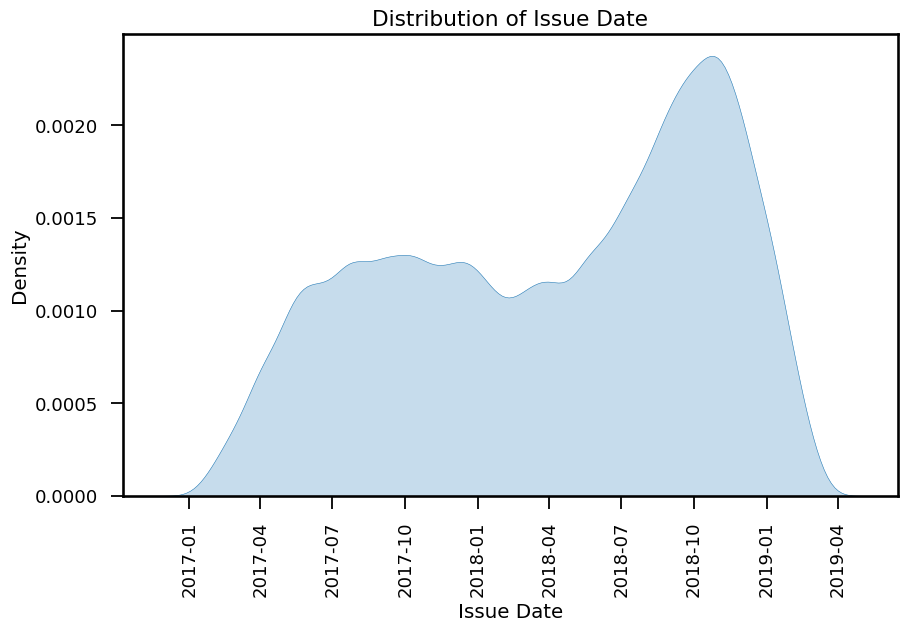

In [176]:
plt.figure(figsize=(10, 6))
sns.kdeplot(sales['Issue Date'], fill=True)
plt.title('Distribution of Issue Date')
plt.xticks( rotation='vertical')
plt.show()

# UNIVARIATE ANALYSIS FOR SALESPERSON ID

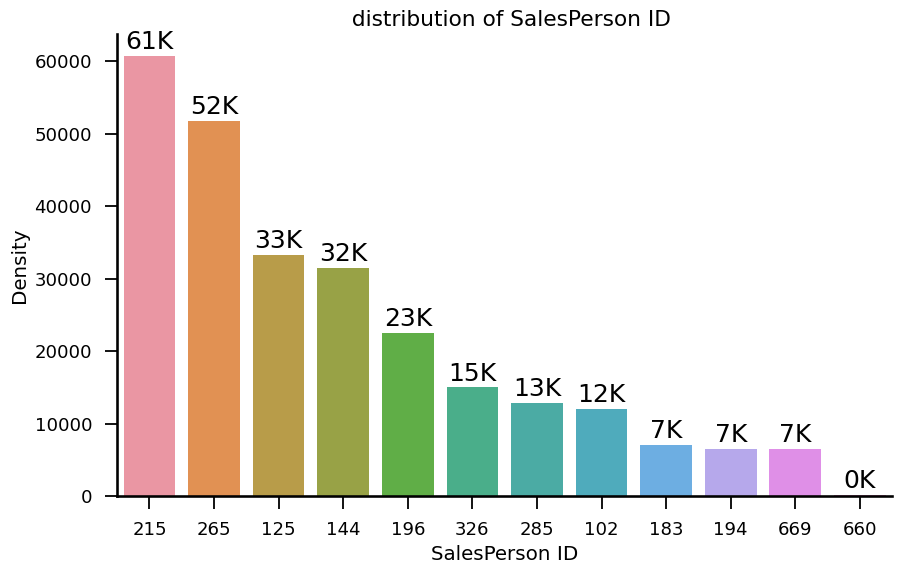

In [165]:
plt.figure(figsize=(10, 6))
plot=sns.countplot(x=sales['SalesPerson ID'],data=sales,order=sales['SalesPerson ID'].value_counts().index)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
plt.title('  distribution of SalesPerson ID')
plt.xlabel('SalesPerson ID')
plt.ylabel('Density')
plt.show()

# UNIVARIATE ANALYSIS FOR INVOICE NUMBER


In [178]:
invoice_cnts = sales['Invoice Number'].value_counts().reset_index(name='count').sort_values(by='count',ascending=False)
invoice_cnts


,Invoice Number,count
0,2048192,99
1,2170219,86
2,1707745,82
3,2016890,81
4,1913377,77
...,...,...
43821,1870790,1
43822,1733837,1
43823,1720733,1
43824,2052623,1


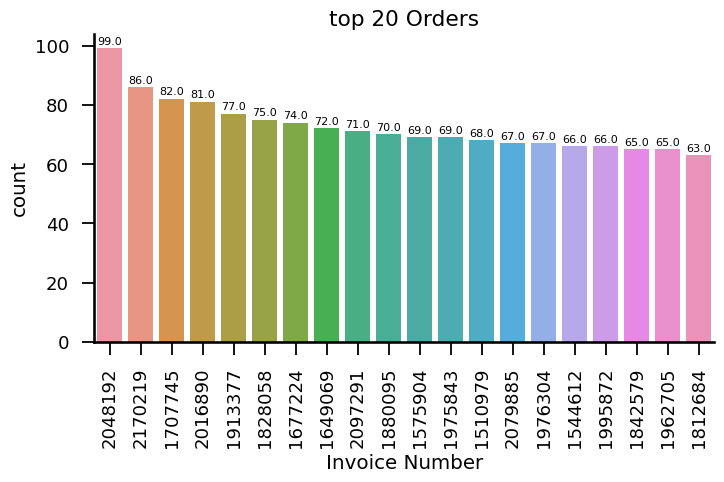

In [185]:
plt.figure(figsize=(8,4))
plot=sns.barplot(x='Invoice Number',y='count',data=invoice_cnts[0:20])
for p in plot.patches:
    plot.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0,5), textcoords='offset points')
sns.despine()
plt.title('top 20 Orders')
plt.xticks( rotation='vertical')
plt.show()

# univariate analysis for customer id

In [190]:

Customer_counts = sales['Customer ID'].value_counts().reset_index(name='count').sort_values(by='count',ascending=False)[0:20]
Customer_counts #.values[1:11]

,Customer ID,count
0,4088384,4223
1,672177,3990
2,1156855,3094
3,669212,2787
4,3674579,2704
5,672945,2692
6,3834938,2331
7,2928031,2307
8,4130641,2211
9,4915588,2113


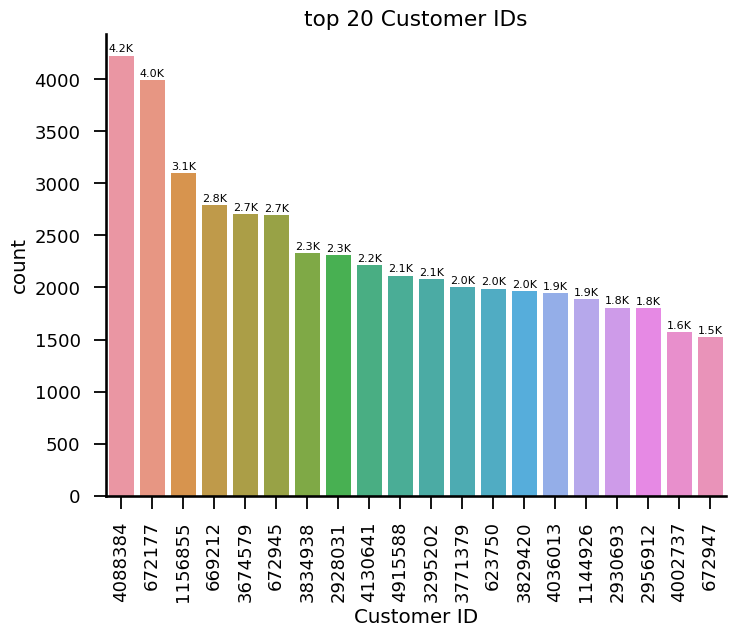

In [193]:
plt.figure(figsize=(8,6))
plot=sns.barplot(x='Customer ID',y='count',data=Customer_counts)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0,5), textcoords='offset points')
sns.despine()
plt.title('top 20 Customer IDs')
plt.xticks( rotation='vertical')
plt.show()

- variable Product ID

In [194]:
plt.rcParams['font.size'] = 10

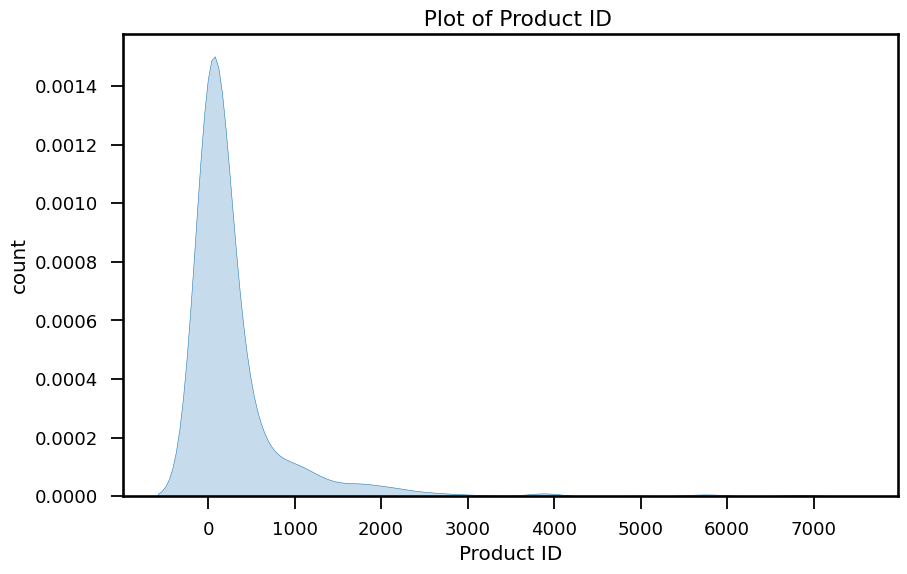

In [195]:
ProductID_counts = sales['Product ID'].astype(str).value_counts()

plt.figure(figsize=(10, 6))
sns.kdeplot(ProductID_counts, fill=True)
plt.title('  Plot of Product ID')
plt.xlabel('Product ID')
plt.ylabel('count')
plt.show()

- variable Qty Items

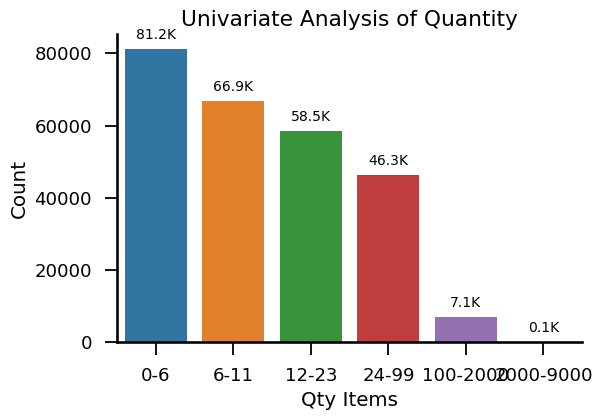

In [196]:

plt.figure(figsize=(6,4))
plot=sns.countplot(data=sales,x='Quantity Bins')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
plt.title('Univariate Analysis of Quantity')
plt.xlabel('Qty Items')
plt.ylabel('Count')
plt.show()

- variable unit price

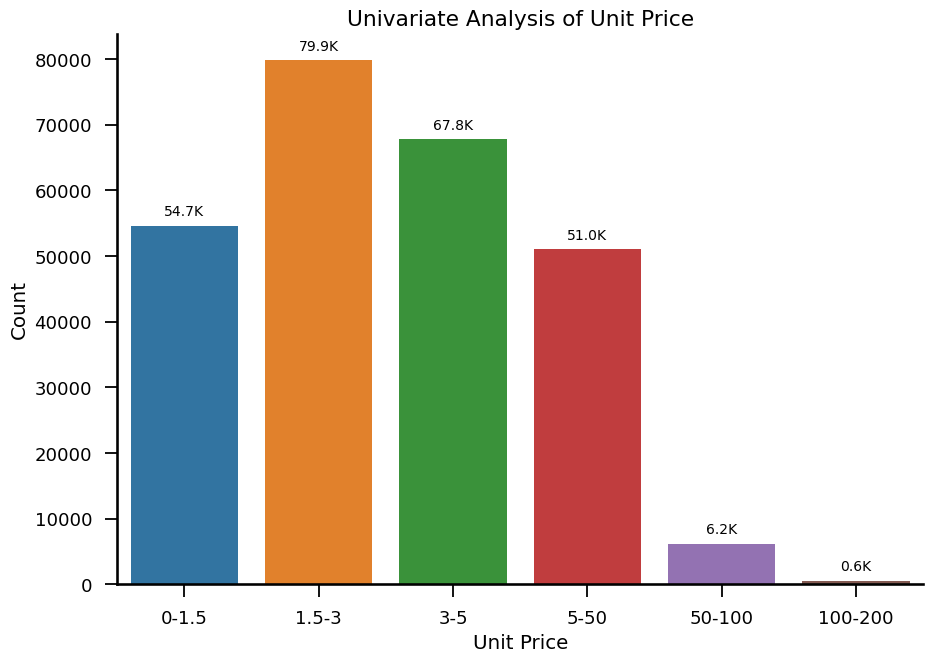

In [197]:
plot=sns.countplot(data=sales,x='Unit Price Bins')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
plt.title('Univariate Analysis of Unit Price')
plt.xlabel('Unit Price')
plt.ylabel('Count')
plt.show()



- variable net weight

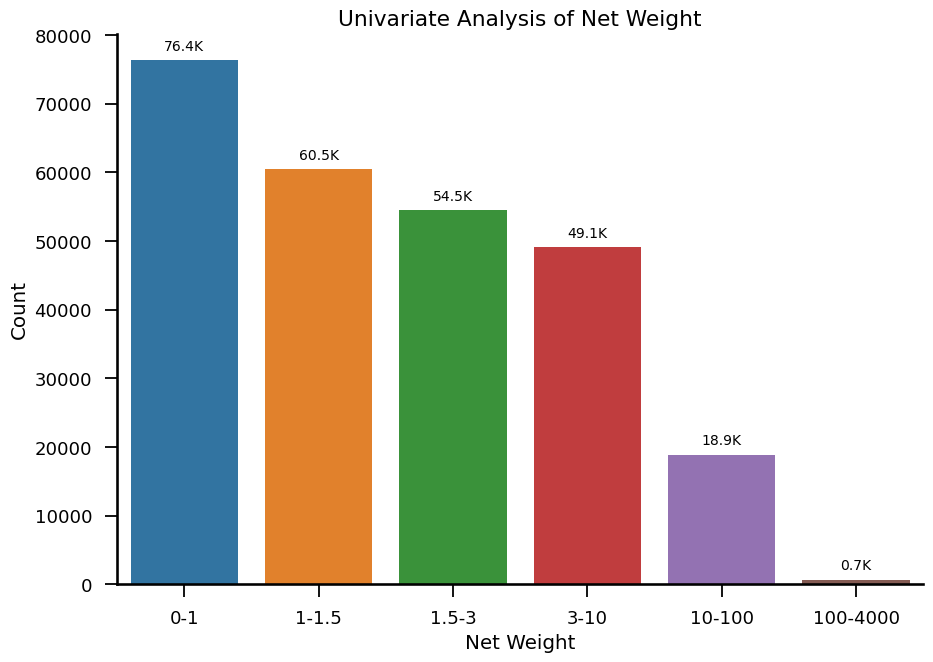

In [198]:
plot=sns.countplot(data=sales,x='Net Weight Bins')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
plt.title('Univariate Analysis of Net Weight')
plt.xlabel('Net Weight')
plt.ylabel('Count')
plt.show()

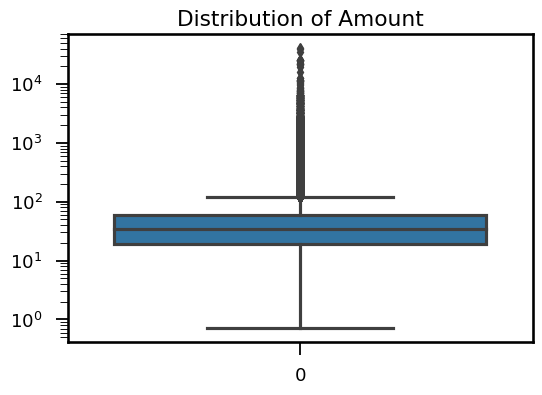

In [199]:
plt.figure(figsize=(6,4))
ax=sns.boxplot(sales['Amount'])
ax.set(yscale="log")
plt.title('Distribution of Amount')
plt.show()

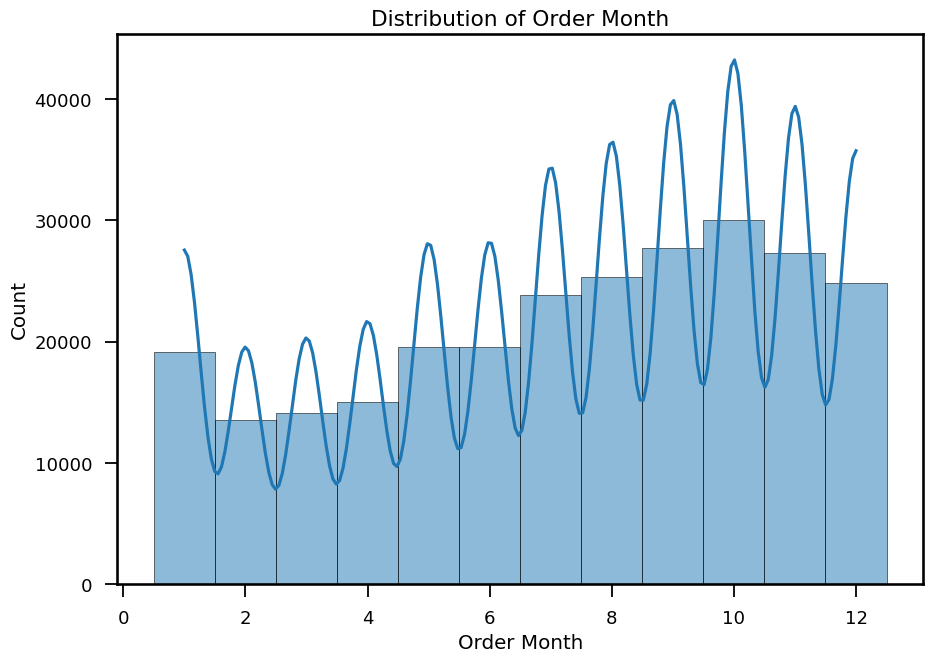

In [200]:
sns.histplot(sales['Order Month'], kde=True)
plt.title('Distribution of Order Month')
plt.show()

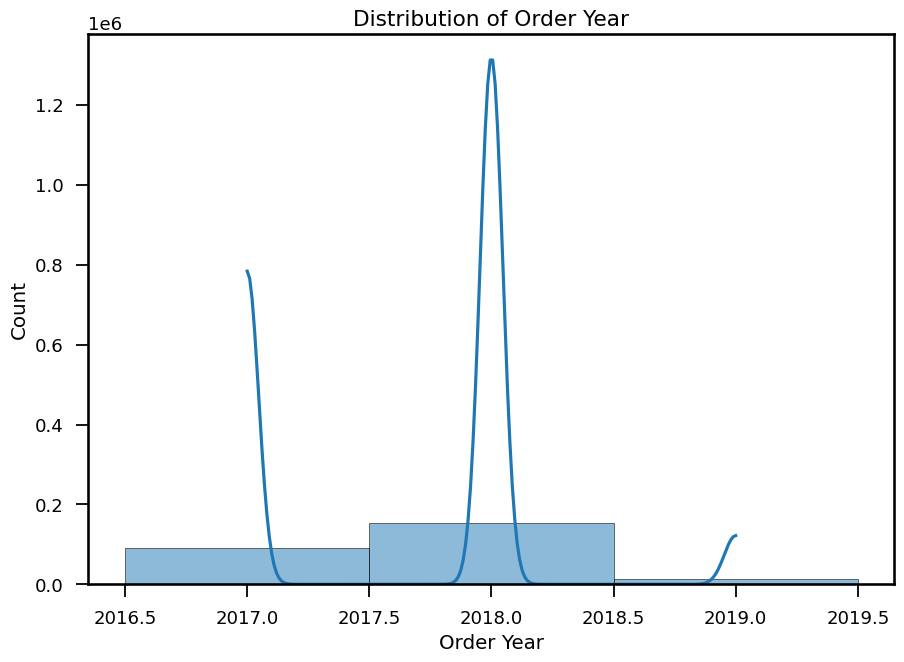

In [201]:
sns.histplot(sales['Order Year'], kde=True)
plt.title('Distribution of Order Year')
plt.show()

## customers data set

In [202]:
customers.head()

,Customer ID,Company Name,Status,Line of Business,City,State
0,1339104,Dwarf Acoustics,A,Canteens,Winthrop,WA
1,1339740,Fire Softwares,A,Canteens,Winthrop,WA
2,1339884,Granite Intelligence,A,Canteens,Winthrop,WA
3,1340322,Thorecords,A,Canteens,Winthrop,WA
4,4837795,Green-Plus,A,Canteens,Winthrop,WA


In [203]:
customers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1411 entries, 0 to 1410
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Customer ID       1411 non-null   string
 1   Company Name      1411 non-null   object
 2   Status            1411 non-null   object
 3   Line of Business  1411 non-null   object
 4   City              1411 non-null   object
 5   State             1411 non-null   object
dtypes: object(5), string(1)
memory usage: 66.3+ KB


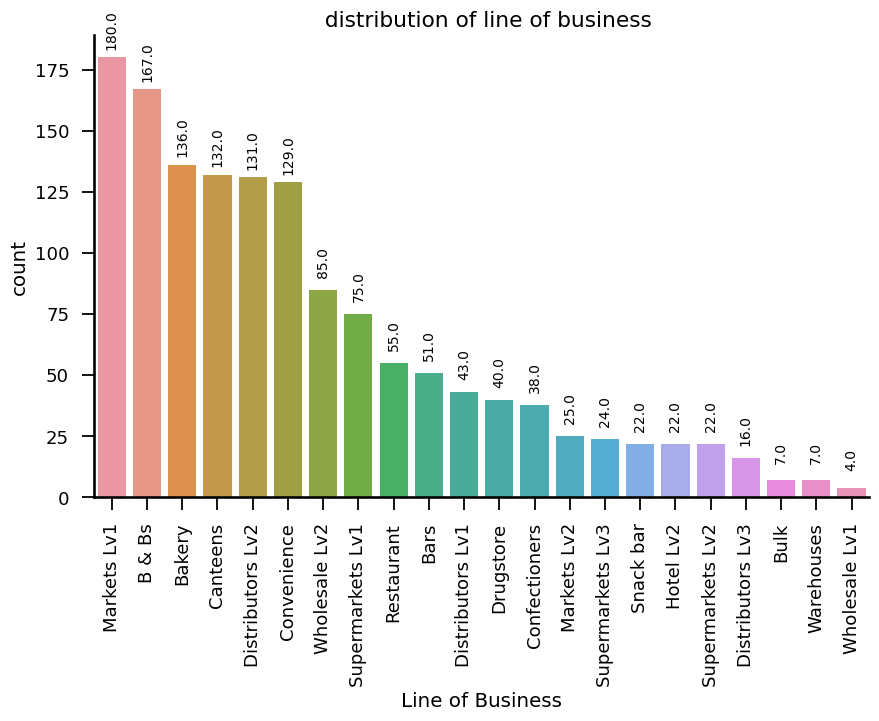

In [204]:

plt.figure(figsize=(10, 6))
plot=sns.countplot(x='Line of Business',data=customers,order= customers['Line of Business'].value_counts().index)
for p in plot.patches:
    plot.annotate(p.get_height(), (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
plt.title('  distribution of line of business')
plt.xticks( rotation='vertical')
plt.show()

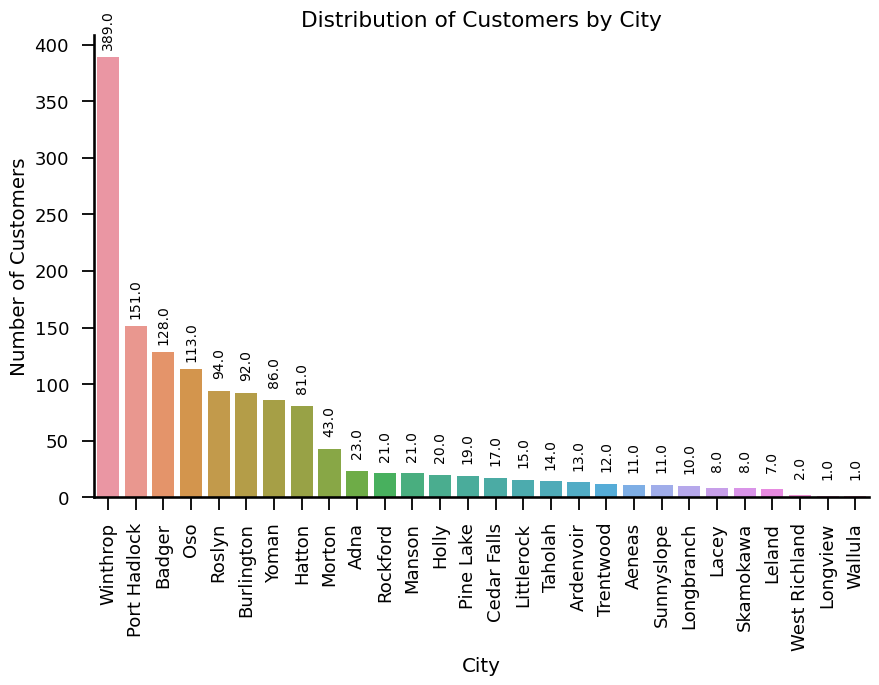

In [205]:

plt.figure(figsize=(10, 6))
plot=sns.countplot(data=customers, x='City', order= customers['City'].value_counts().index)
for p in plot.patches:
    plot.annotate(p.get_height(), (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
plt.title('Distribution of Customers by City')
plt.xlabel('City')
plt.ylabel('Number of Customers')
plt.xticks(rotation=90)
plt.show()

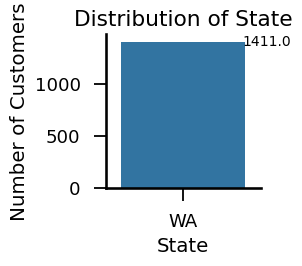

In [206]:
state_counts = customers['State'].value_counts()

# Plot the distribution of states using a bar plot
plt.figure(figsize=(2, 2))
plot=sns.countplot(x='State',data=customers)
for p in plot.patches:
    plot.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(60,0), textcoords='offset points')
sns.despine()
plt.title('Distribution of State')
plt.xlabel('State')
plt.ylabel('Number of Customers')
#plt.xticks(rotation=45)
plt.show()

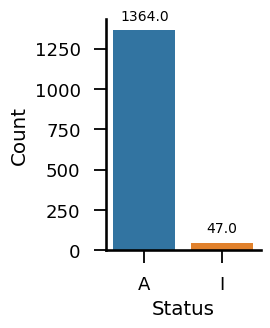

In [207]:
# Plot a bar chart to visualize the distribution of status values
plt.figure(figsize=(2, 3))
plot=sns.countplot(data=customers, x='Status')
sns.despine()
for p in plot.patches:
    plot.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')

#plt.title('Customer Status')
plt.xlabel('Status')
plt.ylabel('Count')
#plt.xticks(rotation=45)
plt.show()

## products data set

In [208]:
products.head()

,Product ID,Product,Group ID
0,1,Product 1,9999
1,2,Product 2,9999
2,3,Product 3,9999
3,4,Product 4,9999
4,5,Product 5,9999


In [209]:
products.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2736 entries, 0 to 2735
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Product ID  2736 non-null   string
 1   Product     2736 non-null   object
 2   Group ID    2736 non-null   string
dtypes: object(1), string(2)
memory usage: 64.3+ KB


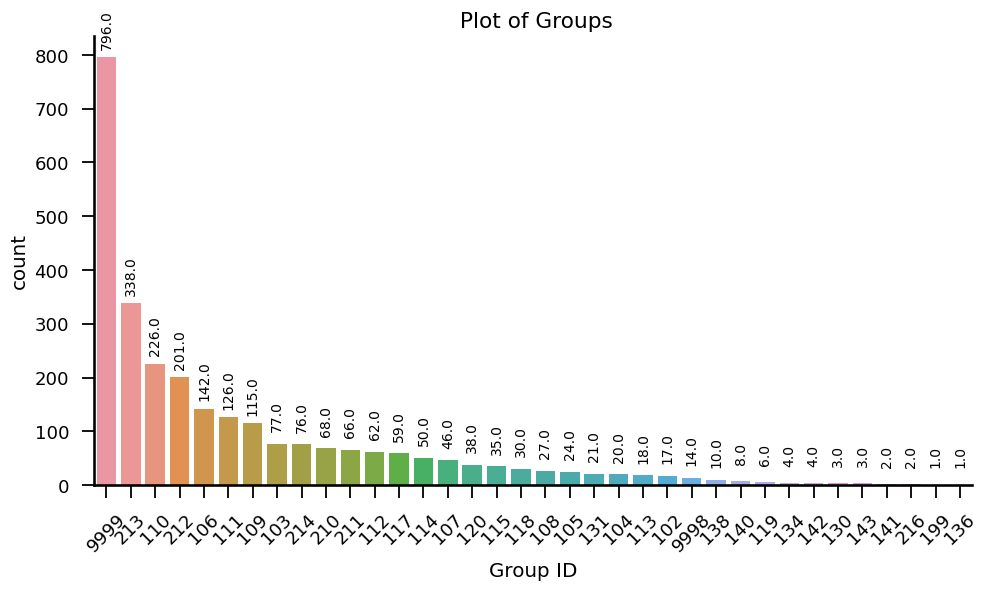

In [210]:


# plot for the distribution of products in groups
plt.figure(figsize=(10, 6))
plot=sns.countplot(data=products, x='Group ID',order= products['Group ID'].value_counts().index)
for p in plot.patches:
    plot.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
plt.title(' Plot of Groups')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [472]:
product_grp[product_grp['Group ID']=='9999']['Group']

35    Grape Juice (Bottle)
Name: Group, dtype: object

## products_group data set

In [211]:
product_grp.head()

,Group ID,Group,Category
0,102,Powdered Milk,Food
1,103,Sugars,Food
2,104,Canned Sweets,Food
3,105,Flours,Food
4,106,Oils,Food


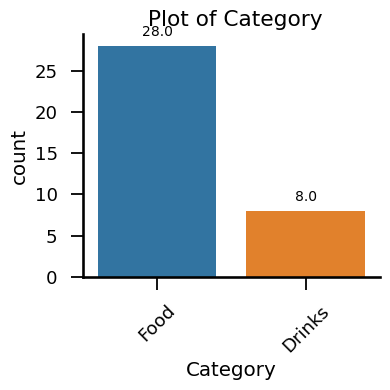

In [212]:
# plot for the distribution of groups in categories
plt.figure(figsize=(4, 4))
plot=sns.countplot(data=product_grp, x='Category')
for p in plot.patches:
    plot.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
plt.title(' Plot of Category')
sns.despine()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## salesPerson data set

In [213]:
salesperson.head()

,SalesPerson ID,SalesPerson,Supervisor ID,Supervisor,Manager ID,Manager,Team
0,669,Ayaana Mackenzie,15,Jonathon Childs,1,Ronnie Daly,Retail
1,660,Tess Sanderson,25,Jessica Valentine,1,Ronnie Daly,Retail
2,183,Hywel Hopkins,25,Jessica Valentine,1,Ronnie Daly,Retail
3,102,Serenity Rich,25,Jessica Valentine,1,Ronnie Daly,Retail
4,196,Gillian Gonzales,30,Sarah-Jayne Pennington,1,Ronnie Daly,Retail


In [214]:
salesperson.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12 entries, 0 to 11
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   SalesPerson ID  12 non-null     string
 1   SalesPerson     12 non-null     object
 2   Supervisor ID   12 non-null     string
 3   Supervisor      12 non-null     object
 4   Manager ID      12 non-null     string
 5   Manager         12 non-null     object
 6   Team            12 non-null     object
dtypes: object(4), string(3)
memory usage: 804.0+ bytes


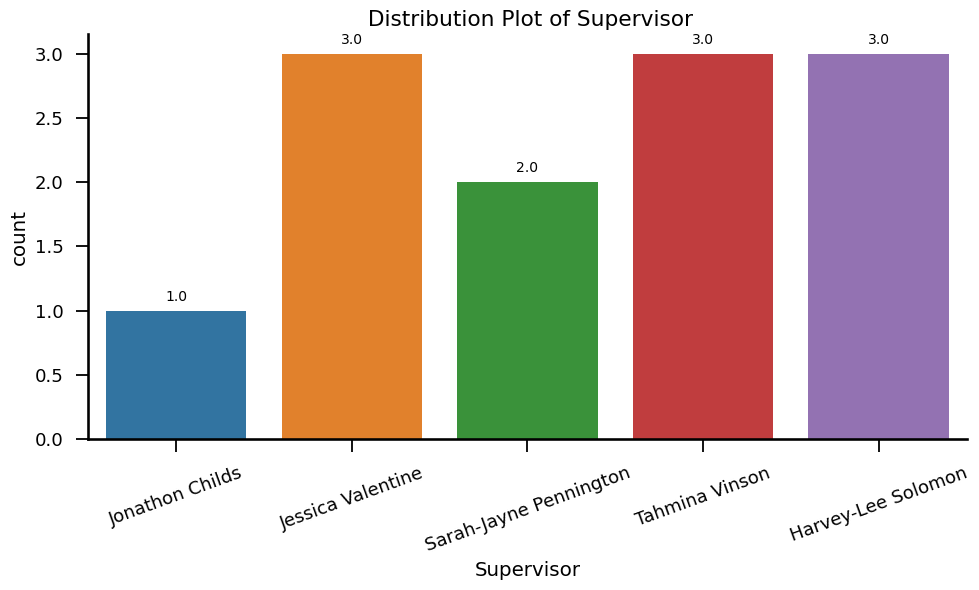

In [474]:
# plot for the distribution
plt.figure(figsize=(10, 6))
plot=sns.countplot(data=salesperson, x='Supervisor')
for p in plot.patches:
    plot.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
plt.title(' Distribution Plot of Supervisor')
plt.xticks(rotation=20)
plt.tight_layout()
plt.show()

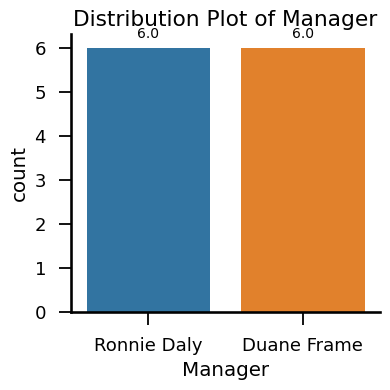

In [216]:
# plot for the distribution
plt.figure(figsize=(4, 4))
plot=sns.countplot(data=salesperson, x='Manager')
for p in plot.patches:
    plot.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
plt.title('Distribution Plot of Manager')
#plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

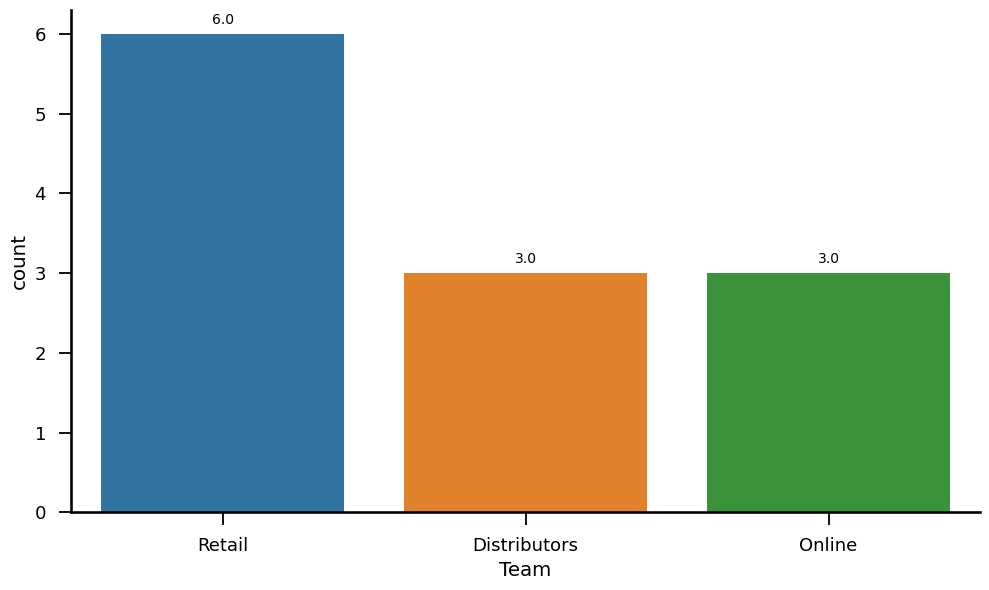

In [217]:
# plot for the distribution
plt.figure(figsize=(10, 6))
plot=sns.countplot(data=salesperson, x='Team')

for p in plot.patches:
    plot.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
#plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## Targets Dataset

In [218]:
targets.head()

,SalesPerson ID,Date,Sales,Target Month,Target Year
0,102,2017-01-01,140768.312981,1,2017
1,102,2017-02-01,124258.753484,2,2017
2,102,2017-03-01,169509.931262,3,2017
3,102,2017-04-01,143465.231352,4,2017
4,102,2017-05-01,98423.627768,5,2017


In [219]:
targets.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 264 entries, 0 to 263
Data columns (total 5 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   SalesPerson ID  264 non-null    string        
 1   Date            264 non-null    datetime64[ns]
 2   Sales           264 non-null    float64       
 3   Target Month    264 non-null    category      
 4   Target Year     264 non-null    category      
dtypes: category(2), datetime64[ns](1), float64(1), string(1)
memory usage: 7.2 KB


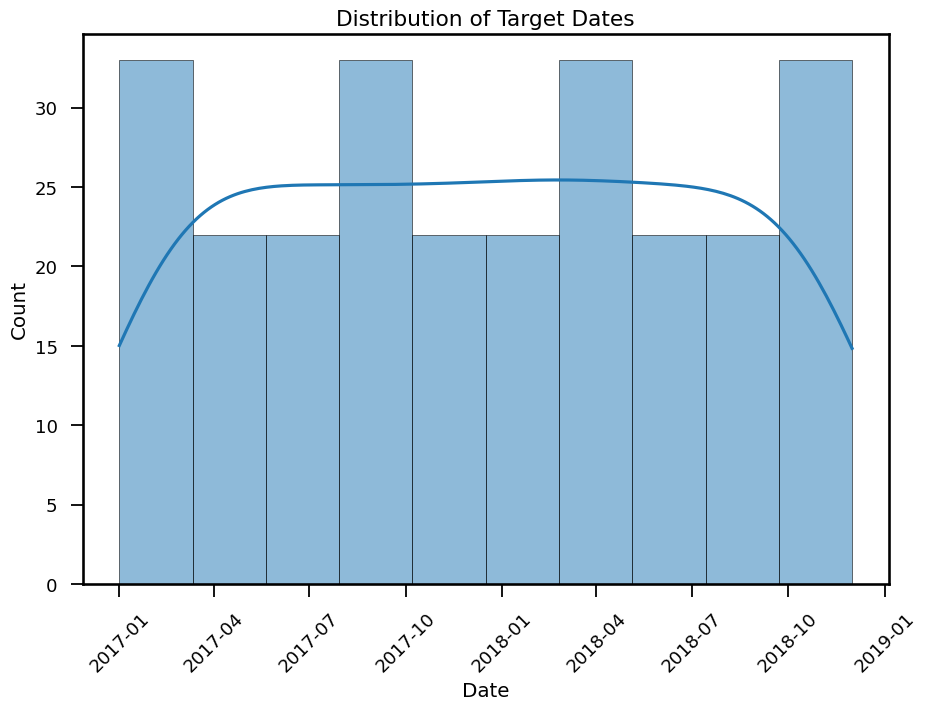

In [220]:
# Univariate Analysis for Target Date
sns.histplot(targets['Date'], kde=True)
plt.xticks(rotation=45)
plt.title('Distribution of Target Dates')
plt.show()

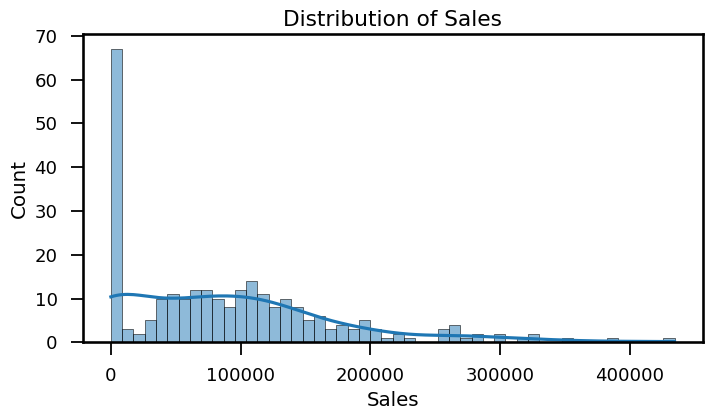

In [221]:
# Univariate Analysis for Target Sales
plt.figure(figsize=(8,4))
sns.histplot(targets['Sales'],bins=50, kde=True)
plt.title('Distribution of Sales')
plt.show()


# Bivariate Analysis

In [222]:
merged_df = sales.merge(salesperson, on='SalesPerson ID', how='left').merge(customers, on='Customer ID', how='left').merge(products, on='Product ID', how='left').merge(product_grp, left_on='Group ID', right_on='Group ID', how='left')

In [223]:
merged_df.head()

,Issue Date,Invoice Number,Customer ID,SalesPerson ID,Product ID,Amount,Order Month,Order Year,Quantity Bins,Unit Price Bins,...,Team,Company Name,Status,Line of Business,City,State,Product,Group ID,Group,Category
0,2017-01-12,1492762,3140218,265,1073,52.98,1,2017,0-6,5-50,...,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,WA,Product 1073,117,Spices,Food
1,2017-01-12,1492762,3140218,265,1420,26.64,1,2017,0-6,3-5,...,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,WA,Product 1420,108,Coffee Pods,Food
2,2017-01-12,1492762,3140218,265,264,9.60,1,2017,6-11,0-1.5,...,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,WA,Product 264,111,Yeast,Food
3,2017-01-13,1492719,2983332,265,1154,17.52,1,2017,0-6,1.5-3,...,Distributors,Granite poly,A,Distributors Lv2,Roslyn,WA,Product 1154,113,Popcorn,Food
4,2017-01-13,1492719,2983332,265,1527,16.86,1,2017,0-6,1.5-3,...,Distributors,Granite poly,A,Distributors Lv2,Roslyn,WA,Product 1527,113,Popcorn,Food


In [224]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260096 entries, 0 to 260095
Data columns (total 26 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   Issue Date        260096 non-null  datetime64[ns]
 1   Invoice Number    260096 non-null  string        
 2   Customer ID       260096 non-null  string        
 3   SalesPerson ID    260096 non-null  string        
 4   Product ID        260096 non-null  string        
 5   Amount            260096 non-null  float64       
 6   Order Month       260096 non-null  category      
 7   Order Year        260096 non-null  category      
 8   Quantity Bins     260096 non-null  category      
 9   Unit Price Bins   260096 non-null  category      
 10  Net Weight Bins   260096 non-null  category      
 11  SalesPerson       260096 non-null  object        
 12  Supervisor ID     260096 non-null  string        
 13  Supervisor        260096 non-null  object        
 14  Mana

In [225]:
cols={'SalesPerson ID','Customer ID','Product ID','Group ID', 'Supervisor ID','Manager ID','State' }
merged_df.drop(columns=cols,inplace=True)

In [226]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260096 entries, 0 to 260095
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   Issue Date        260096 non-null  datetime64[ns]
 1   Invoice Number    260096 non-null  string        
 2   Amount            260096 non-null  float64       
 3   Order Month       260096 non-null  category      
 4   Order Year        260096 non-null  category      
 5   Quantity Bins     260096 non-null  category      
 6   Unit Price Bins   260096 non-null  category      
 7   Net Weight Bins   260096 non-null  category      
 8   SalesPerson       260096 non-null  object        
 9   Supervisor        260096 non-null  object        
 10  Manager           260096 non-null  object        
 11  Team              260096 non-null  object        
 12  Company Name      260096 non-null  object        
 13  Status            260096 non-null  object        
 14  Line

##Bivariate Analysis

 Defining a function uniplot inorder to plot desired graphs for the variables.


In [819]:
def uniplot(df, col, title, hue=None):
    plt.figure(figsize=(6,6))
    plt.title(title)
    ax = sns.countplot(data=df, x=col, order=df[col].value_counts().index, hue=hue, palette='bright')
    sns.despine()
    # Add values on the bars
    for p in ax.patches:
        
        if(p.get_height()!=0):
            ax.annotate(format(p.get_height(), '.0f'),
                    (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center',
                    xytext=(0, 10),
                    textcoords='offset points')

    plt.xticks(rotation=45, fontsize=8)
    plt.show()


# BIVARIATE ANALYSIS WRT MANAGER

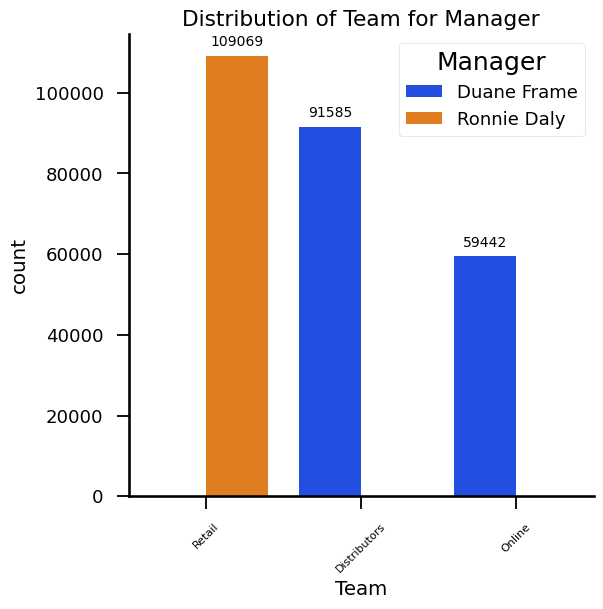

In [820]:
uniplot(merged_df,col='Team',title='Distribution of Team for Manager',hue='Manager')

- Duane Frame have about 35.21% of distributors , 22.85% of online
- Ronnie daly has  about 41% of Retailers in his Team

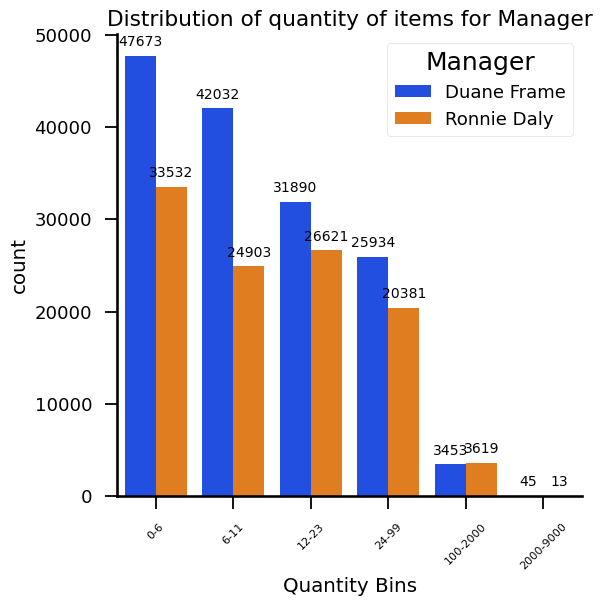

In [755]:
uniplot(merged_df,col='Quantity Bins',title='Distribution of quantity of items for Manager',hue='Manager')


Quantity Bins:	0-6	    6-11	     12-23	   24-99	   100-2000	  2000-9000

Manager

Duane Frame - 18.32% 	16.16%	  12.26%  	9.97%	     1.32%	       0

Ronnie Daly -	12.89%	 9.57%   	10.23%  	7.83%     	1.39%        0

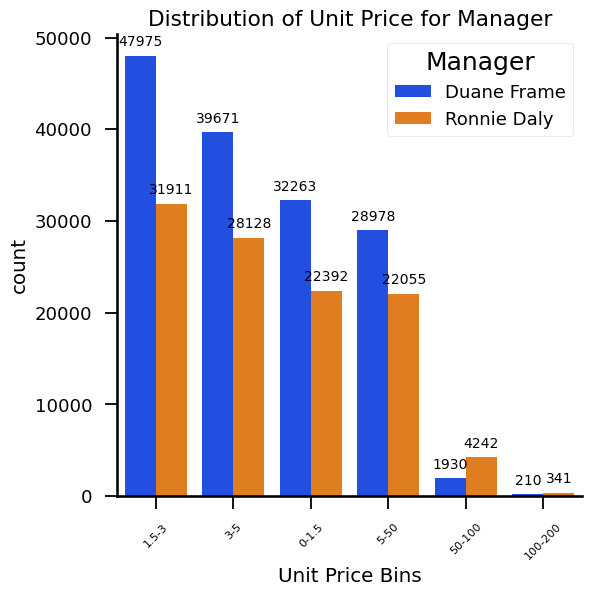

In [756]:
uniplot(merged_df,col='Unit Price Bins',title='Distribution of Unit Price for Manager',hue='Manager')


Manager
	    
 Duane Frame	Ronnie Daly


- Unit Price Bins
-0-1.5 -	12.40%      	8.60%
-1.5-3	 - 18.44%	12.26%
-3-5 -	15.25%	10.81%
-5-50 -	11.14%	8.47%
-50-100 -	0	    8.47%
-100-200	 - 0       	0

Ronnie Daly

- 0-1.5 - 8.60%
-1.5-312.26%
-3-510.81%
-5-50-8.47%
-50-100-1.63%
-100-200- 	0


In [757]:
pd.crosstab(merged_df['Manager'],merged_df['Net Weight Bins'],normalize=True)

Net Weight Bins,0-1,1-1.5,1.5-3,3-10,10-100,100-4000
Manager,,,,,,
Duane Frame,0.155696,0.124719,0.126280,0.119860,0.051969,0.002134
Ronnie Daly,0.137976,0.107941,0.083354,0.069013,0.020612,0.000446


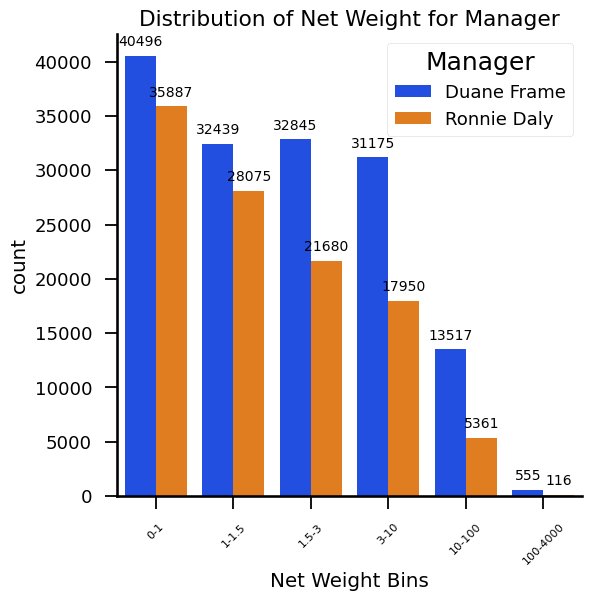

In [758]:
uniplot(merged_df,col='Net Weight Bins',title='Distribution of Net Weight for Manager',hue='Manager')


Net Weight Bins	0-1	1-1.5	1.5-3	3-10	10-100	100-4000

Manager
Duane Frame	15.56% 12.47%	 12.62%	11.98%	5.19%	0

Ronnie Daly	13.79%	10.79%	08.33%	6.90%	2.06%	0

In [759]:
pd.crosstab(merged_df['Manager'],merged_df['SalesPerson'],normalize=True).transpose()

Manager,Duane Frame,Ronnie Daly
SalesPerson,,
Akeel Mcleod,0.127895,0.000000
Ayaana Mackenzie,0.000000,0.025029
Dominykas Bird,0.121140,0.000000
Gillian Gonzales,0.000000,0.086779
Hywel Hopkins,0.000000,0.027040
Kien Mcgee,0.025202,0.000000
Lorenzo Donovan,0.049682,0.000000
Sahil Seymour,0.000000,0.233152
Serenity Rich,0.000000,0.046514


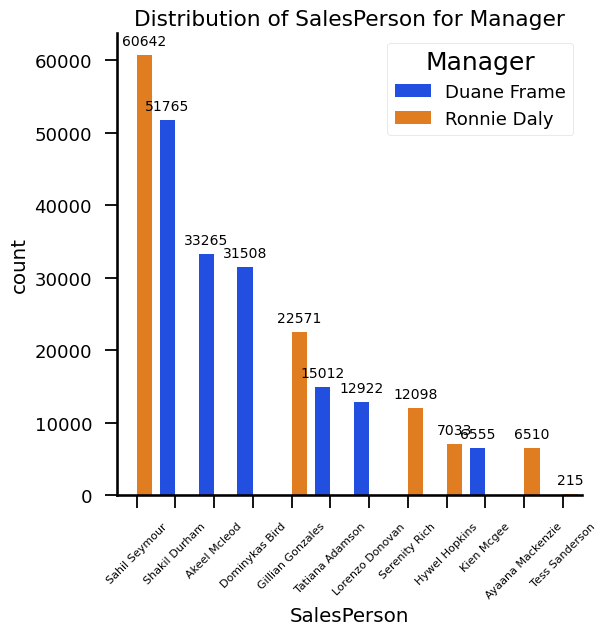

In [821]:
uniplot(merged_df,col='SalesPerson',title='Distribution of SalesPerson for Manager',hue='Manager')

Duane frame

- Akeel 12.78%
-Dominykas 12%
-Kien 2.5%
-Lorenza 49%
-Shakil 19%
totiana 5.7%

Ronnie Daly

- Ayaana 2.5%
-Gillian 8.6%
-Hywel2.7%
-Sahil 23.31%
-serenity 4.65%
-Tess 0

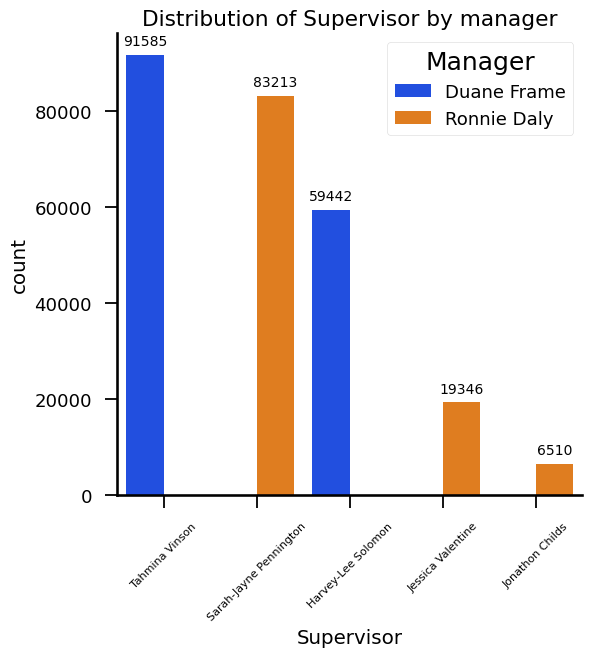

In [822]:
uniplot(merged_df,col='Supervisor',title='Distribution of Supervisor by manager',hue='Manager')

duane frame has supervisors Tahmina vinson, Harvey-Lee Solomon

Ronie Daly has got three supervisor sarah, Jessica and jonathon

In [762]:
top_10_companies = merged_df.groupby('Company Name')['Amount'].sum().nlargest(10).index.tolist()
filtered_cn = merged_df[merged_df['Company Name'].isin(top_10_companies)]


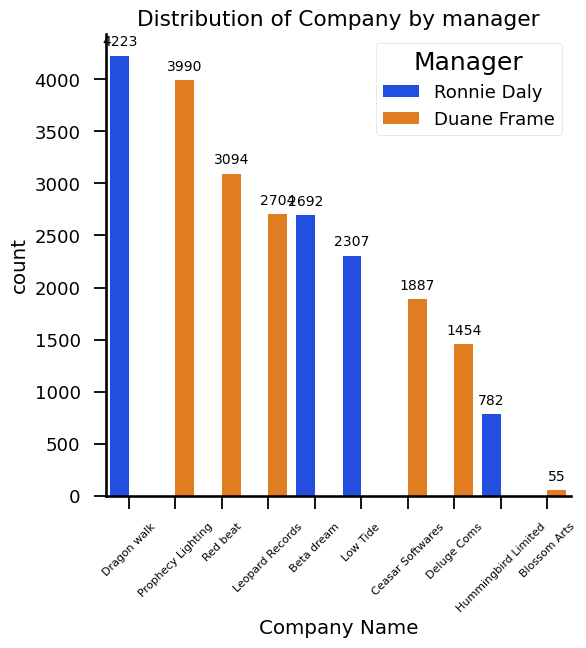

In [823]:
uniplot(filtered_cn,col='Company Name',title='Distribution of Company by manager',hue='Manager')

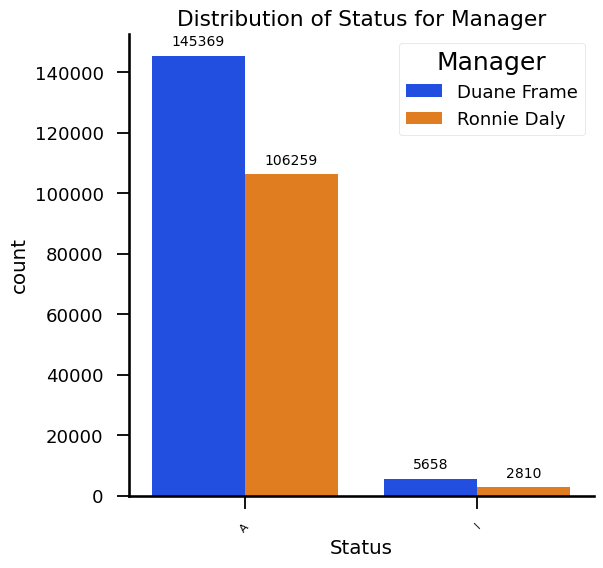

In [767]:
uniplot(merged_df,col='Status',title='Distribution of Status for Manager',hue='Manager')

the status of Duane Frame managers 55% belongs to status - A and 2% belong to status - I

the status of Ronnie Daly managers 40% belongs to status-A and 1% belongs to status-I

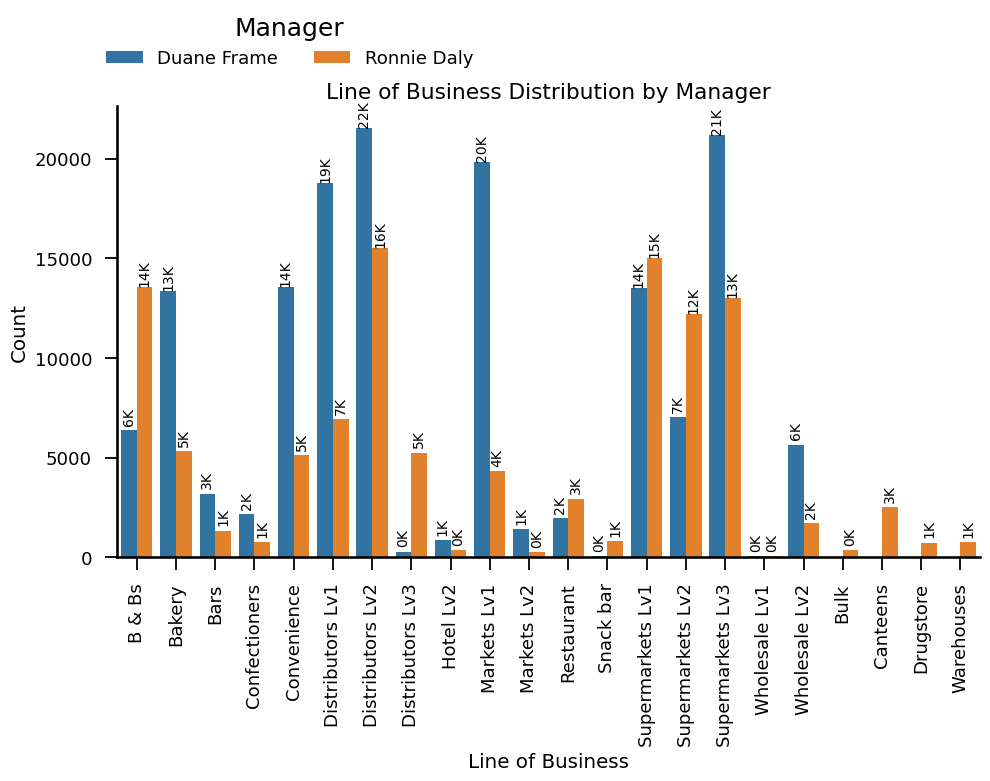

In [782]:
a = merged_df.groupby(['Manager','Line of Business']).size().reset_index(name='count')
plt.figure(figsize=(10, 8))
plot=sns.barplot(data=a, x='Line of Business', y='count', hue='Manager')
plt.title('Line of Business Distribution by Manager')
sns.despine()
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points',rotation=90)
sns.move_legend(plot, "lower center", bbox_to_anchor=(0.2, 1.05), frameon=False,ncols=2)
plt.xlabel('Line of Business')
plt.ylabel('Count')
plt.xticks(rotation=90)
#plt.legend(title='Manager')
plt.tight_layout()
plt.show()

In [792]:
top_10_city = merged_df.groupby('City')['Amount'].sum().nlargest(10).index.tolist()
filtered_cn2 = merged_df[merged_df['City'].isin(top_10_city)]
filtered_cn2= filtered_cn2.groupby(['Manager','City']).size().reset_index(name='count')
filtered_cn2

,Manager,City,count
0,Duane Frame,Badger,31508
1,Duane Frame,Manson,15370
2,Duane Frame,Morton,14759
3,Duane Frame,Port Hadlock,14359
4,Duane Frame,Roslyn,36395
5,Duane Frame,Winthrop,15178
6,Ronnie Daly,Hatton,13532
7,Ronnie Daly,Oso,12281
8,Ronnie Daly,Pine Lake,12773
9,Ronnie Daly,Port Hadlock,65


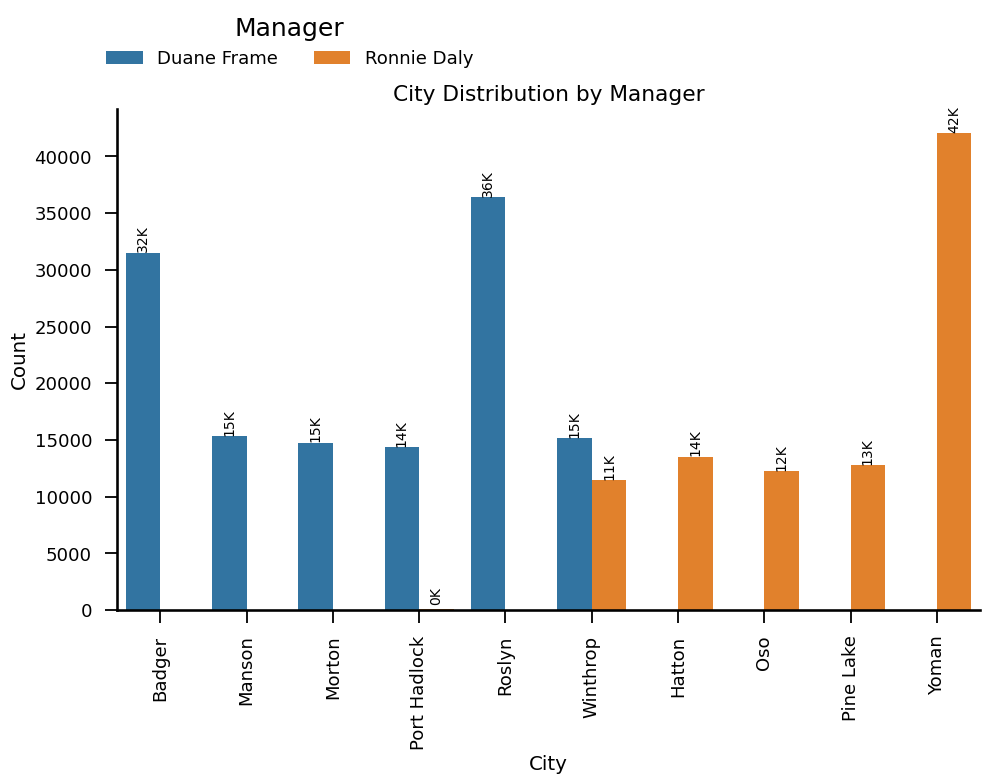

In [794]:
plt.figure(figsize=(10, 8))
plot=sns.barplot(data=filtered_cn2, x='City',y='count', hue='Manager')
plt.title('City Distribution by Manager')
sns.despine()
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points',rotation=90)
sns.move_legend(plot, "lower center", bbox_to_anchor=(0.2, 1.05), frameon=False,ncols=2)
plt.xlabel('City')
plt.ylabel('Count')
plt.xticks(rotation=90)
#plt.legend(title='Manager')
plt.tight_layout()
plt.show()

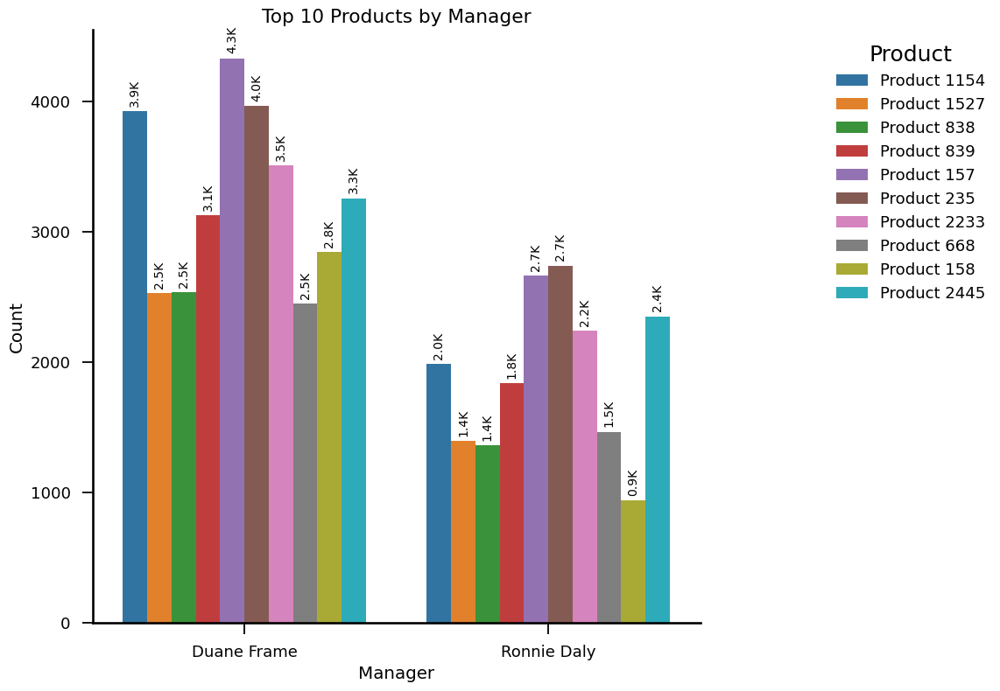

In [784]:
# Get the top 10 products based on frequency
top_10_products = merged_df['Product'].value_counts().head(10).index.tolist()

# Filter the dataset for only the top 10 products
filtered_p = merged_df[merged_df['Product'].isin(top_10_products)]

# Plotting the count plot
plt.figure(figsize=(12, 8))
plot=sns.countplot(data=filtered_p, x='Manager', hue='Product')

for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)
sns.move_legend(plot, "upper left", bbox_to_anchor=(1.2, 1), frameon=False)
sns.despine()
plt.title('Top 10 Products by Manager')
plt.xlabel('Manager')
plt.ylabel('Count')
#plt.xticks(rotation=45)
#plt.legend(title='Product', loc='upper right')
plt.tight_layout()
plt.show()

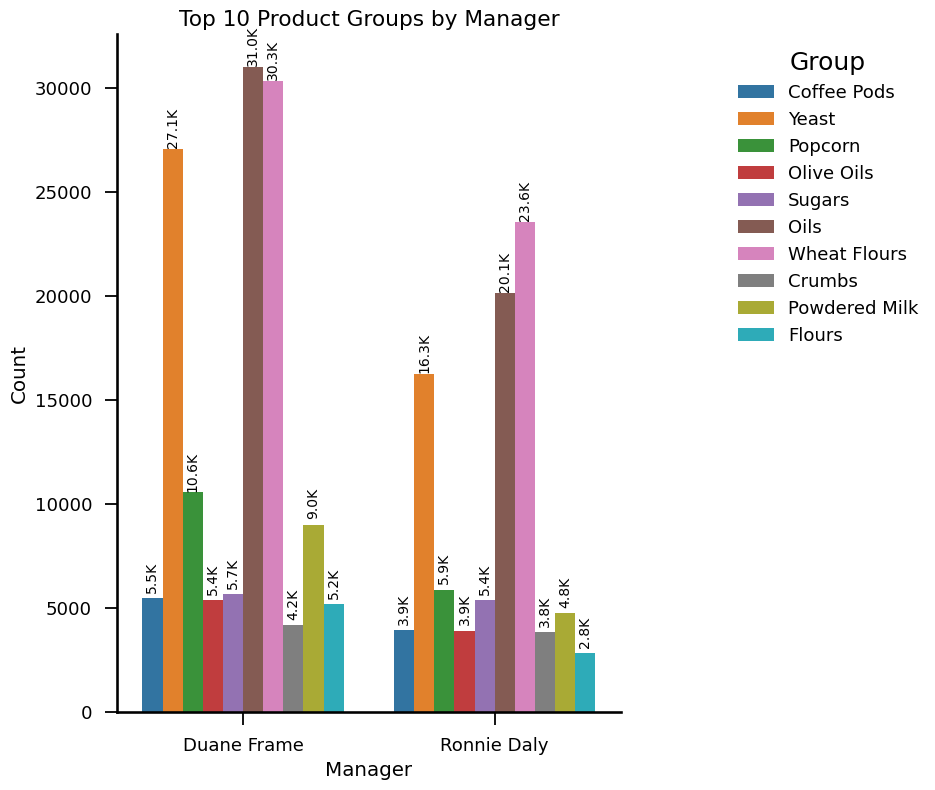

In [801]:
# Get the top 10 products based on frequency
top_10_productsg = merged_df['Group'].value_counts().head(10).index.tolist()

# Filter the dataset for only the top 10 products
filtered_p = merged_df[merged_df['Group'].isin(top_10_productsg)]

# Plotting the count plot
plt.figure(figsize=(10, 8))
plot=sns.countplot(data=filtered_p, x='Manager', hue='Group')

for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)
sns.move_legend(plot, "upper left", bbox_to_anchor=(1.2, 1), frameon=False)
sns.despine()
plt.title('Top 10 Product Groups by Manager')
plt.xlabel('Manager')
plt.ylabel('Count')
#plt.xticks(rotation=45)
#plt.legend(title='Product', loc='upper right')
plt.tight_layout()
plt.show()

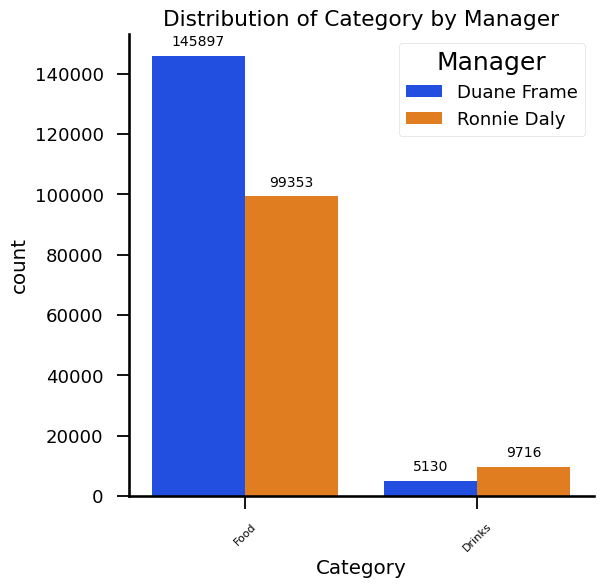

In [785]:
uniplot(merged_df,col='Category',title='Distribution of Category by Manager',hue='Manager')

1.9% managers of Duane Frame are in Drinks category and rest 56% are in Food category

3.7% of managers of ronnie daly are from drinks category and 38% are from Food category

Duane Frame :
- Encompasses a diverse team comprising both distributor and online sales.
Implies a broad market approach.
-Sales Team under Duane Frame:
- Shakil, Akeel, Dominykas, Tahmina, Lorenze, Kien, and McGee.
-Supervisors :
-Duane Frame's team is supervised by Tahmeena and Harvey-Lee.
-Duane Frame's managerial roster reflects a higher proportion within status A (55%)
-Duane Frame's managerial domain predominantly encompasses food-related sectors (56%), with a minor representation in the drinks category (1.9%)

Ronnie Daly :
- enters primarily on the retail sector.
- Sales Team under Ronnie Daly:
- Sahil, Seymour, Gillian, Serenity, Hywell, and Ayaana.
-Suggests a focused yet diverse sales force catering to retail-specific demands.
-Supervisors :
-Ronnie Daly's team is supervised by Sarah, Jessica, and Jonathon   
-Managerial Statuses:
-Ronnie Daly's managerial team exhibits a slightly lower percentage within status A (40%).
-Operational Emphases:
-Ronnie Daly's managerial portfolio demonstrates a significant presence in sectors like B&Bs, distributors, and supermarkets, suggesting a targeted approach towards diverse consumer needs and preferences.

# BIVARIATE ANALYSIS WRT TEAM
## Variable Team

In [837]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260096 entries, 0 to 260095
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   Issue Date        260096 non-null  datetime64[ns]
 1   Invoice Number    260096 non-null  object        
 2   Amount            260096 non-null  float64       
 3   Order Month       260096 non-null  category      
 4   Order Year        260096 non-null  category      
 5   Quantity Bins     260096 non-null  category      
 6   Unit Price Bins   260096 non-null  category      
 7   Net Weight Bins   260096 non-null  category      
 8   SalesPerson       260096 non-null  object        
 9   Supervisor        260096 non-null  object        
 10  Manager           260096 non-null  object        
 11  Team              260096 non-null  object        
 12  Company Name      260096 non-null  object        
 13  Status            260096 non-null  object        
 14  Line

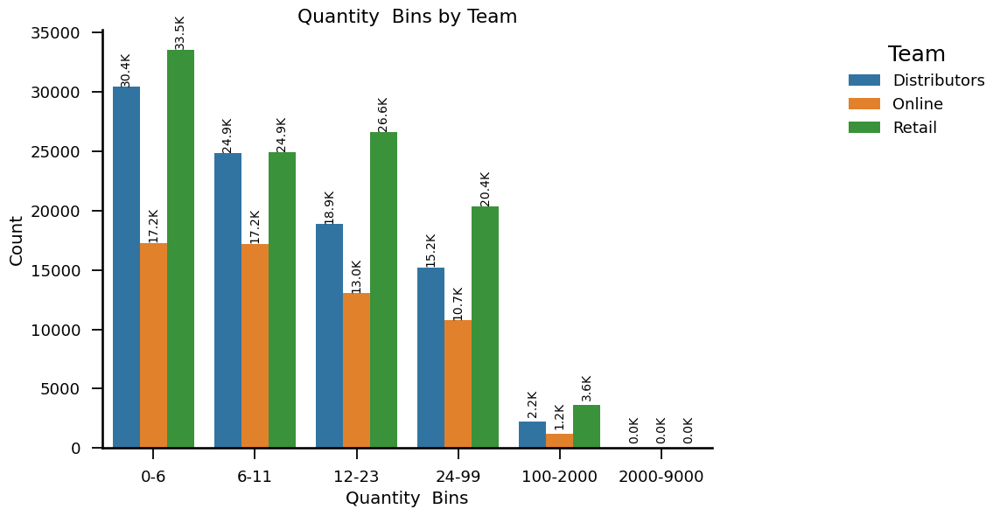

In [841]:
# Plotting the count plot
plt.figure(figsize=(12, 6))
plot=sns.countplot(data=merged_df, x='Quantity Bins', hue='Team')

for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)
sns.move_legend(plot, "upper left", bbox_to_anchor=(1.2, 1), frameon=False)
sns.despine()
plt.title('Quantity  Bins by Team')
plt.xlabel('Quantity  Bins')
plt.ylabel('Count')
#plt.xticks(rotation=45)
#plt.legend(title='Product', loc='upper right')
plt.tight_layout()
plt.show()

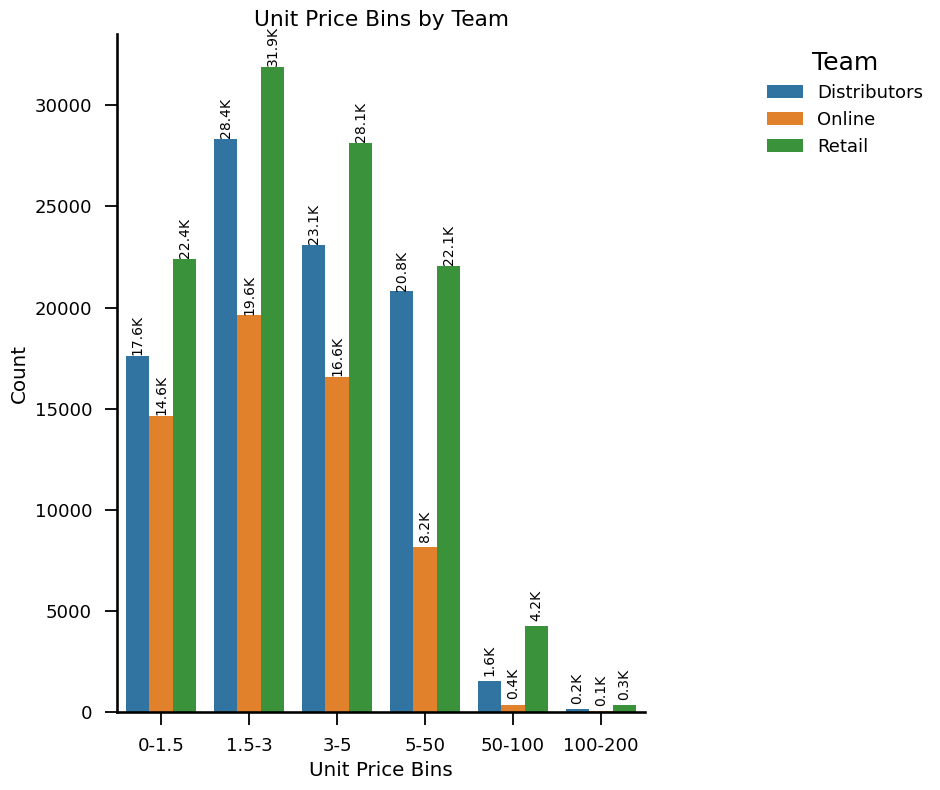

In [842]:
# Plotting the count plot
plt.figure(figsize=(10, 8))
plot=sns.countplot(data=merged_df, x='Unit Price Bins', hue='Team')

for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)
sns.move_legend(plot, "upper left", bbox_to_anchor=(1.2, 1), frameon=False)
sns.despine()
plt.title('Unit Price Bins by Team')
plt.xlabel('Unit Price Bins')
plt.ylabel('Count')
#plt.xticks(rotation=45)
#plt.legend(title='Product', loc='upper right')
plt.tight_layout()
plt.show()

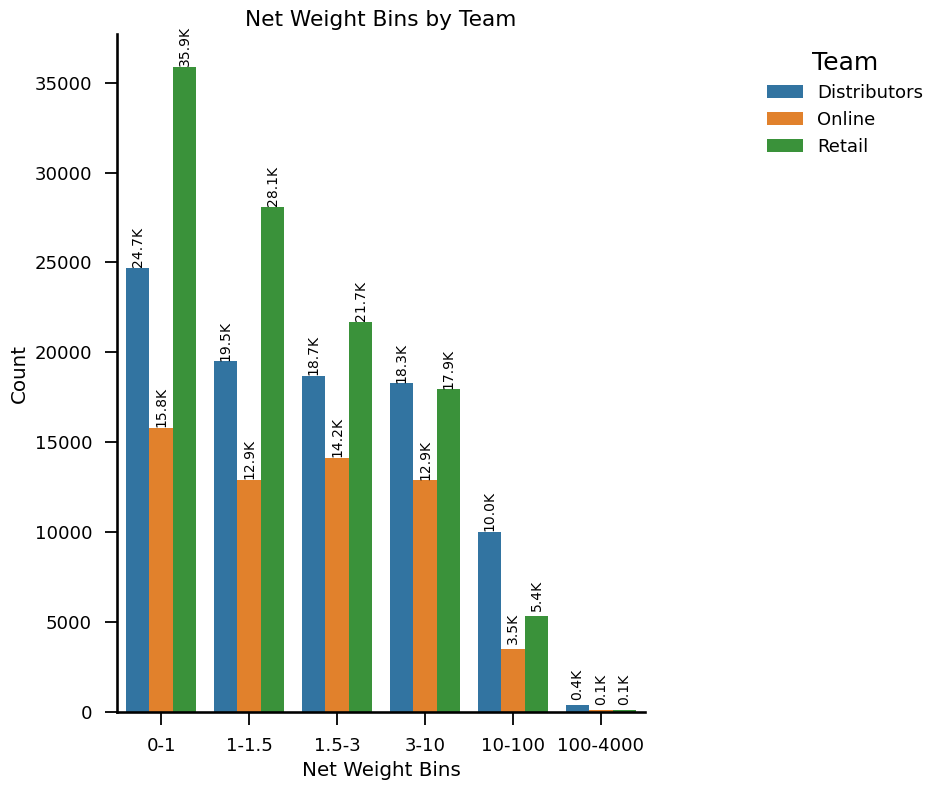

In [807]:
# Plotting the count plot
plt.figure(figsize=(10, 8))
plot=sns.countplot(data=merged_df, x='Net Weight Bins', hue='Team')

for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)
sns.move_legend(plot, "upper left", bbox_to_anchor=(1.2, 1), frameon=False)
sns.despine()
plt.title('Net Weight Bins by Team')
plt.xlabel('Net Weight Bins')
plt.ylabel('Count')
#plt.xticks(rotation=45)
#plt.legend(title='Product', loc='upper right')
plt.tight_layout()
plt.show()

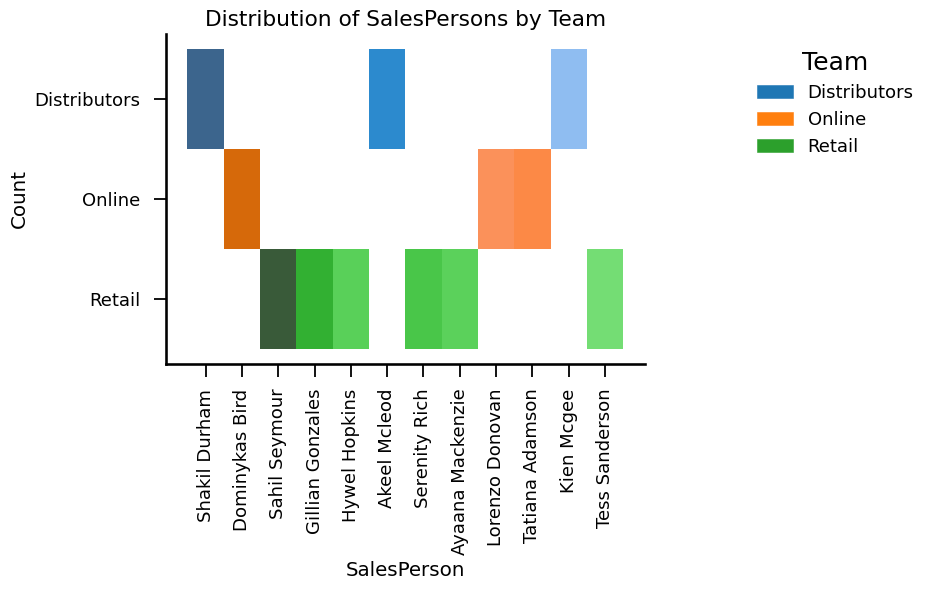

In [817]:
# Plotting the count plot
plt.figure(figsize=(10, 6))
plot=sns.histplot(data=merged_df, x='SalesPerson',y='Team', hue='Team')

for p in plot.patches:
       if(p.get_height()!=0):
            plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)
sns.move_legend(plot, "upper left", bbox_to_anchor=(1.2, 1), frameon=False)
sns.despine()
plt.title('Distribution of SalesPersons by Team')
plt.xlabel('SalesPerson')
plt.ylabel('Count')
plt.xticks(rotation=90)
#plt.legend(title='Product', loc='upper right')
plt.tight_layout()
plt.show()

- Distributors

12.78% of distributors belong to Akeel Mcleod

19.90% of distributors belong to shakeel Durham

2.52% of distributors belong to Kien Mcgee

- Online

12.11% belong to Dominykas Bird

4.96% belong to Lorenzo Donovan

5.77% belong to Tatiana Adamson

- Retailors

2.50% belong to ayaana Mackeenzie

8.67% belong Gillian Gonzales

2.70% belong to hywell hopkins

23.31% belong to Sahil seymour

4.6514% belong to Serenity Rich

0.08% belong to Tess Sanderson

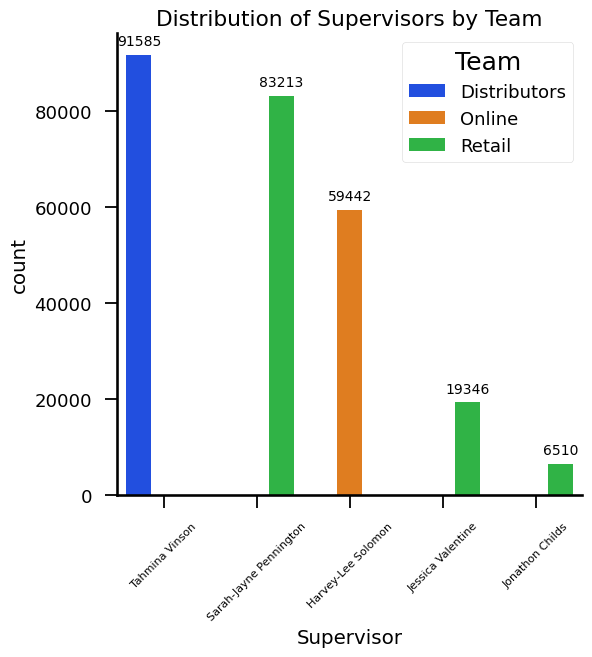

In [826]:
uniplot(merged_df,col='Supervisor',title='Distribution of Supervisors by Team',hue='Team')

Supervisor by Team :

- Tahmina Vinson has 35.21% of distributors.
-Harvey-Lee Solomon has 22.85% of online.
-Retail is 7% with Jessica, 2.5% Jonathon, 31.9% Pennington

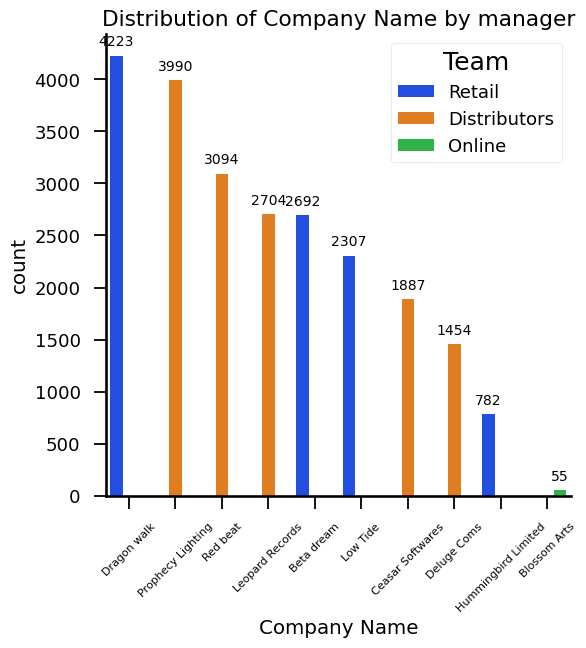

In [981]:
uniplot(filtered_cn,col='Company Name',title='Distribution of Company Name by manager',hue='Team')

- 35.21% of companies belong to distributors
- 22.85% belongs online
- 41.93% belongs to retail

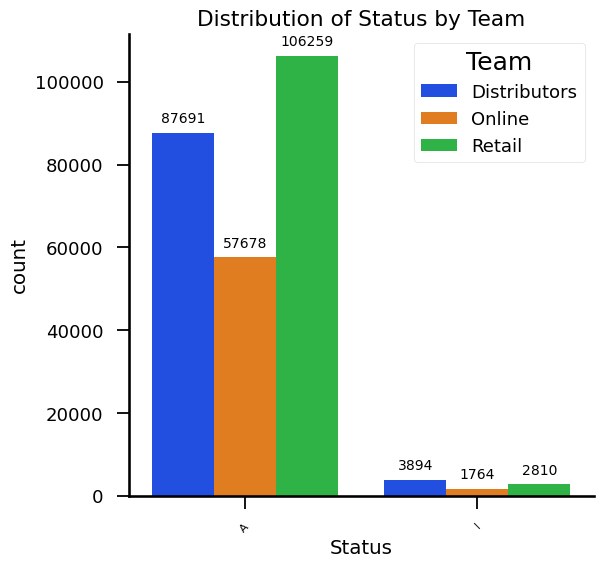

In [982]:
uniplot(merged_df,col='Status',title='Distribution of Status by Team',hue='Team')

33.71% of distributors belong to status A,and 1.4% belong to satus I

22.17% of online belong to status A and 0.06% belong to staus I

40.85% of Retail belong to status A,and 0.10% belong to status I

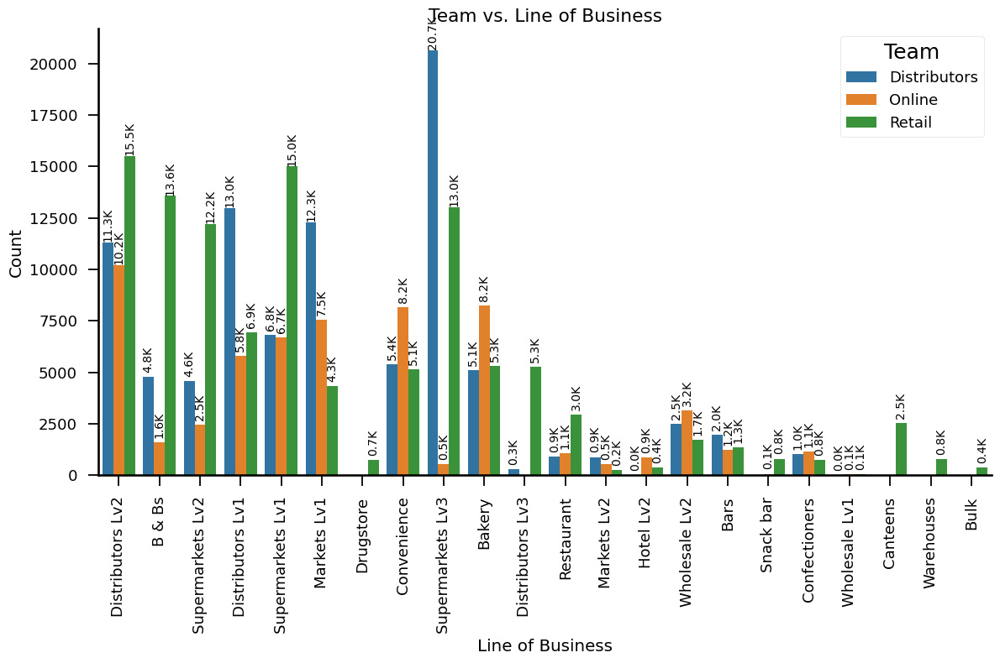

In [831]:
plt.figure(figsize=(12, 8))
plot=sns.countplot(data=merged_df, x='Line of Business', hue='Team')
plt.title('Team vs. Line of Business')
for p in plot.patches:
       if(p.get_height()!=0):
            plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('Line of Business')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.legend(title='Team', loc='upper right')
plt.tight_layout()
plt.show()

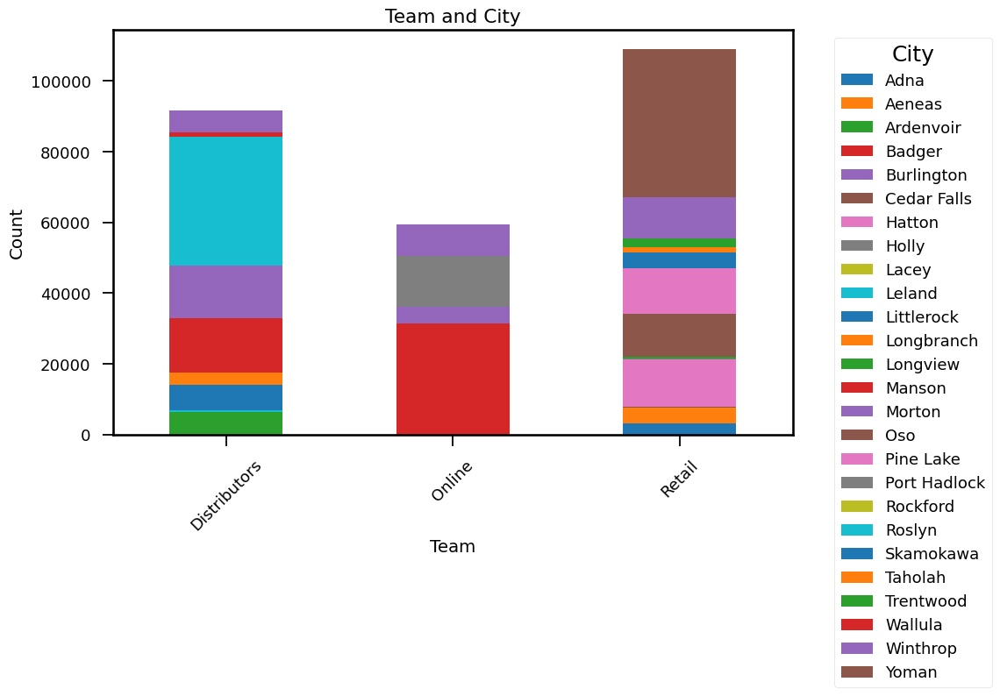

In [248]:
# Filter the required columns
filtered_df = merged_df[['Team', 'City']]

# Count occurrences of each combination of Team and Company Name
grouped_df = filtered_df.groupby(['Team', 'City']).size().unstack(fill_value=0)

# Plot the stacked bar plot
grouped_df.plot(kind='bar', stacked=True, figsize=(10, 6))

# Customize the plot
plt.title('Team and City')
plt.xlabel('Team')
plt.ylabel('Count')
#plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.legend(title='City', bbox_to_anchor=(1.05, 1), loc='upper left')  # Place legend on the right corner


# Show plot
plt.show()


cities belong to
Distributors    35.21%,
Online          22.85%,
Retail          41.93%

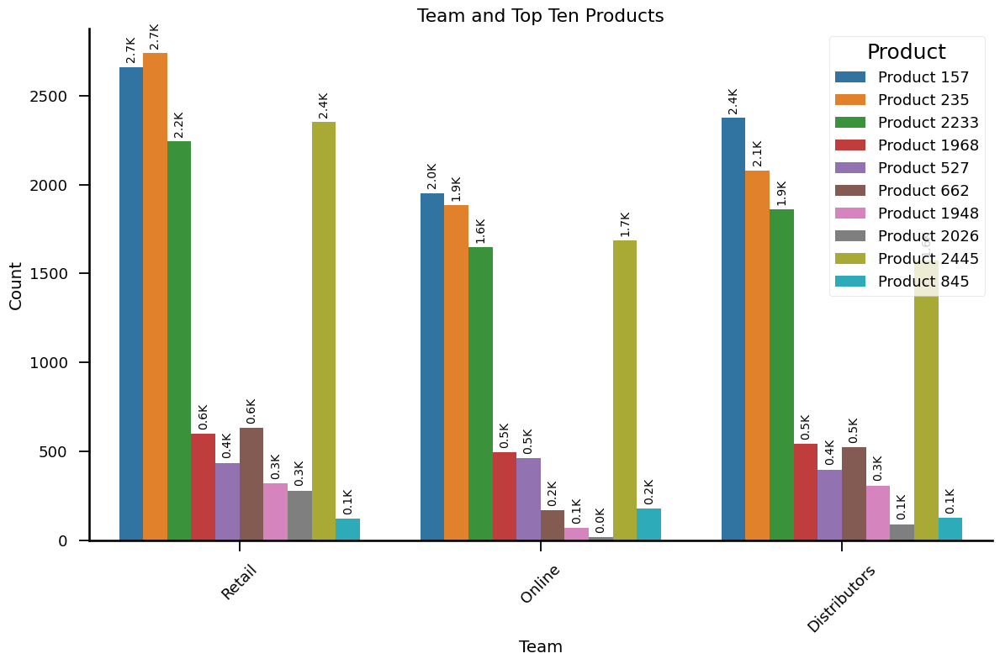

In [832]:
# Step 1: Get the top ten products based on total sales
top_ten_products = merged_df.groupby('Product')['Amount'].sum().nlargest(10).index
# Filter the dataset to include only the top ten products
top_ten_prod= merged_df[merged_df['Product'].isin(top_ten_products)]
plt.figure(figsize=(12, 8))
plot=sns.countplot(x='Team', hue='Product', data=top_ten_prod)
for p in plot.patches:
       if(p.get_height()!=0):
            plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)
sns.despine()
plt.title('Team and Top Ten Products')
plt.xlabel('Team')
plt.ylabel('Count')
plt.xticks(rotation=45)  # Rotate x-labels for better readability
plt.legend(title='Product')
plt.tight_layout()
plt.show()




most products are sold by Retailors and distributor

The best-selling items include oils and wheat flours, while teas and tomato sauces are among the least popular products.

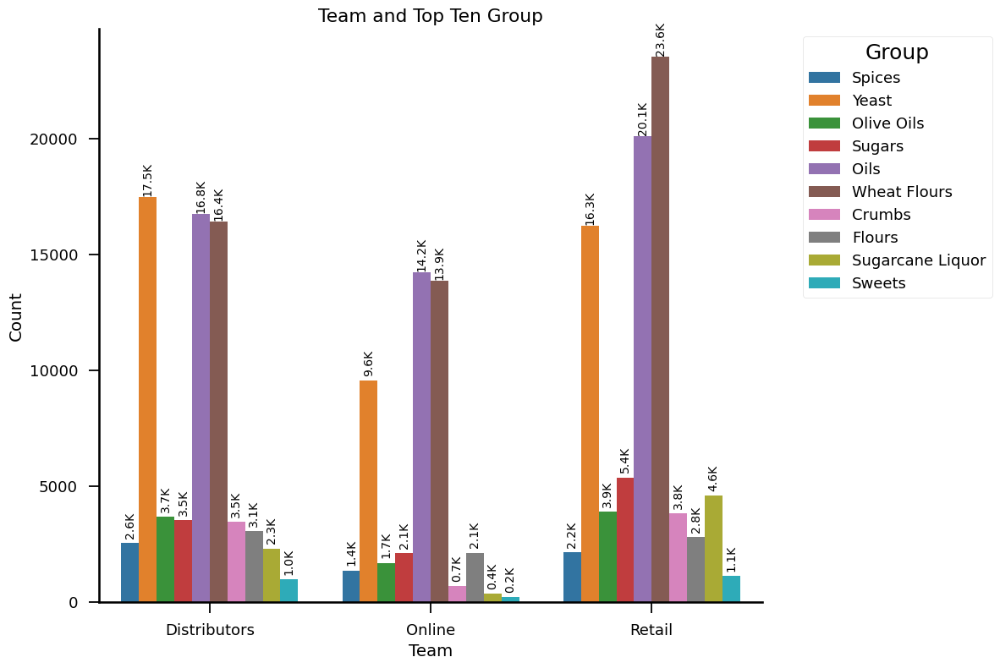

In [983]:
# Step 1: Get the top ten products based on total sales
top_ten_products = merged_df.groupby('Group')['Amount'].sum().nlargest(10).index
# Filter the dataset to include only the top ten products
top_ten_prod= merged_df[merged_df['Group'].isin(top_ten_products)]
plt.figure(figsize=(12, 8))
plot=sns.countplot(x='Team', hue='Group', data=top_ten_prod)
for p in plot.patches:
       if(p.get_height()!=0):
            plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)
sns.despine()
plt.title('Team and Top Ten Group')
plt.xlabel('Team')
plt.ylabel('Count')
#plt.xticks(rotation=45)  # Rotate x-labels for better readability
#plt.legend(title='Group')
plt.legend(title='Group', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

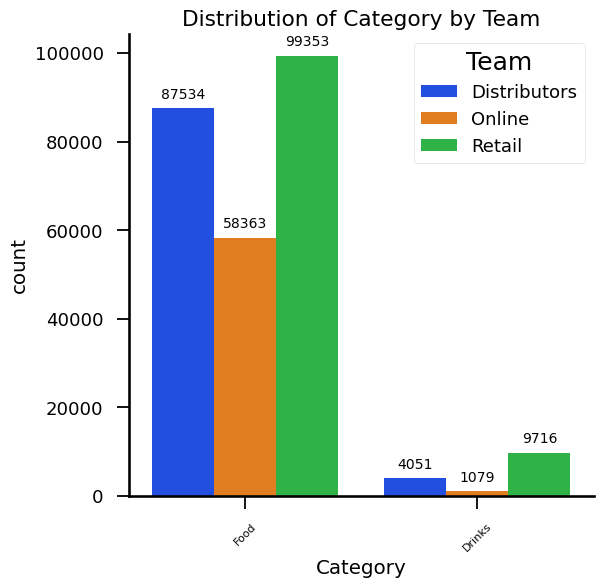

In [833]:
uniplot(merged_df,col='Category',title='Distribution of Category by Team',hue='Team')

- Retailors and Distributors are highest sellers for food and Drinks i.e;37% of Drinks and 38% of food sales are from retailers and 15% drinks and 33% of food are from distributors

Team Composition:
- Distributors: Constituting 35.21% of the workforce, with notable individuals like Akeel Mcleod, Shakeel Durham, and Kien Mcgee.
- Online Team: Representing 22.85% of the workforce, led by prominent figures such as Dominykas Bird, Lorenzo Donovan, and Tatiana Adamson.
- Retailers: Comprising 41.93% of the teams, with diverse leadership from individuals like Ayaana Mackeenzie, Gillian Gonzales, Sahil Seymour, and Serenity Rich.
Statuses:
-Distributors: Notable presence within status A (33.71%), indicating a focus on operational excellence and efficiency.
-Online Team: Follows closely behind with 22.17% within status A.
-Retailers: Lead with the highest percentage within status A (40.85%), showing a commitment to excellence in retail operations.


Product Sales Analysis:
- Retailers and Distributors are key contributors to sales, especially in the food and drinks categories.
- Oils and wheat flours are top-selling items, while teas and tomato sauces rank among the least popular products, indicating shifting consumer preferences and market dynamics.

# BIVARIATE ANALYSIS WRT INVOICE NUMBER
###VARIABLE INVOICE NUMBER

In [251]:
3# Convert 'Invoice Number' to string to maintain its categorical nature
merged_df['Invoice Number'] = merged_df['Invoice Number'].astype(str)
first_10_unique= merged_df['Invoice Number'].unique()[:10]

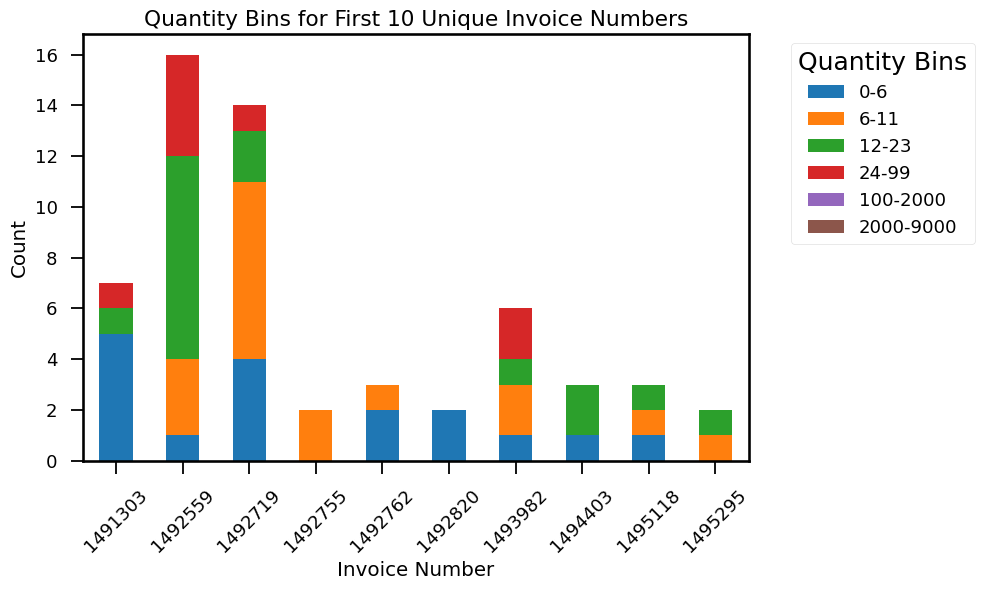

In [252]:
filtered_df = merged_df[merged_df['Invoice Number'].isin(first_10_unique)]

# Group by invoice number and quantity bins, then count the occurrences
grouped = filtered_df.groupby(['Invoice Number', 'Quantity Bins']).size().unstack(fill_value=0)

# Plot the data
grouped.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Quantity Bins for First 10 Unique Invoice Numbers')
plt.xlabel('Invoice Number')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.legend(title='Quantity Bins', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

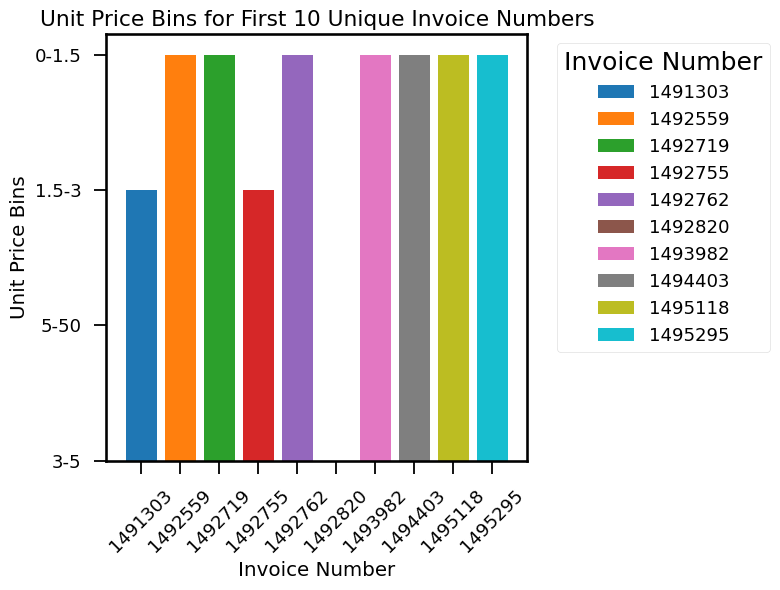

In [253]:
plt.figure(figsize=(8,6))
for invoice_number, group in filtered_df.groupby('Invoice Number'):
    plt.bar(group['Invoice Number'], group['Unit Price Bins'], label=str(invoice_number))

plt.title('Unit Price Bins for First 10 Unique Invoice Numbers')
plt.xlabel('Invoice Number')
plt.ylabel('Unit Price Bins')
plt.legend(title='Invoice Number', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

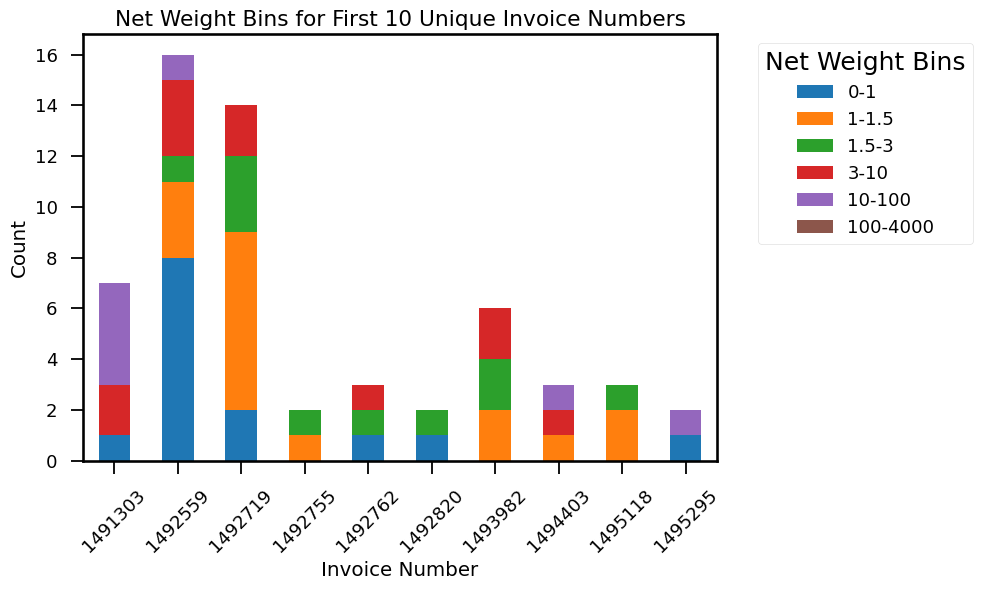

In [254]:
# Group by Invoice Number and Net Weight Bins, then count the occurrences
grouped_in = filtered_df.groupby(['Invoice Number', 'Net Weight Bins']).size().unstack(fill_value=0)

# Plot the bar graph
grouped_in.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Net Weight Bins for First 10 Unique Invoice Numbers')
plt.xlabel('Invoice Number')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.legend(title='Net Weight Bins', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

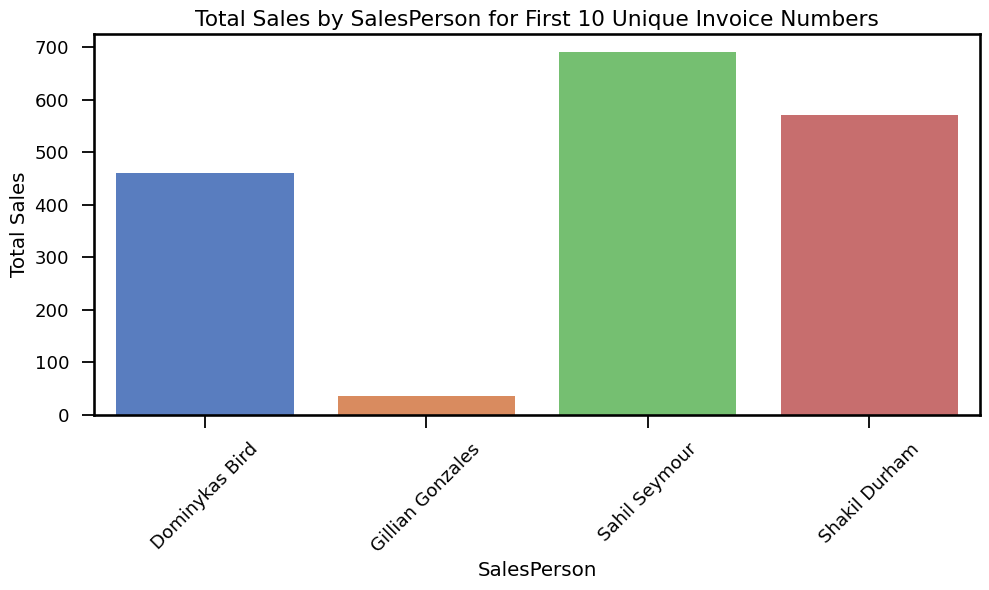

In [255]:
salesperson_sales = filtered_df.groupby('SalesPerson')['Amount'].sum().reset_index()

# Plot the data using seaborn
plt.figure(figsize=(10, 6))
sns.barplot(data=salesperson_sales, x='SalesPerson', y='Amount', palette='muted')
plt.title('Total Sales by SalesPerson for First 10 Unique Invoice Numbers')
plt.xlabel('SalesPerson')
plt.ylabel('Total Sales')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

company

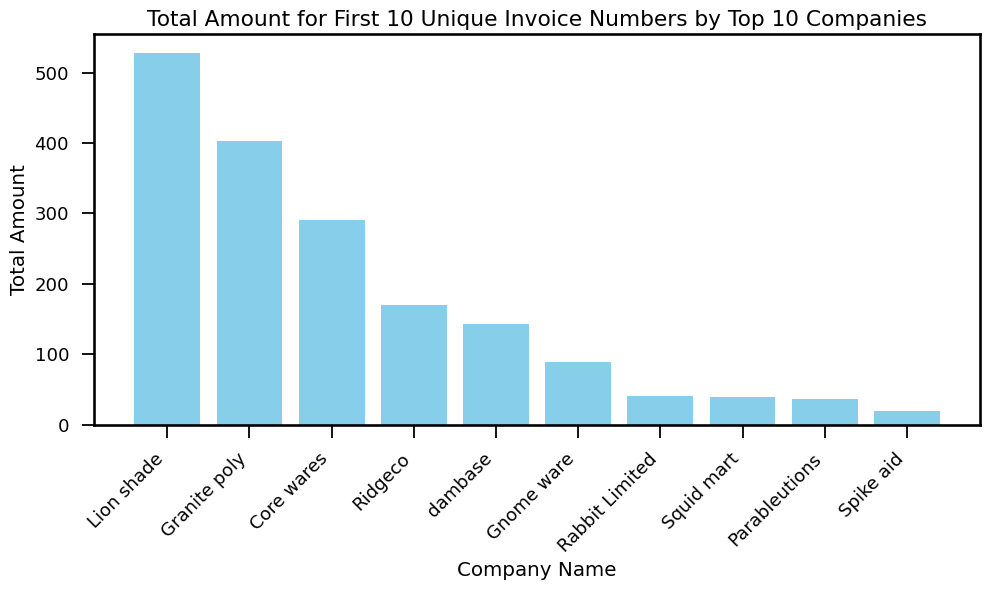

In [256]:
company_total_amount = filtered_df.groupby('Company Name')['Amount'].sum().reset_index()

# Step 3: Find the top 10 companies by total amount
top_10_companies = company_total_amount.nlargest(10, 'Amount')

# Step 4: Plot a bar graph
plt.figure(figsize=(10, 6))
plt.bar(top_10_companies['Company Name'], top_10_companies['Amount'], color='skyblue')
plt.title('Total Amount for First 10 Unique Invoice Numbers by Top 10 Companies')
plt.xlabel('Company Name')
plt.ylabel('Total Amount')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

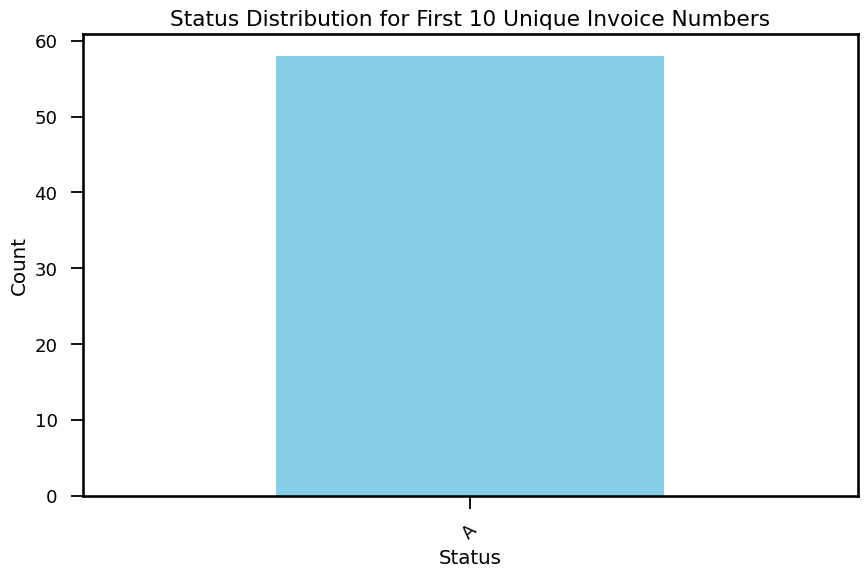

In [257]:
plt.figure(figsize=(10, 6))
filtered_df['Status'].value_counts().plot(kind='bar', color='skyblue')
plt.title('Status Distribution for First 10 Unique Invoice Numbers')
plt.xlabel('Status')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

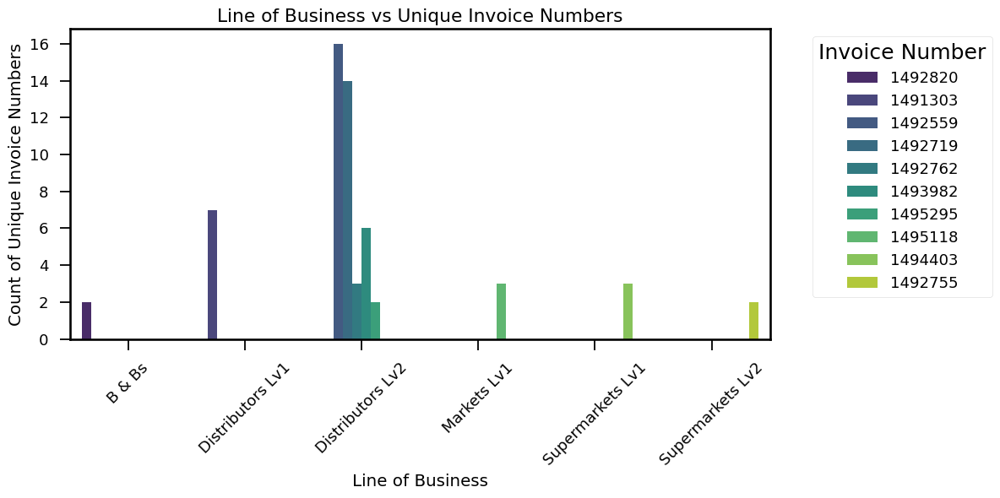

In [258]:


# Filter the data for the first 10 unique invoice numbers
filtered_df = merged_df[merged_df['Invoice Number'].isin(first_10_unique)]

# Group by Line of Business and Invoice Number, then count the unique occurrences of Invoice Number
grouped_df = filtered_df.groupby(['Line of Business', 'Invoice Number']).size().reset_index(name='Count')

# Plot the data using seaborn
plt.figure(figsize=(12, 6))
sns.barplot(data=grouped_df,x='Line of Business', y='Count', hue='Invoice Number', palette='viridis')
plt.title('Line of Business vs Unique Invoice Numbers')
plt.xlabel('Line of Business')
plt.ylabel('Count of Unique Invoice Numbers')
plt.xticks(rotation=45)
plt.legend(title='Invoice Number', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

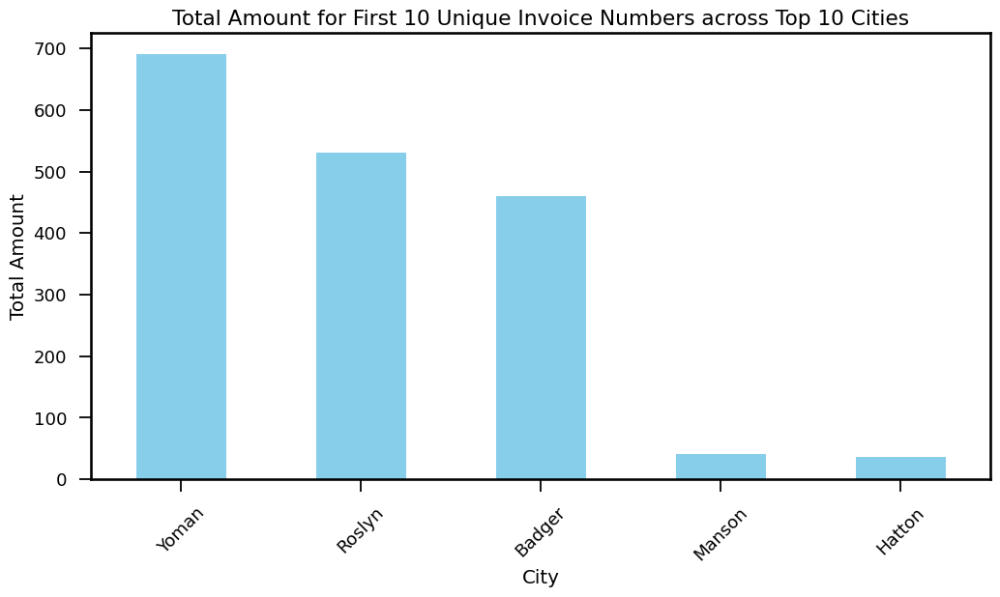

In [259]:
city_amounts = filtered_df.groupby('City')['Amount'].sum().nlargest(10)

# Plot a bar graph
plt.figure(figsize=(12, 6))
city_amounts.plot(kind='bar', color='skyblue')
plt.title('Total Amount for First 10 Unique Invoice Numbers across Top 10 Cities')
plt.xlabel('City')
plt.ylabel('Total Amount')
plt.xticks(rotation=45)
plt.show()

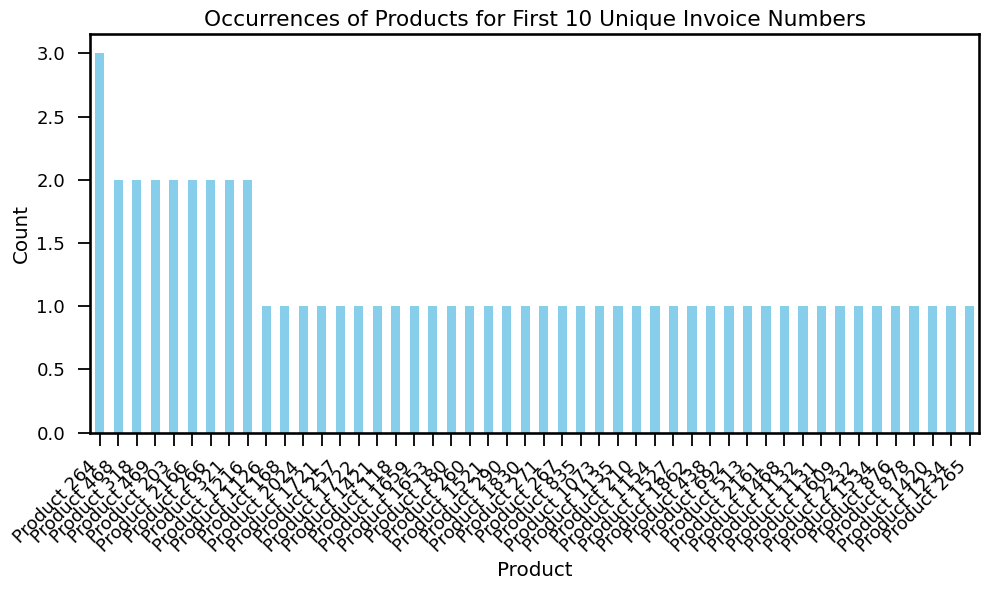

In [260]:
filtered_df = merged_df[merged_df['Invoice Number'].isin(first_10_unique)]

# Group by product and count occurrences
product_counts = filtered_df['Product'].value_counts()

# Plot the bar graph
plt.figure(figsize=(10, 6))
product_counts.plot(kind='bar', color='skyblue')
plt.title('Occurrences of Products for First 10 Unique Invoice Numbers')
plt.xlabel('Product')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

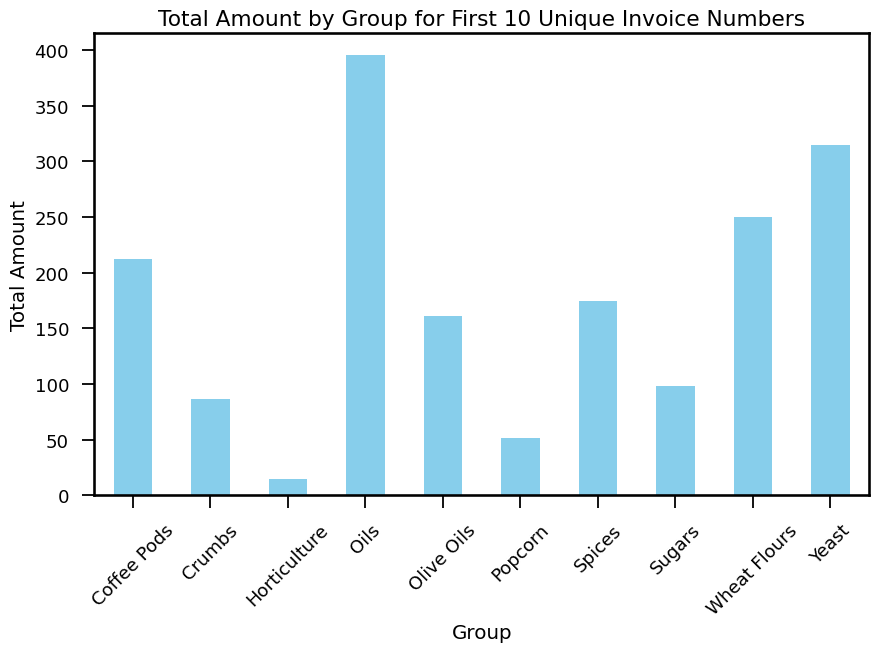

In [261]:

# Group by 'Group' column and calculate the total amount for each group
group_amount = filtered_df.groupby('Group')['Amount'].sum()

# Plot the bar graph
plt.figure(figsize=(10, 6))
group_amount.plot(kind='bar', color='skyblue')
plt.title('Total Amount by Group for First 10 Unique Invoice Numbers')
plt.xlabel('Group')
plt.ylabel('Total Amount')
plt.xticks(rotation=45)
plt.show()

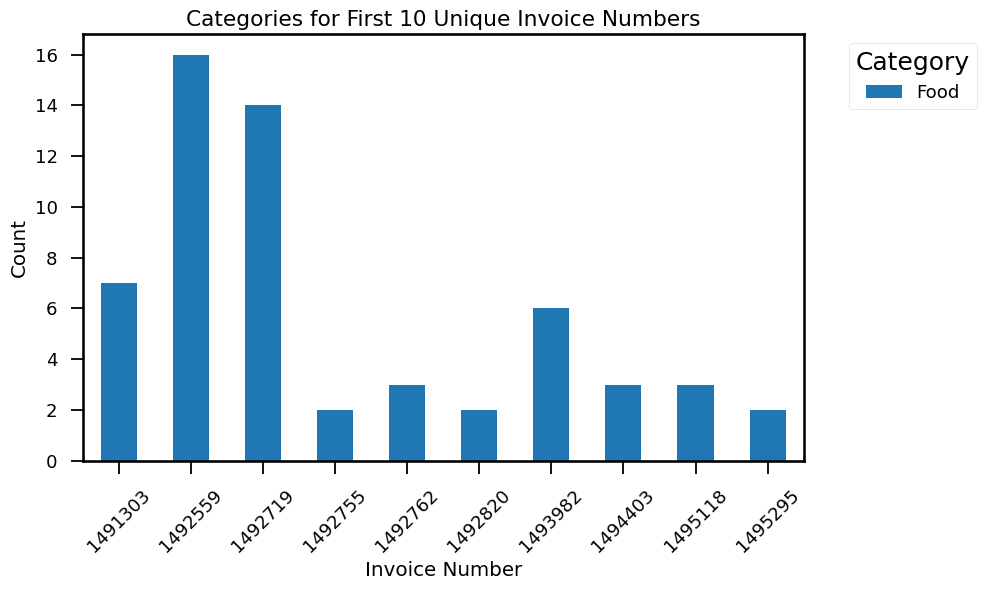

In [262]:
filtered_data = merged_df[merged_df['Invoice Number'].isin(first_10_unique)]
# Group by Invoice Number and Category, then count occurrences
category_counts = filtered_data.groupby(['Invoice Number', 'Category']).size().unstack(fill_value=0)

# Plot the bar graph
category_counts.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Categories for First 10 Unique Invoice Numbers')
plt.xlabel('Invoice Number')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.legend(title='Category', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# BIVARIATE ANALYSIS WRT QUANTITY ITEMS
###Variable Quantity Bins





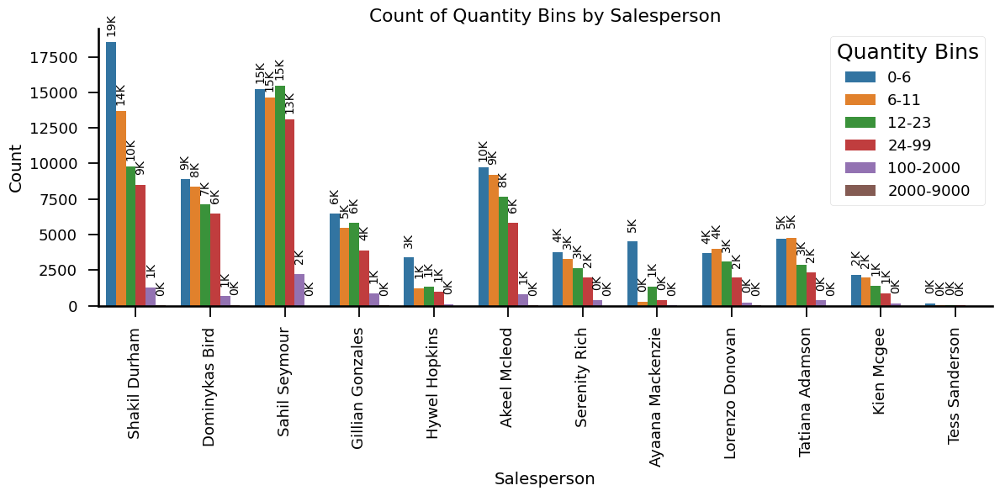

In [876]:
plt.figure(figsize=(12, 6))
plot=sns.countplot(data=merged_df, x='SalesPerson', hue='Quantity Bins')
for p in plot.patches:
    if(p.get_height()!=0):
        plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)

sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1), frameon=False,ncols=6)

sns.despine()
plt.title('Count of Quantity Bins by Salesperson')
plt.xlabel('Salesperson')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.legend(title='Quantity Bins')
plt.tight_layout()
plt.show()

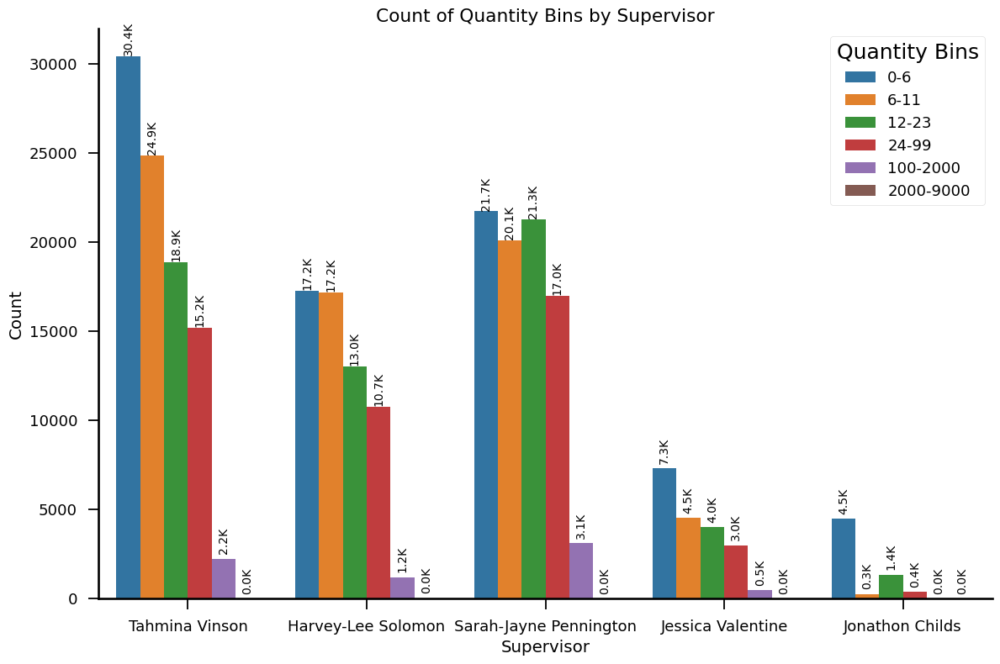

In [873]:
plt.figure(figsize=(12, 8))
plot=sns.countplot(data=merged_df, x='Supervisor', hue='Quantity Bins')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)

sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1), frameon=False,ncols=6)

sns.despine()
plt.title('Count of Quantity Bins by Supervisor')
plt.xlabel('Supervisor')
plt.ylabel('Count')
#plt.xticks(rotation=90)
plt.legend(title='Quantity Bins')
plt.tight_layout()
plt.show()

In [854]:
# Grouping by Net Weight Bins and selecting top 5 Company Name
df_new=pd.DataFrame()
company_counts=[]
for i in merged_df['Quantity Bins'].unique():
    df_new=merged_df[merged_df['Quantity Bins']==i].groupby(['Quantity Bins', 'Company Name']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    company_counts.append(df_new[0:5])
df2=pd.concat(company_counts).reset_index(drop=True)
df2.head(10)

,Quantity Bins,Company Name,count
0,0-6,Prophecy Lighting,1219
1,0-6,Primal Enterprises,775
2,0-6,Wave gate,723
3,0-6,Core wares,697
4,0-6,Pixel Technologies,689
5,6-11,Pixel Technologies,921
6,6-11,Prophecy Lighting,810
7,6-11,Codehow,708
8,6-11,Wave gate,689
9,6-11,Leopard Records,677


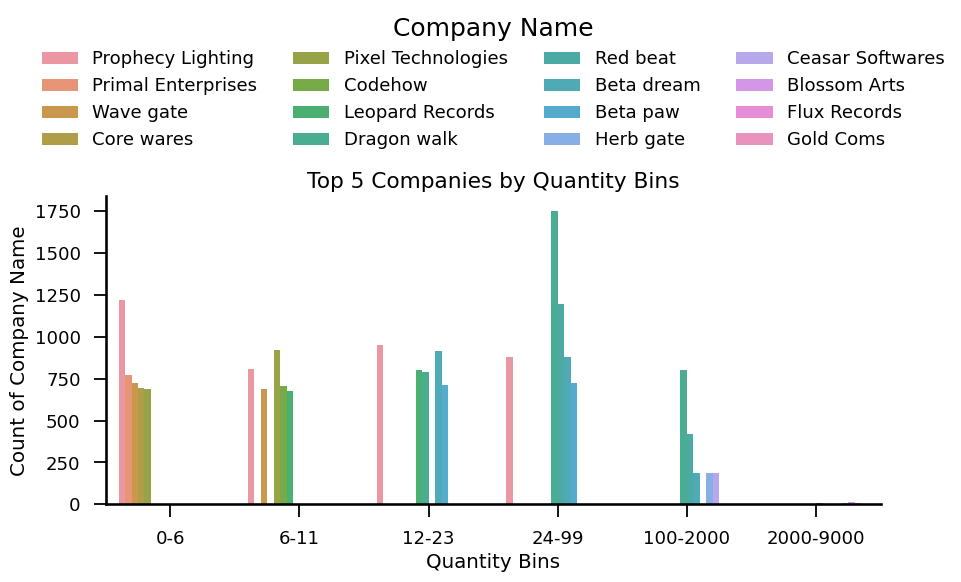

In [859]:
# Plotting the bivariate plot
plt.figure(figsize=(10, 4))
plot=sns.barplot(x='Quantity Bins', y='count',hue='Company Name', data=df2)
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1),ncol=4, frameon=False)

sns.despine()
plt.xlabel('Quantity Bins')
plt.ylabel('Count of Company Name')
plt.title('Top 5 Companies by Quantity Bins')
#plt.xticks(rotation=45)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

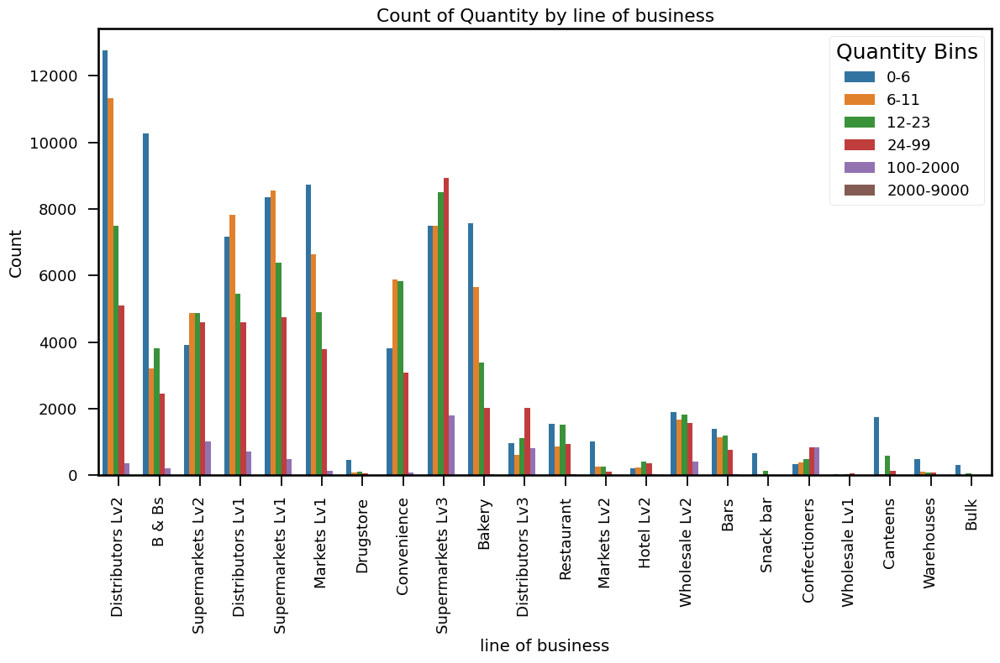

In [846]:
plt.figure(figsize=(12, 8))
sns.countplot(data=merged_df, x='Line of Business', hue='Quantity Bins')
plt.title('Count of Quantity by line of business')
plt.xlabel('line of business')
plt.ylabel('Count')
plt.xticks(rotation=90
          )
plt.legend(title='Quantity Bins')
plt.tight_layout()
plt.show()

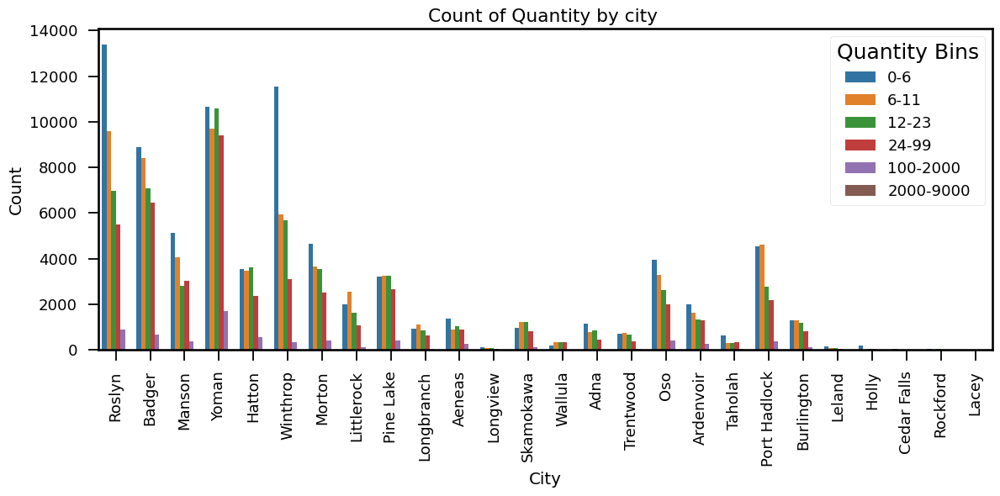

In [850]:
plt.figure(figsize=(12,6))
sns.countplot(data=merged_df, x='City', hue='Quantity Bins')
plt.title('Count of Quantity by city ')
plt.xlabel('City')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.legend(title='Quantity Bins')
plt.tight_layout()
plt.show()

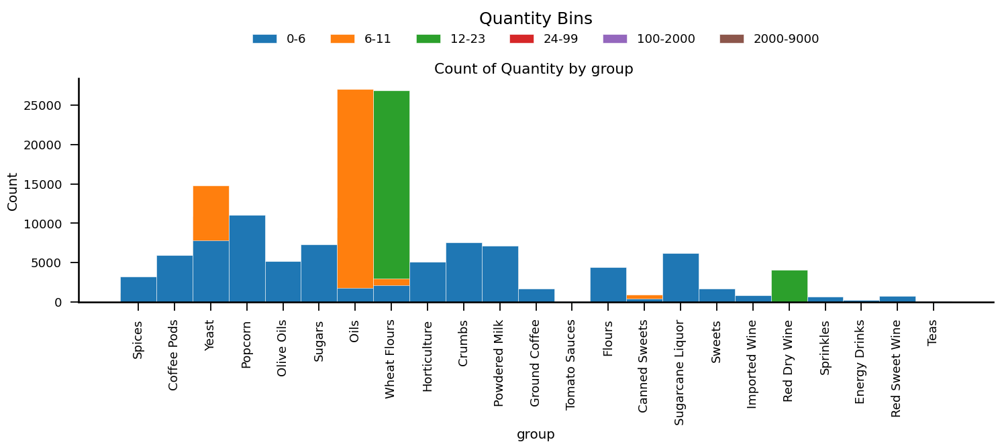

In [980]:
plt.figure(figsize=(15,7))
plot=sns.histplot(data=merged_df, x='Group', hue='Quantity Bins',alpha=1,edgecolor='white')
plt.title('Count of Quantity by group ')
plt.xlabel('group')

sns.despine()
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1), frameon=False,ncols=6)
plt.ylabel('Count')
plt.xticks(rotation=90)
#plt.legend(title='Quantity Bins')
plt.tight_layout()
plt.show()

In [930]:
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Quantity Bins'].unique():
    df_new=merged_df[merged_df['Quantity Bins']==i].groupby(['Quantity Bins', 'Product']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df5=pd.concat(b_counts).reset_index(drop=True)
df5.head(10)

,Quantity Bins,Product,count
0,0-6,Product 157,3922
1,0-6,Product 1154,3543
2,0-6,Product 1527,2843
3,0-6,Product 668,2832
4,0-6,Product 1421,2076
5,6-11,Product 2233,3720
6,6-11,Product 839,3006
7,6-11,Product 157,2688
8,6-11,Product 838,2359
9,6-11,Product 1829,2143


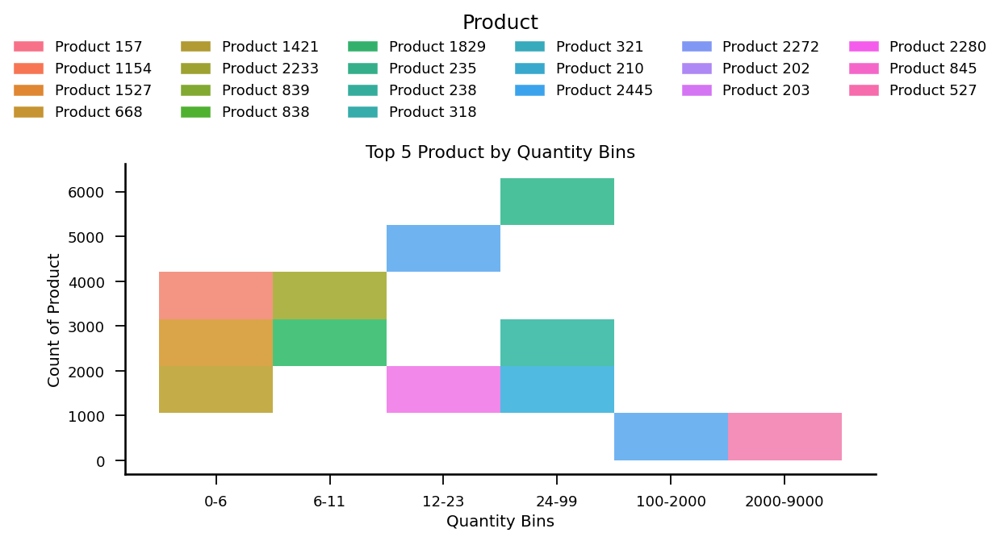

In [932]:
# Plotting the bivariate plot
plt.figure(figsize=(12, 5))
plot=sns.histplot(x='Quantity Bins', y='count',hue='Product', data=df5)

sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1), frameon=False,ncols=6)

sns.despine()
plt.xlabel('Quantity Bins')
plt.ylabel('Count of Product')
plt.title('Top 5 Product by Quantity Bins')
#plt.xticks(rotation=45)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

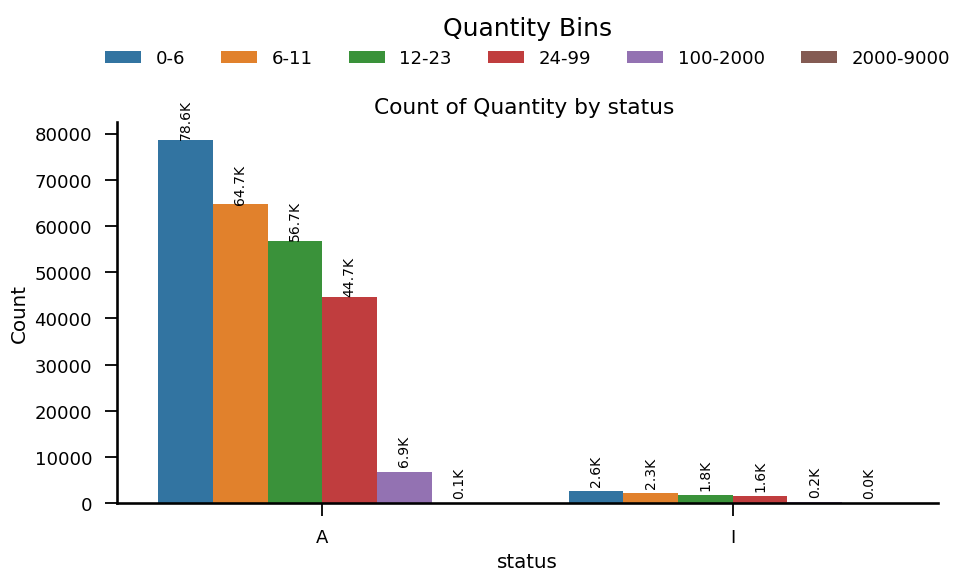

In [870]:
plt.figure(figsize=(10,6))
plot=sns.countplot(data=merged_df, x='Status', hue='Quantity Bins')
plt.title('Count of Quantity by status ')
plt.xlabel('status')
plt.ylabel('Count')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)

sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1), frameon=False,ncols=6)

sns.despine()
#plt.legend(title='Quantity Bins')
plt.tight_layout()
plt.show()

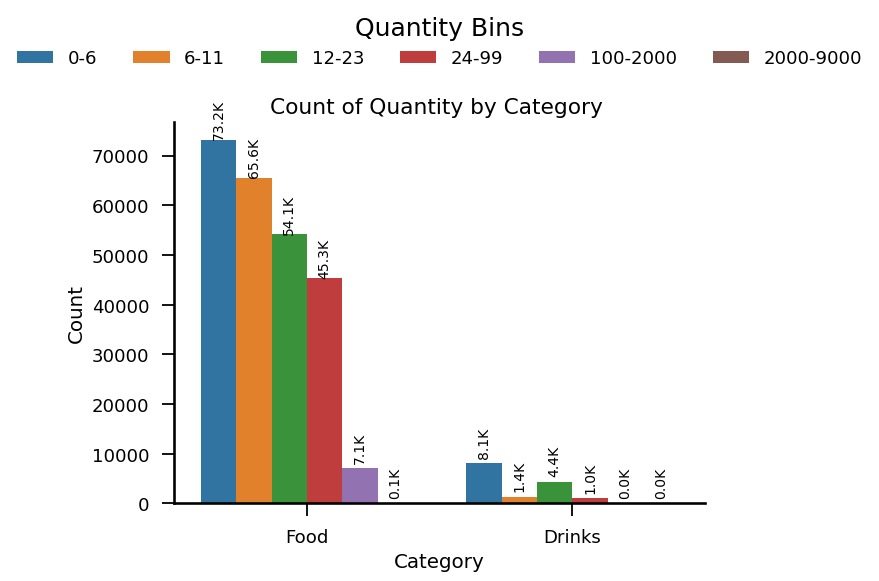

In [886]:
plt.figure(figsize=(8,6))
plot=sns.countplot(data=merged_df, x='Category', hue='Quantity Bins')
plt.title('Count of Quantity by Category ')
plt.xlabel('Category')
plt.ylabel('Count')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)

sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1), frameon=False,ncols=6)

sns.despine()
#plt.legend(title='Quantity Bins')
plt.tight_layout()
plt.show()

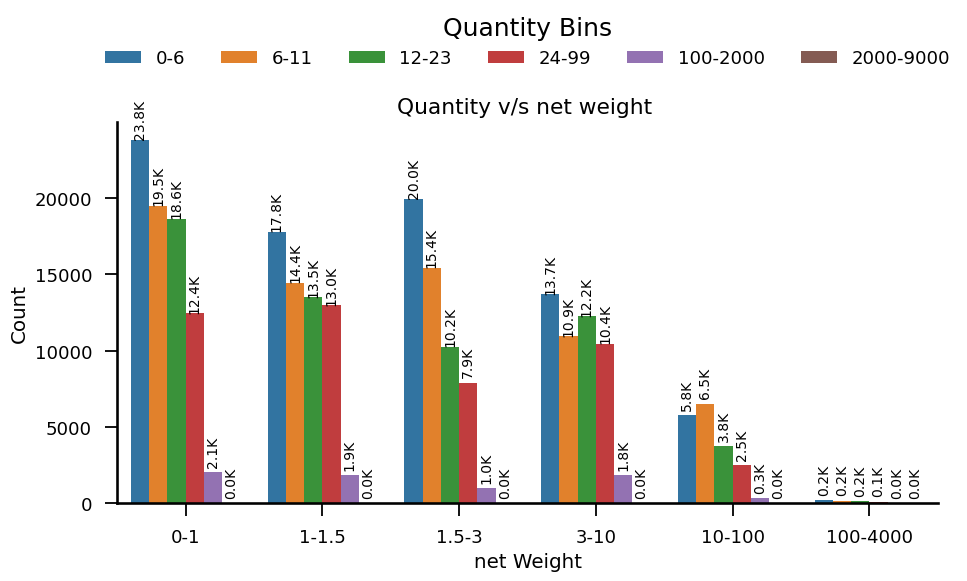

In [878]:
plt.figure(figsize=(10,6))
plot=sns.countplot(data=merged_df, x='Net Weight Bins', hue='Quantity Bins')
plt.title('Quantity v/s net weight ')
plt.xlabel('net Weight')
plt.ylabel('Count')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)

sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1), frameon=False,ncols=6)

sns.despine()
#plt.legend(title='unit price')
plt.tight_layout()
plt.show()

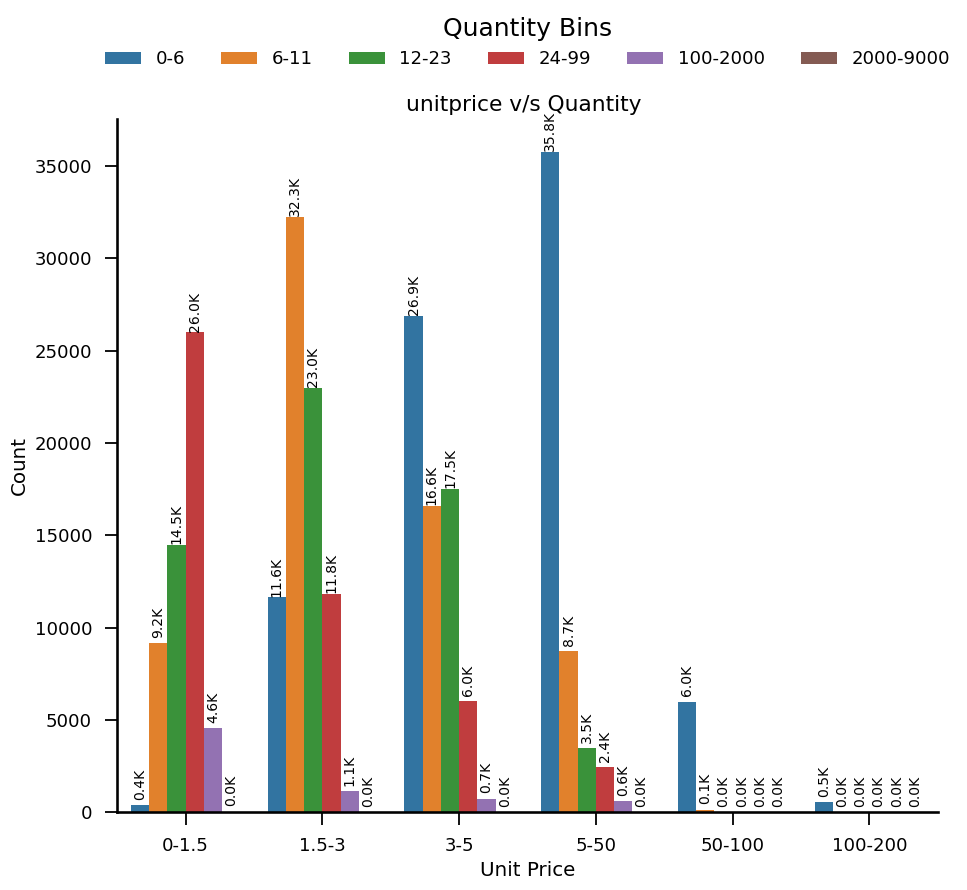

In [883]:
plt.figure(figsize=(10,9))
plot=sns.countplot(data=merged_df, x='Unit Price Bins', hue='Quantity Bins')
plt.title('unitprice v/s Quantity ')
plt.xlabel('Unit Price')
plt.ylabel('Count')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)

sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.05), frameon=False,ncols=6)

sns.despine()
#plt.legend(title='unit price')
plt.tight_layout()
plt.show()



# BIVARIATE ANALYSIS WRT UNIT PRICE

###variable unit price

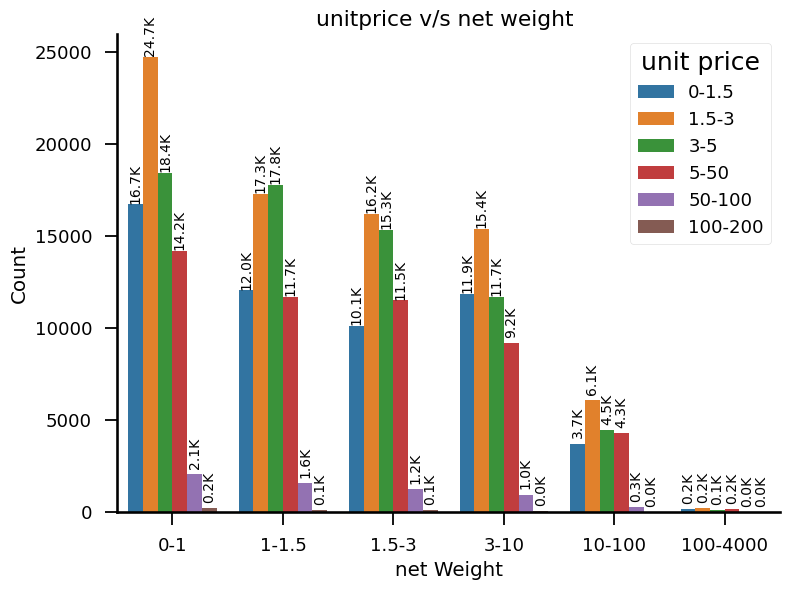

In [888]:
plt.figure(figsize=(8,6))
plot=sns.countplot(data=merged_df, x='Net Weight Bins', hue='Unit Price Bins')
plt.title('unitprice v/s net weight ')
plt.xlabel('net Weight')
plt.ylabel('Count')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)

sns.despine()
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.05), frameon=False,ncols=6)
plt.legend(title='unit price')
plt.tight_layout()
plt.show()

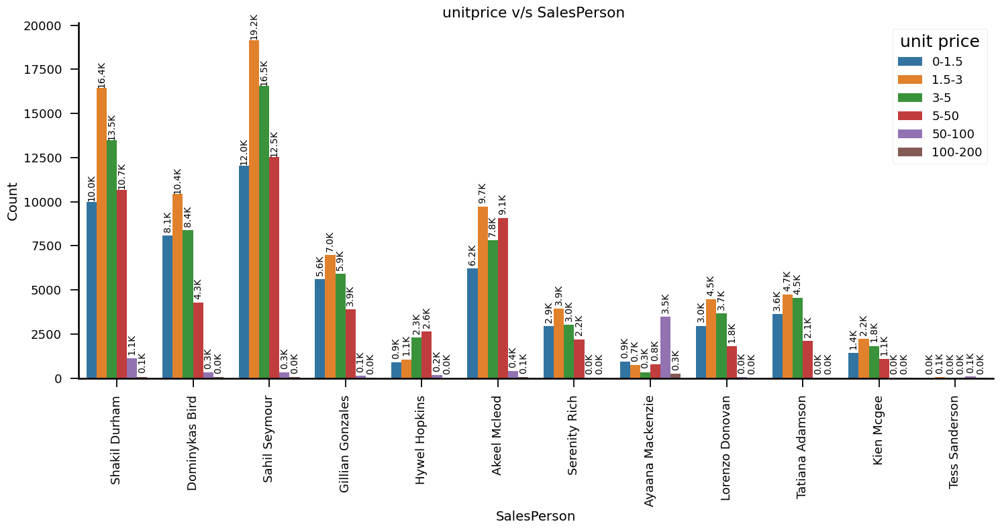

In [923]:
plt.figure(figsize=(15,8))
plot=sns.countplot(data=merged_df, x='SalesPerson', hue='Unit Price Bins')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)

sns.despine()
plt.title('unitprice v/s SalesPerson ')
plt.xlabel('SalesPerson')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.legend(title='unit price')
plt.tight_layout()
plt.show()

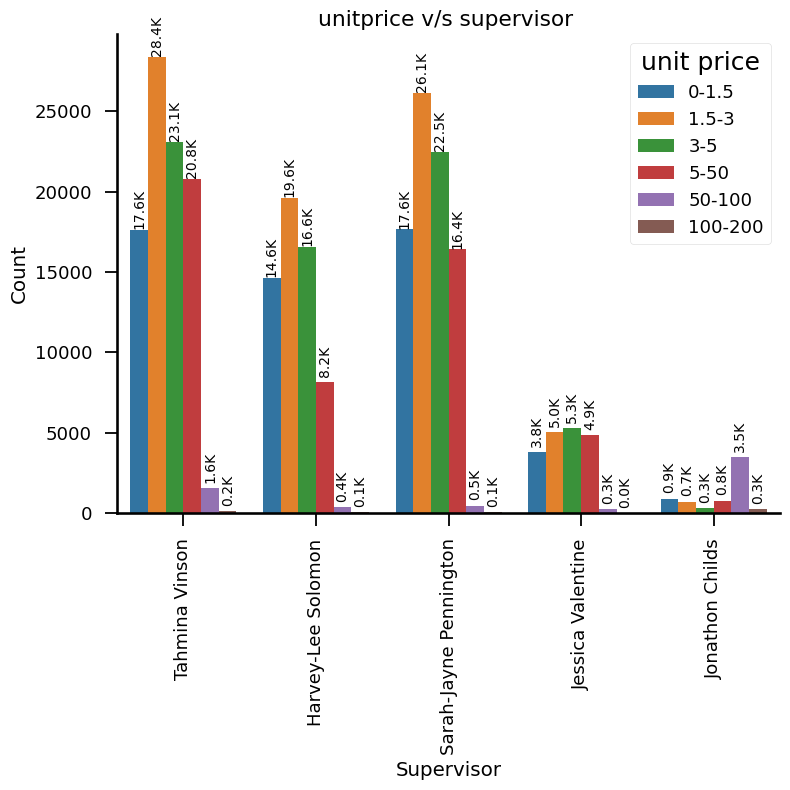

In [897]:
plt.figure(figsize=(8,8))
plot=sns.countplot(data=merged_df, x='Supervisor', hue='Unit Price Bins')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)

sns.despine()

plt.title('unitprice v/s supervisor ')
plt.xlabel('Supervisor')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.legend(title='unit price')
plt.tight_layout()
plt.show()

In [937]:
df_new=pd.DataFrame()
company_counts=[]
for i in merged_df['Unit Price Bins'].unique():
    df_new=merged_df[merged_df['Unit Price Bins']==i].groupby(['Unit Price Bins', 'Product']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    company_counts.append(df_new[0:5])
df2=pd.concat(company_counts).reset_index(drop=True)
df2.head(10)

,Unit Price Bins,Product,count
0,5-50,Product 1421,2464
1,5-50,Product 1603,1801
2,5-50,Product 158,1639
3,5-50,Product 1968,1631
4,5-50,Product 691,1432
5,3-5,Product 157,6677
6,3-5,Product 1154,4181
7,3-5,Product 668,2608
8,3-5,Product 2272,2535
9,3-5,Product 158,2141


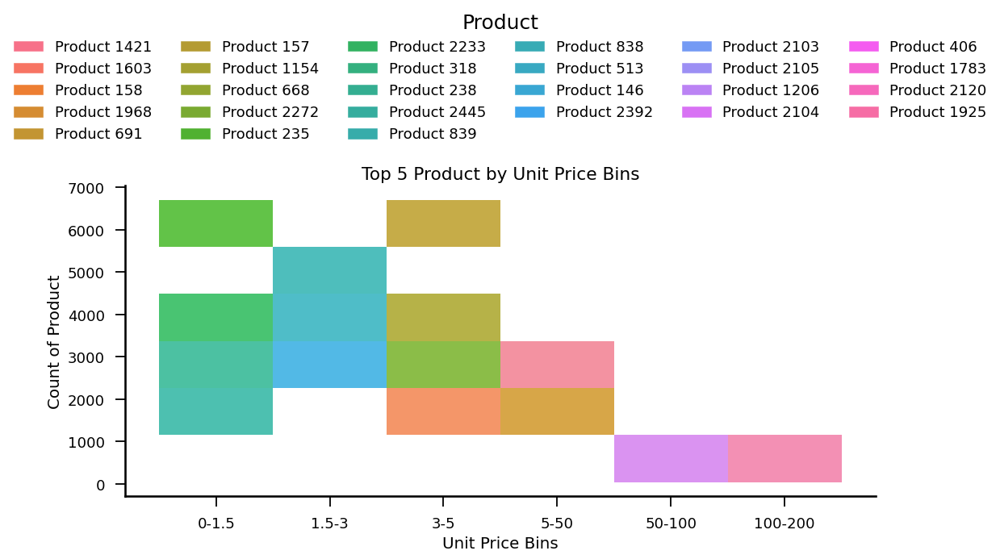

In [938]:
# Plotting the bivariate plot
plt.figure(figsize=(12, 5))
plot=sns.histplot(x='Unit Price Bins', y='count',hue='Product', data=df2)

sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1), frameon=False,ncols=6)

sns.despine()
plt.xlabel('Unit Price Bins')
plt.ylabel('Count of Product')
plt.title('Top 5 Product by Unit Price Bins')
#plt.xticks(rotation=45)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

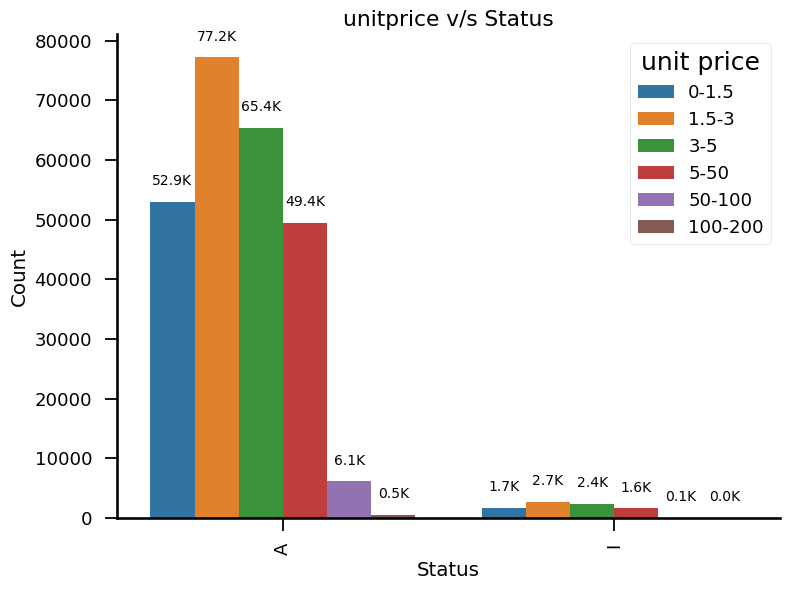

In [902]:
plt.figure(figsize=(8,6))
plot=sns.countplot(data=merged_df, x='Status', hue='Unit Price Bins')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=0)

sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1), frameon=False,ncols=6)

sns.despine()
plt.title('unitprice v/s Status')
plt.xlabel('Status')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.legend(title='unit price')
plt.tight_layout()
plt.show()

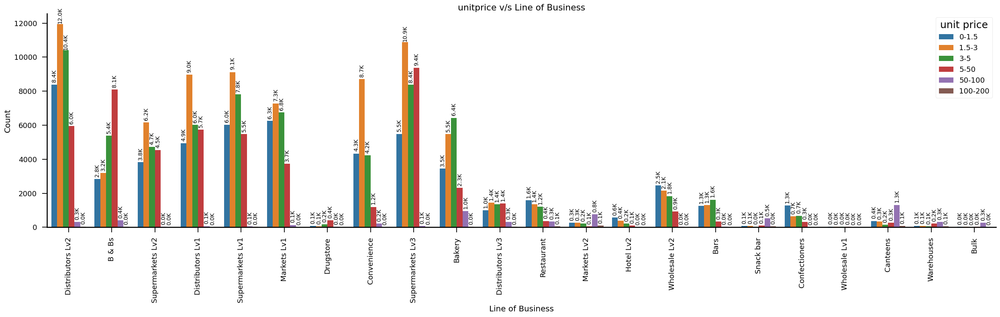

In [905]:
plt.figure(figsize=(25,8))
plot=sns.countplot(data=merged_df, x='Line of Business', hue='Unit Price Bins')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)

sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1), frameon=False,ncols=6)
plt.title('unitprice v/s Line of Business')
plt.xlabel('Line of Business')
plt.ylabel('Count')
sns.despine()
plt.xticks(rotation=90)
plt.legend(title='unit price')
plt.tight_layout()
plt.show()

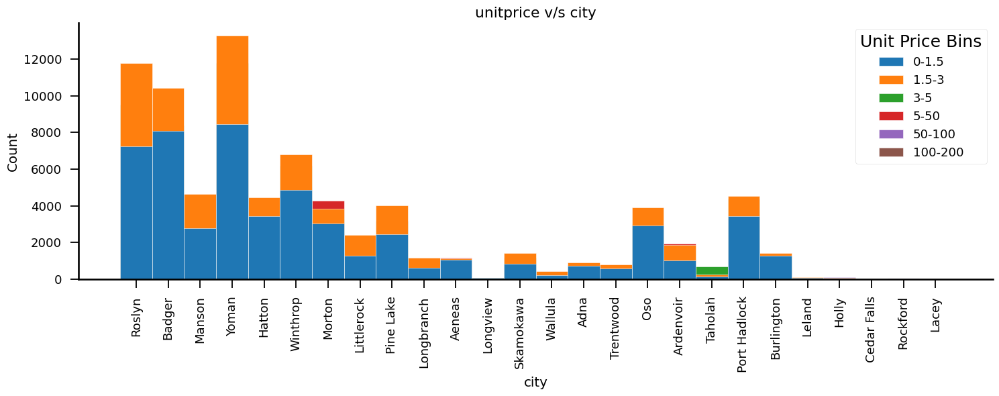

In [944]:
plt.figure(figsize=(15,6))
sns.histplot(data=merged_df, x='City', hue='Unit Price Bins',edgecolor = "white",alpha=1)
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1), frameon=False,ncols=6)

sns.despine()
plt.title('unitprice v/s city')
plt.xlabel('city')
plt.ylabel('Count')
plt.xticks(rotation=90)
#plt.legend(title='unit price')
plt.tight_layout()
plt.show()

In [906]:
# Grouping by Net Weight Bins and selecting top 5 Product
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Unit Price Bins'].unique():
    df_new=merged_df[merged_df['Unit Price Bins']==i].groupby(['Unit Price Bins', 'Product']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df5=pd.concat(b_counts).reset_index(drop=True)
df5.head(10)

,Unit Price Bins,Product,count
0,5-50,Product 1421,2464
1,5-50,Product 1603,1801
2,5-50,Product 158,1639
3,5-50,Product 1968,1631
4,5-50,Product 691,1432
5,3-5,Product 157,6677
6,3-5,Product 1154,4181
7,3-5,Product 668,2608
8,3-5,Product 2272,2535
9,3-5,Product 158,2141


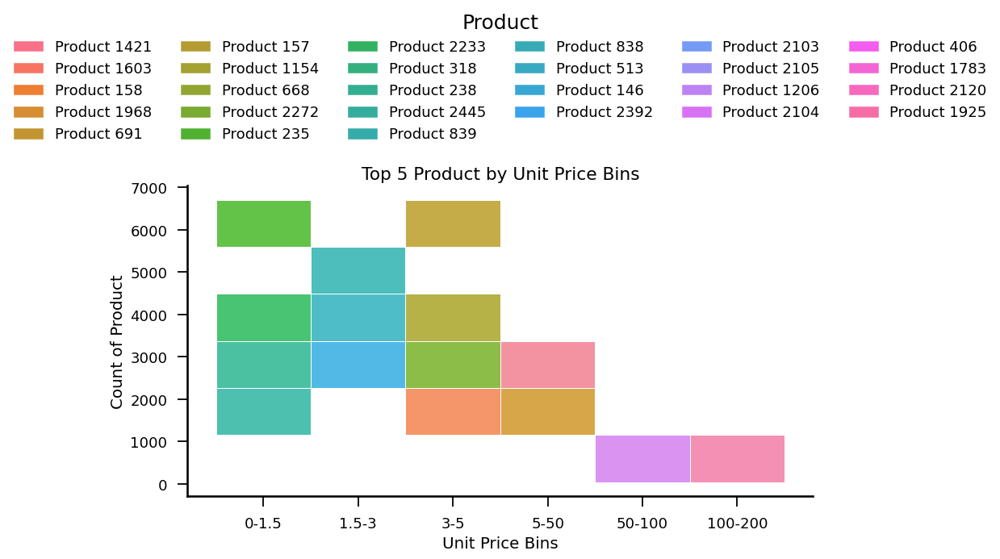

In [921]:
# Plotting the bivariate plot
plt.figure(figsize=(10, 5))
plot=sns.histplot(x='Unit Price Bins', y='count',hue='Product', data=df5,edgecolor = "white",alpha=1)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)

sns.move_legend(plot, "lower center",ncols=6 ,bbox_to_anchor=(.5, 1.1), frameon=False)

sns.despine()
plt.xlabel('Unit Price Bins')
plt.ylabel('Count of Product')
plt.title('Top 5 Product by Unit Price Bins')
#plt.xticks(rotation=45)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

In [963]:
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Unit Price Bins'].unique():
    df_new=merged_df[merged_df['Unit Price Bins']==i].groupby(['Unit Price Bins', 'Group']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:10])
df6=pd.concat(b_counts).reset_index(drop=True)
df6.head(10)

,Unit Price Bins,Group,count
0,5-50,Crumbs,7775
1,5-50,Sugars,5085
2,5-50,Flours,4851
3,5-50,Coffee Pods,4775
4,5-50,Olive Oils,4097
5,5-50,Wheat Flours,3843
6,5-50,Spices,3637
7,5-50,Horticulture,3595
8,5-50,Powdered Milk,3098
9,5-50,Sweets,2370


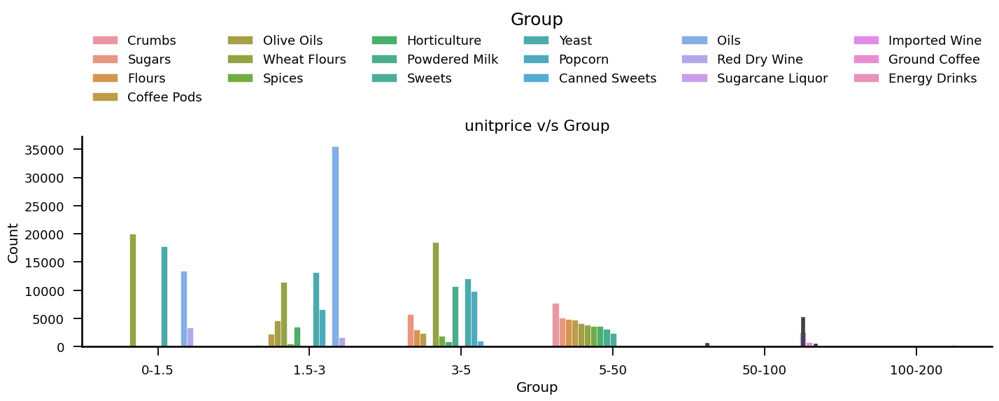

In [970]:
plt.figure(figsize=(15,6))
plot=sns.barplot(data=df6, hue='Group', x='Unit Price Bins',y='count',edgecolor = "white",alpha=1)
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1), frameon=False,ncols=6)

sns.despine()
plt.title('unitprice v/s Group')
plt.xlabel('Group')
plt.ylabel('Count')
#plt.xticks(rotation=90)
#plt.legend(title='unit price')
plt.tight_layout()
plt.show()

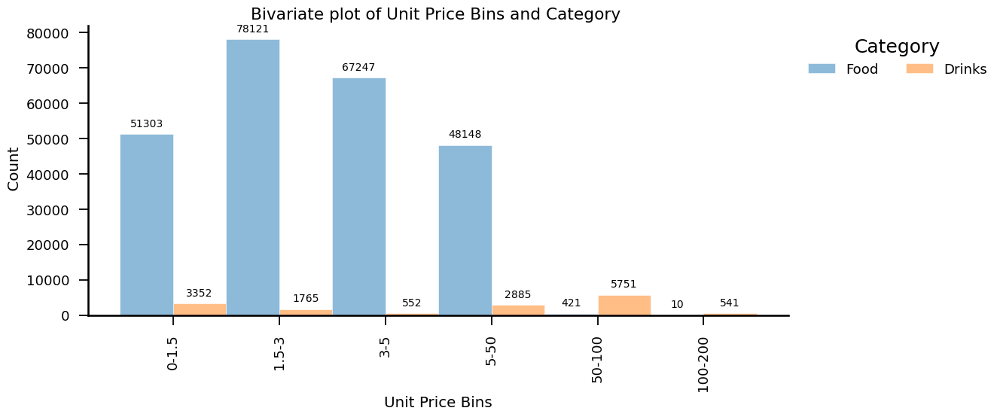

In [956]:
plt.figure(figsize=(12,5))
plot = sns.histplot(data=merged_df, x="Unit Price Bins",hue='Category',multiple='dodge',edgecolor = "white",alpha=0.5)
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1), frameon=False)
for p in plot.patches:
       if(p.get_height()!=0) :
            plot.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points',rotation=0)
sns.despine()
sns.despine()
sns.move_legend(plot, "upper left", bbox_to_anchor=(1.01, 1),ncol=2)

plt.xticks(rotation=90)
sns.despine()
plt.xlabel('Unit Price Bins')
plt.ylabel(' Count')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Unit Price Bins and Category ')
plt.show()

# BIVARIATE ANALYSIS WRT TO ISSUE DATE,ORDER MONTH,ORDER YEAR

## 1.Invoice Number

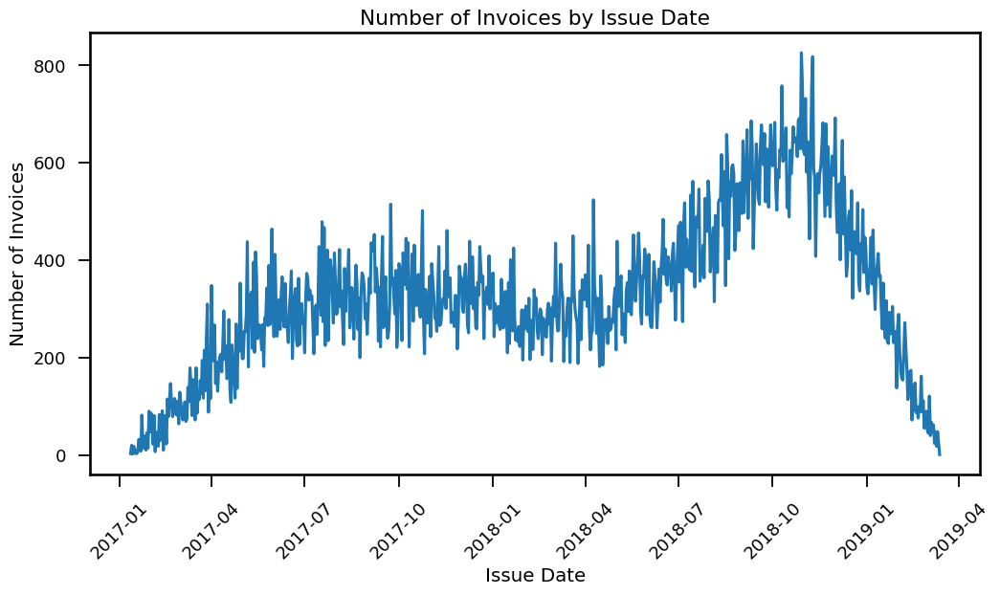

In [279]:
# Plotting the bivariate plot
invoice_counts = merged_df['Issue Date'].value_counts().sort_index()


plt.figure(figsize=(12, 6))
sns.lineplot(x=invoice_counts.index, y=invoice_counts.values)
plt.xlabel('Issue Date')
plt.ylabel('Number of Invoices')
plt.title('Number of Invoices by Issue Date')
plt.xticks(rotation=45)
plt.show()

In [280]:
merged_df['Order Month'].unique()


[1, 2, 3, 4, 5, ..., 8, 9, 10, 11, 12]
Length: 12
Categories (12, int32): [1, 2, 3, 4, ..., 9, 10, 11, 12]

In [537]:
# Grouping by Order Month and selecting top 5 invoice numbers
df_new=pd.DataFrame()
monthly_top_invoice=[]
for i in merged_df['Order Month'].unique():
    df_new=merged_df[merged_df['Order Month']==i].groupby(['Order Month','Invoice Number']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    monthly_top_invoice.append(df_new[0:3])
df=pd.concat(monthly_top_invoice).reset_index(drop=True)
df.head()

,Order Month,Invoice Number,count
0,1,2170219,86
1,1,1829249,62
2,1,1792340,61
3,2,1509369,48
4,2,1805793,44


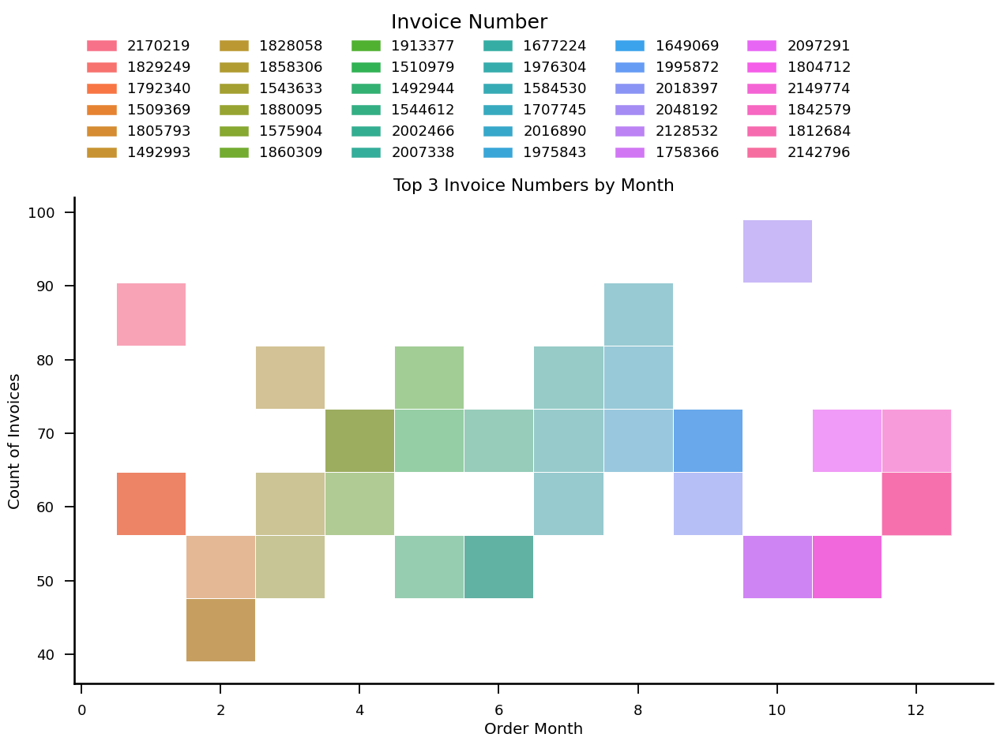

In [544]:
# Plotting the bivariate plot
plt.figure(figsize=(15,8))
plot=sns.histplot(x='Order Month', y='count',hue='Invoice Number', data=df,multiple='stack',alpha=0.5,edgecolor = "white")
sns.despine()
sns.move_legend(plot, "lower left", bbox_to_anchor=(0, 1.05),ncols=6, frameon=False)
plt.xlabel('Order Month')
plt.ylabel('Count of Invoices')
plt.title('Top 3 Invoice Numbers by Month')
#plt.xticks(rotation=45)
#plt.legend(title='Invoice Number', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

In [546]:
# Grouping by Order Year and selecting top 10 invoice numbers
df1_new=pd.DataFrame()
yearly_top_invoice=[]
for i in merged_df['Order Year'].unique():
    df1_new=merged_df[merged_df['Order Year']==i].groupby(['Order Year','Invoice Number']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    yearly_top_invoice.append(df1_new[0:10])
df2=pd.concat(yearly_top_invoice).reset_index(drop=True)
df2.head()

,Order Year,Invoice Number,count
0,2017,1707745,82
1,2017,1677224,74
2,2017,1649069,72
3,2017,1575904,69
4,2017,1510979,68


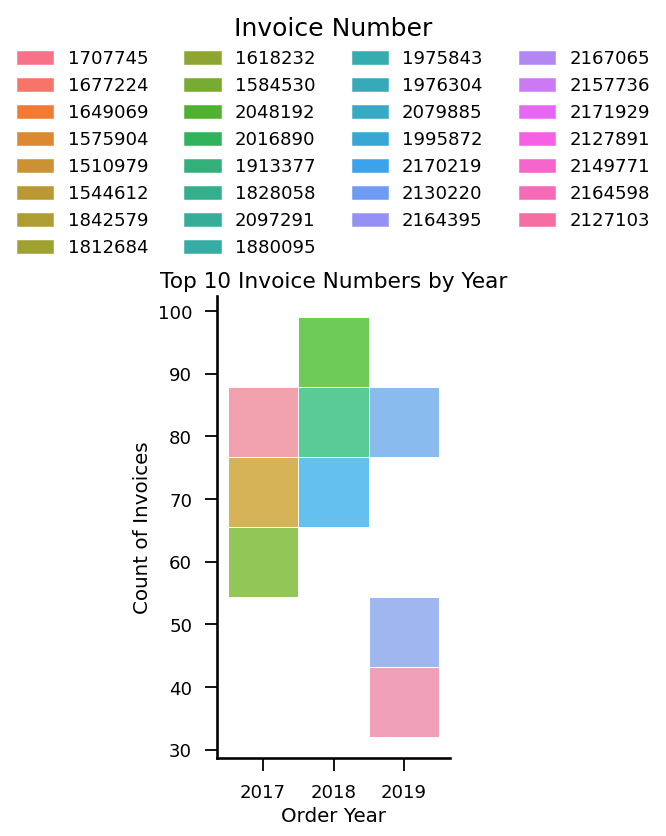

In [665]:
# Plotting the bivariate plot
plt.figure(figsize=(3, 6))
plot=sns.histplot(x='Order Year', y='count',hue='Invoice Number', data=df2 ,multiple='stack',edgecolor = "white")
sns.despine()
sns.move_legend(plot, "lower center", bbox_to_anchor=(0.5, 1.05),ncols=4, frameon=False)

sns.despine()
plt.xlabel('Order Year')
plt.ylabel('Count of Invoices')
plt.title('Top 10 Invoice Numbers by Year')
#plt.xticks(rotation=45)
#plt.legend(title='Invoice Number', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

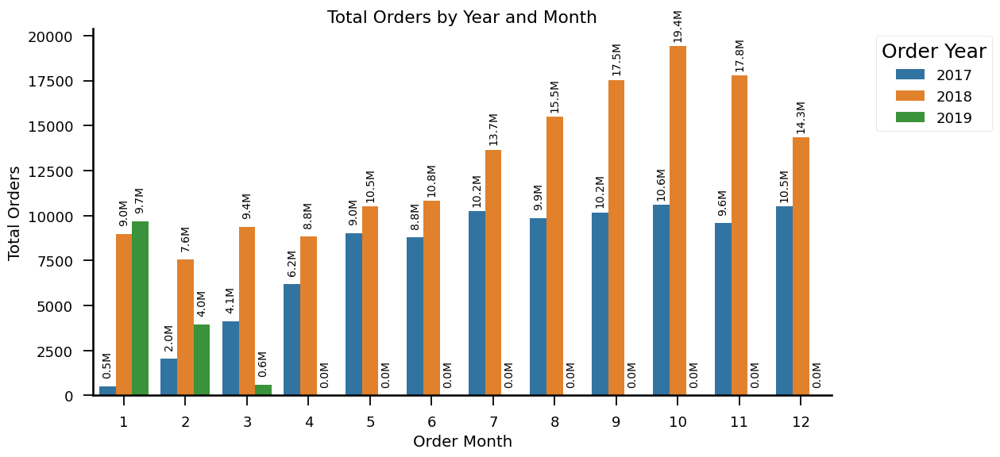

In [481]:
# Calculate total orders by year and month
total_orders_by_year_month = merged_df.groupby(['Order Year', 'Order Month'])['Invoice Number'].size().reset_index(name='count')

# Define the order of months
month_order = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12']


plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Month', y='count', hue='Order Year', data=total_orders_by_year_month)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('Order Month')
plt.ylabel('Total Orders')
plt.title('Total Orders by Year and Month')
#plt.xticks(rotation=45)
plt.legend(title='Order Year', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 2. QTY ITEMS

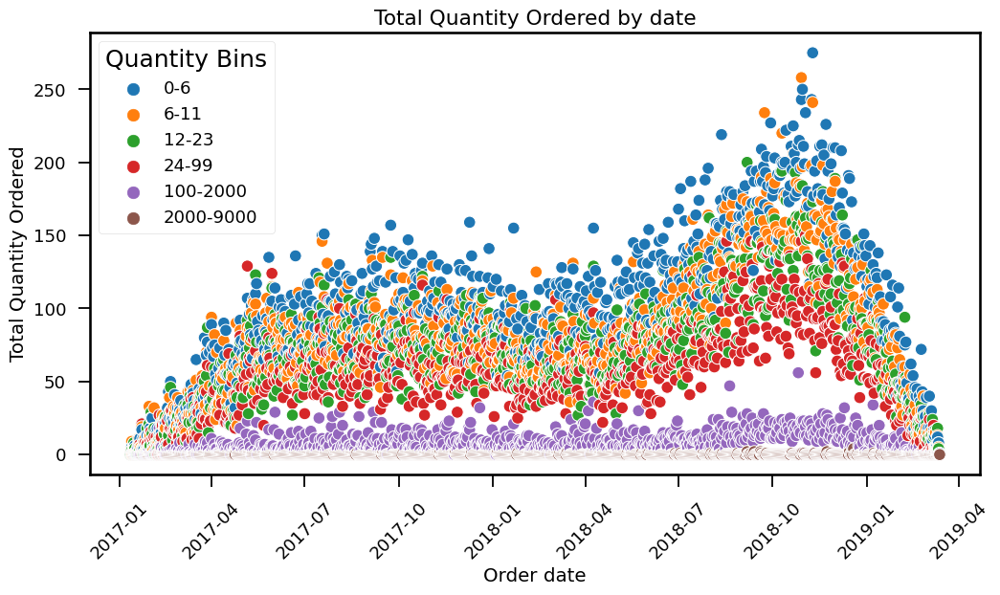

In [286]:
total_quantity_by_date = merged_df.groupby('Issue Date')['Quantity Bins'].value_counts().reset_index(name='count')

# Issue Date vs. Qty Items (Numerical)
plt.figure(figsize=(12, 6))
sns.scatterplot(x='Issue Date',y='count', hue='Quantity Bins', data=total_quantity_by_date)
plt.xticks(rotation=45)
plt.xlabel('Order date')
plt.ylabel('Total Quantity Ordered')
plt.title('Total Quantity Ordered by date')
plt.show()

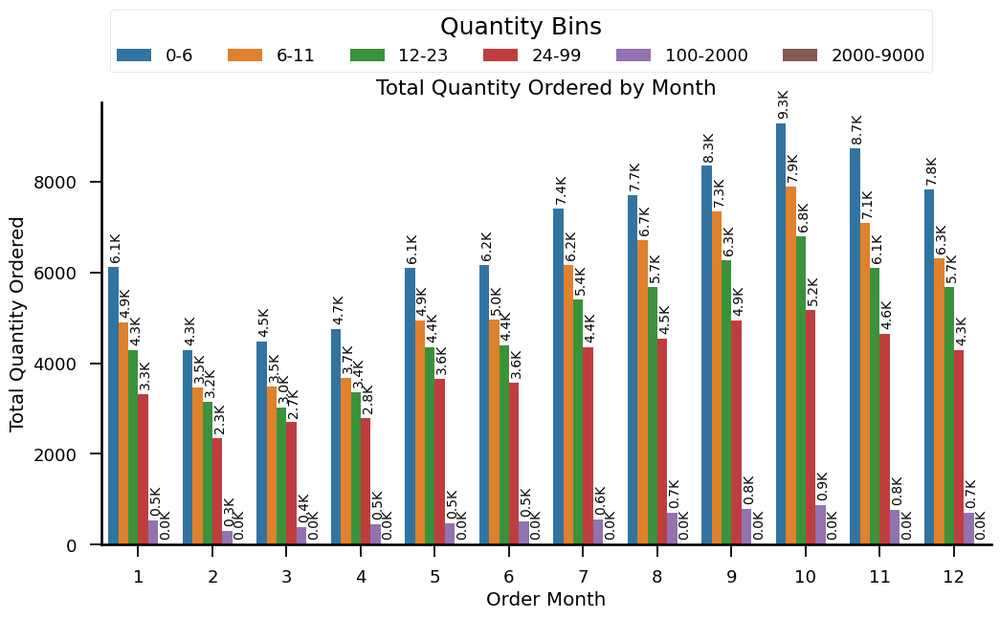

In [559]:
# Order Month vs. Qty Items (Categorical)
total_quantity_by_month = merged_df.groupby('Order Month')['Quantity Bins'].value_counts().reset_index(name='count')
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Month',y='count', hue='Quantity Bins', data=total_quantity_by_month)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(2, 15), textcoords='offset points',rotation=90)
sns.despine()
sns.move_legend(plot, "lower left", bbox_to_anchor=(0, 1.05),ncols=6)
#plt.xticks(rotation=45)
plt.xlabel('Order Month')
plt.ylabel('Total Quantity Ordered')
plt.title('Total Quantity Ordered by Month')
plt.show()

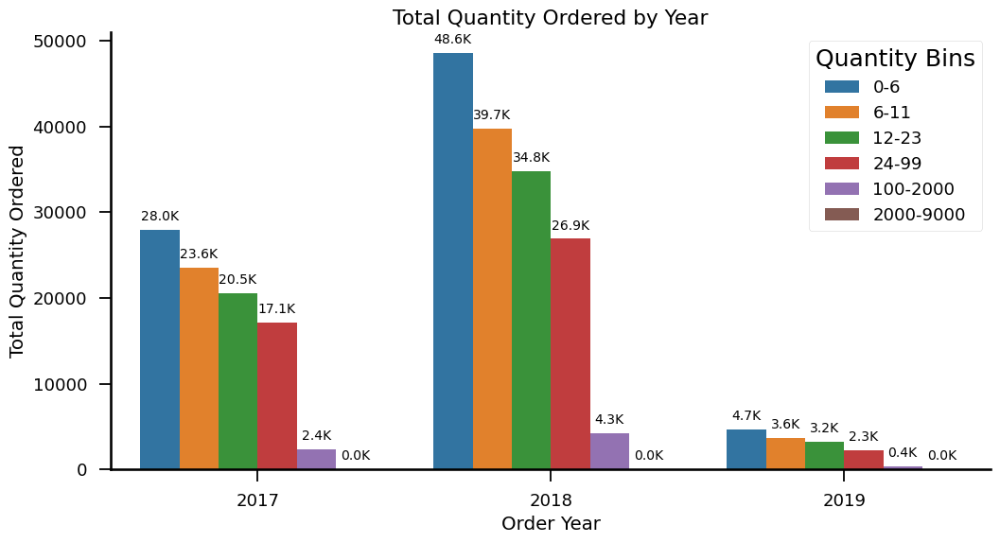

In [288]:
# Calculate total quantity ordered by year
total_quantity_by_Year = merged_df.groupby('Order Year')['Quantity Bins'].value_counts().reset_index()

# Plotting the bivariate plot
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Year', y='count', hue='Quantity Bins', data=total_quantity_by_Year)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
plt.xlabel('Order Year')
plt.ylabel('Total Quantity Ordered')
plt.title('Total Quantity Ordered by Year')
#plt.xticks(rotation=45)
plt.show()

## 3. Net Weight

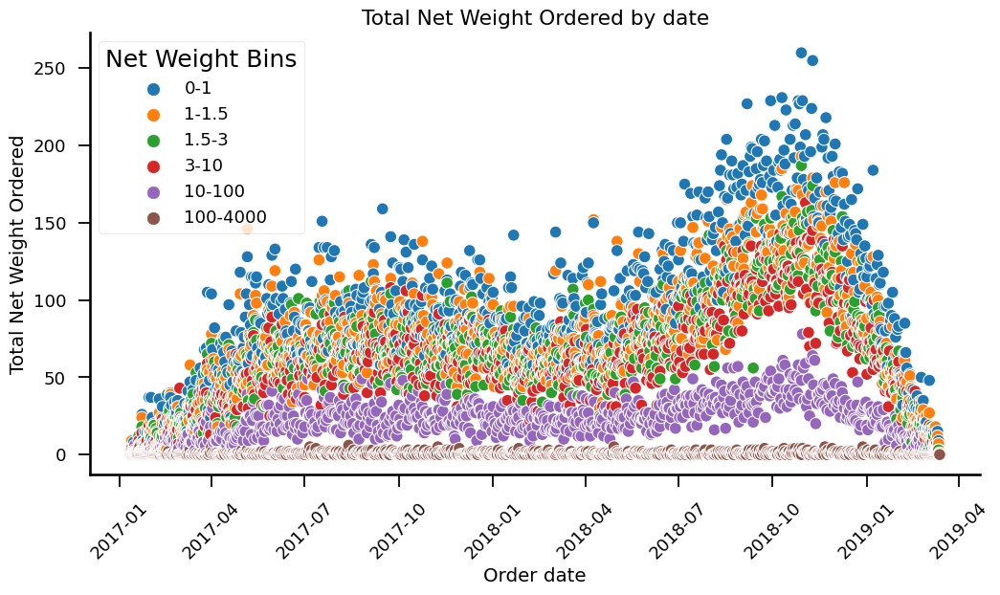

In [480]:
# Issue Date vs. Net Weight (Numerical)
total_wt_by_date = merged_df.groupby('Issue Date')['Net Weight Bins'].value_counts().reset_index(name='count')

# Issue Date vs. Net Weight (Numerical)
plt.figure(figsize=(12, 6))
sns.scatterplot(x='Issue Date',y='count', hue='Net Weight Bins', data=total_wt_by_date)

sns.despine()
plt.xticks(rotation=45)
plt.xlabel('Order date')
plt.ylabel('Total Net Weight Ordered')
plt.title('Total Net Weight Ordered by date')
plt.xticks(rotation=45)
plt.show()







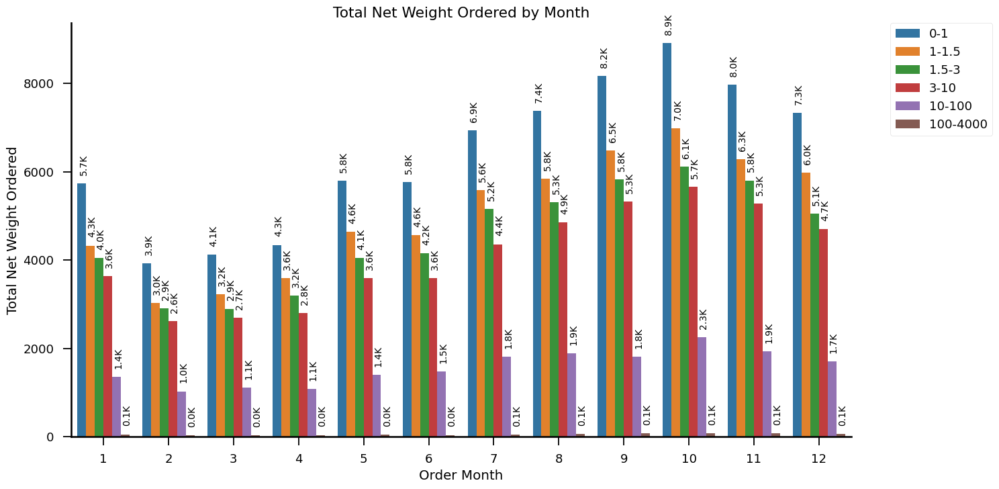

In [479]:
# Calculate total quantity ordered by month
total_wt_by_month = merged_df.groupby('Order Month')['Net Weight Bins'].value_counts().reset_index(name='count')

# Plotting the bivariate plot
plt.figure(figsize=(15, 8))
plot=sns.barplot(x='Order Month', y='count',hue='Net Weight Bins', data=total_wt_by_month)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(2, 20), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('Order Month')
plt.ylabel('Total Net Weight Ordered')
plt.title('Total Net Weight Ordered by Month')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
#plt.xticks(rotation=45)
plt.show()

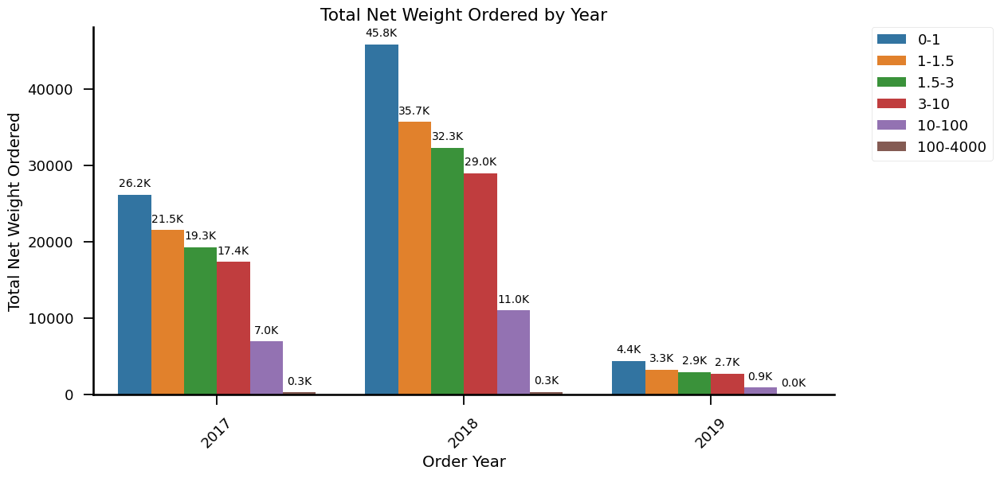

In [291]:
# Calculate total quantity ordered by year
total_wt_by_Year = merged_df.groupby('Order Year')['Net Weight Bins'].value_counts().reset_index(name='count')

# Plotting the bivariate plot
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Year', y='count',hue='Net Weight Bins', data=total_wt_by_Year)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
plt.xlabel('Order Year')
plt.ylabel('Total Net Weight Ordered')
plt.title('Total Net Weight Ordered by Year')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.xticks(rotation=45)
plt.show()

# 4. Salesperson

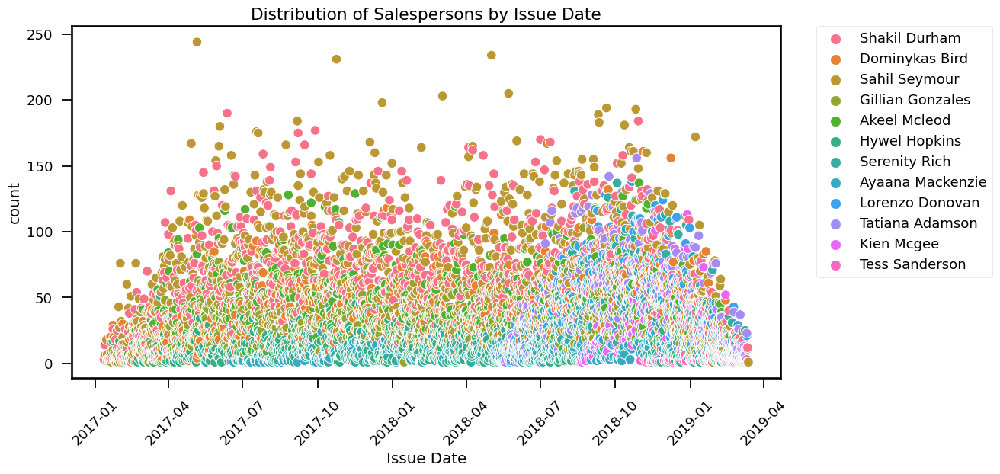

In [292]:
total_salesperson_by_date = merged_df.groupby(['Issue Date', 'SalesPerson']).size().reset_index(name='count')

# Issue Date vs. SalesPerson (Categorical)
plt.figure(figsize=(12, 6))
sns.scatterplot(x='Issue Date',y='count', data=total_salesperson_by_date, hue='SalesPerson')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Distribution of Salespersons by Issue Date')
plt.xticks(rotation=45)
plt.show()

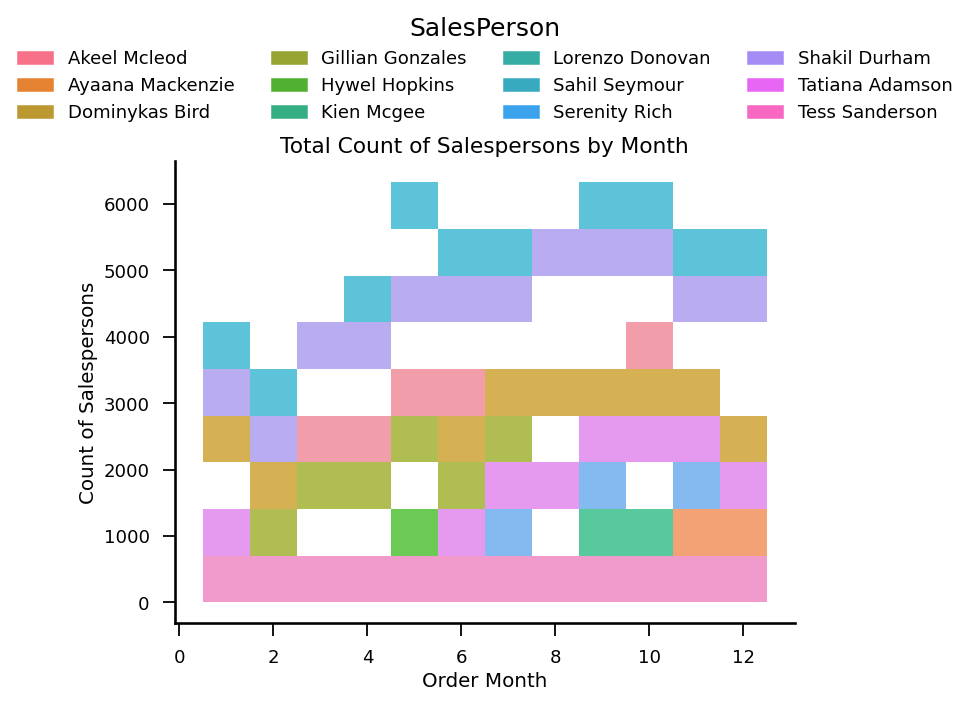

In [569]:
total_salesperson_by_month = merged_df.groupby(['Order Month', 'SalesPerson']).size().reset_index(name='count')

# Issue Month vs. SalesPerson (Categorical)
plt.figure(figsize=(8, 6))
plot=sns.histplot(x='Order Month',y='count', data=total_salesperson_by_month, hue='SalesPerson')
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.05),ncol=4, frameon=False)
sns.despine()
plt.xlabel('Order Month')
plt.ylabel('Count of Salespersons')
plt.title('Total Count of Salespersons by Month')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

#plt.xticks(rotation=45)
plt.show()

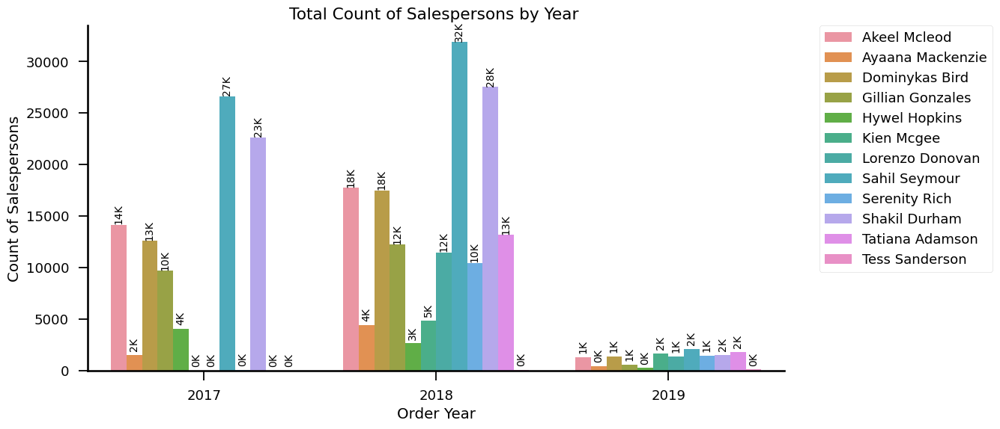

In [573]:
total_salesperson_by_year = merged_df.groupby(['Order Year', 'SalesPerson']).size().reset_index(name='count')

# Issue Year vs. SalesPerson (Categorical)
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Year',y='count', data=total_salesperson_by_year, hue='SalesPerson')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points',rotation=90)
sns.despine()
#plt.xticks(rotation=45)
plt.xlabel('Order Year')
plt.ylabel('Count of Salespersons')
plt.title('Total Count of Salespersons by Year ')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.show()

## 5.Supervisor

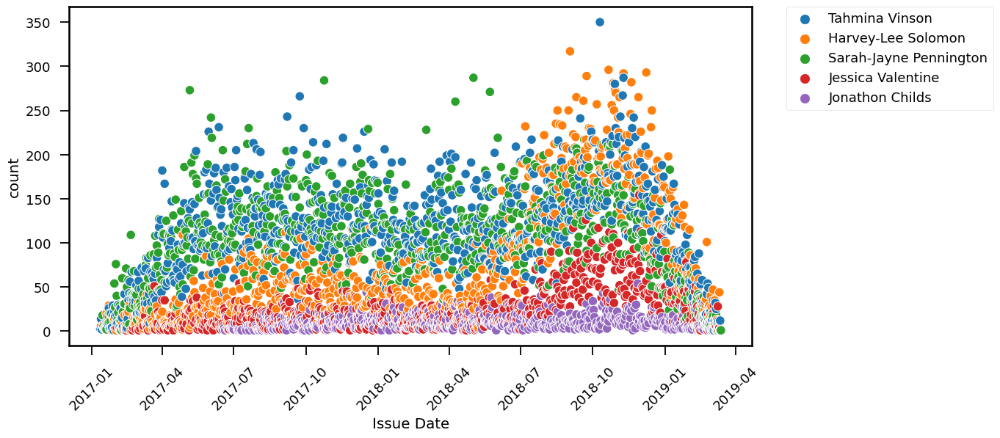

In [295]:
total_Supervisor_by_date = merged_df.groupby(['Issue Date', 'Supervisor']).size().reset_index(name='count')

# Issue Date vs. SalesPerson (Categorical)
plt.figure(figsize=(12, 6))
sns.scatterplot(x='Issue Date',y='count', data=total_Supervisor_by_date, hue='Supervisor')
plt.xticks(rotation=45)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.show()

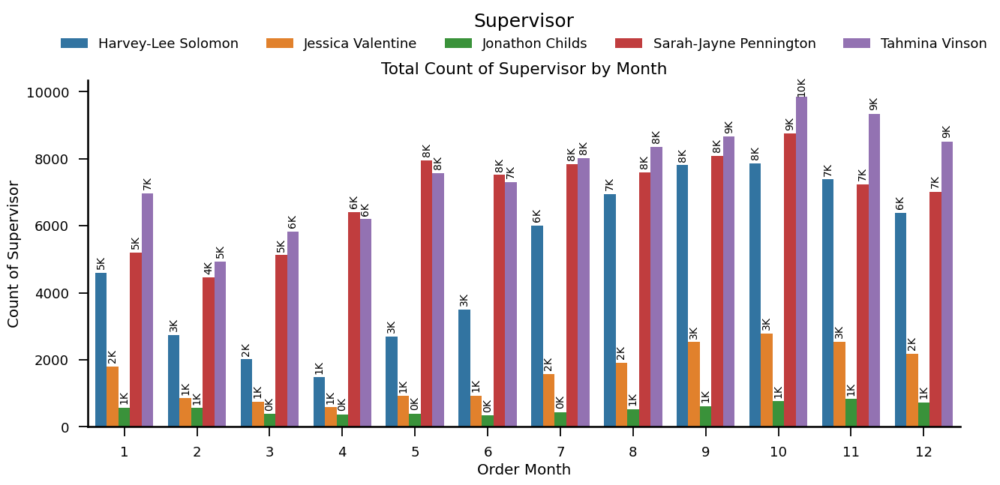

In [579]:
total_Supervisor_by_month = merged_df.groupby(['Order Month', 'Supervisor']).size().reset_index(name='count')

# Issue Month vs.Supervisor (Categorical)
plt.figure(figsize=(15, 6))
plot=sns.barplot(x='Order Month',y='count', data=total_Supervisor_by_month, hue='Supervisor')
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.05),ncol=5, frameon=False)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('Order Month')
plt.ylabel('Count of Supervisor')
plt.title('Total Count of Supervisor by Month')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
#plt.xticks(rotation=45)
plt.show()

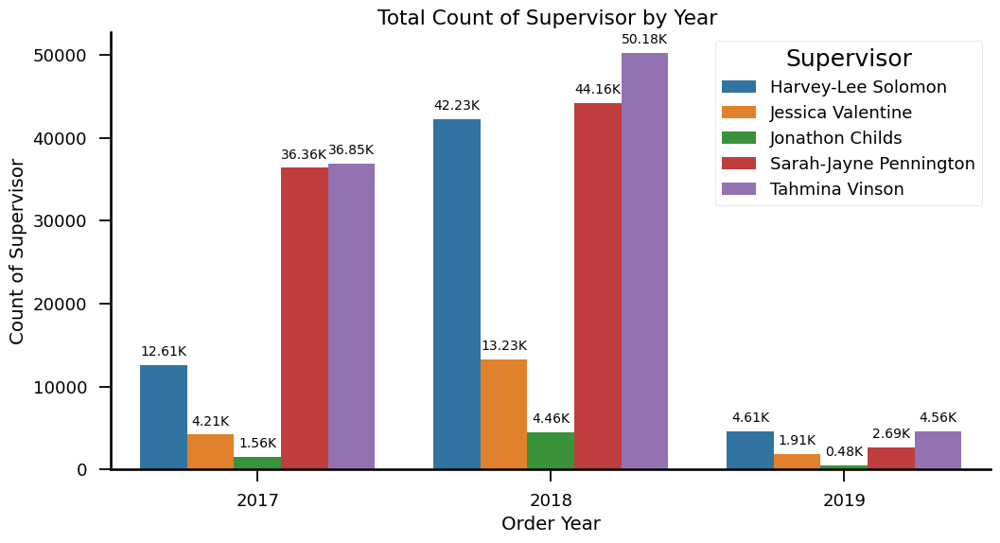

In [297]:
total_Supervisor_by_year = merged_df.groupby(['Order Year', 'Supervisor']).size().reset_index(name='count')

# Issue Year vs. Supervisor (Categorical)
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Year',y='count', data=total_Supervisor_by_year, hue='Supervisor')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
#plt.xticks(rotation=45)
plt.xlabel('Order Year')
plt.ylabel('Count of Supervisor')
plt.title('Total Count of Supervisor by Year ')
plt.show()

## 6. Manager

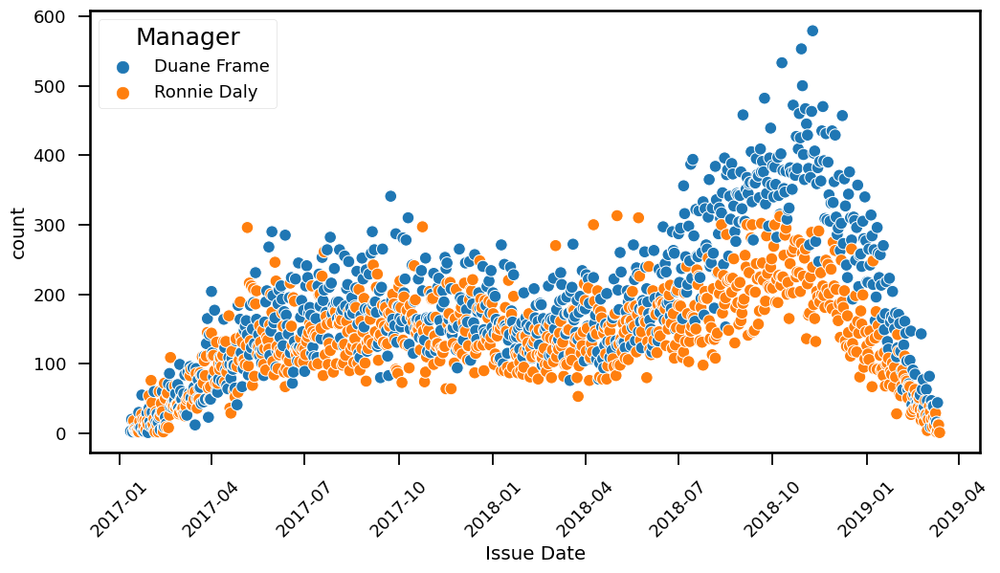

In [298]:
total_Manager_by_date = merged_df.groupby(['Issue Date', 'Manager']).size().reset_index(name='count')

# Issue Date vs. SalesPerson (Categorical)
plt.figure(figsize=(12, 6))
sns.scatterplot(x='Issue Date',y='count', data=total_Manager_by_date, hue='Manager')
plt.xticks(rotation=45)
plt.show()

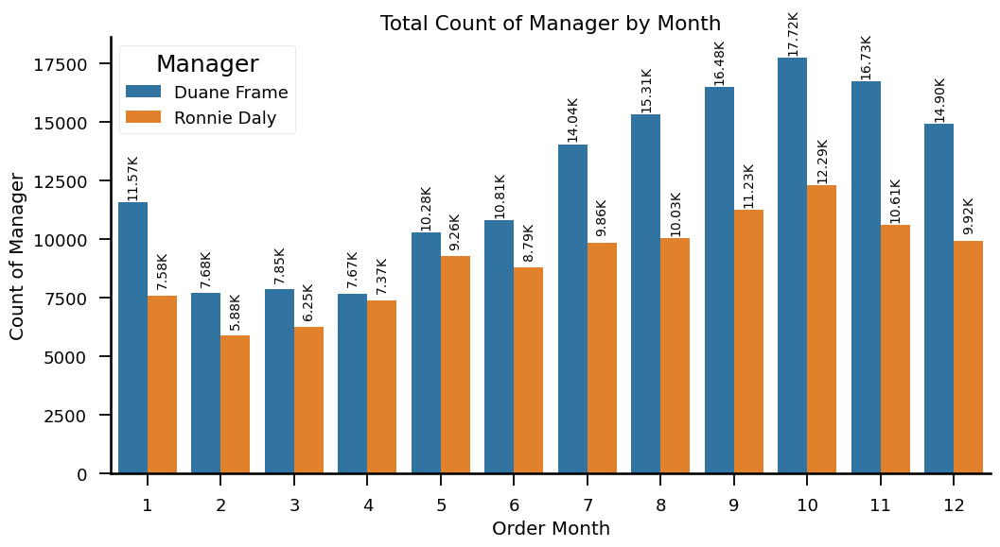

In [580]:
total_Manager_by_month = merged_df.groupby(['Order Month', 'Manager']).size().reset_index(name='count')

# Issue Month vs.Manager (Categorical)
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Month',y='count', data=total_Manager_by_month, hue='Manager')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('Order Month')
plt.ylabel('Count of Manager')
plt.title('Total Count of Manager by Month')
#plt.xticks(rotation=45)
plt.show()

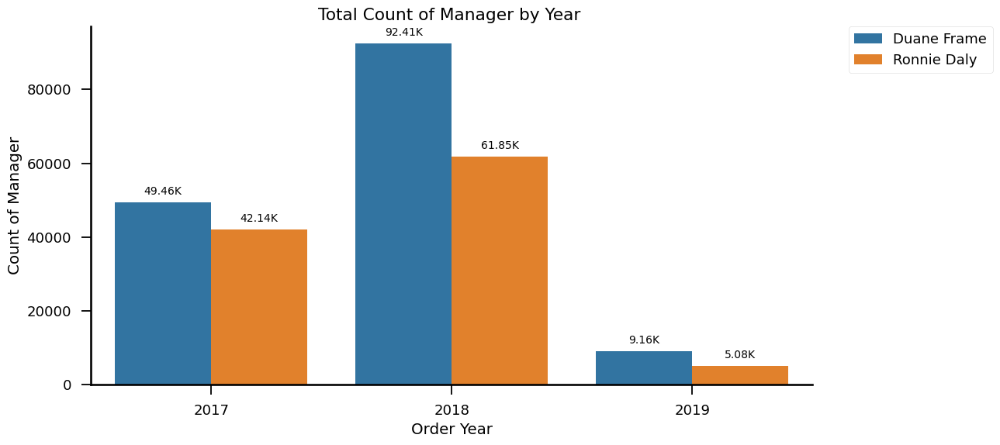

In [300]:
total_Manager_by_year = merged_df.groupby(['Order Year', 'Manager']).size().reset_index(name='count')

# Issue Year vs. Manager (Categorical)
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Year',y='count', data=total_Manager_by_year, hue='Manager')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
#plt.xticks(rotation=45)
plt.xlabel('Order Year')
plt.ylabel('Count of Manager')
plt.title('Total Count of Manager by Year ')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.show()

## 7. Team

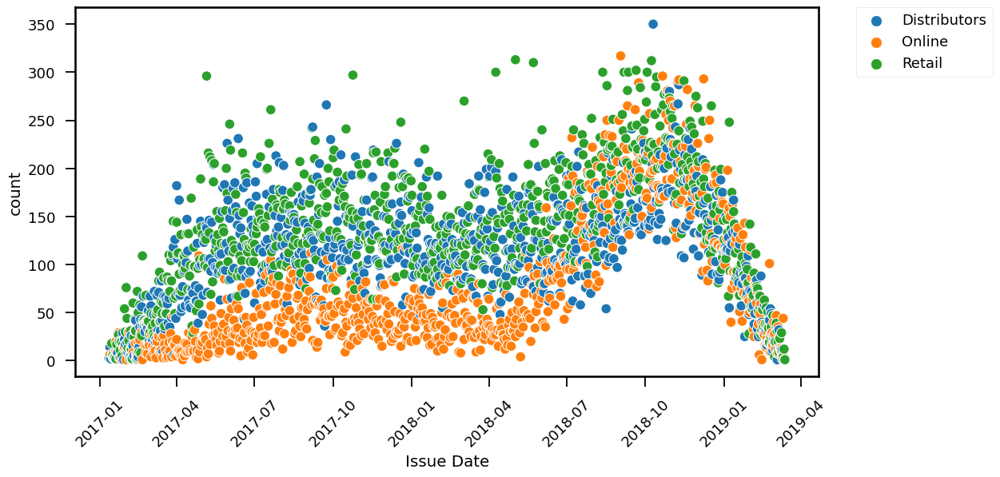

In [301]:
total_Team_by_date = merged_df.groupby(['Issue Date', 'Team']).size().reset_index(name='count')

# Issue Date vs. Team (Categorical)
plt.figure(figsize=(12, 6))
sns.scatterplot(x='Issue Date',y='count', data=total_Team_by_date, hue='Team')
plt.xticks(rotation=45)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.show()

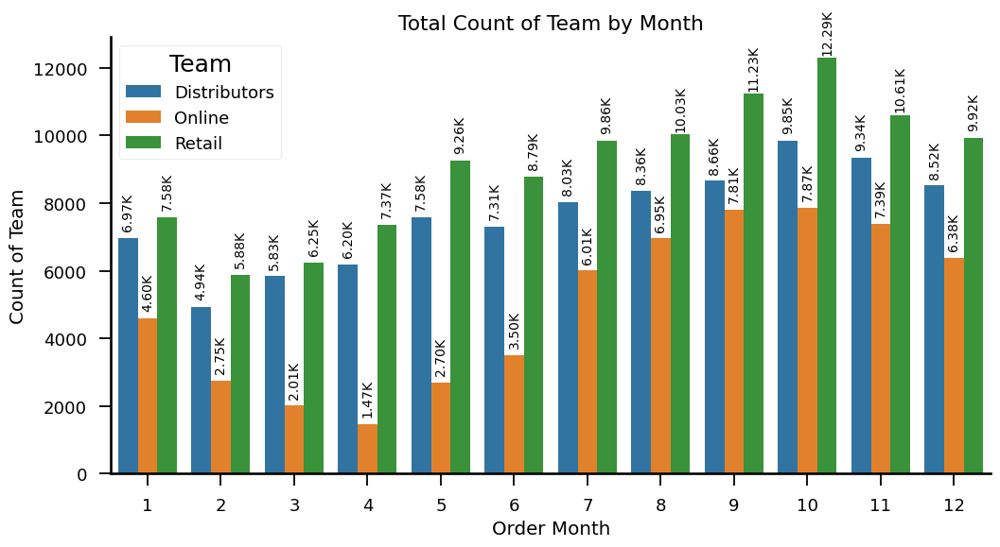

In [581]:
total_Team_by_month = merged_df.groupby(['Order Month', 'Team']).size().reset_index(name='count')

# Issue Month vs.Team (Categorical)
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Month',y='count', data=total_Team_by_month, hue='Team')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('Order Month')
plt.ylabel('Count of Team')
plt.title('Total Count of Team by Month')
#plt.xticks(rotation=45)
plt.show()


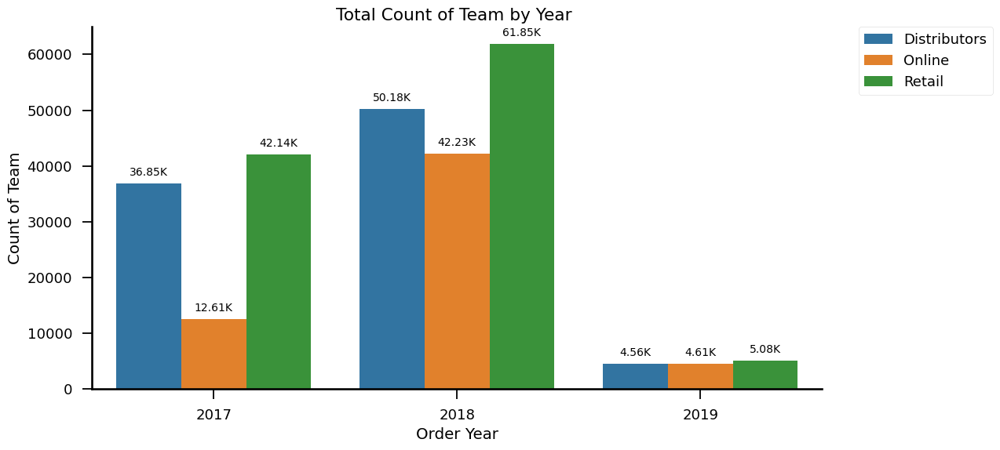

In [303]:
total_Team_by_year = merged_df.groupby(['Order Year', 'Team']).size().reset_index(name='count')

# Issue Year vs. Team (Categorical)
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Year',y='count', data=total_Team_by_year, hue='Team')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
#plt.xticks(rotation=45)
plt.xlabel('Order Year')
plt.ylabel('Count of Team')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Total Count of Team by Year ')
plt.show()

## 8. Company

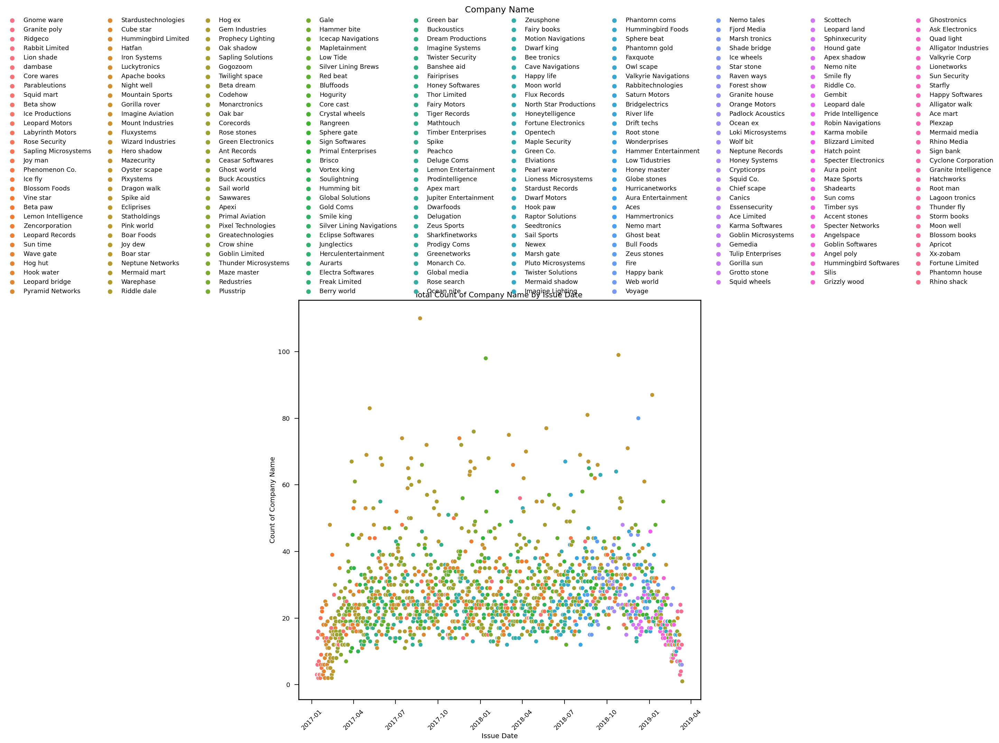

In [584]:
# Grouping by Order date and selecting top 10 Companies
df6_new=pd.DataFrame()
top_companies=[]
for i in merged_df['Issue Date'].unique():
    df5_new=merged_df[merged_df['Issue Date']==i].groupby(['Issue Date','Company Name']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    top_companies.append(df5_new[0:2])
df6=pd.concat(top_companies).reset_index(drop=True)




# Issue Date vs. Company(Categorical)
plt.figure(figsize=(15, 15))
plot=sns.scatterplot(x='Issue Date', data=df6, y='count',hue='Company Name')
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1),ncol=10, frameon=False)
plt.xticks(rotation=45)
plt.xlabel('Issue Date')
plt.ylabel('Count of Company Name')
plt.title('Total Count of Company Name by Issue Date ')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.show()

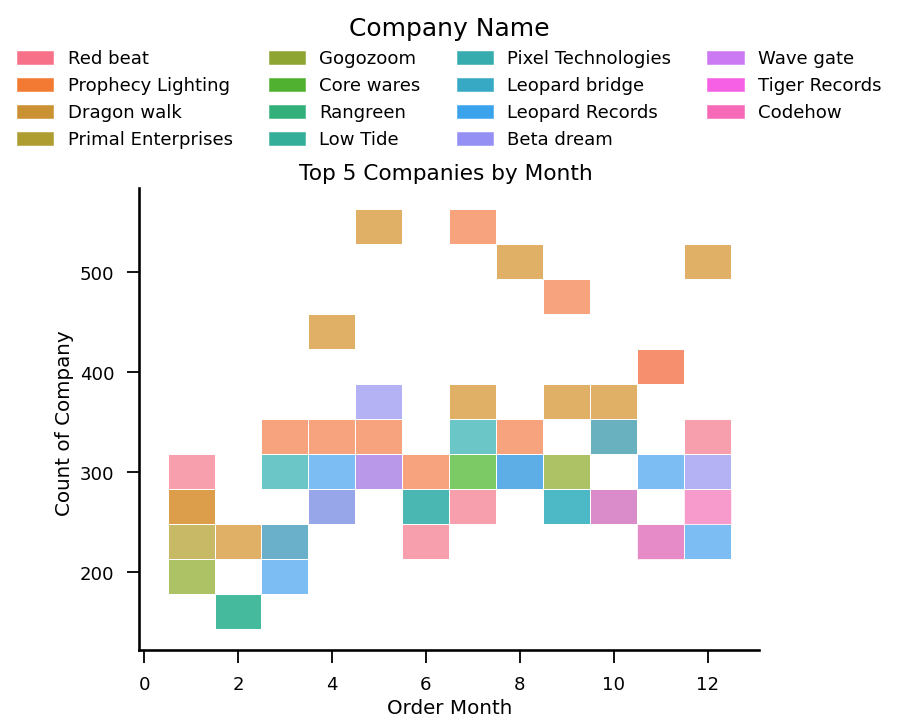

In [590]:

# Grouping by Order Month and selecting top 10 Companies
df6_new=pd.DataFrame()
monthly_top_companies=[]
for i in merged_df['Order Month'].unique():
    df6_new=merged_df[merged_df['Order Month']==i].groupby(['Order Month','Company Name']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    monthly_top_companies.append(df6_new[0:5])
df8=pd.concat(monthly_top_companies).reset_index(drop=True)



# Issue Month vs. Company(Categorical)
plt.figure(figsize=(8, 6))
plot=sns.histplot(x='Order Month',y='count', data=df8, hue='Company Name',multiple='stack',alpha=0.8,edgecolor = "white")
#plt.xticks(rotation=45)
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.05),ncol=4, frameon=False)

sns.despine()
plt.xlabel('Order Month')
plt.ylabel('Count of Company ')
plt.title('Top 5 Companies by Month ')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.show()

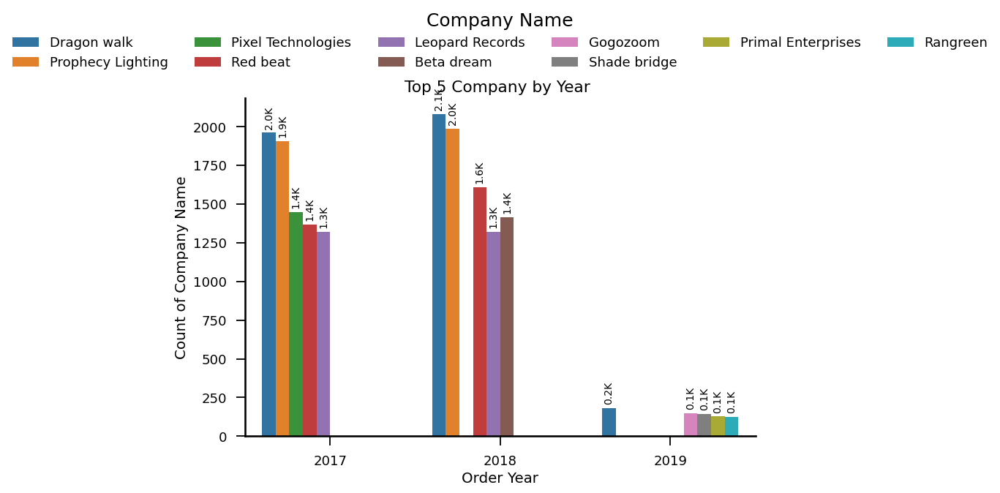

In [596]:

# Grouping by Order Year and selecting top 10 Companies
df6_new=pd.DataFrame()
yearly_top_companies=[]
for i in merged_df['Order Year'].unique():
    df5_new=merged_df[merged_df['Order Year']==i].groupby(['Order Year','Company Name']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    yearly_top_companies.append(df5_new[0:5])
df6=pd.concat(yearly_top_companies).reset_index(drop=True)

# Issue Year vs. Company(Categorical)
plt.figure(figsize=(9, 6))
plot=sns.barplot(x='Order Year',y='count', data=df6, hue='Company Name')
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.05),ncol=6, frameon=False)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)
sns.despine()
#plt.xticks(rotation=45)
plt.xlabel('Order Year')
plt.ylabel('Count of Company Name')
plt.title('Top 5 Company by Year ')
plt.show()

## 9. Status

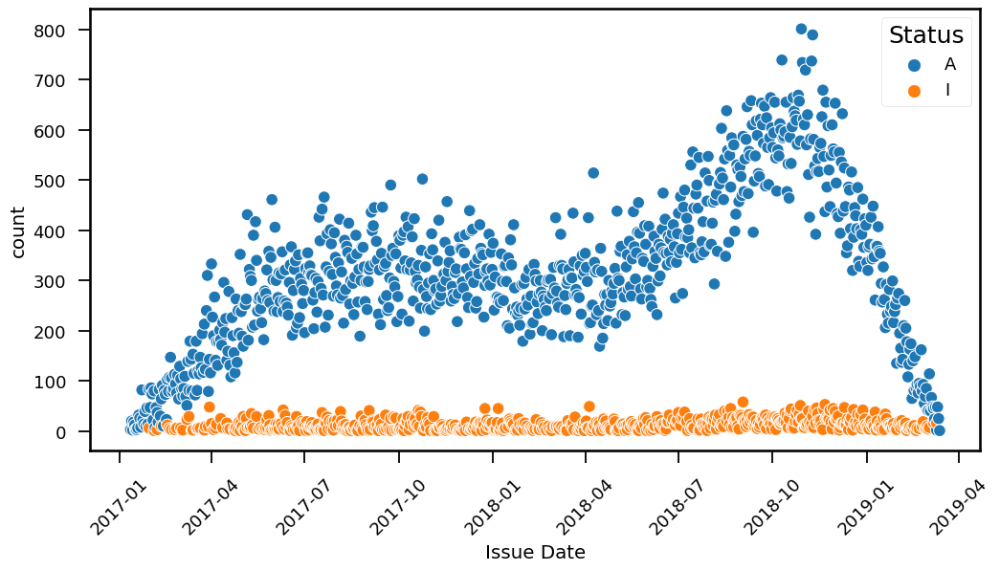

In [307]:
total_Team_by_date = merged_df.groupby(['Issue Date', 'Status']).size().reset_index(name='count')

# Issue Date vs. Status (Categorical)
plt.figure(figsize=(12, 6))
sns.scatterplot(x='Issue Date',y='count', data=total_Team_by_date, hue='Status')
plt.xticks(rotation=45)
plt.show()

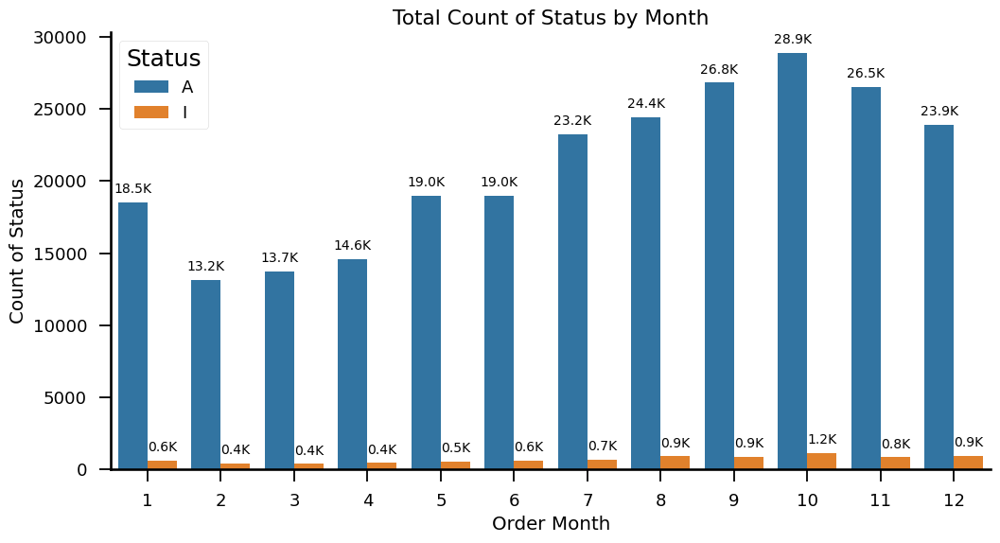

In [597]:
total_Status_by_month = merged_df.groupby(['Order Month', 'Status']).size().reset_index(name='count')

# Issue Month vs.Status (Categorical)
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Month',y='count', data=total_Status_by_month, hue='Status')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
plt.xlabel('Order Month')
plt.ylabel('Count of Status')
plt.title('Total Count of Status by Month')
#plt.xticks(rotation=45)
plt.show()

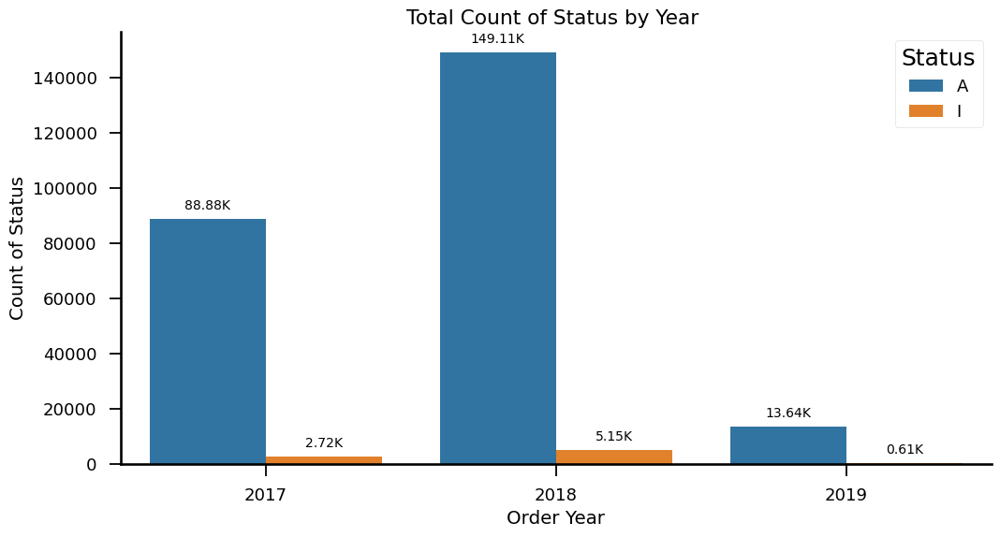

In [309]:
total_Status_by_year = merged_df.groupby(['Order Year', 'Status']).size().reset_index(name='count')

# Issue Year vs. Status (Categorical)
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Year',y='count', data=total_Status_by_year, hue='Status')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
#plt.xticks(rotation=45)
plt.xlabel('Order Year')
plt.ylabel('Count of Status')
plt.title('Total Count of Status by Year ')
plt.show()

## 10. Line of Business

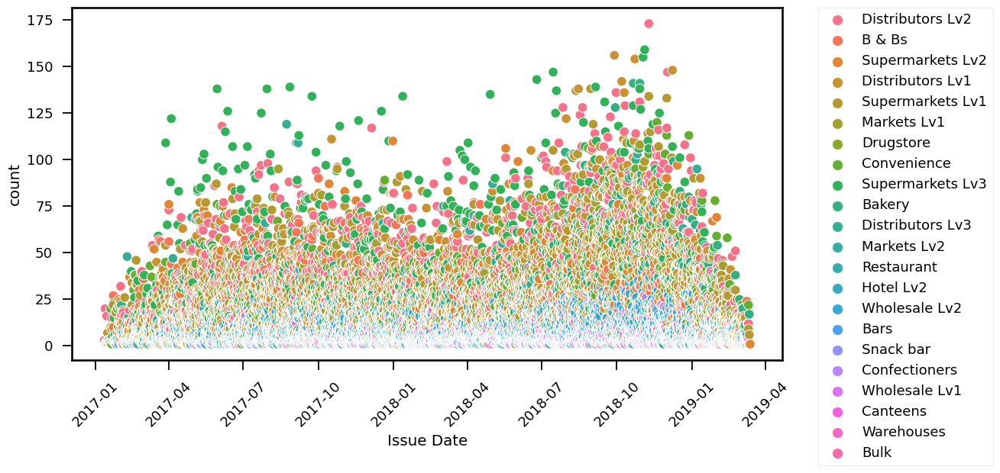

In [310]:
total_by_business = merged_df.groupby(['Issue Date', 'Line of Business']).size().reset_index(name='count')

# Issue Date vs. Line of Business (Categorical)
plt.figure(figsize=(12, 6))
sns.scatterplot(x='Issue Date',y='count', data=total_by_business, hue='Line of Business')
plt.xticks(rotation=45)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.show()

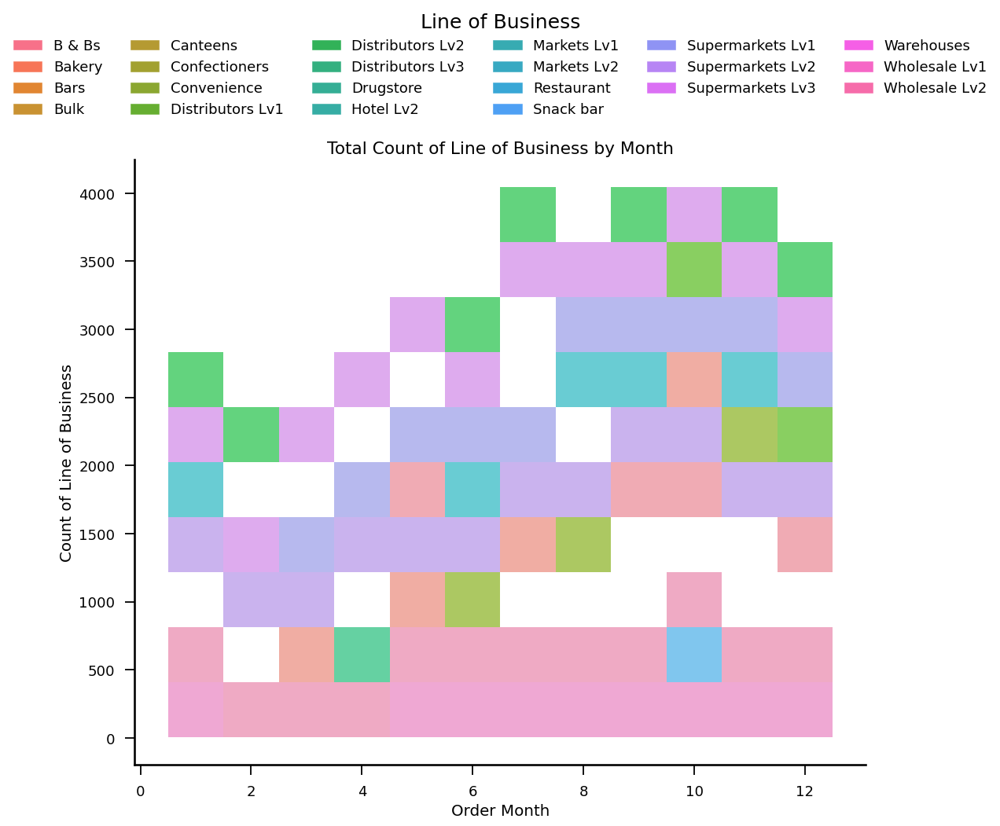

In [600]:
total_business_by_month = merged_df.groupby(['Order Month', 'Line of Business']).size().reset_index(name='count')

# Issue Month vs.Team (Categorical)
plt.figure(figsize=(12, 10))
plot=sns.histplot(x='Order Month',y='count', data=total_business_by_month, hue='Line of Business')
plt.xlabel('Order Month')
sns.despine()
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.05),ncol=6, frameon=False)
plt.ylabel('Count of Line of Business')
plt.title('Total Count of Line of Business by Month')
#plt.xticks(rotation=45)
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.show()

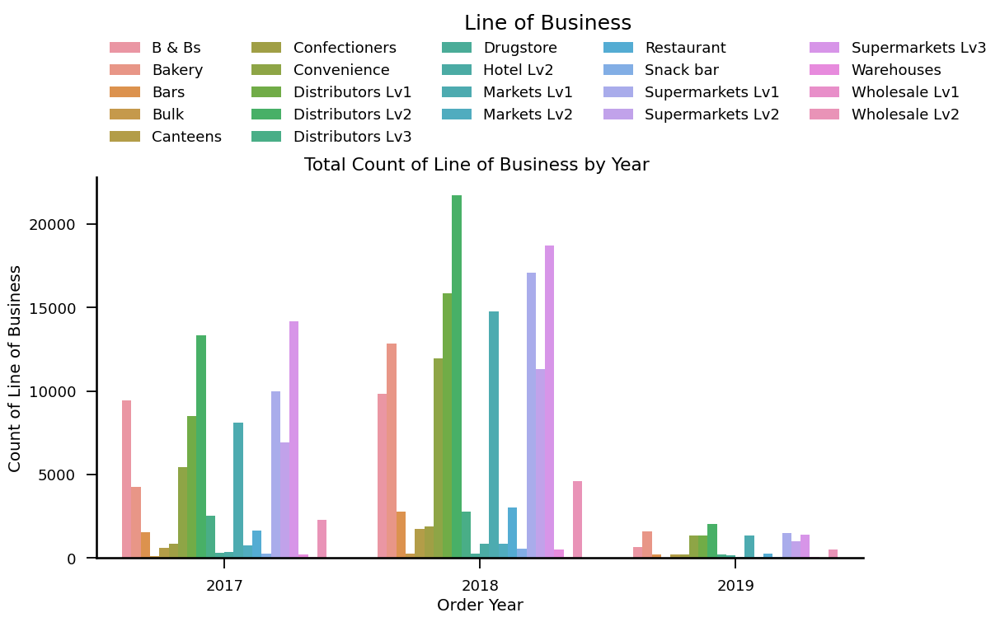

In [607]:
total_business_by_year = merged_df.groupby(['Order Year', 'Line of Business']).size().reset_index(name='count')

# Issue Year vs. Team (Categorical)
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Year',y='count', data=total_business_by_year, hue='Line of Business')
sns.move_legend(plot, "lower left", bbox_to_anchor=(0, 1.05),ncols=5, frameon=False)
#plt.xticks(rotation=45)
sns.despine()
plt.xlabel('Order Year')
plt.ylabel('Count of Line of Business')
plt.title('Total Count of Line of Business by Year ')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.show()

## 11. City

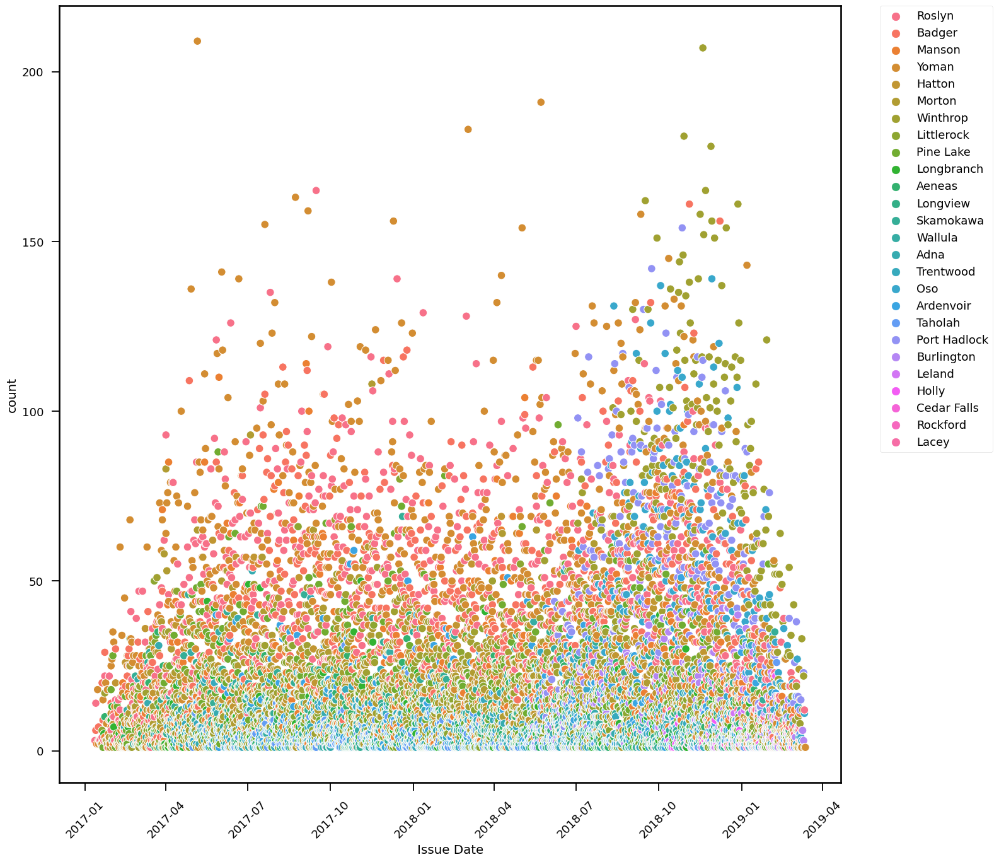

In [313]:
total_City_by_date = merged_df.groupby(['Issue Date', 'City']).size().reset_index(name='count')

# Issue Date vs. City (Categorical)
plt.figure(figsize=(16, 16))
sns.scatterplot(x='Issue Date',y='count', data=total_City_by_date, hue='City')
plt.xticks(rotation=45)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.show()

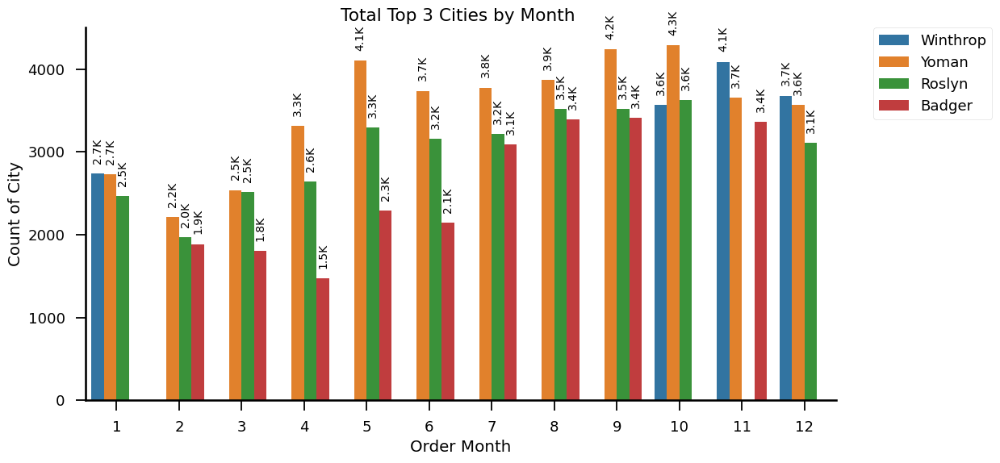

In [609]:
monthly_top_City=[]
for i in merged_df['Order Month'].unique():
    df8_new=merged_df[merged_df['Order Month']==i].groupby(['Order Month','City']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    monthly_top_City.append(df8_new[0:3])
df8=pd.concat(monthly_top_City).reset_index(drop=True)




# Issue Month vs. City(Categorical)
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Month',y='count', data=df8, hue='City')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
#plt.xticks(rotation=45)
plt.xlabel('Order Month')
plt.ylabel('Count of City')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Total Top 3 Cities by Month ')
plt.show()


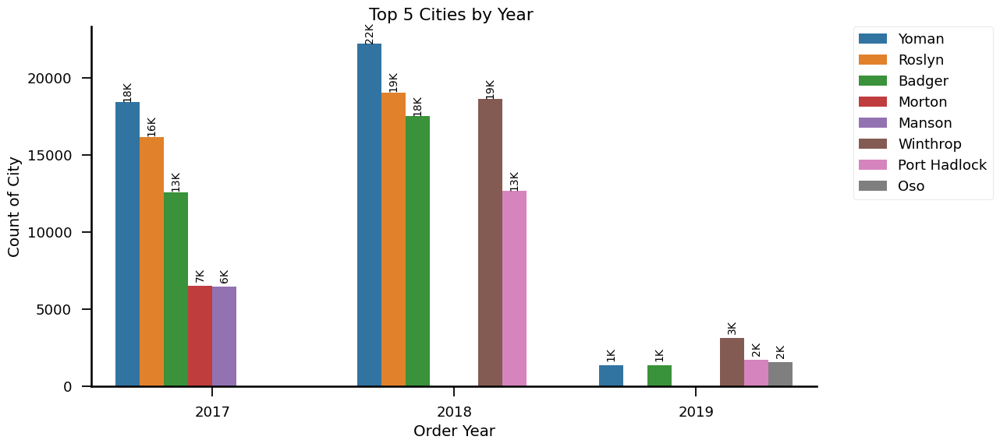

In [611]:
yearly_top_City=[]
for i in merged_df['Order Year'].unique():
    df8_new=merged_df[merged_df['Order Year']==i].groupby(['Order Year','City']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    yearly_top_City.append(df8_new[0:5])
df8=pd.concat(yearly_top_City).reset_index(drop=True)
# Issue Year vs. City(Categorical)
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Year',y='count', data=df8, hue='City')

for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points',rotation=90)
sns.despine()
#plt.xticks(rotation=45)
plt.xlabel('Order Year')
plt.ylabel('Count of City')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Top 5 Cities by Year ')
plt.show()









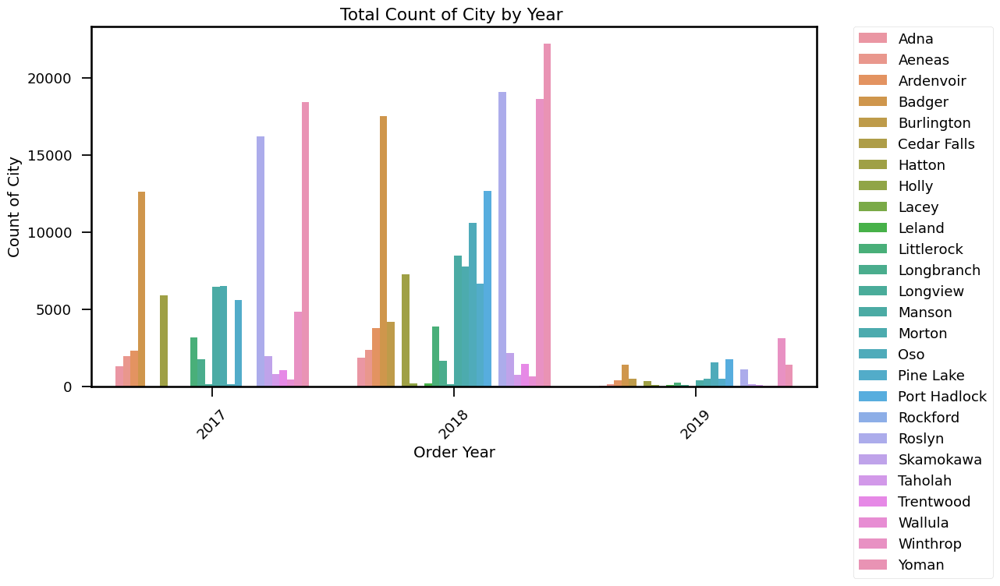

In [316]:
total_City_by_year = merged_df.groupby(['Order Year', 'City']).size().reset_index(name='count')

# Issue Year vs. City (Categorical)
plt.figure(figsize=(12, 6))
sns.barplot(x='Order Year',y='count', data=total_City_by_year, hue='City')
plt.xticks(rotation=45)
plt.xlabel('Order Year')
plt.ylabel('Count of City')
plt.title('Total Count of City by Year ')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.show()

## 12. Product

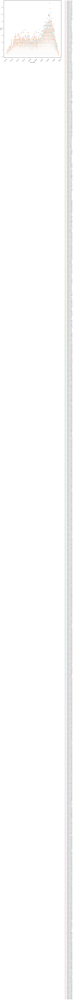

In [317]:
total_Product_by_date = merged_df.groupby(['Issue Date', 'Product']).size().reset_index(name='count')

# Issue Date vs. Product (Categorical)
plt.figure(figsize=(16, 16))
sns.scatterplot(x='Issue Date',y='count', data=total_Product_by_date, hue='Product')
plt.xticks(rotation=45)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.show()

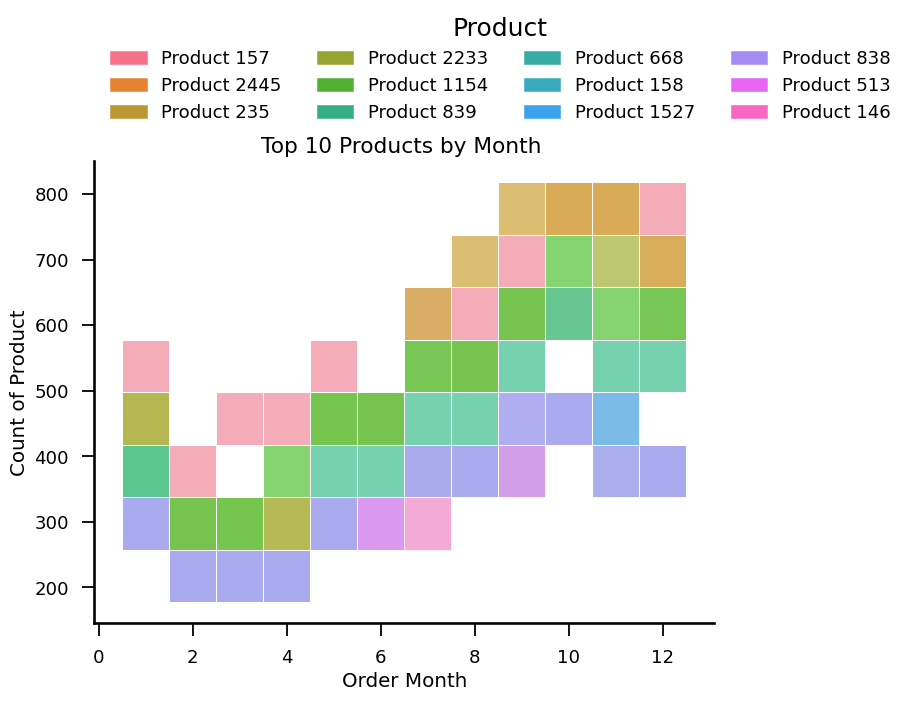

In [625]:
Monthly_top_Product=[]
for i in merged_df['Order Month'].unique():
    df8_new=merged_df[merged_df['Order Month']==i].groupby(['Order Month','Product']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    Monthly_top_Product.append(df8_new[0:10])
df8=pd.concat(Monthly_top_Product).reset_index(drop=True)




# Issue Year vs.Product(Categorical)
plt.figure(figsize=(8, 6))
plot=sns.histplot(x='Order Month',y='count', data=df8, hue='Product',edgecolor = "white",alpha=0.8)
sns.move_legend(plot, "lower left", bbox_to_anchor=(0, 1.05),ncol=4, frameon=False)
sns.despine()#plt.xticks(rotation=45)
plt.xlabel('Order Month')
plt.ylabel('Count of Product')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Top 10 Products by Month ')
plt.show()

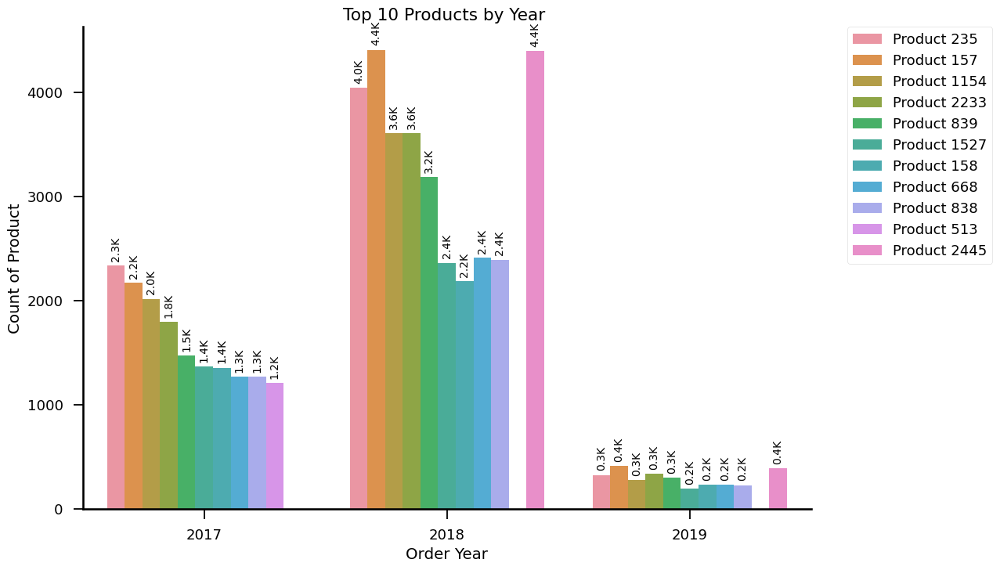

In [628]:
yearly_top_Product=[]
for i in merged_df['Order Year'].unique():
    df8_new=merged_df[merged_df['Order Year']==i].groupby(['Order Year','Product']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    yearly_top_Product.append(df8_new[0:10])
df8=pd.concat(yearly_top_Product).reset_index(drop=True)

# Issue Year vs.Product(Categorical)
plt.figure(figsize=(12, 8))
plot=sns.barplot(x='Order Year',y='count', data=df8, hue='Product')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)
sns.despine()
#plt.xticks(rotation=45)
plt.xlabel('Order Year')
plt.ylabel('Count of Product')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Top 10 Products by Year ')
plt.show()


## 13. Group

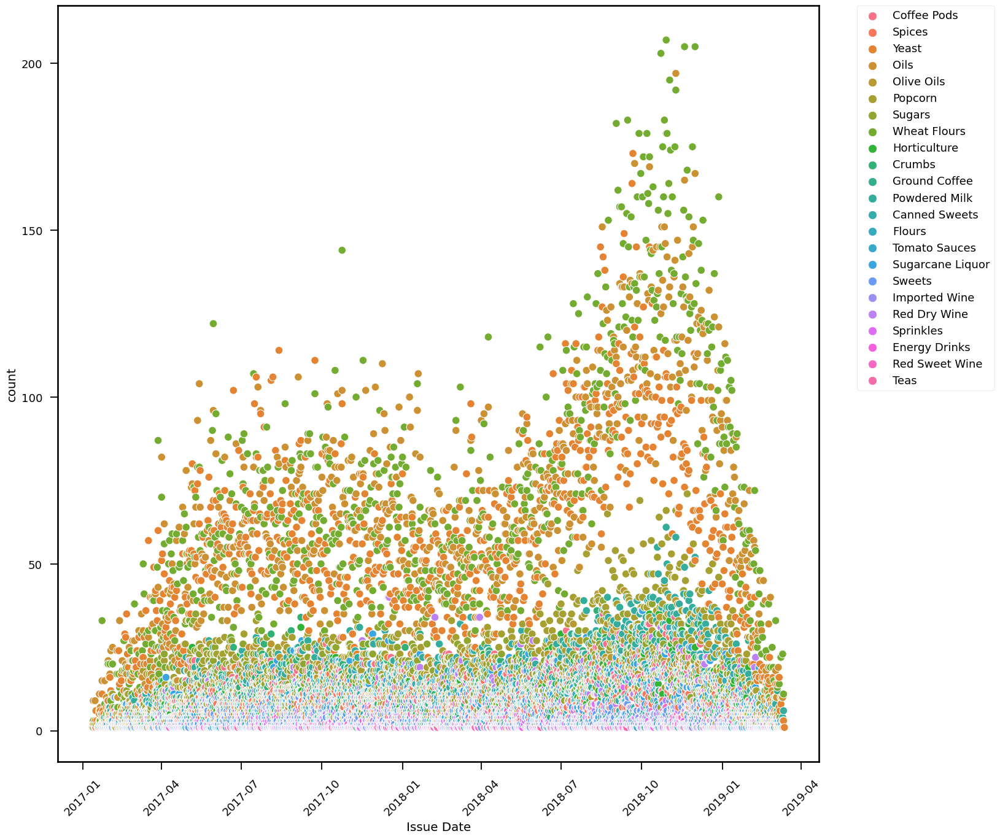

In [320]:
total_Group_by_date = merged_df.groupby(['Issue Date', 'Group']).size().reset_index(name='count')

# Issue Date vs. Product (Categorical)
plt.figure(figsize=(16, 16))
sns.scatterplot(x='Issue Date',y='count', data=total_Group_by_date, hue='Group')
plt.xticks(rotation=45)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.show()

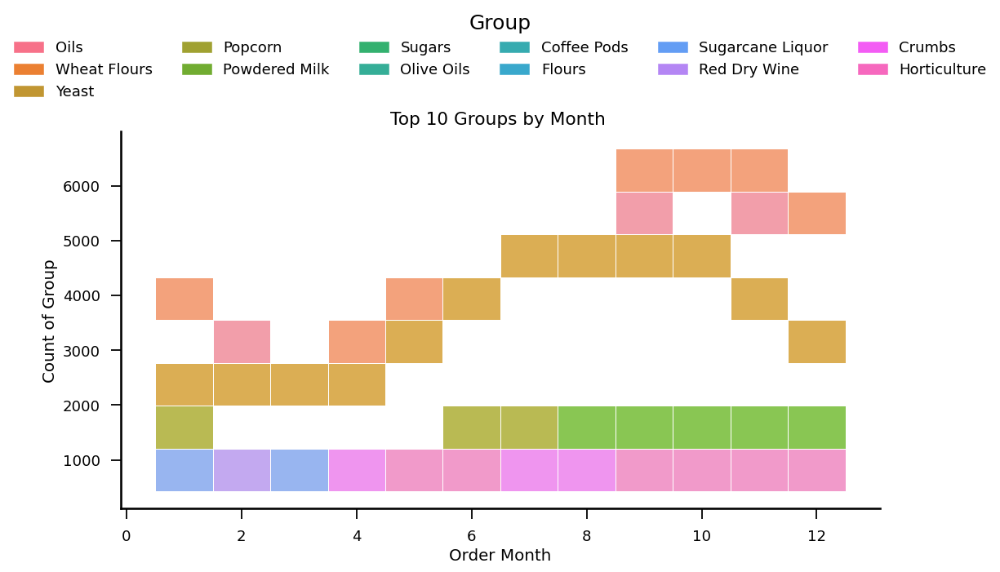

In [633]:
Monthly_top_Group=[]
for i in merged_df['Order Month'].unique():
    df8_new=merged_df[merged_df['Order Month']==i].groupby(['Order Month','Group']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    Monthly_top_Group.append(df8_new[0:10])
df8=pd.concat(Monthly_top_Group).reset_index(drop=True)




# Issue Year vs. Group(Categorical)
plt.figure(figsize=(12, 6))
plot=sns.histplot(x='Order Month',y='count', data=df8, hue='Group',edgecolor = "white")
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.05),ncol=6, frameon=False)
sns.despine()#plt.xticks(rotation=45)
plt.xlabel('Order Month')
plt.ylabel('Count of Group')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Top 10 Groups by Month ')
plt.show()

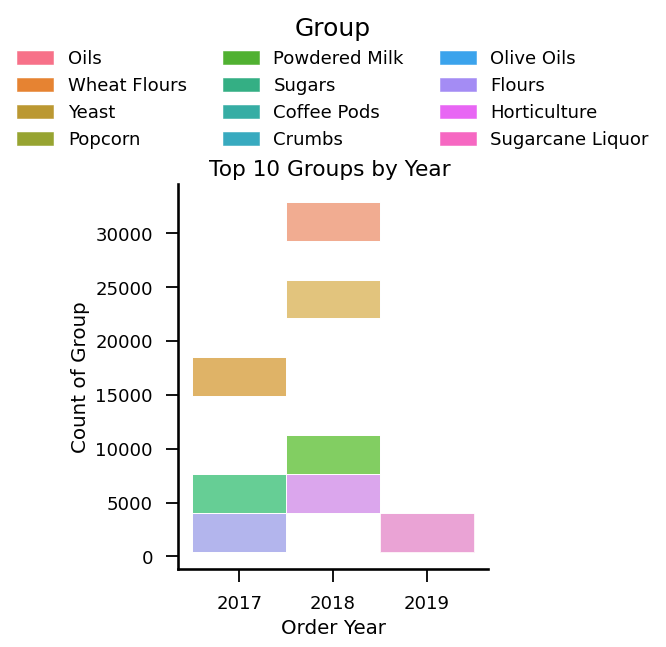

In [649]:
yearly_top_Group=[]
for i in merged_df['Order Year'].unique():
    df8_new=merged_df[merged_df['Order Year']==i].groupby(['Order Year','Group']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    yearly_top_Group.append(df8_new[0:10])
df8=pd.concat(yearly_top_Group).reset_index(drop=True)




# Issue Year vs. Group(Categorical)
plt.figure(figsize=(4, 5))
plot=sns.histplot(x='Order Year',y='count', data=df8, hue='Group',multiple='stack',alpha=0.8,edgecolor = "white")
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
sns.move_legend(plot, "lower center", bbox_to_anchor=(0.5, 1.05),ncol=3, frameon=False)
#plt.xticks(rotation=45)
plt.xlabel('Order Year')
plt.ylabel('Count of Group')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Top 10 Groups by Year ')
plt.show()

## 14.Category

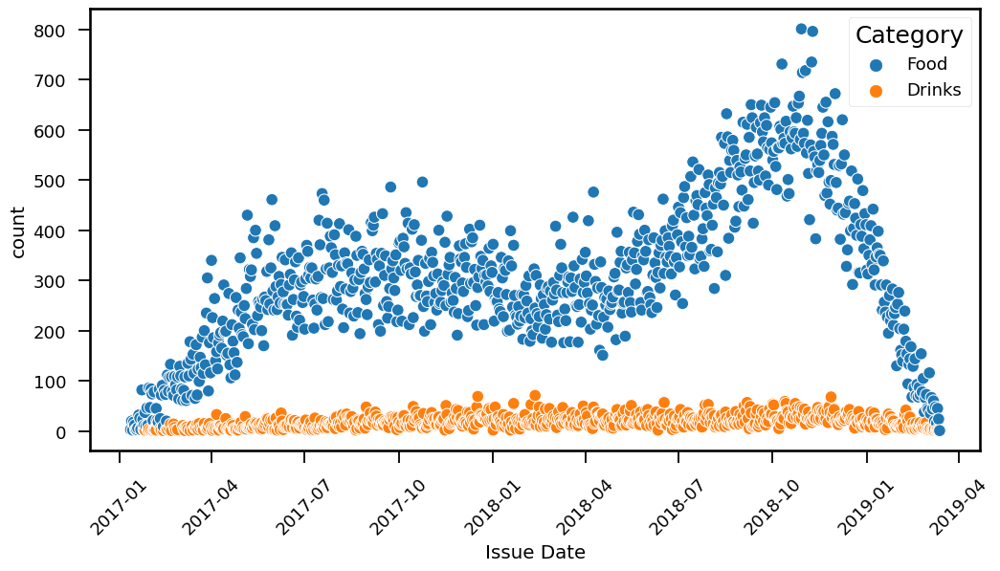

In [323]:
total_Category_by_date = merged_df.groupby(['Issue Date', 'Category']).size().reset_index(name='count')

# Issue Date vs. Category (Categorical)
plt.figure(figsize=(12, 6))
sns.scatterplot(x='Issue Date',y='count', data=total_Category_by_date, hue='Category')
plt.xticks(rotation=45)
plt.show()

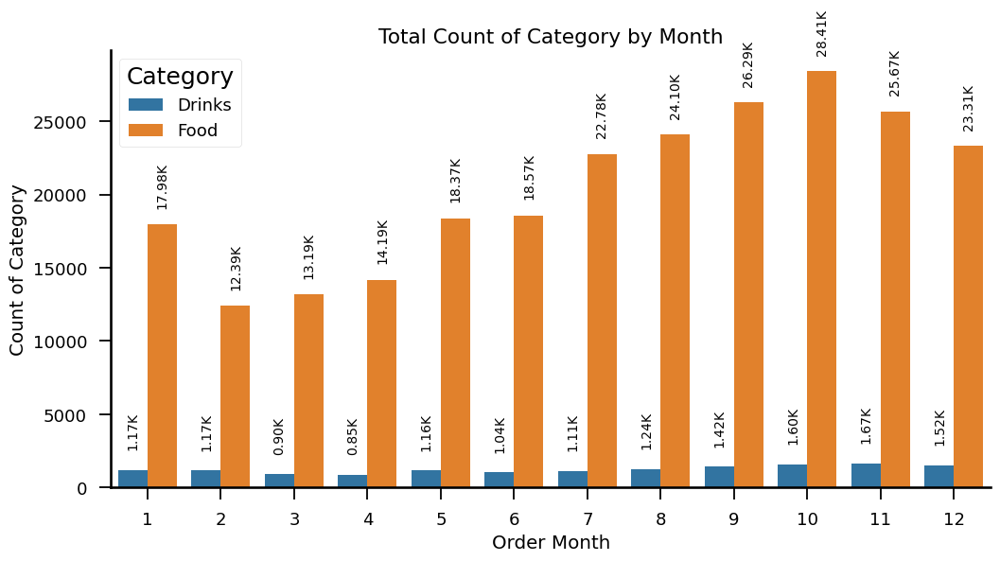

In [488]:
total_Category_by_month = merged_df.groupby(['Order Month', 'Category']).size().reset_index(name='count')

# Issue Month vs.Category (Categorical)
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Month',y='count', data=total_Category_by_month, hue='Category')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 30), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('Order Month')
plt.ylabel('Count of Category')
plt.title('Total Count of Category by Month')
#plt.xticks(rotation=45)
plt.show()

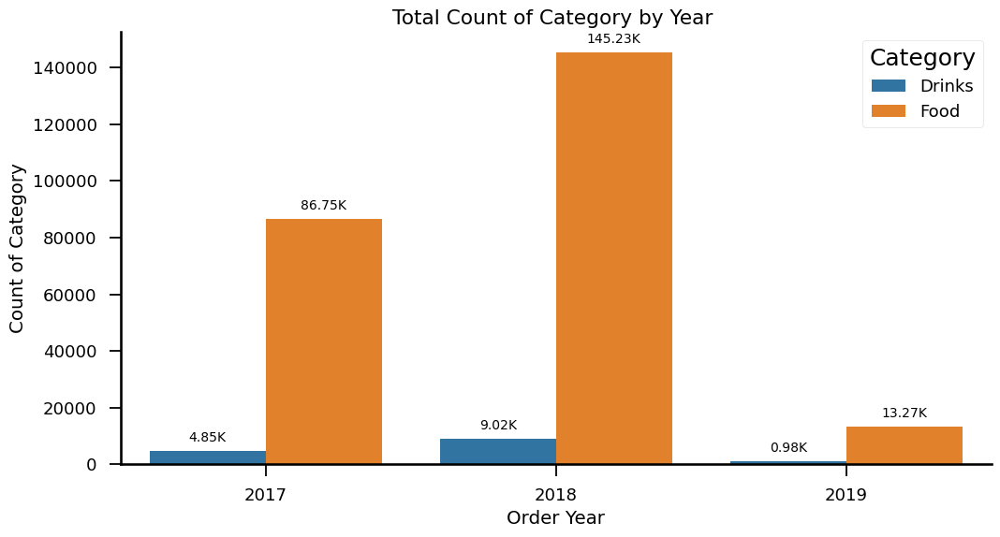

In [325]:
total_Category_by_year = merged_df.groupby(['Order Year', 'Category']).size().reset_index(name='count')

# Issue Year vs. Team (Categorical)
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Year',y='count', data=total_Category_by_year, hue='Category')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
#plt.xticks(rotation=45)
plt.xlabel('Order Year')
plt.ylabel('Count of Category')
plt.title('Total Count of Category by Year ')
plt.show()

## 15. Unit Price

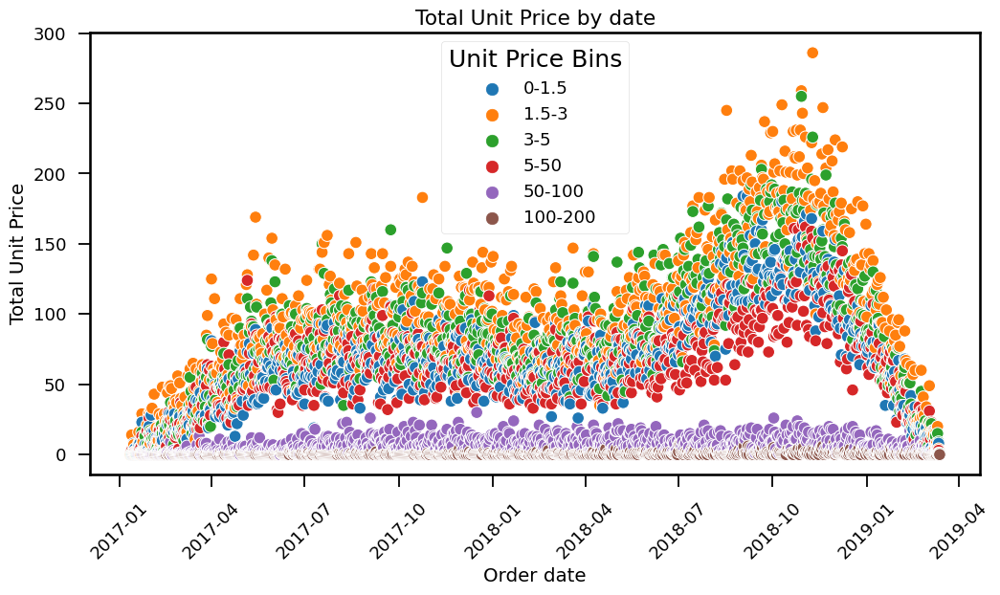

In [326]:
total_up_by_date = merged_df.groupby('Issue Date')['Unit Price Bins'].value_counts().reset_index(name='count')

# Issue Date vs. Qty Items (Numerical)
plt.figure(figsize=(12, 6))
sns.scatterplot(x='Issue Date',y='count', hue='Unit Price Bins', data=total_up_by_date)
plt.xticks(rotation=45)
plt.xlabel('Order date')
plt.ylabel('Total Unit Price')
plt.title('Total Unit Price by date')
plt.show()

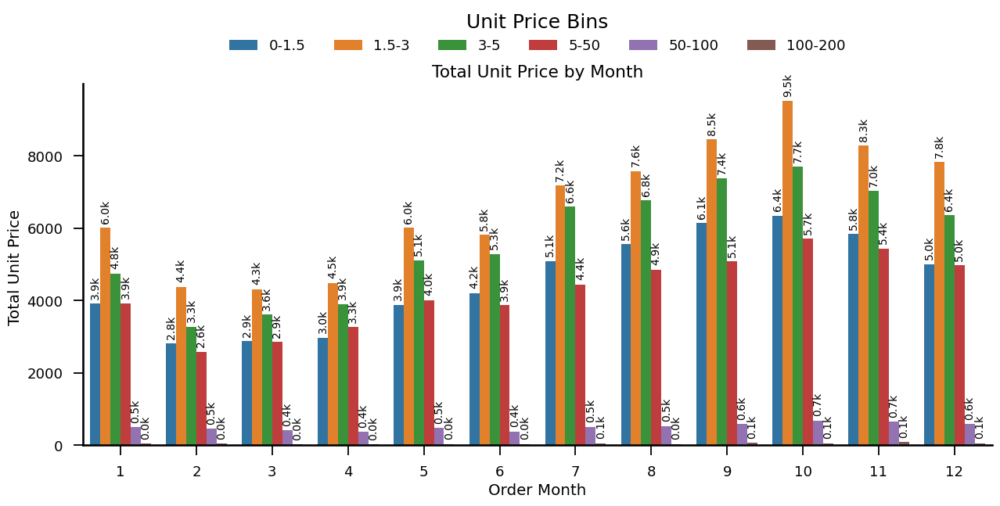

In [654]:
# Order Month vs. Qty Items (Categorical)
total_up_by_month = merged_df.groupby('Order Month')['Unit Price Bins'].value_counts().reset_index(name='count')
plt.figure(figsize=(15, 6))
plot=sns.barplot(x='Order Month',y='count', hue='Unit Price Bins', data=total_up_by_month)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.1f}k', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points',rotation=90)
sns.despine()
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.05),ncol=6, frameon=False)
#plt.xticks(rotation=45)
plt.xlabel('Order Month')
plt.ylabel('Total Unit Price ')
plt.title('Total Unit Price by Month')
plt.show()

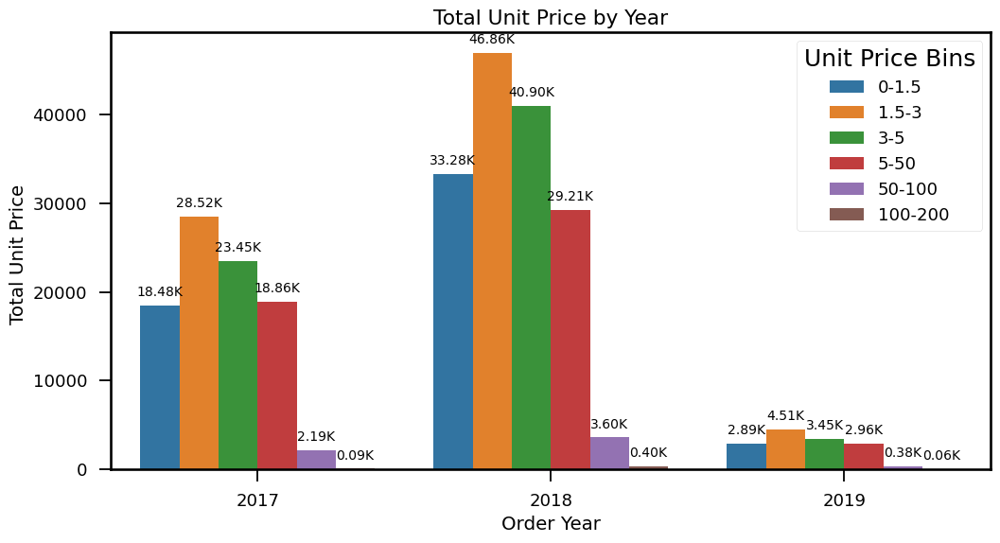

In [328]:
# Order Month vs. Qty Items (Categorical)
total_up_by_Year = merged_df.groupby('Order Year')['Unit Price Bins'].value_counts().reset_index(name='count')
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Year',y='count', hue='Unit Price Bins', data=total_up_by_Year)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')

#plt.xticks(rotation=45)
plt.xlabel('Order Year')
plt.ylabel('Total Unit Price ')
plt.title('Total Unit Price by Year')
plt.show()

## 16.Actual Sales and Target Sales

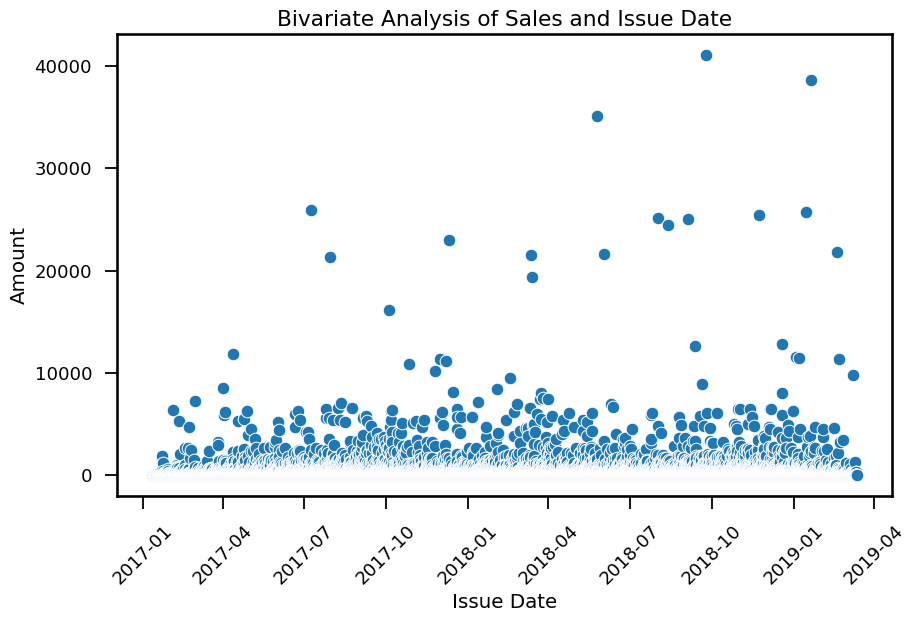

In [656]:
total_Amount_by_date = merged_df.groupby('Issue Date') ['Amount'].sum().reset_index()

# Issue Date vs. Amount(Numerical)
plt.figure(figsize=(10,6))
sns.scatterplot(x='Issue Date',y='Amount', data=merged_df)

plt.xticks(rotation=45)
plt.title('Bivariate Analysis of Sales and Issue Date' )

plt.show()

In [330]:
month_order

['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12']

In [331]:
merged_df

,Issue Date,Invoice Number,Amount,Order Month,Order Year,Quantity Bins,Unit Price Bins,Net Weight Bins,SalesPerson,Supervisor,Manager,Team,Company Name,Status,Line of Business,City,Product,Group,Category
0,2017-01-12,1492762,52.98,1,2017,0-6,5-50,0-1,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,Product 1073,Spices,Food
1,2017-01-12,1492762,26.64,1,2017,0-6,3-5,3-10,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,Product 1420,Coffee Pods,Food
2,2017-01-12,1492762,9.60,1,2017,6-11,0-1.5,1.5-3,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,Product 264,Yeast,Food
3,2017-01-13,1492719,17.52,1,2017,0-6,1.5-3,1-1.5,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Granite poly,A,Distributors Lv2,Roslyn,Product 1154,Popcorn,Food
4,2017-01-13,1492719,16.86,1,2017,0-6,1.5-3,1-1.5,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Granite poly,A,Distributors Lv2,Roslyn,Product 1527,Popcorn,Food
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
260091,2019-03-12,2173547,38.88,3,2019,12-23,1.5-3,1-1.5,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Rhino shack,A,Bakery,Roslyn,Product 202,Wheat Flours,Food
260092,2019-03-12,2173547,39.00,3,2019,6-11,3-5,1.5-3,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Rhino shack,A,Bakery,Roslyn,Product 1154,Popcorn,Food
260093,2019-03-12,2173547,39.12,3,2019,6-11,3-5,0-1,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Rhino shack,A,Bakery,Roslyn,Product 668,Popcorn,Food
260094,2019-03-12,2173547,37.68,3,2019,6-11,3-5,0-1,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Rhino shack,A,Bakery,Roslyn,Product 1527,Popcorn,Food


In [332]:
monthly_sales=merged_df.groupby(['Order Month','Order Year'])['Amount'].sum().reset_index()
monthly_targets=targets.groupby(['Target Month','Target Year'])['Sales'].sum().reset_index()

In [333]:
monthly_sales['Month Year']=monthly_sales['Order Month'].astype(str) + ' - ' + monthly_sales['Order Year'].astype(str)
monthly_sales['Amount']=monthly_sales['Amount'].round(2)
monthly_sales.sort_values(by=['Order Year','Order Month'],inplace=True)
monthly_sales.head(10)

,Order Month,Order Year,Amount,Month Year
0,1,2017,29102.49,1 - 2017
3,2,2017,139282.50,2 - 2017
6,3,2017,267948.76,3 - 2017
9,4,2017,477026.73,4 - 2017
12,5,2017,592136.47,5 - 2017
15,6,2017,629096.11,6 - 2017
18,7,2017,774624.73,7 - 2017
21,8,2017,742332.17,8 - 2017
24,9,2017,763000.49,9 - 2017
27,10,2017,785269.15,10 - 2017


In [334]:
monthly_targets['Month Year']=monthly_targets['Target Month'].astype(str) +' - '+ monthly_targets['Target Year'].astype(str)
monthly_targets['Sales']=monthly_targets['Sales'].round(2)
monthly_targets.sort_values(by=['Target Year','Target Month'],inplace=True)
monthly_targets.head(24)

,Target Month,Target Year,Sales,Month Year
0,1,2017,718061.87,1 - 2017
2,2,2017,694239.36,2 - 2017
4,3,2017,917726.19,3 - 2017
6,4,2017,799538.95,4 - 2017
8,5,2017,660412.06,5 - 2017
10,6,2017,1032431.45,6 - 2017
12,7,2017,1120034.16,7 - 2017
14,8,2017,1291997.53,8 - 2017
16,9,2017,816975.94,9 - 2017
18,10,2017,1031237.24,10 - 2017


In [492]:
# Merge the monthly sales and monthly targets on the 'month year' column
sales_targets = pd.merge(monthly_sales, monthly_targets, on='Month Year', how='inner')
sales_targets

,Order Month,Order Year,Amount,Month Year,Target Month,Target Year,Sales
0,1,2017,29102.49,1 - 2017,1,2017,718061.87
1,2,2017,139282.50,2 - 2017,2,2017,694239.36
2,3,2017,267948.76,3 - 2017,3,2017,917726.19
3,4,2017,477026.73,4 - 2017,4,2017,799538.95
4,5,2017,592136.47,5 - 2017,5,2017,660412.06
5,6,2017,629096.11,6 - 2017,6,2017,1032431.45
6,7,2017,774624.73,7 - 2017,7,2017,1120034.16
7,8,2017,742332.17,8 - 2017,8,2017,1291997.53
8,9,2017,763000.49,9 - 2017,9,2017,816975.94
9,10,2017,785269.15,10 - 2017,10,2017,1031237.24


In [493]:


# Sort the DataFrame by 'Order Year' and the custom-ordered 'Order Month'
sales_targets = sales_targets.sort_values(by=['Order Year', 'Order Month'])
sales_targets

,Order Month,Order Year,Amount,Month Year,Target Month,Target Year,Sales
0,1,2017,29102.49,1 - 2017,1,2017,718061.87
1,2,2017,139282.50,2 - 2017,2,2017,694239.36
2,3,2017,267948.76,3 - 2017,3,2017,917726.19
3,4,2017,477026.73,4 - 2017,4,2017,799538.95
4,5,2017,592136.47,5 - 2017,5,2017,660412.06
5,6,2017,629096.11,6 - 2017,6,2017,1032431.45
6,7,2017,774624.73,7 - 2017,7,2017,1120034.16
7,8,2017,742332.17,8 - 2017,8,2017,1291997.53
8,9,2017,763000.49,9 - 2017,9,2017,816975.94
9,10,2017,785269.15,10 - 2017,10,2017,1031237.24


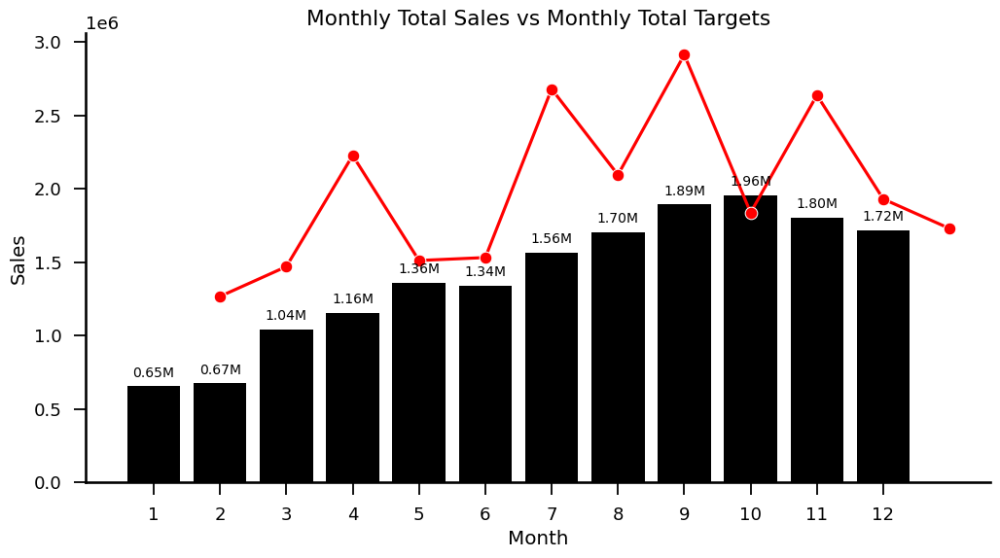

In [494]:
# Issue Month vs. Amount(Numerical)
total_Amount_by_Month = sales_targets.groupby('Order Month') ['Amount'].sum().reset_index()
total_target_by_Month = sales_targets.groupby('Order Month') ['Sales'].sum().reset_index()
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Order Month',y='Amount', data=total_Amount_by_Month ,color='black')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
sns.lineplot(data=total_target_by_Month, x='Order Month', y='Sales',color='red',marker='o')
#plt.xticks(rotation=45)
plt.xlabel('Month')
plt.ylabel('Sales')
plt.title("Monthly Total Sales vs Monthly Total Targets")
plt.show()

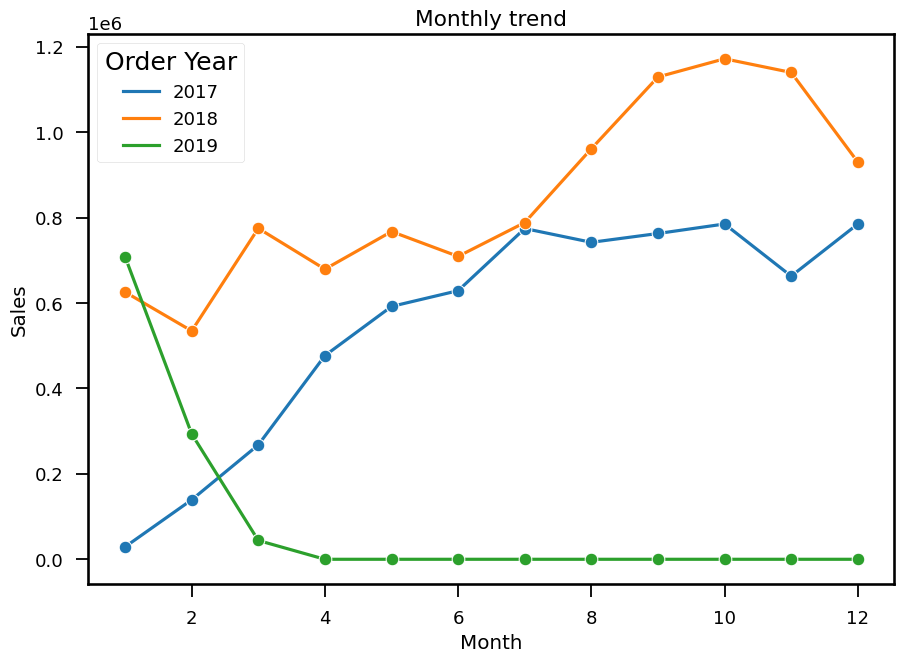

In [619]:
sns.lineplot(data=monthly_sales, x='Order Month', y='Amount',hue='Order Year',marker='o')
#plt.xticks(rotation=45)
plt.xlabel('Month')
plt.ylabel('Sales')
plt.title("Monthly trend")
plt.show()

In [495]:
#Months where target was achieved
sales_targets[sales_targets['Amount'] > sales_targets['Sales']]

,Order Month,Order Year,Amount,Month Year,Target Month,Target Year,Sales
12,1,2018,625883.25,1 - 2018,1,2018,549182.94
20,9,2018,1129625.65,9 - 2018,9,2018,1020831.97
22,11,2018,1140164.83,11 - 2018,11,2018,557333.73
23,12,2018,930342.87,12 - 2018,12,2018,436377.60


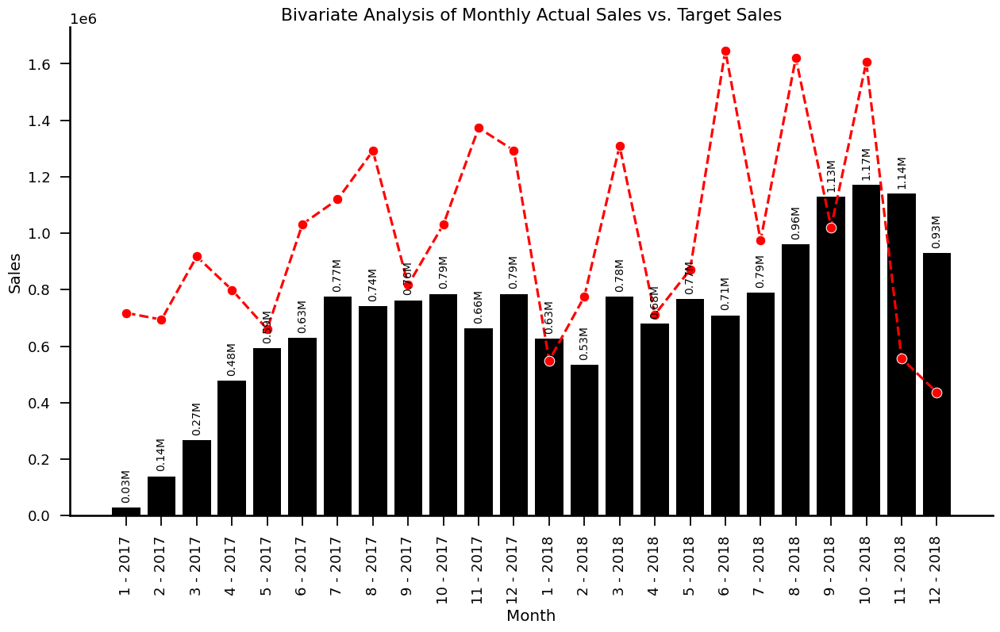

In [680]:
# Create a bivariate plot for actual vs. target sales
plt.figure(figsize=(15, 8))
plot=sns.barplot(data=sales_targets, x='Month Year', y='Amount',color='black')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
sns.lineplot(data=sales_targets, x='Month Year', y='Sales',color='red',marker='o',linestyle="--")
# Set the title and labels
plt.title('Bivariate Analysis of Monthly Actual Sales vs. Target Sales')
plt.xlabel('Month')
plt.ylabel('Sales')
plt.xticks(rotation=90)


# Show the plot
plt.show()

In [682]:
total_Amount_by_Year = sales_targets.groupby('Order Year') ['Amount'].sum().reset_index()
total_Amount_by_Year

,Order Year,Amount
0,2017,6648222.05
1,2018,10214809.43
2,2019,0.00


In [683]:
total_targets_by_year=targets.groupby('Target Year') ['Sales'].sum().reset_index()
total_targets_by_year.Sales=total_targets_by_year.Sales.round(2)
total_targets_by_year

,Target Year,Sales
0,2017,11748997.50
1,2018,12082404.73


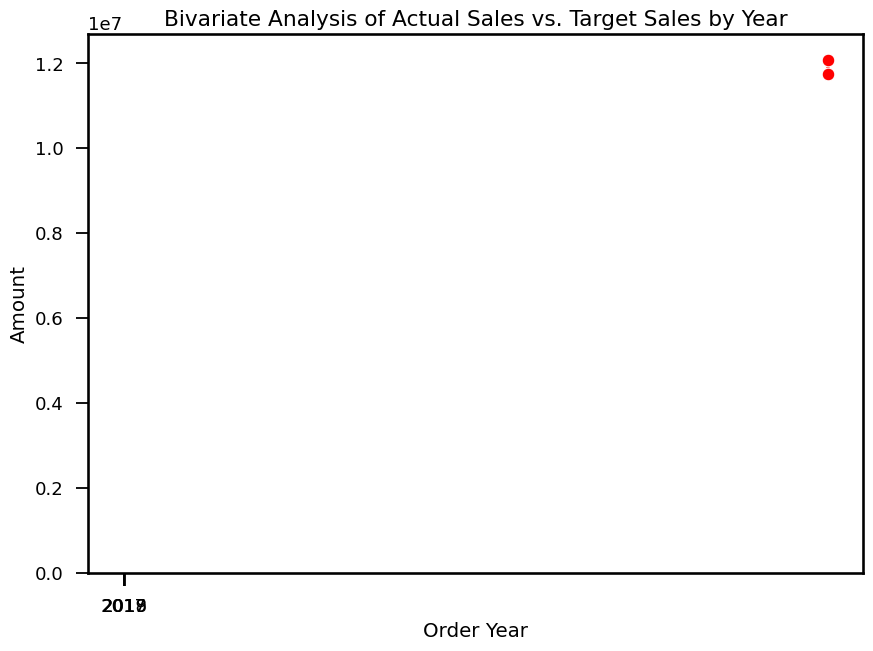

In [686]:


# Issue Year vs. Amount(Numerical)
plt.figure(figsize=(10, 7))
sns.barplot(data=total_Amount_by_Year, x='Order Year', y='Amount',color='black')
#for p in plot.patches:
 #   plot.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')

sns.lineplot(data=total_targets_by_year, x='Target Year', y='Sales',color='red',marker='o',linestyle="--")


#plt.xticks(rotation=45)
plt.title('Bivariate Analysis of Actual Sales vs. Target Sales by Year' )
plt.show()

# BI-VARIATE ANALYSIS WRT AMOUNT

## 1. INVOICE NUMBER

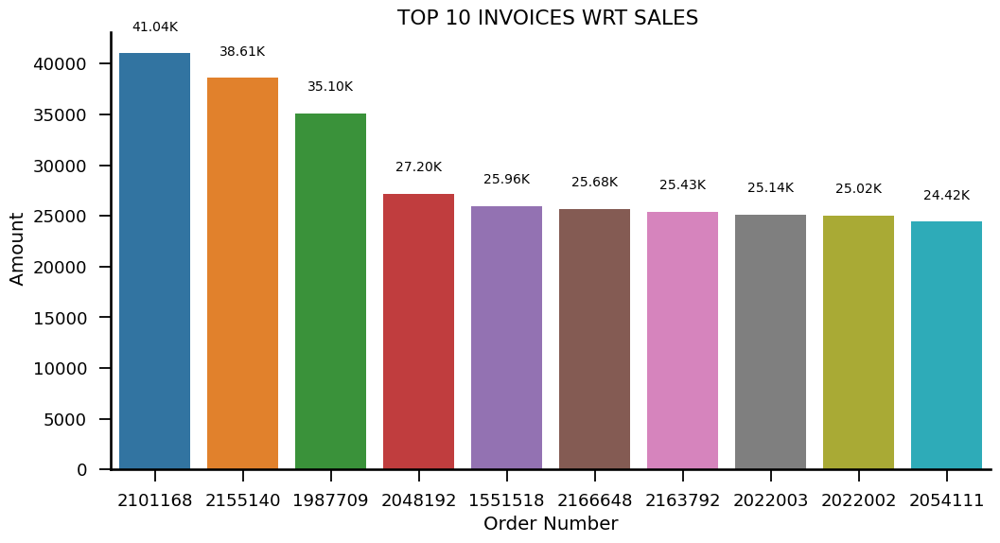

In [341]:
# Invoice Number vs. Amount (Categorical-Numerical)
#top_invoice_by_Amount=[]
#for i in merged_df['Invoice Number'].unique():
#    df8_new=merged_df[merged_df['Invoice Number']==i].groupby(['Order Year','Group']).size().reset_index(name='count').sort_values(by='count',ascending=False)
#    top_invoice_by_Amount.append(df8_new[0:10])
#df8=pd.concat(top_invoice_by_Amount).reset_index(drop=True)


a_inv=merged_df.groupby('Invoice Number')['Amount'].sum().reset_index().sort_values('Amount',ascending=False)[0:10]

# Issue Year vs. Group(Categorical)
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Invoice Number',y='Amount', data=a_inv)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points')
sns.despine()
#plt.xticks(rotation=45)
plt.xlabel('Order Number')
plt.ylabel(' Amount')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('TOP 10 INVOICES WRT SALES ')
plt.show()


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


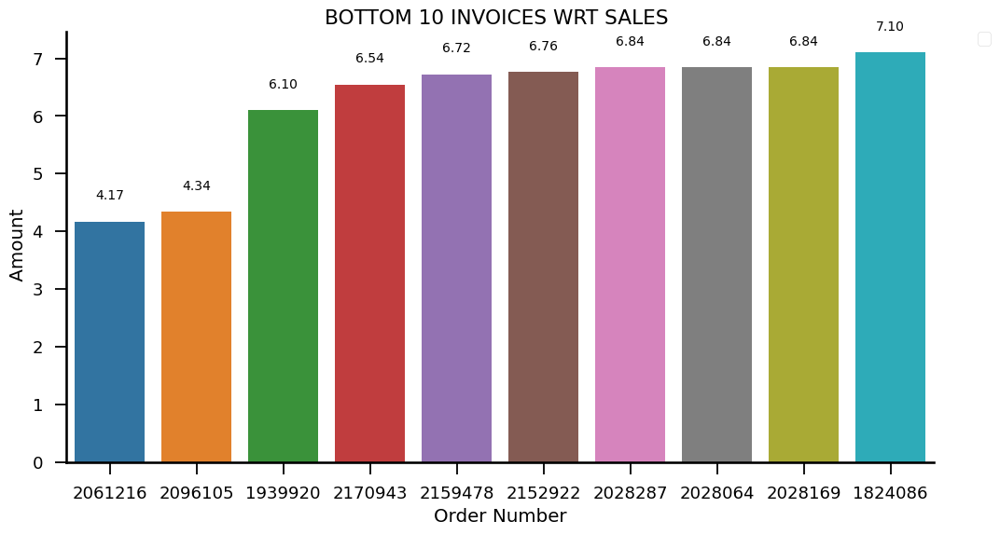

In [342]:
a_inv_2=merged_df.groupby('Invoice Number')['Amount'].sum().reset_index().sort_values('Amount',ascending=True)[0:10]

# Issue Year vs. Group(Categorical)
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Invoice Number',y='Amount', data=a_inv_2)
for p in plot.patches:
    plot.annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points')
sns.despine()
#plt.xticks(rotation=45)
plt.xlabel('Order Number')
plt.ylabel(' Amount')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('BOTTOM 10 INVOICES WRT SALES ')
plt.show()

## 2.QUANTITY OF ITEMS

In [343]:
merged_df.describe()

,Issue Date,Amount
count,260096,260096.000000
mean,2018-04-06 02:14:06.186023424,68.856240
min,2017-01-12 00:00:00,0.720000
25%,2017-10-12 00:00:00,19.227500
50%,2018-05-12 00:00:00,34.080000
75%,2018-10-02 00:00:00,59.760000
max,2019-03-13 00:00:00,41040.000000
std,NaN,286.864197


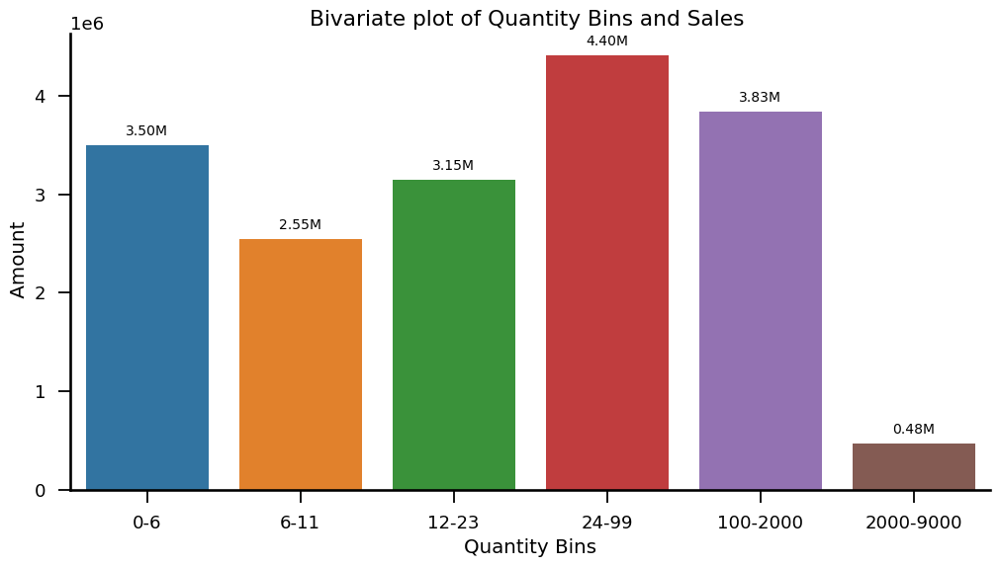

In [344]:
a_qty=merged_df.groupby('Quantity Bins')['Amount'].sum().reset_index().sort_values('Amount',ascending=False)
# Create a scatter plot with color based on quantity sold
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Quantity Bins', y='Amount', data=a_qty)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
#plt.xticks(rotation=45)
plt.xlabel('Quantity Bins')
plt.ylabel(' Amount')

plt.title('Bivariate plot of Quantity Bins and Sales ')
plt.show()

## 3. UNIT PRICE

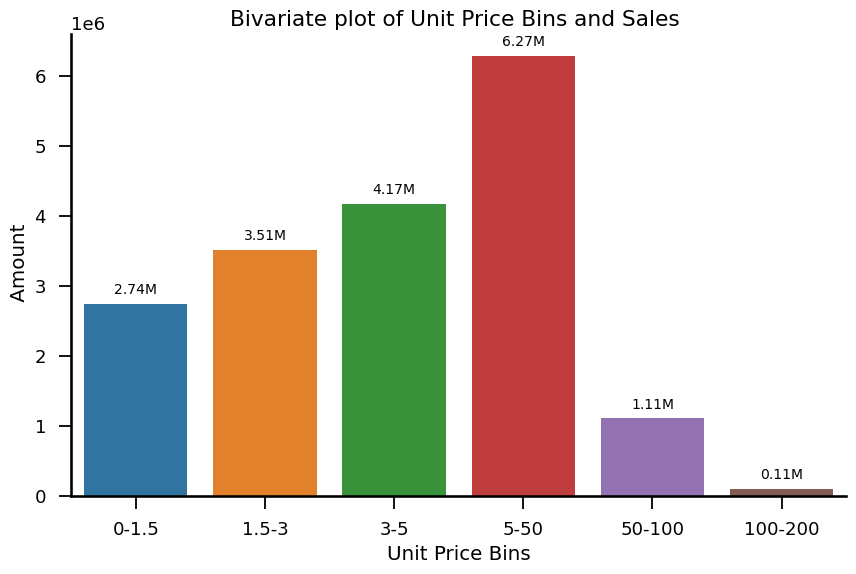

In [345]:
a_ut=merged_df.groupby('Unit Price Bins')['Amount'].sum().reset_index().sort_values('Amount',ascending=False)
# Create a new column for color category based on quantity sold
#merged_df['Color Category'] = merged_df['Qty Items'].apply(assign_color_category)

# Create a scatter plot with color based on quantity sold
plt.figure(figsize=(10, 6))
plot=sns.barplot(x='Unit Price Bins', y='Amount', data=a_ut)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
plt.xlabel('Unit Price Bins')
plt.ylabel(' Amount')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Unit Price Bins and Sales ')
#plt.xticks(rotation=45)
plt.show()

## 4. NET WEIGHT

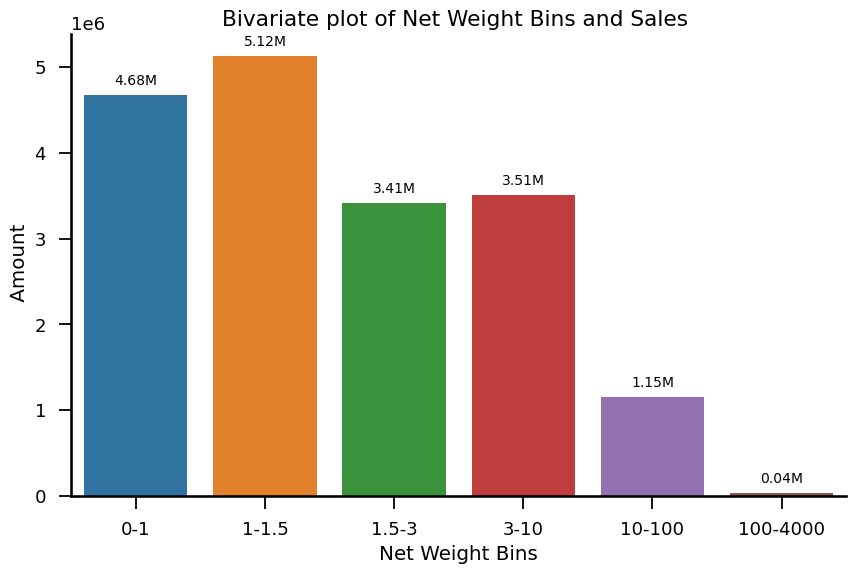

In [346]:
a_nt=merged_df.groupby('Net Weight Bins')['Amount'].sum().reset_index().sort_values('Amount',ascending=False)

# Create a scatter plot with color based on quantity sold
plt.figure(figsize=(10, 6))
plot=sns.barplot(x='Net Weight Bins', y='Amount', data=a_nt)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
plt.xlabel('Net Weight Bins')
plt.ylabel(' Amount')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Net Weight Bins and Sales ')

#plt.xticks(rotation=45)
plt.show()

## 5. Salesperson

In [347]:
targets.head()

,SalesPerson ID,Date,Sales,Target Month,Target Year
0,102,2017-01-01,140768.312981,1,2017
1,102,2017-02-01,124258.753484,2,2017
2,102,2017-03-01,169509.931262,3,2017
3,102,2017-04-01,143465.231352,4,2017
4,102,2017-05-01,98423.627768,5,2017


In [348]:
salesperson.head()

,SalesPerson ID,SalesPerson,Supervisor ID,Supervisor,Manager ID,Manager,Team
0,669,Ayaana Mackenzie,15,Jonathon Childs,1,Ronnie Daly,Retail
1,660,Tess Sanderson,25,Jessica Valentine,1,Ronnie Daly,Retail
2,183,Hywel Hopkins,25,Jessica Valentine,1,Ronnie Daly,Retail
3,102,Serenity Rich,25,Jessica Valentine,1,Ronnie Daly,Retail
4,196,Gillian Gonzales,30,Sarah-Jayne Pennington,1,Ronnie Daly,Retail


In [349]:
temp=merged_df.groupby(['Order Year','Order Month','SalesPerson'])['Amount'].sum().reset_index()
temp['Month Year']=(temp['Order Month']).astype(str)+'-'+(temp['Order Year']).astype(str)
temp

,Order Year,Order Month,SalesPerson,Amount,Month Year
0,2017,1,Akeel Mcleod,3588.75,1-2017
1,2017,1,Ayaana Mackenzie,0.00,1-2017
2,2017,1,Dominykas Bird,4012.48,1-2017
3,2017,1,Gillian Gonzales,5402.42,1-2017
4,2017,1,Hywel Hopkins,1048.20,1-2017
...,...,...,...,...,...
427,2019,12,Sahil Seymour,0.00,12-2019
428,2019,12,Serenity Rich,0.00,12-2019
429,2019,12,Shakil Durham,0.00,12-2019
430,2019,12,Tatiana Adamson,0.00,12-2019


In [359]:
t=targets.merge(salesperson,on='SalesPerson ID',how='left')
temp2=temp.merge(t,left_on=['Order Year','Order Month','SalesPerson'],right_on=['Target Year','Target Month','SalesPerson'],how='inner')
temp2.head()

,Order Year,Order Month,SalesPerson,Amount,Month Year,SalesPerson ID,Date,Sales,Target Month,Target Year,Supervisor ID,Supervisor,Manager ID,Manager,Team
0,2017,1,Akeel Mcleod,3588.75,1-2017,125,2017-01-01,21525.584613,1,2017,35,Tahmina Vinson,2,Duane Frame,Distributors
1,2017,1,Ayaana Mackenzie,0.00,1-2017,669,2017-01-01,0.000000,1,2017,15,Jonathon Childs,1,Ronnie Daly,Retail
2,2017,1,Dominykas Bird,4012.48,1-2017,144,2017-01-01,72301.437981,1,2017,55,Harvey-Lee Solomon,2,Duane Frame,Online
3,2017,1,Gillian Gonzales,5402.42,1-2017,196,2017-01-01,75253.911490,1,2017,30,Sarah-Jayne Pennington,1,Ronnie Daly,Retail
4,2017,1,Kien Mcgee,0.00,1-2017,194,2017-01-01,0.000000,1,2017,35,Tahmina Vinson,2,Duane Frame,Distributors


In [360]:
temp2.shape

(264, 15)

In [361]:
temp2.isna().value_counts().sum()

264

In [362]:
temp2.Sales=temp2.Sales.round(2)
temp2.drop(columns=['Date','Target Month','Target Year', 'Supervisor ID','Manager ID'],inplace=True)


In [363]:

#temp2['Order Month'] = pd.Categorical(temp2['Order Month'], categories=month_order, ordered=True)

# Sort the DataFrame by 'Order Year' and the custom-ordered 'Order Month'
temp2 = temp2.sort_values(by=['Order Year', 'Order Month','SalesPerson ID'])
temp2

,Order Year,Order Month,SalesPerson,Amount,Month Year,SalesPerson ID,Sales,Supervisor,Manager,Team
7,2017,1,Serenity Rich,0.00,1-2017,102,140768.31,Jessica Valentine,Ronnie Daly,Retail
0,2017,1,Akeel Mcleod,3588.75,1-2017,125,21525.58,Tahmina Vinson,Duane Frame,Distributors
2,2017,1,Dominykas Bird,4012.48,1-2017,144,72301.44,Harvey-Lee Solomon,Duane Frame,Online
4,2017,1,Kien Mcgee,0.00,1-2017,194,0.00,Tahmina Vinson,Duane Frame,Distributors
3,2017,1,Gillian Gonzales,5402.42,1-2017,196,75253.91,Sarah-Jayne Pennington,Ronnie Daly,Retail
...,...,...,...,...,...,...,...,...,...,...
261,2018,12,Shakil Durham,109649.58,12-2018,265,41797.67,Tahmina Vinson,Duane Frame,Distributors
258,2018,12,Lorenzo Donovan,94878.95,12-2018,285,31620.18,Harvey-Lee Solomon,Duane Frame,Online
262,2018,12,Tatiana Adamson,91364.71,12-2018,326,56449.88,Harvey-Lee Solomon,Duane Frame,Online
263,2018,12,Tess Sanderson,6241.23,12-2018,660,18374.35,Jessica Valentine,Ronnie Daly,Retail


In [364]:
temp2.tail(10)

,Order Year,Order Month,SalesPerson,Amount,Month Year,SalesPerson ID,Sales,Supervisor,Manager,Team
253,2018,12,Akeel Mcleod,79690.79,12-2018,125,46867.56,Tahmina Vinson,Duane Frame,Distributors
255,2018,12,Dominykas Bird,85951.28,12-2018,144,32769.77,Harvey-Lee Solomon,Duane Frame,Online
257,2018,12,Kien Mcgee,82151.57,12-2018,194,43339.56,Tahmina Vinson,Duane Frame,Distributors
256,2018,12,Gillian Gonzales,75024.41,12-2018,196,10380.64,Sarah-Jayne Pennington,Ronnie Daly,Retail
259,2018,12,Sahil Seymour,149133.91,12-2018,215,92452.27,Sarah-Jayne Pennington,Ronnie Daly,Retail
261,2018,12,Shakil Durham,109649.58,12-2018,265,41797.67,Tahmina Vinson,Duane Frame,Distributors
258,2018,12,Lorenzo Donovan,94878.95,12-2018,285,31620.18,Harvey-Lee Solomon,Duane Frame,Online
262,2018,12,Tatiana Adamson,91364.71,12-2018,326,56449.88,Harvey-Lee Solomon,Duane Frame,Online
263,2018,12,Tess Sanderson,6241.23,12-2018,660,18374.35,Jessica Valentine,Ronnie Daly,Retail
254,2018,12,Ayaana Mackenzie,46218.96,12-2018,669,28028.78,Jonathon Childs,Ronnie Daly,Retail


In [365]:
temp2.shape

(264, 10)

### plotting total sales vs total targets for all salespersons

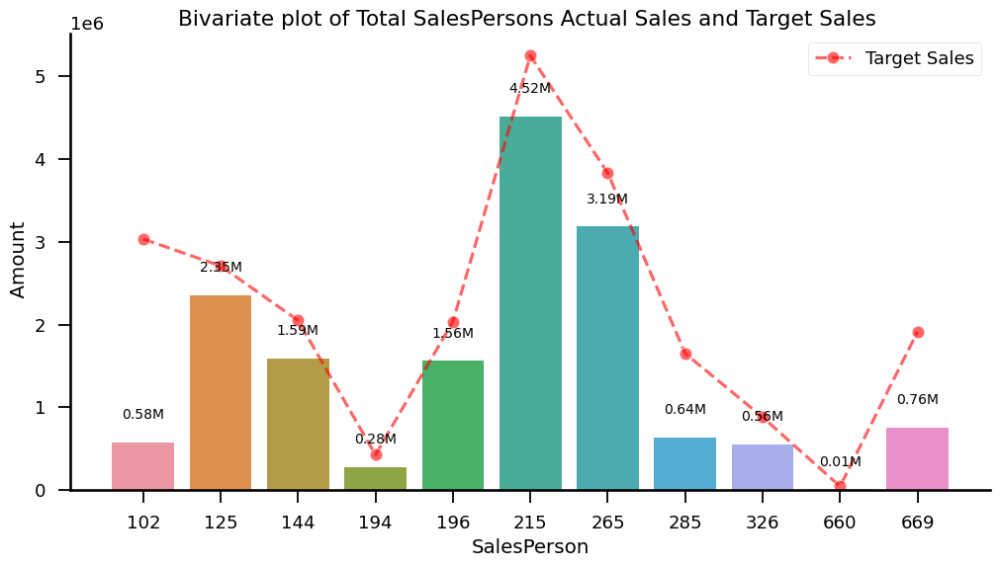

In [366]:
s=temp2.groupby('SalesPerson ID')['Amount'].sum().reset_index()
t=temp2.groupby('SalesPerson ID')['Sales'].sum().reset_index()
# bar plot based on sales and targets
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='SalesPerson ID', y='Amount', data=s)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points')
sns.despine()
sns.lineplot(x='SalesPerson ID',y='Sales',color='red',linestyle='--',marker='o',label='Target Sales',data=t,alpha=0.6)
#plt.xticks(rotation=45)
plt.xlabel('SalesPerson')
plt.ylabel(' Amount')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Total SalesPersons Actual Sales and Target Sales ')


plt.show()

### plotting monthly sales vs targets for each Salesperson in a Year

C:\Users\faizu\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\faizu\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


Text(0.5, 1.05, 'Monthly Actual Sales and Targets by SalesPerson')

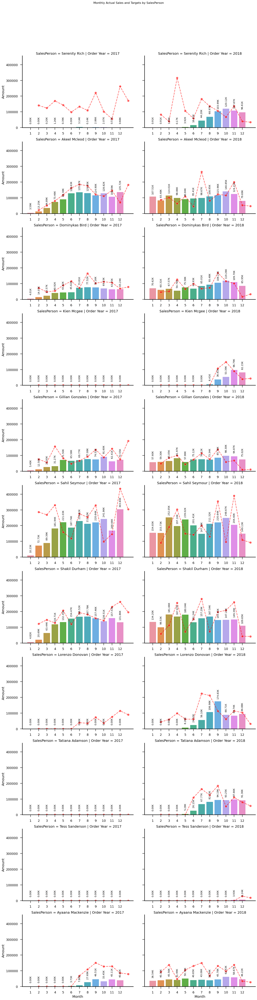

In [368]:
#Plotting the actual Sales
plot = sns.catplot(data=temp2, x='Order Month', y='Amount', col='Order Year', row='SalesPerson', kind='bar', aspect=1.5)

# Accessing each axis in the grid
for ax in plot.axes.flat:
    # Setting the bar values rounded to 2 decimal points and displayed vertically
    for p in ax.patches:
        ax.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 30), textcoords='offset points', rotation=90)
    # Ensure xticks are displayed for all subplots
    ax.set_xticklabels(labels=temp2['Order Month'].value_counts().index)
    ax.tick_params(labelbottom=True)
#Plot the target Sales
plot.map(sns.lineplot,'Order Month','Sales',color='red',linestyle='--',marker='o',label='Target Sales',alpha=0.6)
# Setting the x-labels
#plot.set_xticklabels(labels=temp2['Order Month'].value_counts().index)
plot.set_axis_labels("Month","Amount")


# Adjusting the layout
plot.fig.subplots_adjust(wspace=0.1)
plot.fig.suptitle('Monthly Actual Sales and Targets by SalesPerson',y=1.01)



## 6. Supervisor

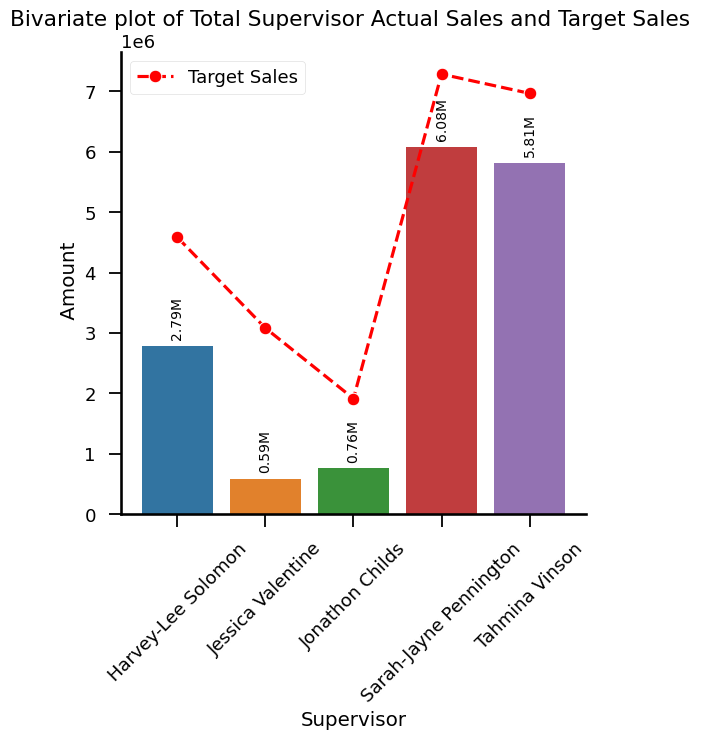

In [369]:
s=temp2.groupby('Supervisor')['Amount'].sum().reset_index()
t=temp2.groupby('Supervisor')['Sales'].sum().reset_index()
# bar plot based on sales and targets
plt.figure(figsize=(6, 6))
plot=sns.barplot(x='Supervisor', y='Amount', data=s)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
sns.lineplot(x='Supervisor',y='Sales',color='red',linestyle='--',marker='o',label='Target Sales',data=t)
plt.xticks(rotation=45)
plt.xlabel('Supervisor')
plt.ylabel(' Amount')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Total Supervisor Actual Sales and Target Sales ')
plt.show()

In [516]:
#aggregated_data =
data=temp2.groupby(['Order Year', 'Order Month','Supervisor']).agg({'Sales': 'sum', 'Amount': 'sum'}).reset_index()

In [517]:
data.head()

,Order Year,Order Month,Supervisor,Sales,Amount
0,2017,1,Harvey-Lee Solomon,72301.44,4012.48
1,2017,1,Jessica Valentine,140768.31,0.00
2,2017,1,Jonathon Childs,0.00,0.00
3,2017,1,Sarah-Jayne Pennington,361266.81,15630.04
4,2017,1,Tahmina Vinson,143725.31,8411.77


### plotting monthly sales vs targets for each Supervisor in a Year

C:\Users\faizu\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\faizu\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


Text(0.5, 1.01, 'Monthly Actual Sales and Targets by Supervisor')

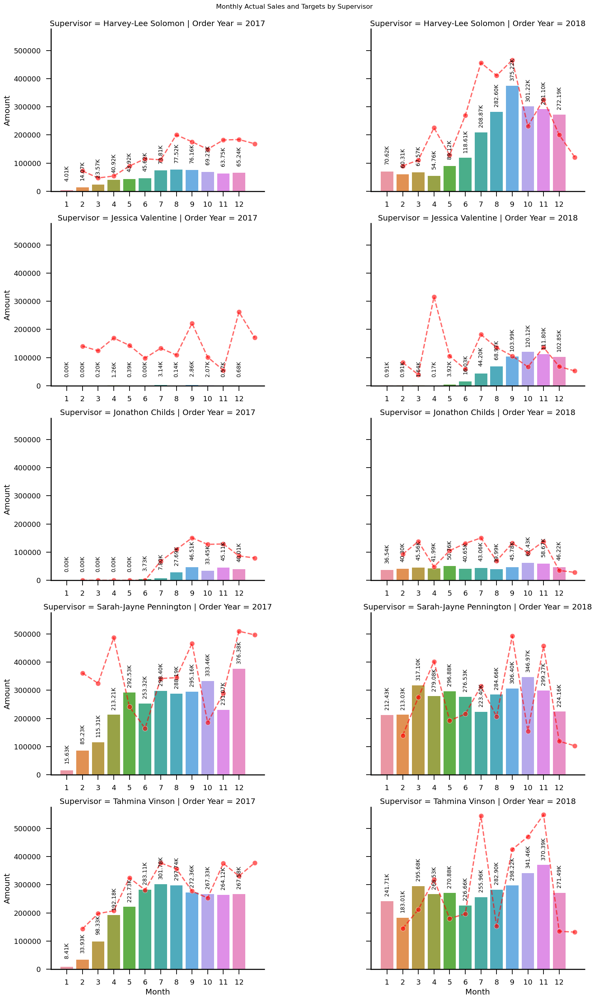

In [519]:
#Plotting the actual Sales
plot = sns.catplot(data=data, x='Order Month', y='Amount', col='Order Year', row='Supervisor', kind='bar', aspect=1.5)

# Accessing each axis in the grid
for ax in plot.axes.flat:
    # Setting the bar values rounded to 2 decimal points and displayed vertically
    for p in ax.patches:
        ax.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 30), textcoords='offset points', rotation=90)
    # Ensure xticks are displayed for all subplots
    ax.set_xticklabels(labels=temp2['Order Month'].value_counts().index)
    ax.tick_params(labelbottom=True)
#Plot the target Sales
plot.map(sns.lineplot,'Order Month','Sales',color='red',linestyle='--',marker='o',label='Target Sales',alpha=0.6)
# Setting the x-labels
#plot.set_xticklabels(labels=temp2['Order Month'].value_counts().index)
plot.set_axis_labels("Month","Amount")


# Adjusting the layout
plot.fig.subplots_adjust(wspace=0.5)
plot.fig.suptitle('Monthly Actual Sales and Targets by Supervisor',y=1.01)



## 7. Manager

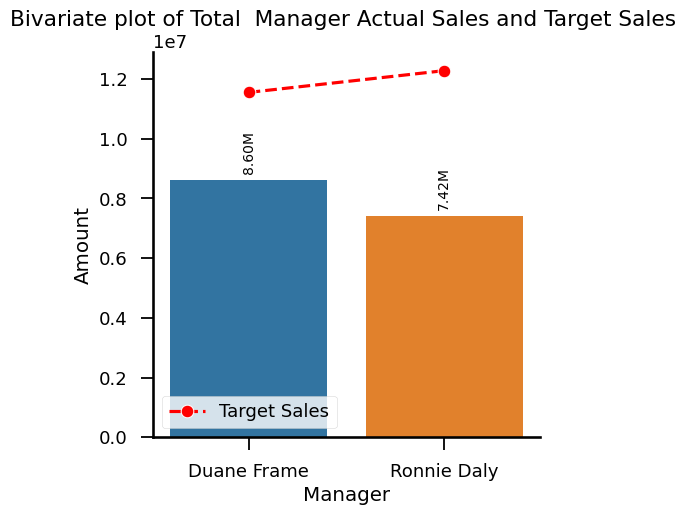

In [373]:
s=temp2.groupby('Manager')['Amount'].sum().reset_index()
t=temp2.groupby('Manager')['Sales'].sum().reset_index()
# bar plot based on sales and targets
plt.figure(figsize=(5, 5))
plot=sns.barplot(x='Manager', y='Amount', data=s)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
sns.lineplot(x='Manager',y='Sales',color='red',linestyle='--',marker='o',label='Target Sales',data=t)

plt.xlabel('Manager')
plt.ylabel('Amount')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Total  Manager Actual Sales and Target Sales ')
plt.show()

In [513]:
#aggregated_data =
data=temp2.groupby(['Order Year', 'Order Month','Manager']).agg({'Sales': 'sum', 'Amount': 'sum'}).reset_index()

In [514]:
data.head()

,Order Year,Order Month,Manager,Sales,Amount
0,2017,1,Duane Frame,216026.75,12424.25
1,2017,1,Ronnie Daly,502035.12,15630.04
2,2017,2,Duane Frame,245146.60,48000.87
3,2017,2,Ronnie Daly,449092.77,85227.47
4,2017,3,Duane Frame,261693.80,121900.31


### plotting monthly sales vs targets for each Manager in a Year

C:\Users\faizu\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\faizu\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


Text(0.5, 1.05, 'Monthly Actual Sales and Targets by Manager')

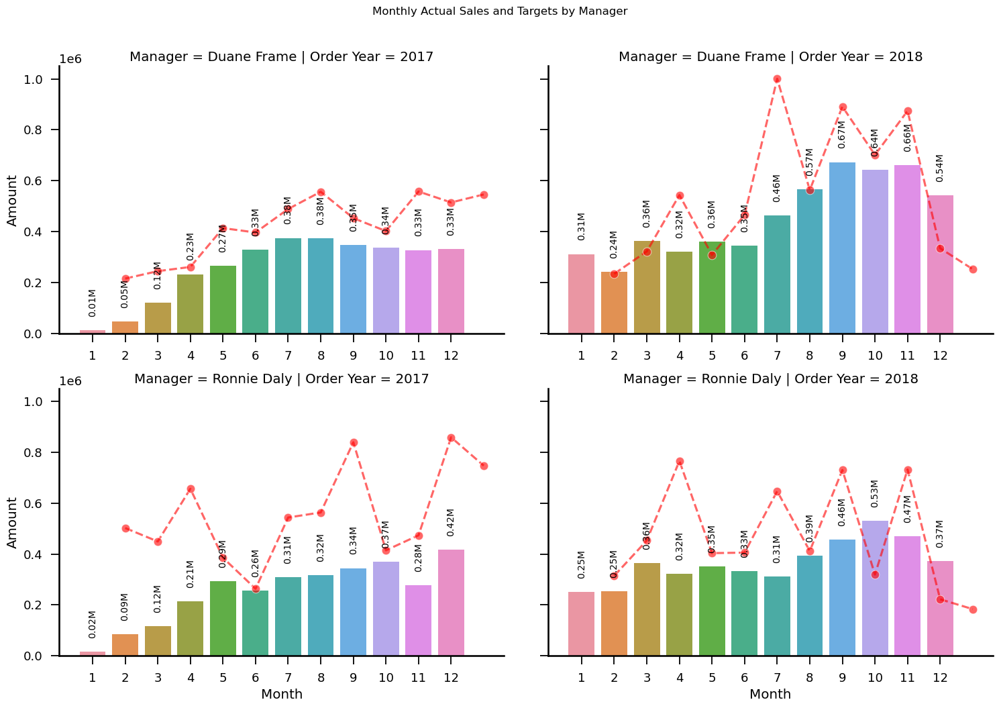

In [515]:
#Plotting the actual Sales
plot = sns.catplot(data=data, x='Order Month', y='Amount', col='Order Year', row='Manager', kind='bar', aspect=1.5)

# Accessing each axis in the grid
for ax in plot.axes.flat:
    # Setting the bar values rounded to 2 decimal points and displayed vertically
    for p in ax.patches:
        ax.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 30), textcoords='offset points', rotation=90)
    # Ensure xticks are displayed for all subplots
    ax.set_xticklabels(labels=temp2['Order Month'].value_counts().index)
    ax.tick_params(labelbottom=True)
#Plot the target Sales
plot.map(sns.lineplot,'Order Month','Sales',color='red',linestyle='--',marker='o',label='Target Sales',alpha=0.6)
# Setting the x-labels
#plot.set_xticklabels(labels=temp2['Order Month'].value_counts().index)
plot.set_axis_labels("Month","Amount")


# Adjusting the layout
plot.fig.subplots_adjust(wspace=0.1)
plot.fig.suptitle('Monthly Actual Sales and Targets by Manager',y=1.05)



## 8. Team

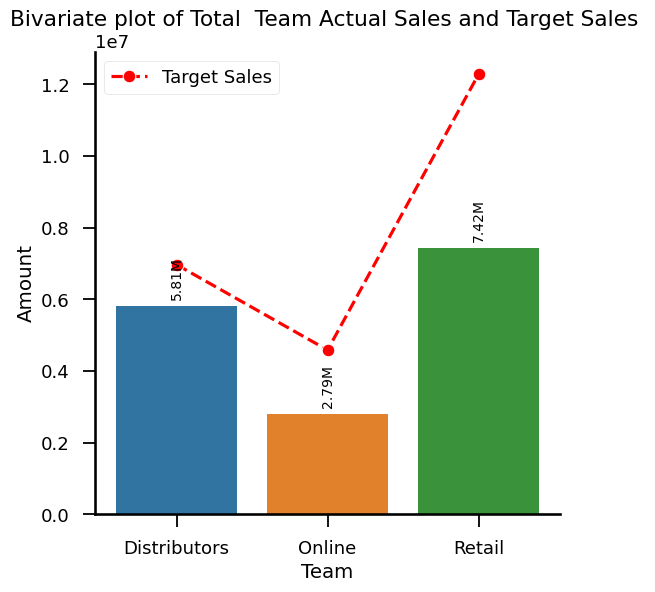

In [377]:
s=temp2.groupby('Team')['Amount'].sum().reset_index()
t=temp2.groupby('Team')['Sales'].sum().reset_index()
# bar plot based on sales and targets
plt.figure(figsize=(6, 6))
plot=sns.barplot(x='Team', y='Amount', data=s)

for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
sns.lineplot(x='Team',y='Sales',color='red',linestyle='--',marker='o',label='Target Sales',data=t)
#plt.xticks(rotation=90)
plt.xlabel('Team')
plt.ylabel('Amount')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Total  Team Actual Sales and Target Sales ')
plt.show()

In [378]:
#aggregated_data =
data=temp2.groupby(['Order Year', 'Order Month','Team']).agg({'Sales': 'sum', 'Amount': 'sum'}).reset_index()

In [379]:
data.head()

,Order Year,Order Month,Team,Sales,Amount
0,2017,1,Distributors,143725.31,8411.77
1,2017,1,Online,72301.44,4012.48
2,2017,1,Retail,502035.12,15630.04
3,2017,2,Distributors,197786.08,33934.69
4,2017,2,Online,47360.52,14066.18


### plotting monthly sales vs targets for each Team in a Year

C:\Users\faizu\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\faizu\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


Text(0.5, 1.05, 'Monthly Actual Sales and Targets by Team')

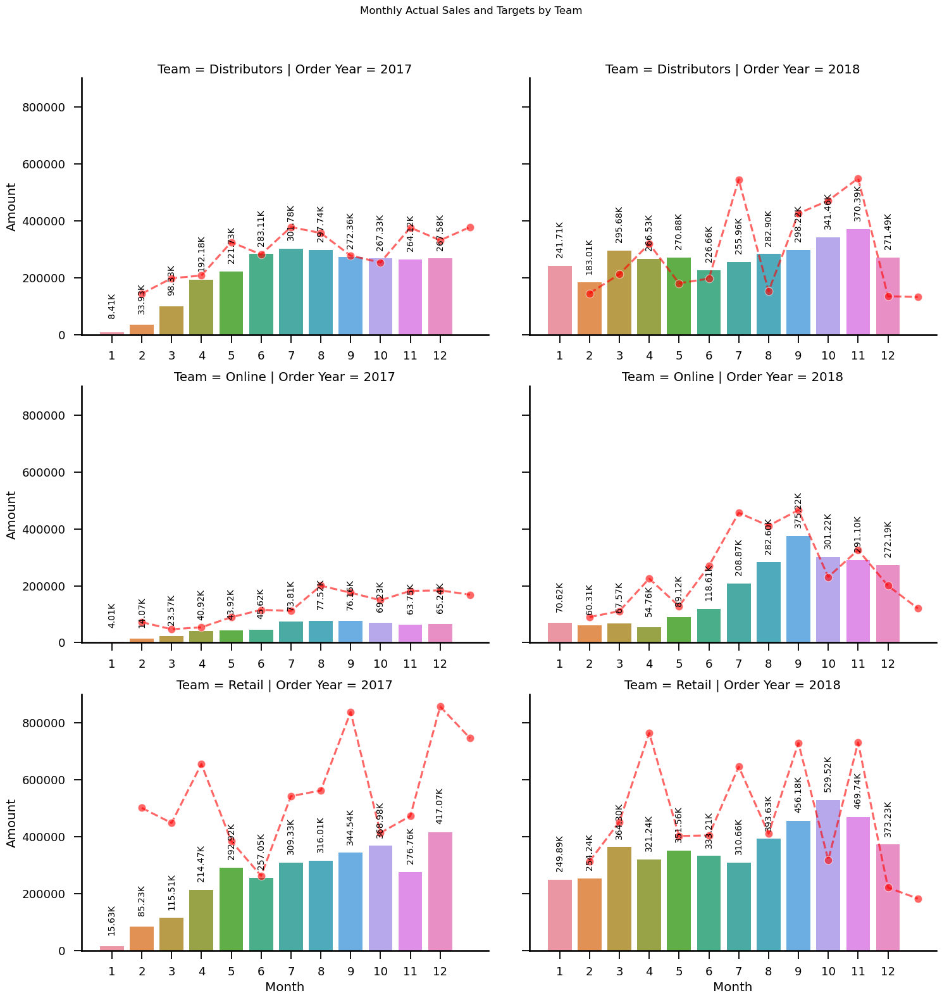

In [511]:
#Plotting the actual Sales
plot = sns.catplot(data=data, x='Order Month', y='Amount', col='Order Year', row='Team', kind='bar', aspect=1.5)

# Accessing each axis in the grid
for ax in plot.axes.flat:
    # Setting the bar values rounded to 2 decimal points and displayed vertically
    for p in ax.patches:
        ax.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 30), textcoords='offset points', rotation=90)
    # Ensure xticks are displayed for all subplots
    ax.set_xticklabels(labels=temp2['Order Month'].value_counts().index)
    #ax.set_yticklabels(labels=ax.get_yticks())
    ax.tick_params(labelbottom=True)
#Plot the target Sales
plot.map(sns.lineplot,'Order Month','Sales',color='red',linestyle='--',marker='o',label='Target Sales',alpha=0.6)
# Setting the x-labels

plot.set_axis_labels("Month","Amount")


# Adjusting the layout
plot.fig.subplots_adjust(wspace=0.1)
plot.fig.suptitle('Monthly Actual Sales and Targets by Team',y=1.05)



## 9. Company

In [381]:
merged_df

,Issue Date,Invoice Number,Amount,Order Month,Order Year,Quantity Bins,Unit Price Bins,Net Weight Bins,SalesPerson,Supervisor,Manager,Team,Company Name,Status,Line of Business,City,Product,Group,Category
0,2017-01-12,1492762,52.98,1,2017,0-6,5-50,0-1,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,Product 1073,Spices,Food
1,2017-01-12,1492762,26.64,1,2017,0-6,3-5,3-10,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,Product 1420,Coffee Pods,Food
2,2017-01-12,1492762,9.60,1,2017,6-11,0-1.5,1.5-3,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,Product 264,Yeast,Food
3,2017-01-13,1492719,17.52,1,2017,0-6,1.5-3,1-1.5,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Granite poly,A,Distributors Lv2,Roslyn,Product 1154,Popcorn,Food
4,2017-01-13,1492719,16.86,1,2017,0-6,1.5-3,1-1.5,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Granite poly,A,Distributors Lv2,Roslyn,Product 1527,Popcorn,Food
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
260091,2019-03-12,2173547,38.88,3,2019,12-23,1.5-3,1-1.5,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Rhino shack,A,Bakery,Roslyn,Product 202,Wheat Flours,Food
260092,2019-03-12,2173547,39.00,3,2019,6-11,3-5,1.5-3,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Rhino shack,A,Bakery,Roslyn,Product 1154,Popcorn,Food
260093,2019-03-12,2173547,39.12,3,2019,6-11,3-5,0-1,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Rhino shack,A,Bakery,Roslyn,Product 668,Popcorn,Food
260094,2019-03-12,2173547,37.68,3,2019,6-11,3-5,0-1,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Rhino shack,A,Bakery,Roslyn,Product 1527,Popcorn,Food


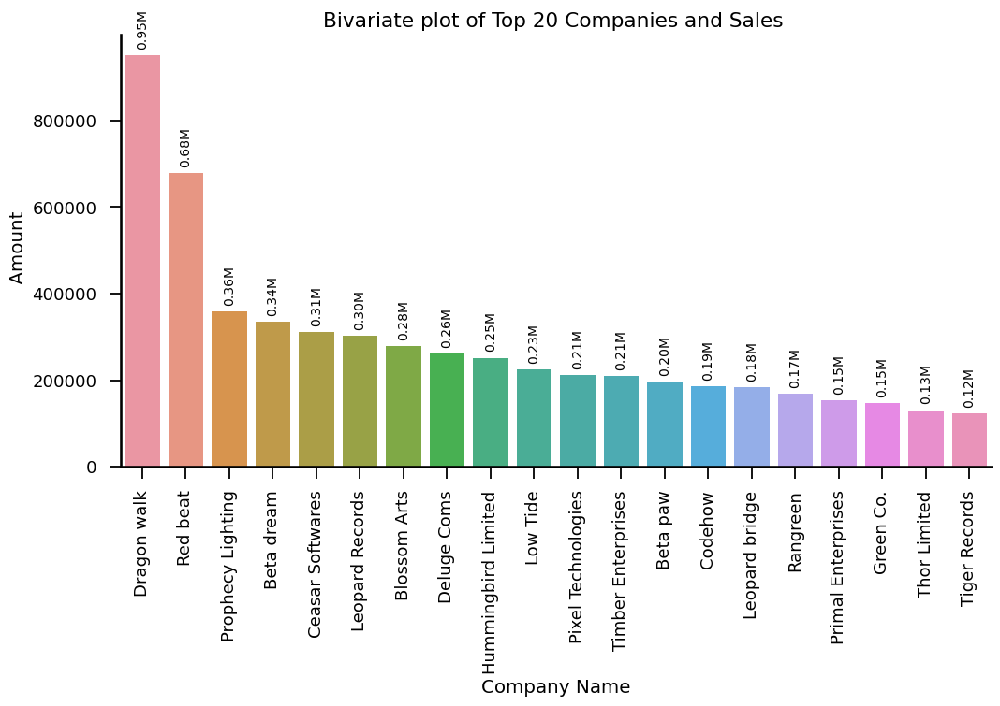

In [382]:
# Amount vs. Company Name (Categorical)
a_com=merged_df.groupby('Company Name')['Amount'].sum().reset_index().sort_values('Amount',ascending=False)[0:20]

# Create a scatter plot with color based on quantity sold
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Company Name', y='Amount', data=a_com)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('Company Name')
plt.ylabel(' Amount')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Top 20 Companies and Sales ')
plt.xticks(rotation=90)
plt.show()

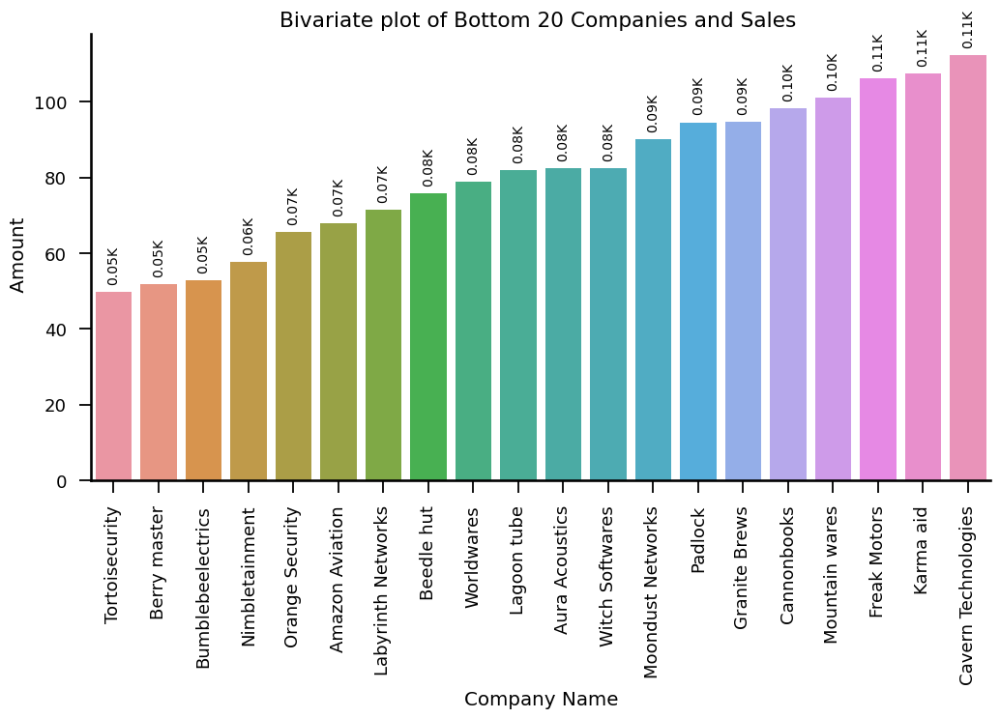

In [383]:
# Amount vs. Company Name (Categorical)
a_com=merged_df.groupby('Company Name')['Amount'].sum().reset_index().sort_values('Amount',ascending=True)[0:20]

# Create a scatter plot with color based on quantity sold
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Company Name', y='Amount', data=a_com)
plt.xlabel('Company Name')
plt.ylabel(' Amount')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Bottom 20 Companies and Sales ')
plt.xticks(rotation=90)
plt.show()

## 10. Status

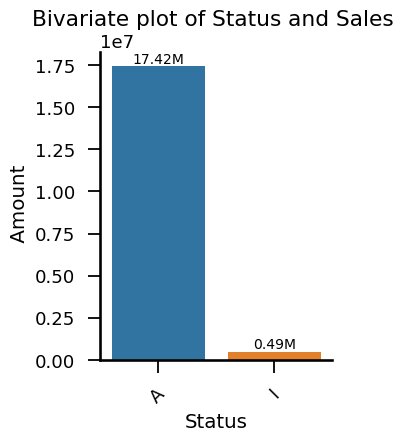

In [384]:
# Amount vs. Status (Categorical)
a_com=merged_df.groupby('Status')['Amount'].sum().reset_index().sort_values('Amount',ascending=False)[0:20]

# Create a scatter plot with color based on quantity sold
plt.figure(figsize=(3, 4))
plot=sns.barplot(x='Status', y='Amount', data=a_com)
plt.xlabel('Status')
plt.ylabel(' Amount')
#bar labels
for p in plot.patches:
                plot.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 5), textcoords='offset points')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
sns.despine()
plt.title('Bivariate plot of Status and Sales ')
plt.xticks(rotation=45)
plt.show()

##  11. Line of Business

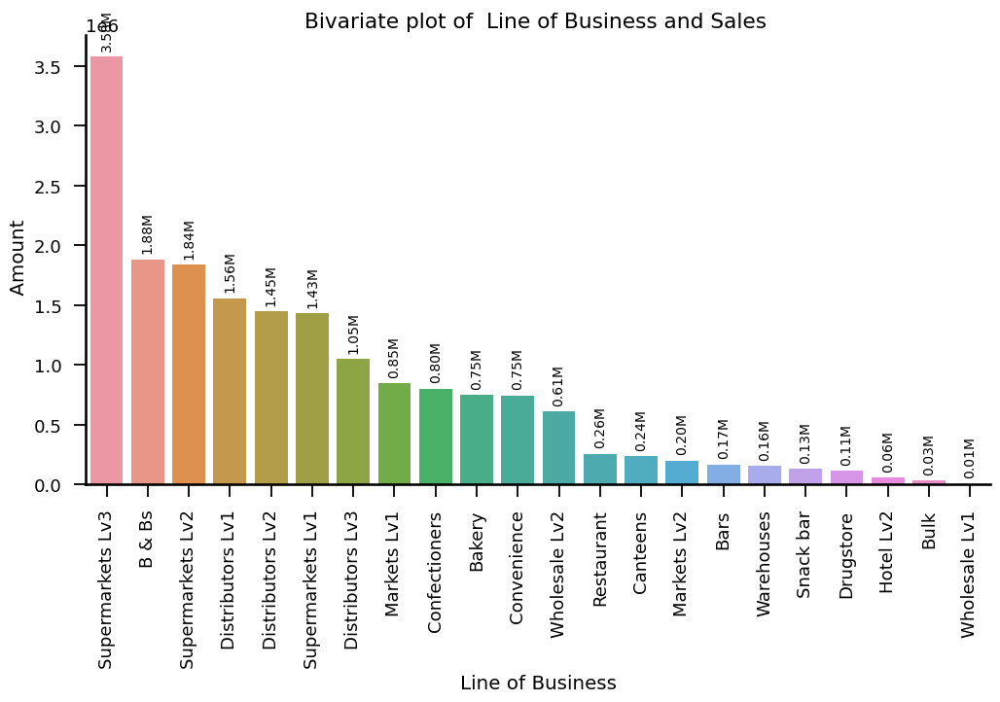

In [385]:
# Amount vs. Line of Business (Categorical)
a_com=merged_df.groupby('Line of Business')['Amount'].sum().reset_index().sort_values('Amount',ascending=False)

# Create a scatter plot with color based on quantity sold
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Line of Business', y='Amount', data=a_com)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('Line of Business')
plt.ylabel(' Amount')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of  Line of Business and Sales ')
plt.xticks(rotation=90)
plt.show()


## 12. City

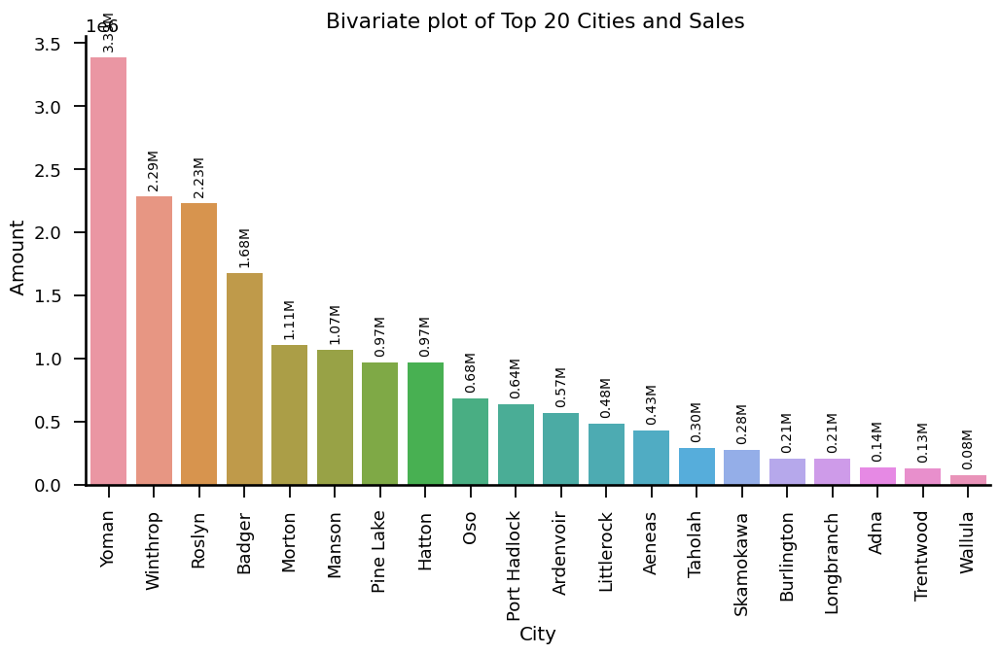

In [386]:
# Amount vs. City (Categorical)
a_com=merged_df.groupby('City')['Amount'].sum().reset_index().sort_values('Amount',ascending=False)[0:20]

# Create a scatter plot with color based on quantity sold
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='City', y='Amount', data=a_com)
plt.xlabel('City')
plt.ylabel(' Amount')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Top 20 Cities and Sales ')
plt.xticks(rotation=90)
plt.show()


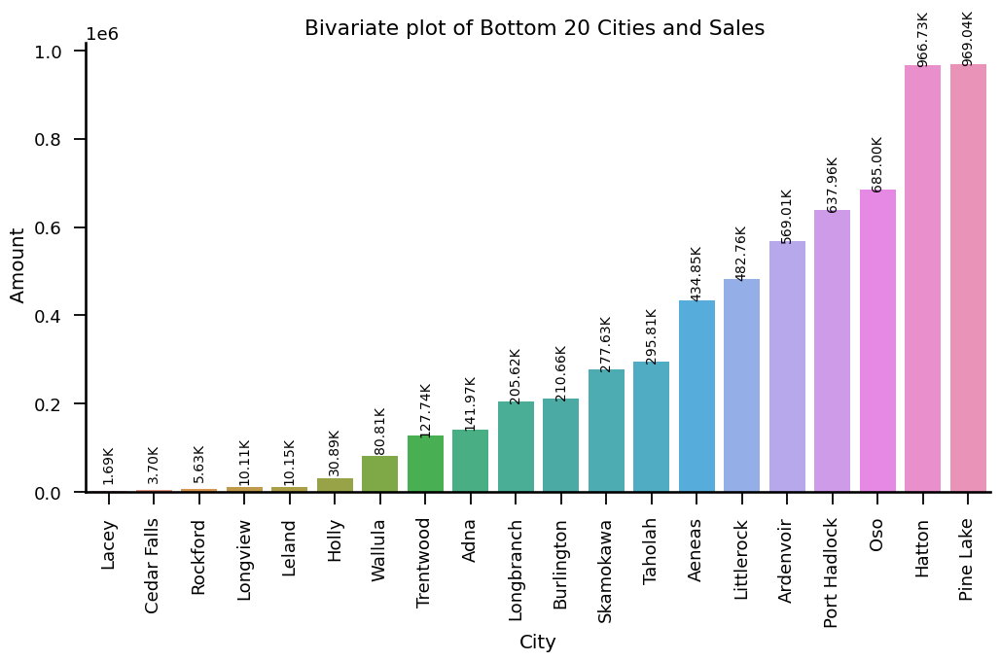

In [387]:
# Amount vs. City (Categorical)
a_com=merged_df.groupby('City')['Amount'].sum().reset_index().sort_values('Amount',ascending=True)[0:20]

# Create a scatter plot with color based on quantity sold
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='City', y='Amount', data=a_com)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('City')
plt.ylabel(' Amount')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Bottom 20 Cities and Sales ')
plt.xticks(rotation=90)
plt.show()

## 13. Product

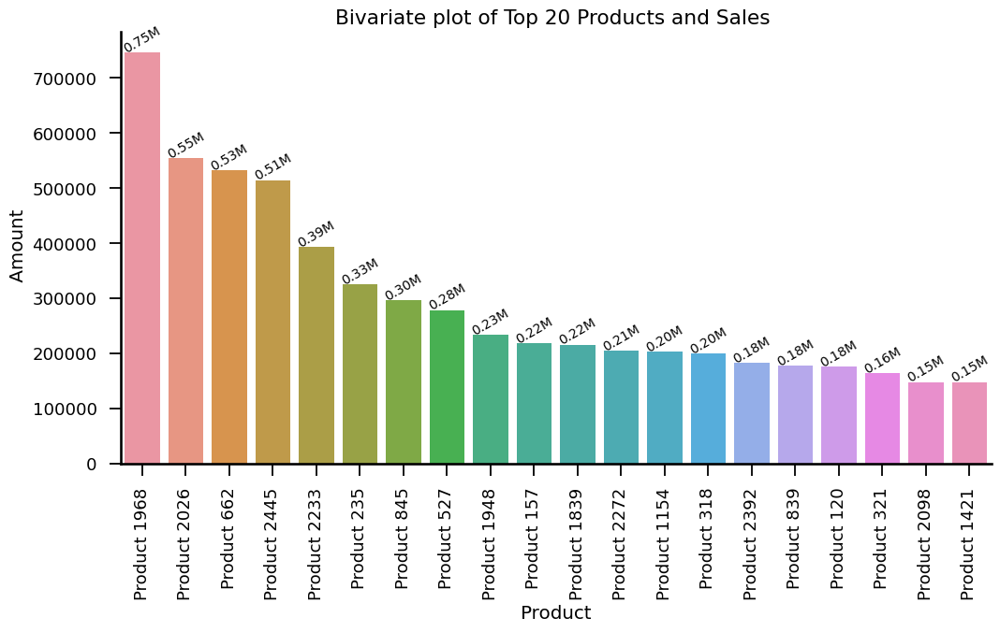

In [388]:
# Amount vs. Product (Categorical)
a_com=merged_df.groupby('Product')['Amount'].sum().reset_index().sort_values('Amount',ascending=False)[0:20]

# Create a scatter plot with color based on quantity sold
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Product', y='Amount', data=a_com)
plt.xlabel('Product')
plt.ylabel(' Amount')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points',rotation=30)
sns.despine()
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Top 20 Products and Sales ')
plt.xticks(rotation=90)
plt.show()

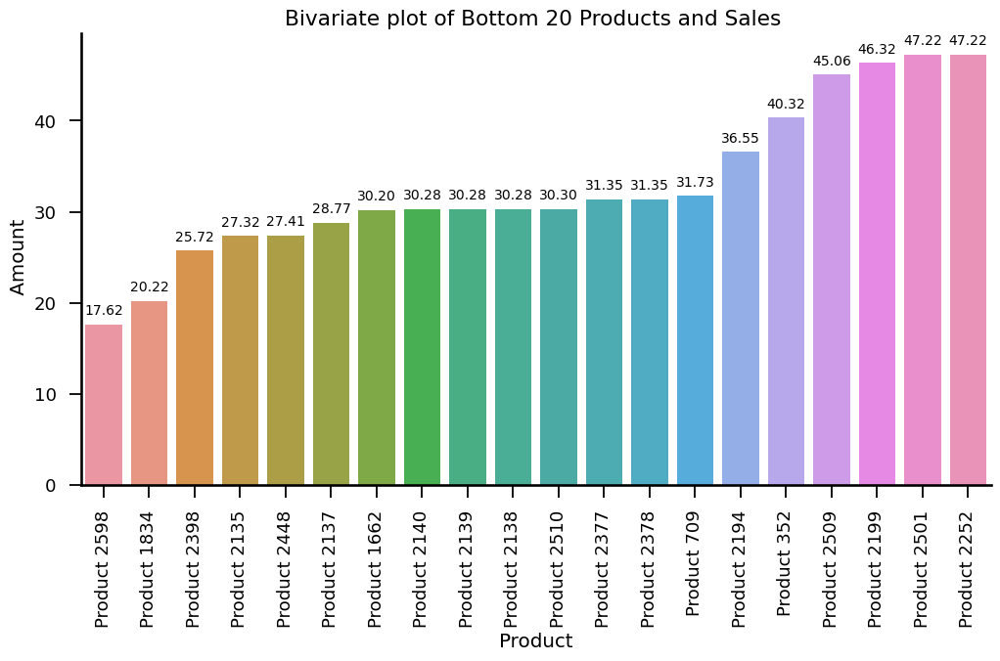

In [389]:
# Amount vs. Product (Categorical)
a_com=merged_df.groupby('Product')['Amount'].sum().reset_index().sort_values('Amount',ascending=True)[0:20]

# Create a scatter plot with color based on quantity sold
plt.figure(figsize=(12, 6))
plot=sns.barplot(x='Product', y='Amount', data=a_com)
plt.xlabel('Product')
plt.ylabel(' Amount')
for p in plot.patches:

        plot.annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Bottom 20 Products and Sales ')
plt.xticks(rotation=90)
plt.show()

## 14. Group

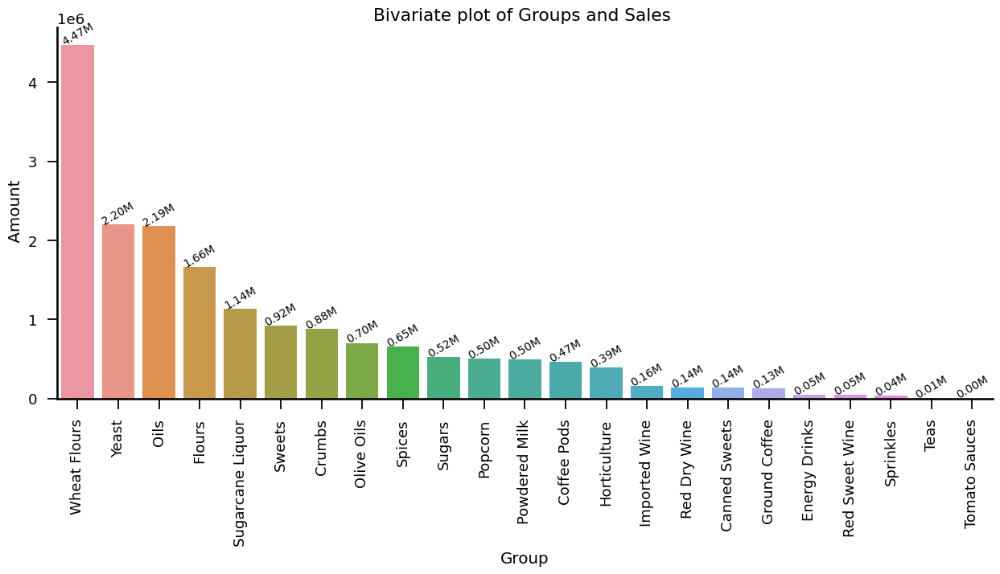

In [390]:
# Amount vs. Group (Categorical)
a_com=merged_df.groupby('Group')['Amount'].sum().reset_index().sort_values('Amount',ascending=False)

# Create a scatter plot with color based on quantity sold
plt.figure(figsize=(15, 6))
plot=sns.barplot(x='Group', y='Amount', data=a_com)
for p in plot.patches:
                plot.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points',rotation=30)
sns.despine()
plt.xlabel('Group')
plt.ylabel(' Amount')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Groups and Sales ')
plt.xticks(rotation=90)

plt.show()

## 15. Category

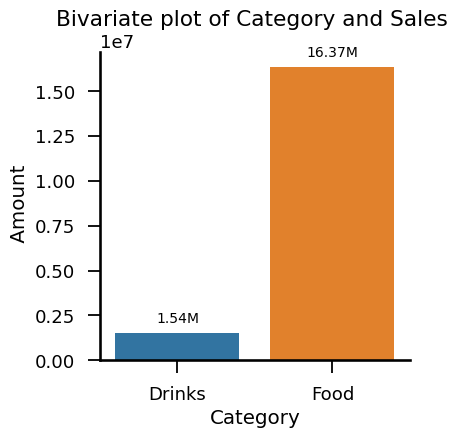

In [391]:
# Amount vs. Category (Categorical)
a_com=merged_df.groupby('Category')['Amount'].sum().reset_index().sort_values('Amount',ascending=True)[0:20]

# Create a scatter plot with color based on quantity sold
plt.figure(figsize=(4, 4))
plot=sns.barplot(x='Category', y='Amount', data=a_com)
for p in plot.patches:
                plot.annotate(f'{p.get_height()/1000000:.2f}M', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
plt.xlabel('Category')
plt.ylabel(' Amount')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Category and Sales ')

plt.show()


- Quantity bins ranging from 24-99 and 100-2000 are the most lucrative, indicating robust demand within these ranges.
- Unit price bins of 5-50 exhibit strong sales, while those in the range of 100-200 lag behind.
- Net weight bins like 0-1 and 1-1.5 show significant traction in sales.
- Salesperson 215 leads in sales, while 326 trails as the lowest performer.
- Supervisors Sarah Jain and Tahmina stand out for their high sales figures, contrasting with Jessica, who records the lowest.
- Duane Frame dominates managerial sales with $8.60 million, followed closely by Ronnie Daly at $7.42 million.
- The retail team emerges as the top performer with $7.42 million in sales, followed by distributors with $4.81 million and online platforms with the lowest at $2.79 million.
- Key players in the market, including Dragonwalk, Red Beat, and Prophecy Lighting, lead in sales, while others like Tortoisecurity and Berry Master lag behind.
- Supermarket Lv3 generates the highest sales at $3.5 million, with Wholesale Lv2 and Bulk registering the lowest figures.

Geographically, Yoman ranks first with $3.3 million in sales, while Lacey ranks at the bottom.
ples like wheat flours ($4.47 million), yeast ($2.20 million), and oils ($2.19 million) dominate the sales charts, whereas less popular items like teas, tomato sauce, and sprinkles struggle to gain traction.
- Food products lead significantly, contributing approximately $16.37 million in sales, while drinks lag behind at $1.54 million.



# BIVARIATE ANALYSIS WRT net weight

In [392]:
merged_df.head()

,Issue Date,Invoice Number,Amount,Order Month,Order Year,Quantity Bins,Unit Price Bins,Net Weight Bins,SalesPerson,Supervisor,Manager,Team,Company Name,Status,Line of Business,City,Product,Group,Category
0,2017-01-12,1492762,52.98,1,2017,0-6,5-50,0-1,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,Product 1073,Spices,Food
1,2017-01-12,1492762,26.64,1,2017,0-6,3-5,3-10,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,Product 1420,Coffee Pods,Food
2,2017-01-12,1492762,9.60,1,2017,6-11,0-1.5,1.5-3,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,Product 264,Yeast,Food
3,2017-01-13,1492719,17.52,1,2017,0-6,1.5-3,1-1.5,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Granite poly,A,Distributors Lv2,Roslyn,Product 1154,Popcorn,Food
4,2017-01-13,1492719,16.86,1,2017,0-6,1.5-3,1-1.5,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Granite poly,A,Distributors Lv2,Roslyn,Product 1527,Popcorn,Food


## 1. Salesperson

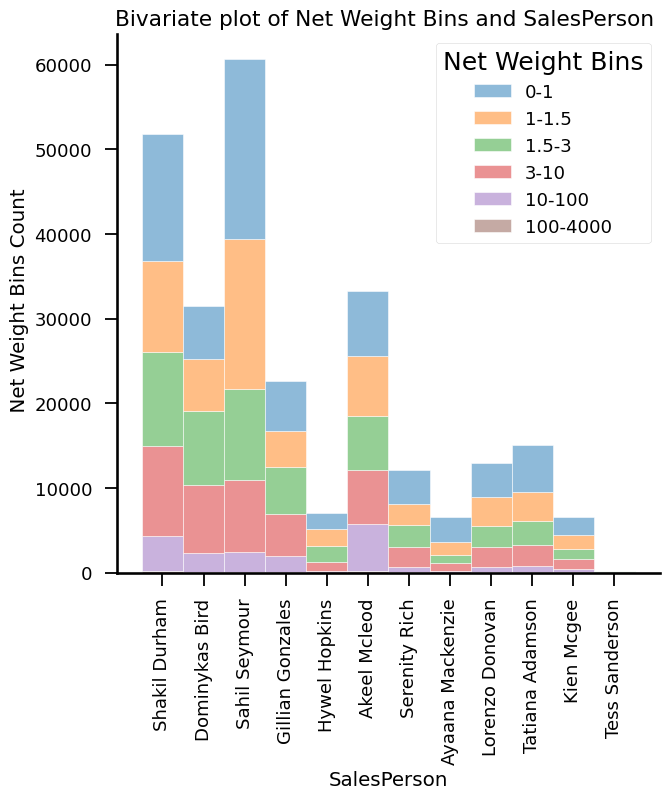

In [532]:
plt.figure(figsize=(7,7))
ax = sns.histplot(data=merged_df, x="SalesPerson", hue="Net Weight Bins",multiple='stack',alpha=0.5,edgecolor = "white")
#sns.move_legend(ax, "lower left", bbox_to_anchor=(0, 1))
plt.xticks(rotation=90)
sns.despine()
plt.xlabel('SalesPerson')
plt.ylabel(' Net Weight Bins Count')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Net Weight Bins and SalesPerson ')
plt.show()

## 2. Supervisor

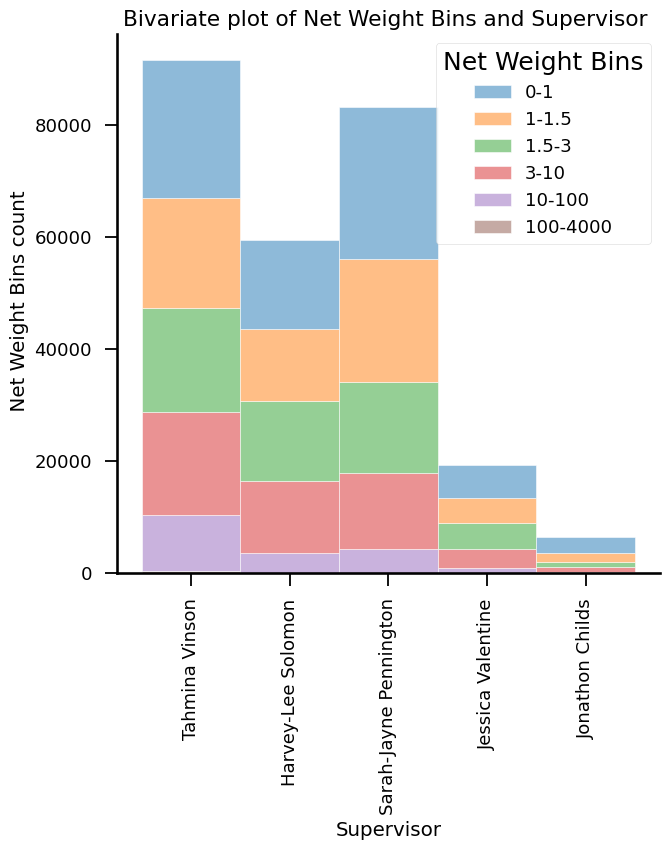

In [394]:
plt.figure(figsize=(7,7))
ax = sns.histplot(data=merged_df, x="Supervisor", hue="Net Weight Bins",multiple='stack',alpha=0.5,edgecolor = "white")
#sns.move_legend(ax, "lower center", bbox_to_anchor=(.5, 1))
plt.xticks(rotation=90)
sns.despine()
plt.xlabel('Supervisor')
plt.ylabel(' Net Weight Bins count')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Net Weight Bins and Supervisor ')
plt.show()

## 3. Company

In [395]:
# Grouping by Net Weight Bins and selecting top 5 Company Name
df_new=pd.DataFrame()
company_counts=[]
for i in merged_df['Net Weight Bins'].unique():
    df_new=merged_df[merged_df['Net Weight Bins']==i].groupby(['Net Weight Bins', 'Company Name']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    company_counts.append(df_new[0:5])
df2=pd.concat(company_counts).reset_index(drop=True)
df2.head(10)

,Net Weight Bins,Company Name,count
0,0-1,Dragon walk,1768
1,0-1,Pixel Technologies,1130
2,0-1,Prophecy Lighting,1110
3,0-1,Red beat,841
4,0-1,Pyramid Networks,814
5,3-10,Red beat,882
6,3-10,Prophecy Lighting,817
7,3-10,Low Tide,811
8,3-10,Beta paw,735
9,3-10,Leopard Records,663


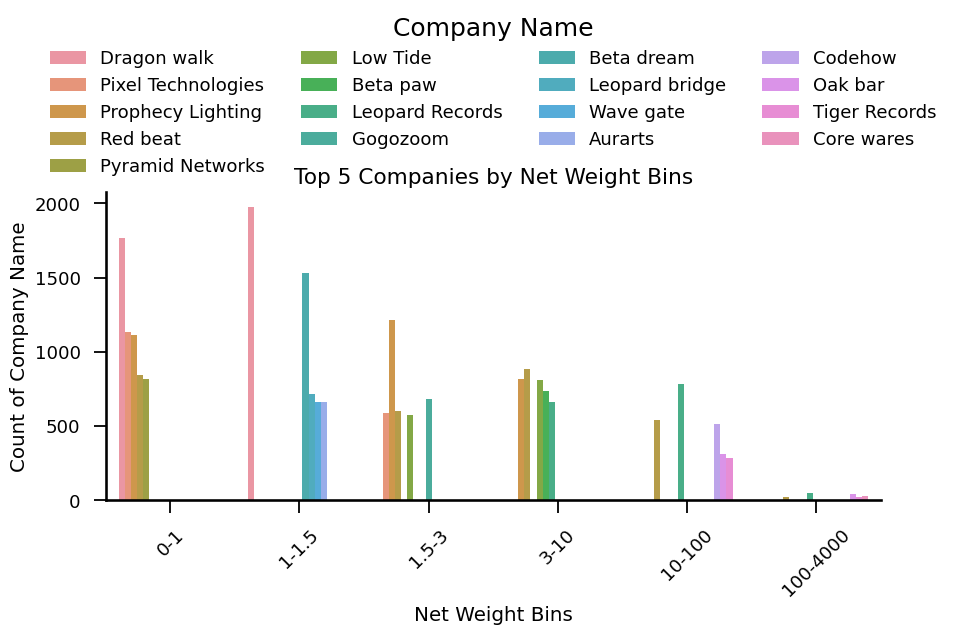

In [396]:
# Plotting the bivariate plot
plt.figure(figsize=(10, 4))
plot=sns.barplot(x='Net Weight Bins', y='count',hue='Company Name', data=df2)
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1),ncol=4, frameon=False)

sns.despine()
plt.xlabel('Net Weight Bins')
plt.ylabel('Count of Company Name')
plt.title('Top 5 Companies by Net Weight Bins')
plt.xticks(rotation=45)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 4. Status

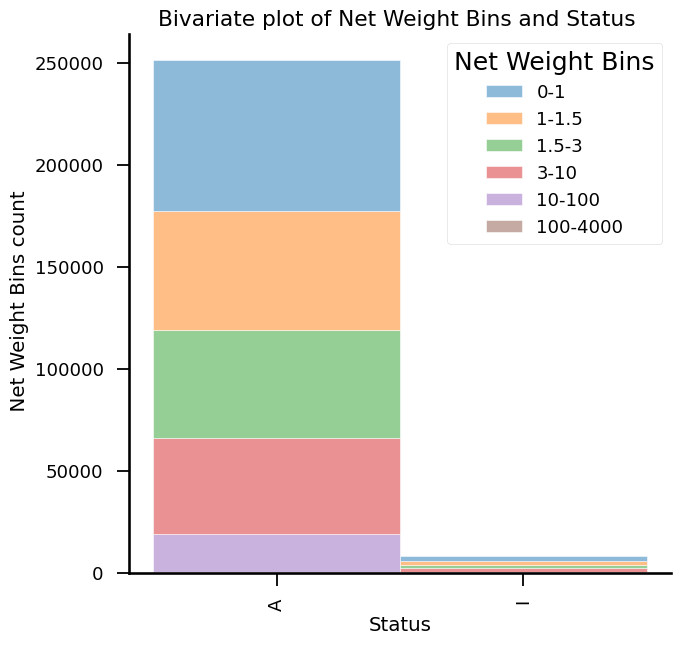

In [397]:
plt.figure(figsize=(7,7))
ax = sns.histplot(data=merged_df, x="Status", hue="Net Weight Bins",multiple='stack',alpha=0.5,edgecolor = "white")
#sns.move_legend(ax, "lower center", bbox_to_anchor=(.5, 1))
plt.xticks(rotation=90)
sns.despine()
plt.xlabel('Status')
plt.ylabel(' Net Weight Bins count')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Net Weight Bins and Status ')
plt.show()

## 5. Line of Business

In [688]:
# Grouping by Net Weight Bins and selecting top 5 Line of Business
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Net Weight Bins'].unique():
    df_new=merged_df[merged_df['Net Weight Bins']==i].groupby(['Net Weight Bins', 'Line of Business']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df3=pd.concat(b_counts).reset_index(drop=True)
df3.head(10)

,Net Weight Bins,Line of Business,count
0,0-1,Distributors Lv2,11168
1,0-1,Supermarkets Lv3,9547
2,0-1,Supermarkets Lv1,8662
3,0-1,Distributors Lv1,6730
4,0-1,Markets Lv1,6604
5,3-10,Supermarkets Lv3,6786
6,3-10,Distributors Lv2,6661
7,3-10,Distributors Lv1,5388
8,3-10,Supermarkets Lv1,5302
9,3-10,Markets Lv1,4986


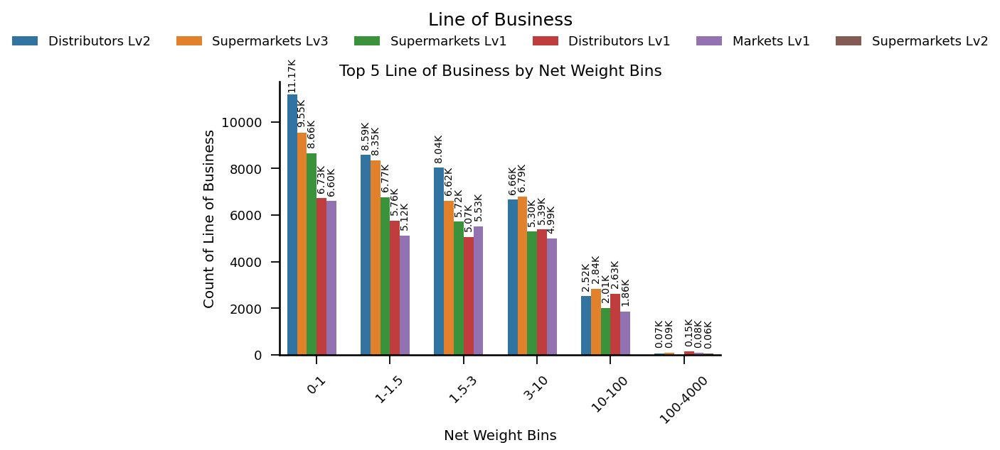

In [692]:
# Plotting the bivariate plot
plt.figure(figsize=(8, 5))
plot=sns.barplot(x='Net Weight Bins', y='count',hue='Line of Business', data=df3)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.08), frameon=False,ncols=6)

sns.despine()
plt.xlabel('Net Weight Bins')

plt.ylabel('Count of Line of Business')
plt.title('Top 5 Line of Business by Net Weight Bins')
plt.xticks(rotation=45)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 6. City

In [400]:
# Grouping by Net Weight Bins and selecting top 5 City
df_new=pd.DataFrame()
City_counts=[]
for i in merged_df['Net Weight Bins'].unique():
    df_new=merged_df[merged_df['Net Weight Bins']==i].groupby(['Net Weight Bins', 'City']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    City_counts.append(df_new[0:5])
df4=pd.concat(City_counts).reset_index(drop=True)
df4.head(10)

,Net Weight Bins,City,count
0,0-1,Yoman,14950
1,0-1,Roslyn,10117
2,0-1,Winthrop,8829
3,0-1,Badger,6335
4,0-1,Port Hadlock,5272
5,3-10,Badger,8075
6,3-10,Roslyn,7621
7,3-10,Yoman,5349
8,3-10,Winthrop,4371
9,3-10,Manson,3092


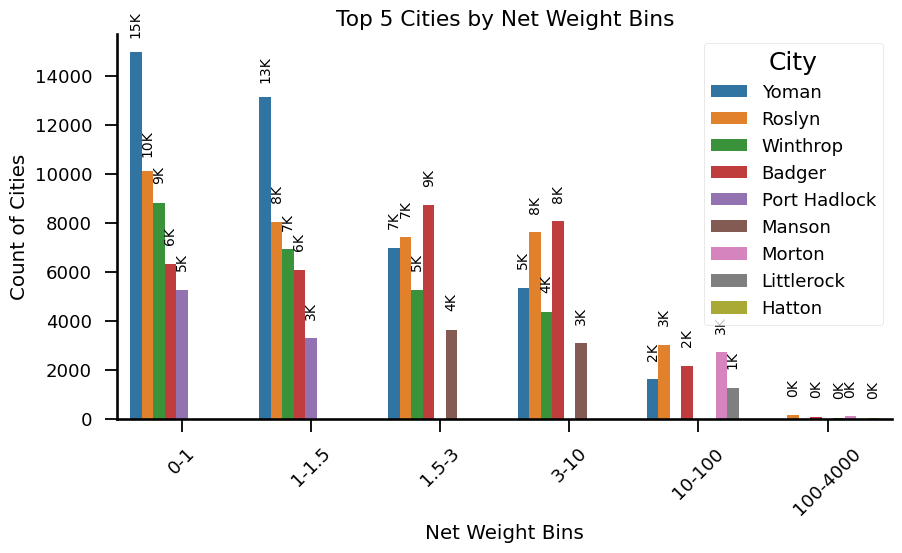

In [401]:
# Plotting the bivariate plot
plt.figure(figsize=(10, 5))
plot=sns.barplot(x='Net Weight Bins', y='count',hue='City', data=df4)
sns.move_legend(ax, "lower center", bbox_to_anchor=(.5, 1), frameon=False)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('Net Weight Bins')
plt.ylabel('Count of Cities')
plt.title('Top 5 Cities by Net Weight Bins')
plt.xticks(rotation=45)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 7. Product

In [402]:
# Grouping by Net Weight Bins and selecting top 5 Product
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Net Weight Bins'].unique():
    df_new=merged_df[merged_df['Net Weight Bins']==i].groupby(['Net Weight Bins', 'Product']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df5=pd.concat(b_counts).reset_index(drop=True)
df5.head(10)

,Net Weight Bins,Product,count
0,0-1,Product 1154,2369
1,0-1,Product 2233,2230
2,0-1,Product 235,1929
3,0-1,Product 2445,1926
4,0-1,Product 839,1668
5,3-10,Product 235,1467
6,3-10,Product 157,1286
7,3-10,Product 2445,1105
8,3-10,Product 2233,993
9,3-10,Product 839,978


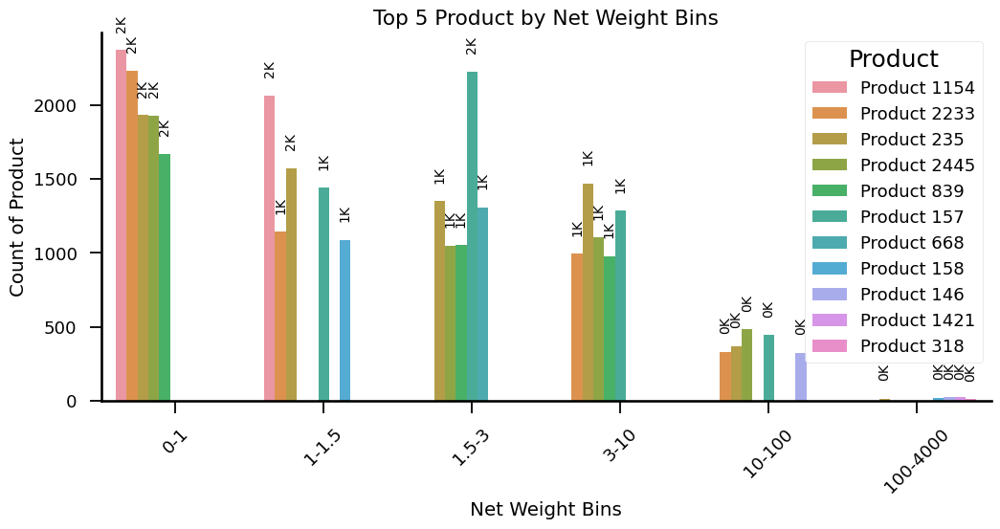

In [403]:
# Plotting the bivariate plot
plt.figure(figsize=(12, 5))
plot=sns.barplot(x='Net Weight Bins', y='count',hue='Product', data=df5)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)

sns.move_legend(ax, "lower center", bbox_to_anchor=(.5, 1), frameon=False)

sns.despine()
plt.xlabel('Net Weight Bins')
plt.ylabel('Count of Product')
plt.title('Top 5 Product by Net Weight Bins')
plt.xticks(rotation=45)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 8. Group

In [404]:
# Grouping by Net Weight Bins and selecting top 5 Group
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Net Weight Bins'].unique():
    df_new=merged_df[merged_df['Net Weight Bins']==i].groupby(['Net Weight Bins', 'Group']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df6=pd.concat(b_counts).reset_index(drop=True)
df6.head(10)

,Net Weight Bins,Group,count
0,0-1,Oils,17095
1,0-1,Wheat Flours,14828
2,0-1,Yeast,12588
3,0-1,Popcorn,5453
4,0-1,Powdered Milk,3273
5,3-10,Wheat Flours,11124
6,3-10,Oils,10321
7,3-10,Yeast,8424
8,3-10,Powdered Milk,2850
9,3-10,Popcorn,2376


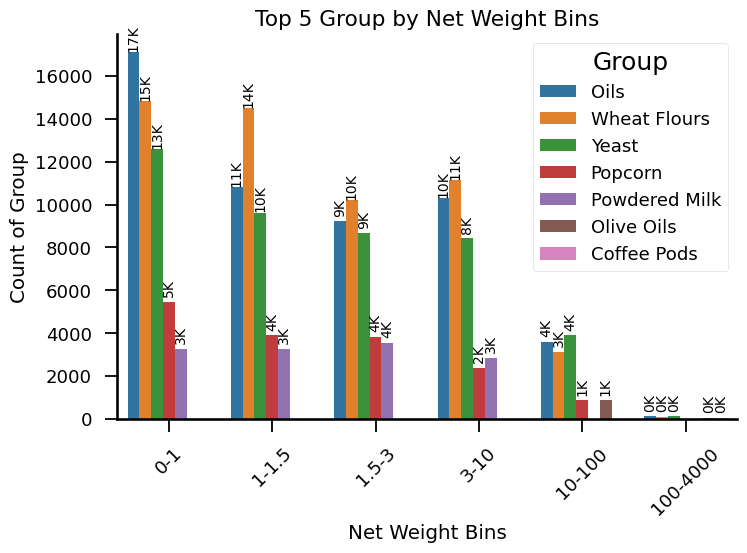

In [405]:
# Plotting the bivariate plot
plt.figure(figsize=(8, 5))
plot=sns.barplot(x='Net Weight Bins', y='count',hue='Group', data=df6)
sns.move_legend(ax, "lower center", bbox_to_anchor=(.5, 1), frameon=False)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('Net Weight Bins')
plt.ylabel('Count of Group')
plt.title('Top 5 Group by Net Weight Bins')
plt.xticks(rotation=45)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 9. Category

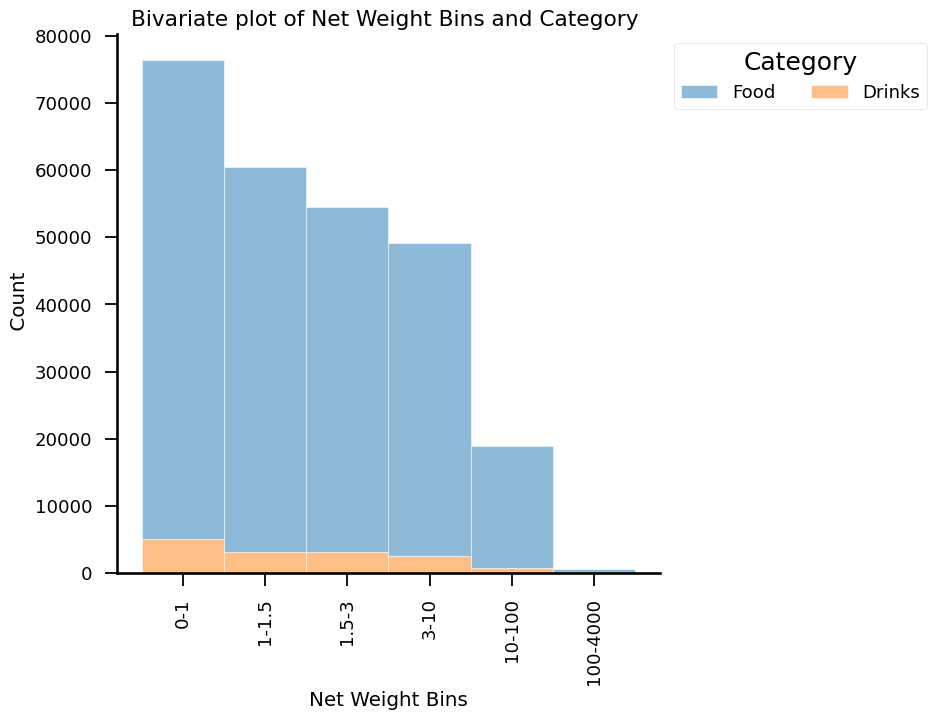

In [406]:
plt.figure(figsize=(7,7))
plot = sns.histplot(data=merged_df, x="Net Weight Bins",hue='Category',multiple='stack',edgecolor = "white",alpha=0.5)

sns.despine()
sns.move_legend(plot, "upper left", bbox_to_anchor=(1.01, 1),ncol=2)

plt.xticks(rotation=90)
sns.despine()
plt.xlabel('Net Weight Bins')
plt.ylabel(' Count')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Net Weight Bins and Category ')
plt.show()

# BIVARIATE ANALYSIS WRT SALESPERSON

In [407]:
merged_df.head()

,Issue Date,Invoice Number,Amount,Order Month,Order Year,Quantity Bins,Unit Price Bins,Net Weight Bins,SalesPerson,Supervisor,Manager,Team,Company Name,Status,Line of Business,City,Product,Group,Category
0,2017-01-12,1492762,52.98,1,2017,0-6,5-50,0-1,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,Product 1073,Spices,Food
1,2017-01-12,1492762,26.64,1,2017,0-6,3-5,3-10,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,Product 1420,Coffee Pods,Food
2,2017-01-12,1492762,9.60,1,2017,6-11,0-1.5,1.5-3,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,Product 264,Yeast,Food
3,2017-01-13,1492719,17.52,1,2017,0-6,1.5-3,1-1.5,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Granite poly,A,Distributors Lv2,Roslyn,Product 1154,Popcorn,Food
4,2017-01-13,1492719,16.86,1,2017,0-6,1.5-3,1-1.5,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Granite poly,A,Distributors Lv2,Roslyn,Product 1527,Popcorn,Food


## 1. Supervisor

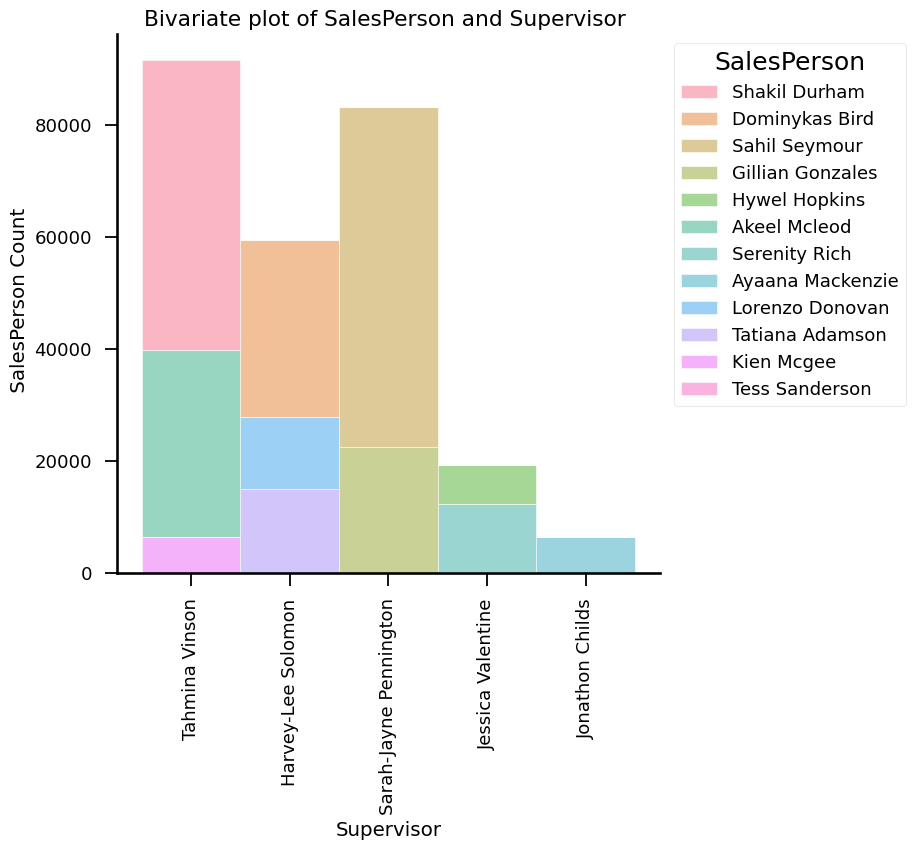

In [408]:
plt.figure(figsize=(7,7))
plot = sns.histplot(data=merged_df, x="Supervisor", hue="SalesPerson",multiple='stack',alpha=0.5,edgecolor = "white")
sns.move_legend(plot, "upper left", bbox_to_anchor=(1.01, 1))

sns.despine()
plt.xticks(rotation=90)
sns.despine()
plt.xlabel('Supervisor')
plt.ylabel(' SalesPerson Count')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of SalesPerson and Supervisor ')
plt.show()

## 2. Company

In [409]:
# Grouping by SalesPerson and selecting top 5 Company Name
df_new=pd.DataFrame()
company_counts=[]
for i in merged_df['SalesPerson'].unique():
    df_new=merged_df[merged_df['SalesPerson']==i].groupby(['SalesPerson', 'Company Name']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    company_counts.append(df_new[0:5])
df2=pd.concat(company_counts).reset_index(drop=True)
df2.head(10)

,SalesPerson,Company Name,count
0,Shakil Durham,Prophecy Lighting,3990
1,Shakil Durham,Red beat,3094
2,Shakil Durham,Pixel Technologies,2787
3,Shakil Durham,Leopard bridge,2331
4,Shakil Durham,Primal Enterprises,2113
5,Dominykas Bird,Core wares,1988
6,Dominykas Bird,Global Solutions,1008
7,Dominykas Bird,Maze master,930
8,Dominykas Bird,Green Electronics,924
9,Dominykas Bird,Silver Lining Navigations,865


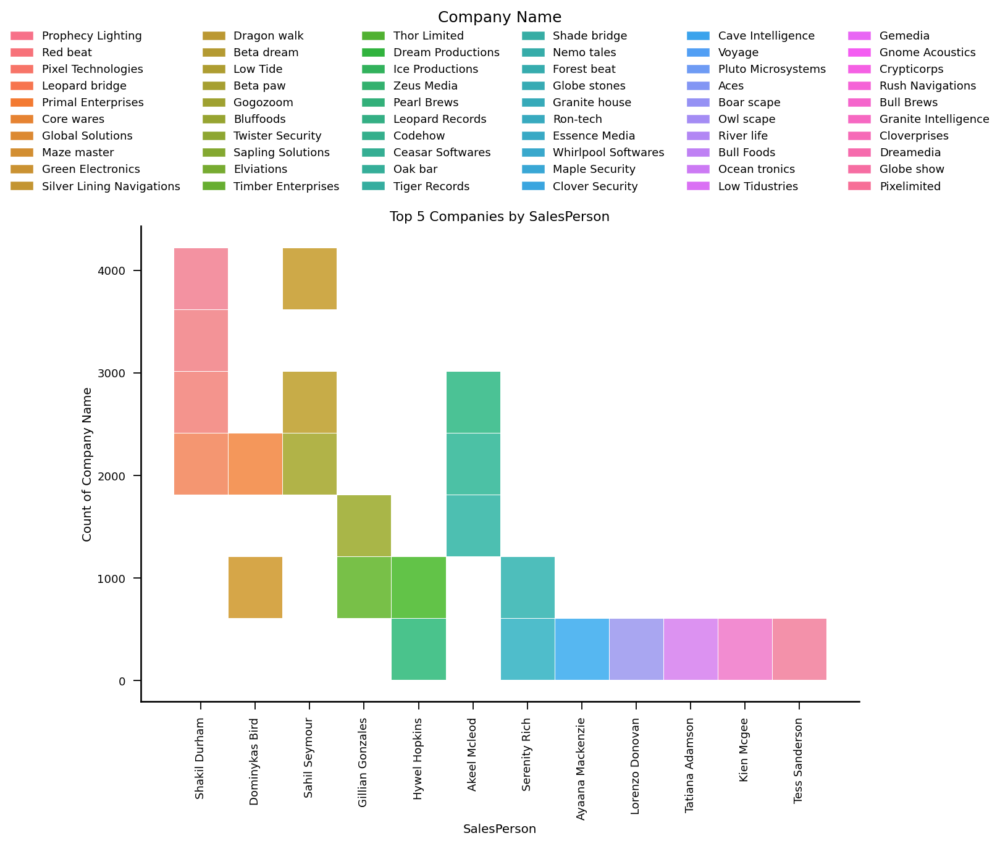

In [410]:
# Plotting the bivariate plot
plt.figure(figsize=(15, 10))
plot=sns.histplot(x='SalesPerson', y='count',hue='Company Name',data=df2,edgecolor = "white")
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.05),ncol=6, frameon=False)

sns.despine()
plt.xlabel('SalesPerson')
plt.ylabel('Count of Company Name')
plt.title('Top 5 Companies by SalesPerson')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 3. Status

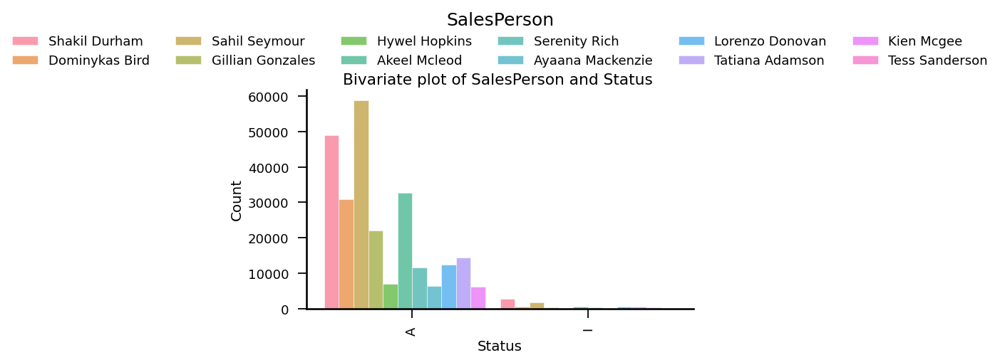

In [694]:
plt.figure(figsize=(7,4))
plot = sns.histplot(data=merged_df, x="Status",hue='SalesPerson',multiple='dodge',alpha=0.7,edgecolor='white')
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.05),ncol=6, frameon=False)

plt.xticks(rotation=90)
sns.despine()
plt.xlabel('Status')

#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of SalesPerson and Status ')
plt.show()

## 4. Line of Business

In [412]:
# Grouping by SalesPerson and selecting top 5 Line of Business
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['SalesPerson'].unique():
    df_new=merged_df[merged_df['SalesPerson']==i].groupby(['SalesPerson', 'Line of Business']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df3=pd.concat(b_counts).reset_index(drop=True)
df3.head(10)

,SalesPerson,Line of Business,count
0,Shakil Durham,Supermarkets Lv3,15989
1,Shakil Durham,Markets Lv1,8506
2,Shakil Durham,Distributors Lv2,7596
3,Shakil Durham,Distributors Lv1,4385
4,Shakil Durham,Convenience,3281
5,Dominykas Bird,Distributors Lv2,5793
6,Dominykas Bird,Supermarkets Lv1,4451
7,Dominykas Bird,Convenience,4261
8,Dominykas Bird,Markets Lv1,4186
9,Dominykas Bird,Distributors Lv1,3710


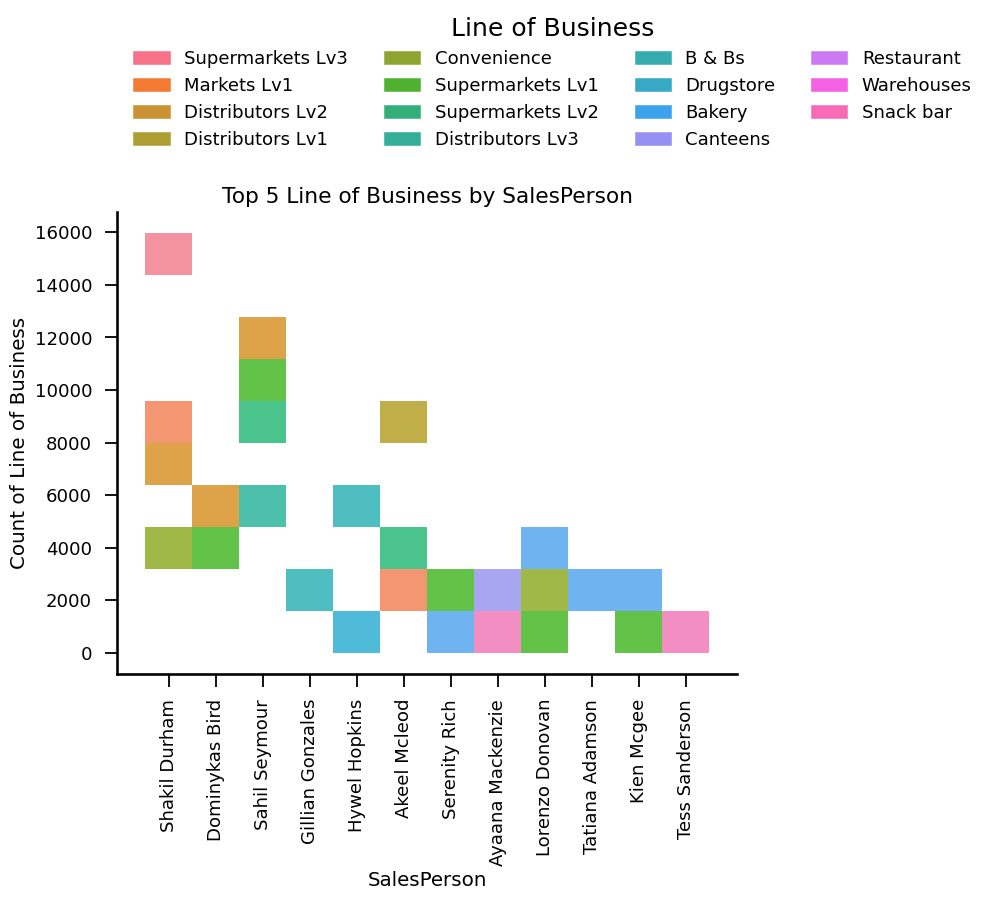

In [413]:
# Plotting the bivariate plot
plt.figure(figsize=(8, 6))
plot=sns.histplot(x='SalesPerson', y='count',hue='Line of Business', data=df3)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.move_legend(plot, "lower left", bbox_to_anchor=(0, 1.1), frameon=False,ncols=4)

sns.despine()
plt.xlabel('SalesPerson')

plt.ylabel('Count of Line of Business')
plt.title('Top 5 Line of Business by SalesPerson')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 5. City

In [414]:
# Grouping by Net Weight Bins and selecting top 5 City
df_new=pd.DataFrame()
City_counts=[]
for i in merged_df['SalesPerson'].unique():
    df_new=merged_df[merged_df['SalesPerson']==i].groupby(['SalesPerson', 'City']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    City_counts.append(df_new[0:5])
df4=pd.concat(City_counts).reset_index(drop=True)
df4.head(10)

,SalesPerson,City,count
0,Shakil Durham,Roslyn,36395
1,Shakil Durham,Manson,15370
2,Dominykas Bird,Badger,31508
3,Sahil Seymour,Yoman,42050
4,Sahil Seymour,Pine Lake,12773
5,Sahil Seymour,Skamokawa,4303
6,Sahil Seymour,Adna,1210
7,Sahil Seymour,Longview,306
8,Gillian Gonzales,Hatton,13532
9,Gillian Gonzales,Aeneas,4463


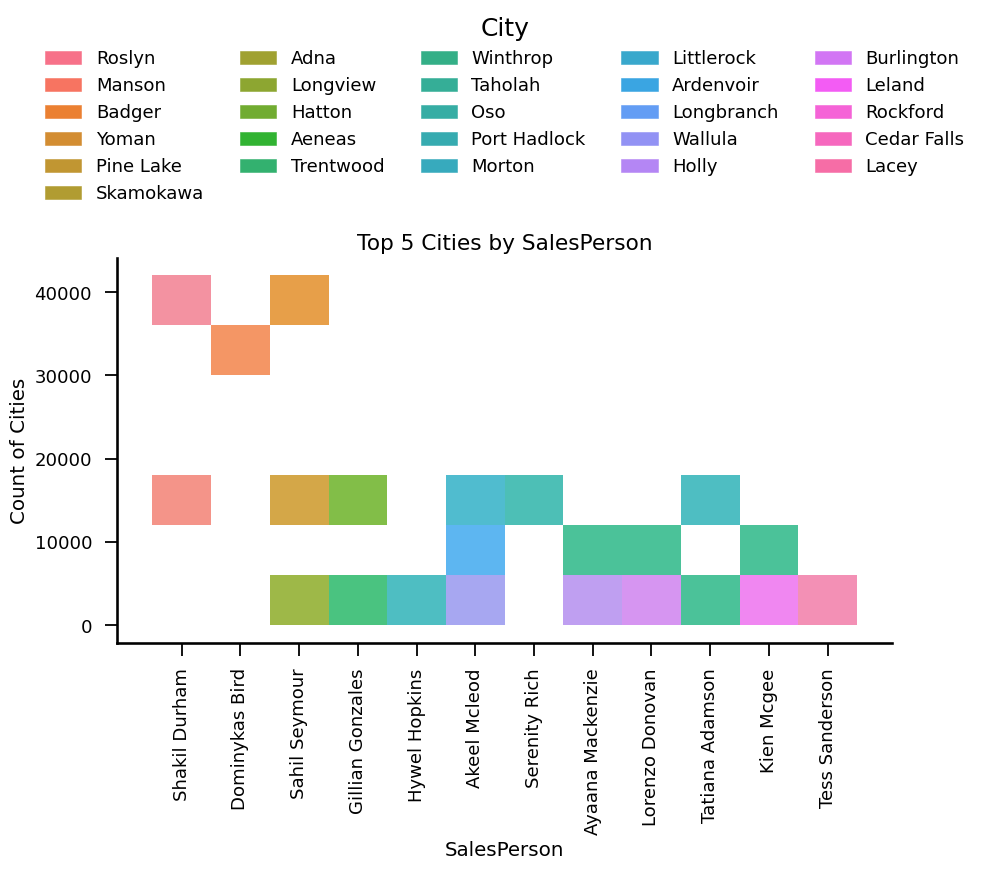

In [415]:
# Plotting the bivariate plot
plt.figure(figsize=(10, 5))
plot=sns.histplot(x='SalesPerson', y='count',hue='City', data=df4)
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1), frameon=False,ncols=5)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('SalesPerson')
plt.ylabel('Count of Cities')
plt.title('Top 5 Cities by SalesPerson')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 6. Product

In [696]:
# Grouping by SalesPerson and selecting top 5 Product
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['SalesPerson'].unique():
    df_new=merged_df[merged_df['SalesPerson']==i].groupby(['SalesPerson', 'Product']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df5=pd.concat(b_counts).reset_index(drop=True)
df5.head(10)

,SalesPerson,Product,count
0,Shakil Durham,Product 157,1503
1,Shakil Durham,Product 1154,1353
2,Shakil Durham,Product 2233,1111
3,Shakil Durham,Product 235,1095
4,Shakil Durham,Product 668,930
5,Dominykas Bird,Product 235,1046
6,Dominykas Bird,Product 157,1016
7,Dominykas Bird,Product 1154,971
8,Dominykas Bird,Product 2233,863
9,Dominykas Bird,Product 839,848


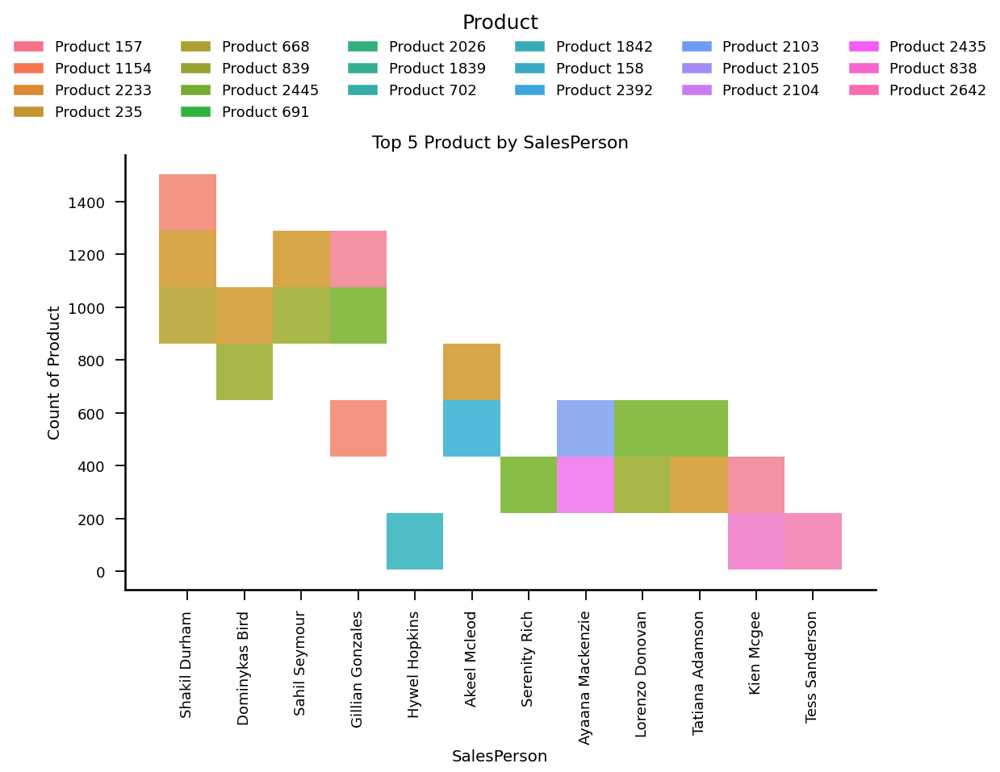

In [700]:
# Plotting the bivariate plot
plt.figure(figsize=(12, 7))
plot=sns.histplot(x='SalesPerson', y='count',hue='Product', data=df5)

sns.move_legend(plot, "lower center", bbox_to_anchor=(0.5, 1.05), frameon=False,ncols=6)

sns.despine()
plt.xlabel('SalesPerson')
plt.ylabel('Count of Product')
plt.title('Top 5 Product by SalesPerson')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 7. Group

In [418]:
# Grouping by SalesPerson and selecting top 5 Group
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['SalesPerson'].unique():
    df_new=merged_df[merged_df['SalesPerson']==i].groupby(['SalesPerson', 'Group']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df6=pd.concat(b_counts).reset_index(drop=True)
df6.head(10)

,SalesPerson,Group,count
0,Shakil Durham,Yeast,10524
1,Shakil Durham,Oils,9518
2,Shakil Durham,Wheat Flours,8379
3,Shakil Durham,Popcorn,3599
4,Shakil Durham,Powdered Milk,2831
5,Dominykas Bird,Oils,7996
6,Dominykas Bird,Wheat Flours,6789
7,Dominykas Bird,Yeast,4756
8,Dominykas Bird,Popcorn,2414
9,Dominykas Bird,Powdered Milk,2224


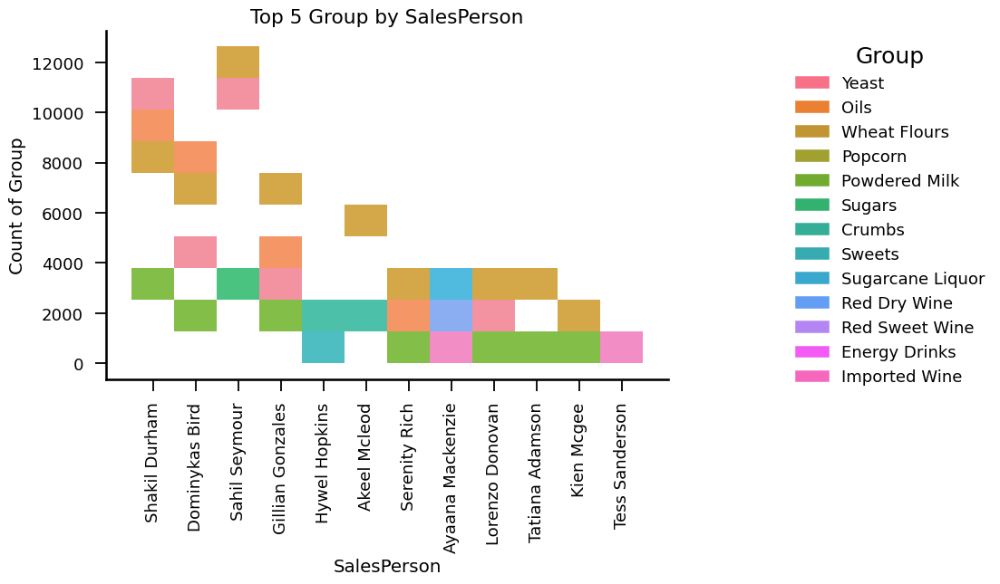

In [419]:
# Plotting the bivariate plot
plt.figure(figsize=(8, 5))
plot=sns.histplot(x='SalesPerson', y='count',hue='Group', data=df6)
sns.move_legend(plot, "upper left", bbox_to_anchor=(1.2, 1), frameon=False)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('SalesPerson')
plt.ylabel('Count of Group')
plt.title('Top 5 Group by SalesPerson')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 8. Category

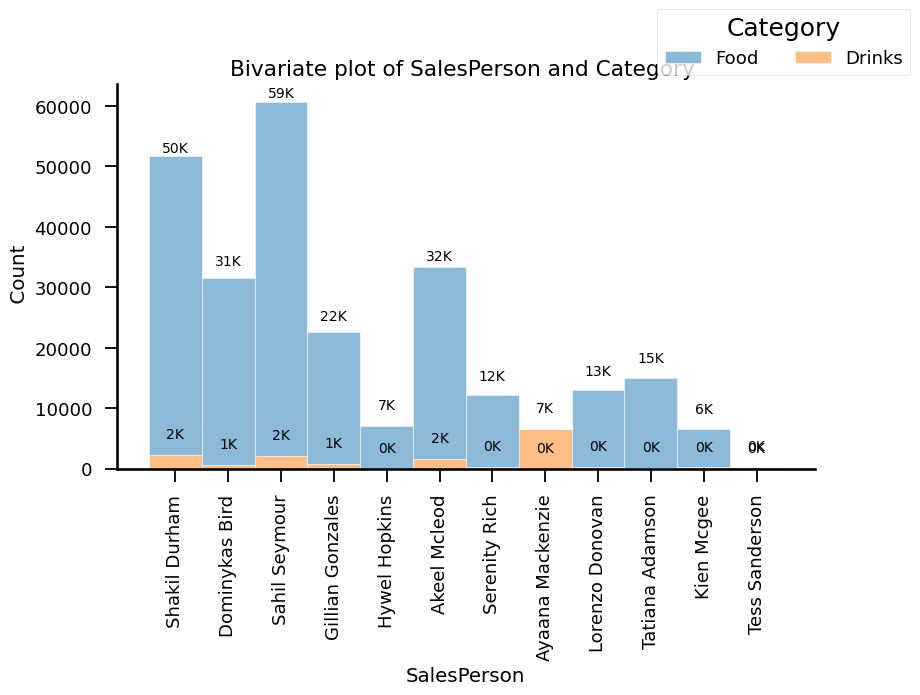

In [420]:
plt.figure(figsize=(9,5))
plot = sns.histplot(data=merged_df, x="SalesPerson",hue='Category',multiple='stack',edgecolor = "white",alpha=0.5)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points')
sns.despine()
sns.move_legend(plot, "lower right", bbox_to_anchor=(1.15, 1),ncol=2)

plt.xticks(rotation=90)
sns.despine()
plt.xlabel('SalesPerson')
plt.ylabel(' Count')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of SalesPerson and Category ')
plt.show()

# BIVARIATE ANALYSIS WRT SUPERVISOR

## 1. Company

In [421]:
# Grouping by Supervisor and selecting top 5 Company Name
df_new=pd.DataFrame()
company_counts=[]
for i in merged_df['Supervisor'].unique():
    df_new=merged_df[merged_df['Supervisor']==i].groupby(['Supervisor', 'Company Name']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    company_counts.append(df_new[0:5])
df2=pd.concat(company_counts).reset_index(drop=True)
df2.head(10)

,Supervisor,Company Name,count
0,Tahmina Vinson,Prophecy Lighting,3990
1,Tahmina Vinson,Red beat,3094
2,Tahmina Vinson,Pixel Technologies,2787
3,Tahmina Vinson,Leopard Records,2704
4,Tahmina Vinson,Leopard bridge,2331
5,Harvey-Lee Solomon,Core wares,1988
6,Harvey-Lee Solomon,Global Solutions,1008
7,Harvey-Lee Solomon,Maze master,930
8,Harvey-Lee Solomon,Green Electronics,924
9,Harvey-Lee Solomon,Silver Lining Navigations,865


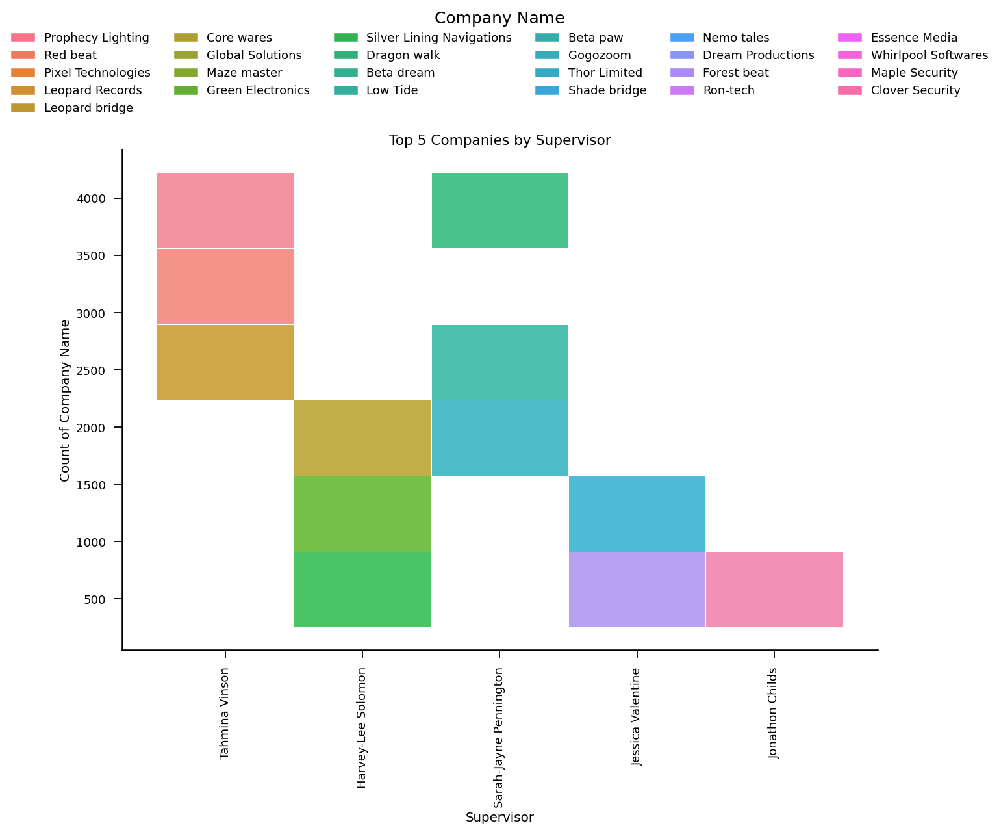

In [422]:
# Plotting the bivariate plot
plt.figure(figsize=(15, 10))
plot=sns.histplot(x='Supervisor', y='count',hue='Company Name',data=df2,edgecolor = "white")
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.05),ncol=6, frameon=False)

sns.despine()
plt.xlabel('Supervisor')
plt.ylabel('Count of Company Name')
plt.title('Top 5 Companies by Supervisor')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 2. Status

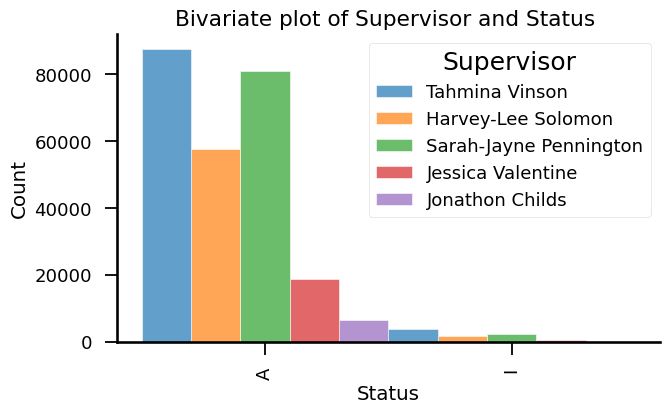

In [423]:
plt.figure(figsize=(7,4))
ax = sns.histplot(data=merged_df, x="Status",hue='Supervisor',multiple='dodge',alpha=0.7,edgecolor='white')
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1),ncol=6, frameon=False)

plt.xticks(rotation=90)
sns.despine()
plt.xlabel('Status')

#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Supervisor and Status ')
plt.show()

## 3. Line of Business

In [702]:
# Grouping by Supervisor and selecting top 5 Line of Business
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Supervisor'].unique():
    df_new=merged_df[merged_df['Supervisor']==i].groupby(['Supervisor', 'Line of Business']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df3=pd.concat(b_counts).reset_index(drop=True)
df3.head(10)

,Supervisor,Line of Business,count
0,Tahmina Vinson,Supermarkets Lv3,20659
1,Tahmina Vinson,Distributors Lv1,12988
2,Tahmina Vinson,Markets Lv1,12293
3,Tahmina Vinson,Distributors Lv2,11323
4,Tahmina Vinson,Supermarkets Lv1,6815
5,Harvey-Lee Solomon,Distributors Lv2,10224
6,Harvey-Lee Solomon,Bakery,8241
7,Harvey-Lee Solomon,Convenience,8179
8,Harvey-Lee Solomon,Markets Lv1,7546
9,Harvey-Lee Solomon,Supermarkets Lv1,6697


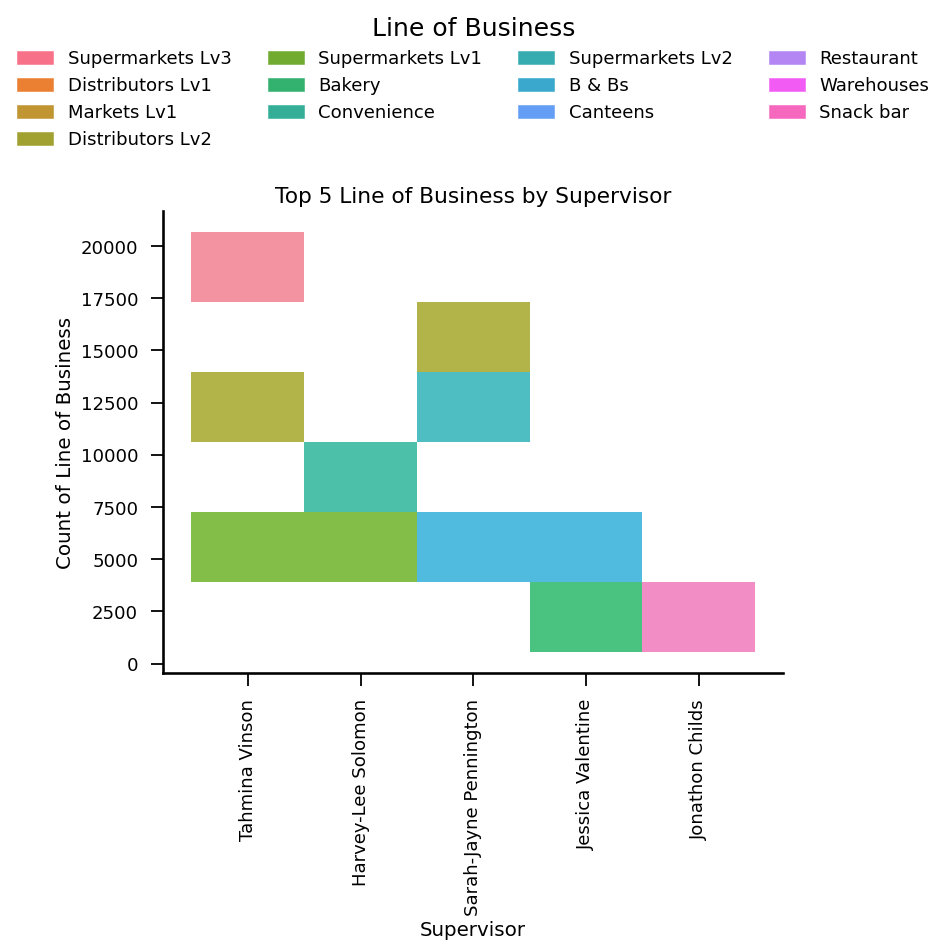

In [703]:
# Plotting the bivariate plot
plt.figure(figsize=(8, 6))
plot=sns.histplot(x='Supervisor', y='count',hue='Line of Business', data=df3)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.move_legend(plot, "lower center", bbox_to_anchor=(0.5, 1.1), frameon=False,ncols=4)

sns.despine()
plt.xlabel('Supervisor')

plt.ylabel('Count of Line of Business')
plt.title('Top 5 Line of Business by Supervisor')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 4. City

In [426]:
# Grouping by Supervisor and selecting top 5 City
df_new=pd.DataFrame()
City_counts=[]
for i in merged_df['Supervisor'].unique():
    df_new=merged_df[merged_df['Supervisor']==i].groupby(['Supervisor', 'City']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    City_counts.append(df_new[0:5])
df4=pd.concat(City_counts).reset_index(drop=True)
df4.head(10)

,Supervisor,City,count
0,Tahmina Vinson,Roslyn,36395
1,Tahmina Vinson,Manson,15370
2,Tahmina Vinson,Morton,14759
3,Tahmina Vinson,Littlerock,7325
4,Tahmina Vinson,Ardenvoir,6475
5,Harvey-Lee Solomon,Badger,31508
6,Harvey-Lee Solomon,Port Hadlock,14359
7,Harvey-Lee Solomon,Winthrop,8942
8,Harvey-Lee Solomon,Burlington,4633
9,Sarah-Jayne Pennington,Yoman,42050


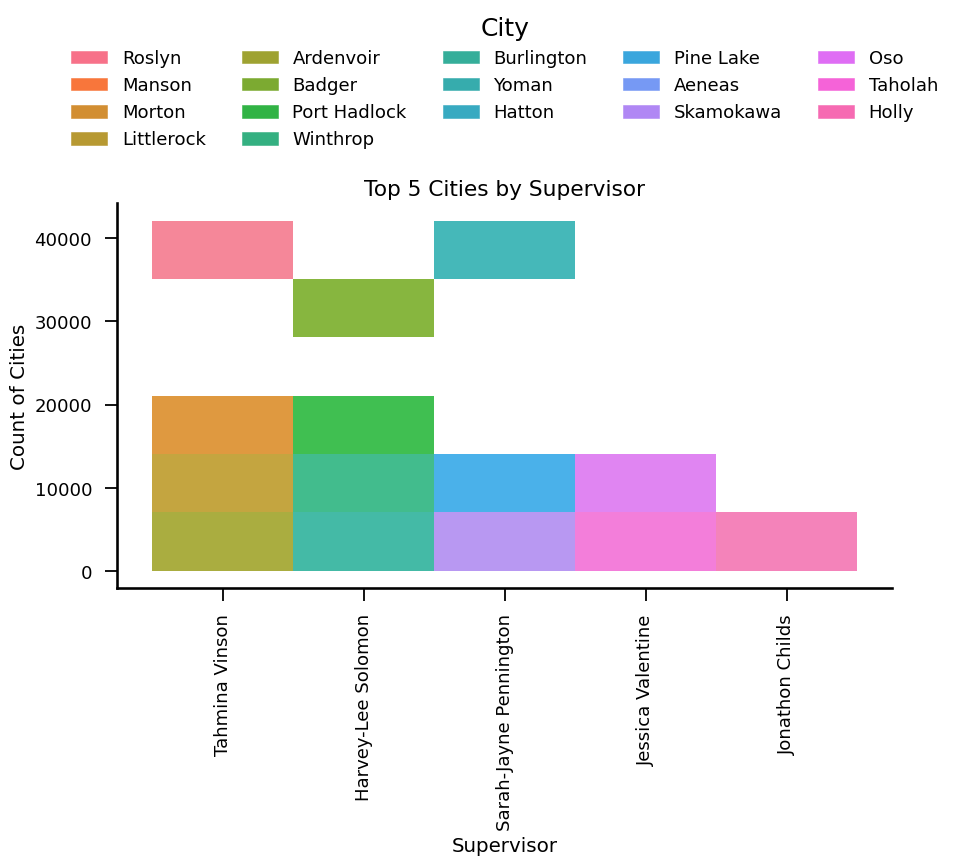

In [427]:
# Plotting the bivariate plot
plt.figure(figsize=(10, 5))
plot=sns.histplot(x='Supervisor', y='count',hue='City', data=df4,multiple='stack')
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1), frameon=False,ncols=5)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('Supervisor')
plt.ylabel('Count of Cities')
plt.title('Top 5 Cities by Supervisor')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 5. Product

In [704]:
# Grouping by Supervisor and selecting top 5 Product
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Supervisor'].unique():
    df_new=merged_df[merged_df['Supervisor']==i].groupby(['Supervisor', 'Product']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df5=pd.concat(b_counts).reset_index(drop=True)
df5.head(10)

,Supervisor,Product,count
0,Tahmina Vinson,Product 157,2375
1,Tahmina Vinson,Product 1154,2127
2,Tahmina Vinson,Product 235,2080
3,Tahmina Vinson,Product 2233,1859
4,Tahmina Vinson,Product 158,1590
5,Harvey-Lee Solomon,Product 157,1953
6,Harvey-Lee Solomon,Product 235,1885
7,Harvey-Lee Solomon,Product 1154,1798
8,Harvey-Lee Solomon,Product 2445,1684
9,Harvey-Lee Solomon,Product 2233,1647


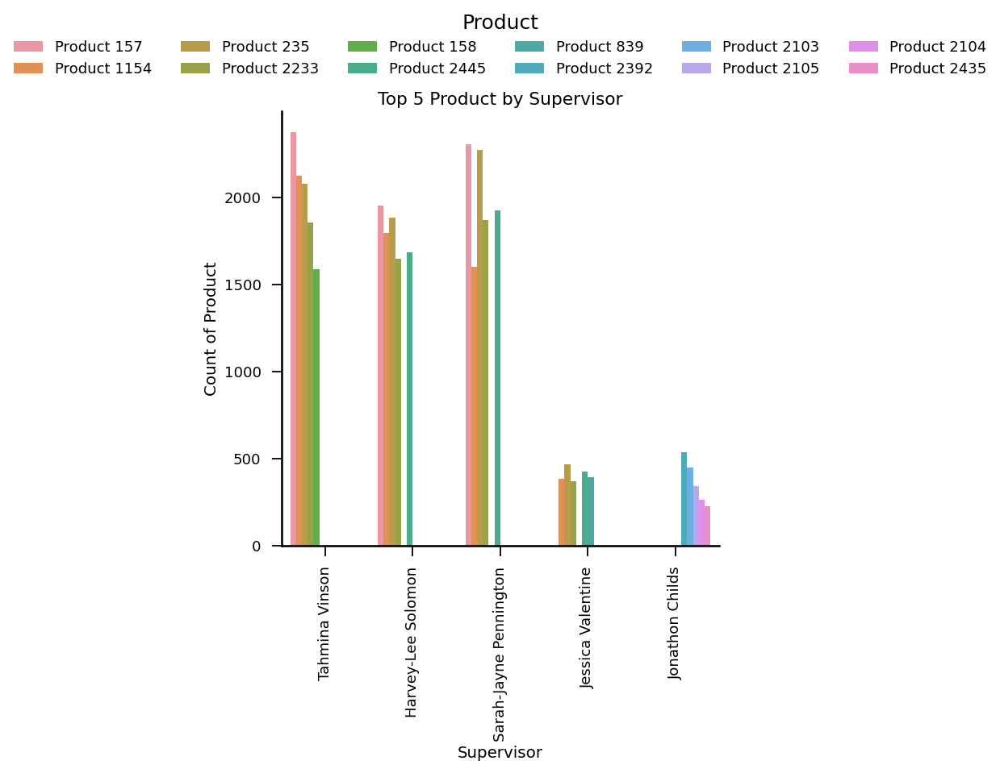

In [706]:
# Plotting the bivariate plot
plt.figure(figsize=(7, 7))
plot=sns.barplot(x='Supervisor', y='count',hue='Product', data=df5)

sns.move_legend(plot, "lower center", bbox_to_anchor=(0.5, 1.05), frameon=False,ncols=6)

sns.despine()
plt.xlabel('Supervisor')
plt.ylabel('Count of Product')
plt.title('Top 5 Product by Supervisor')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 6. Group

In [430]:
# Grouping by Supervisor and selecting top 5 Group
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Supervisor'].unique():
    df_new=merged_df[merged_df['Supervisor']==i].groupby(['Supervisor', 'Group']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df6=pd.concat(b_counts).reset_index(drop=True)
df6.head(10)

,Supervisor,Group,count
0,Tahmina Vinson,Yeast,17498
1,Tahmina Vinson,Oils,16781
2,Tahmina Vinson,Wheat Flours,16437
3,Tahmina Vinson,Popcorn,5695
4,Tahmina Vinson,Powdered Milk,4840
5,Harvey-Lee Solomon,Oils,14243
6,Harvey-Lee Solomon,Wheat Flours,13888
7,Harvey-Lee Solomon,Yeast,9575
8,Harvey-Lee Solomon,Popcorn,4872
9,Harvey-Lee Solomon,Powdered Milk,4181


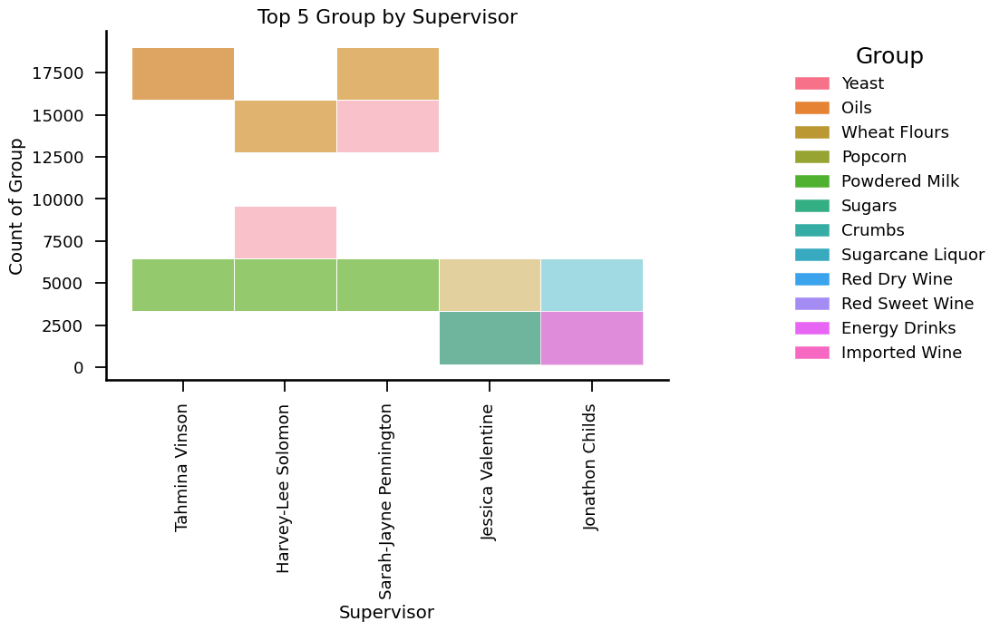

In [431]:
# Plotting the bivariate plot
plt.figure(figsize=(8, 5))
plot=sns.histplot(x='Supervisor', y='count',hue='Group', data=df6,multiple='stack',edgecolor = "white",alpha=0.5)
sns.move_legend(plot, "upper left", bbox_to_anchor=(1.2, 1), frameon=False)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('Supervisor')
plt.ylabel('Count of Group')
plt.title('Top 5 Group by Supervisor')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 7. Category

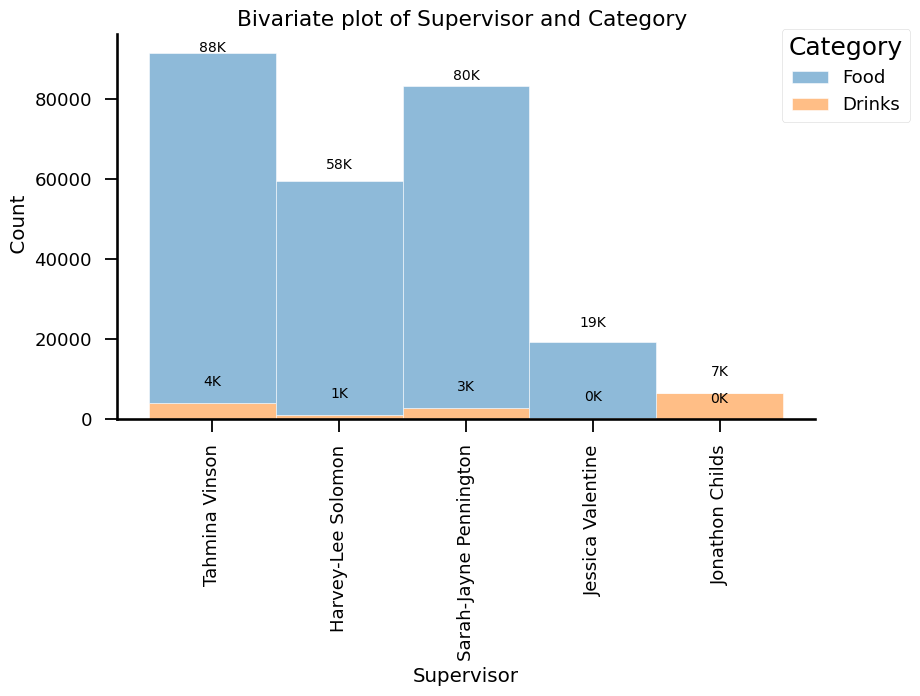

In [710]:
plt.figure(figsize=(9,5))
plot = sns.histplot(data=merged_df, x="Supervisor",hue='Category',multiple='stack',edgecolor = "white",alpha=0.5)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points')
sns.despine()
sns.move_legend(plot, "lower right", bbox_to_anchor=(1.15, 0.75),ncol=1)

plt.xticks(rotation=90)
sns.despine()
plt.xlabel('Supervisor')
plt.ylabel(' Count')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Supervisor and Category ')
plt.show()

# BIVARIATE ANALYSIS WRT COMPANY

## 1. Status

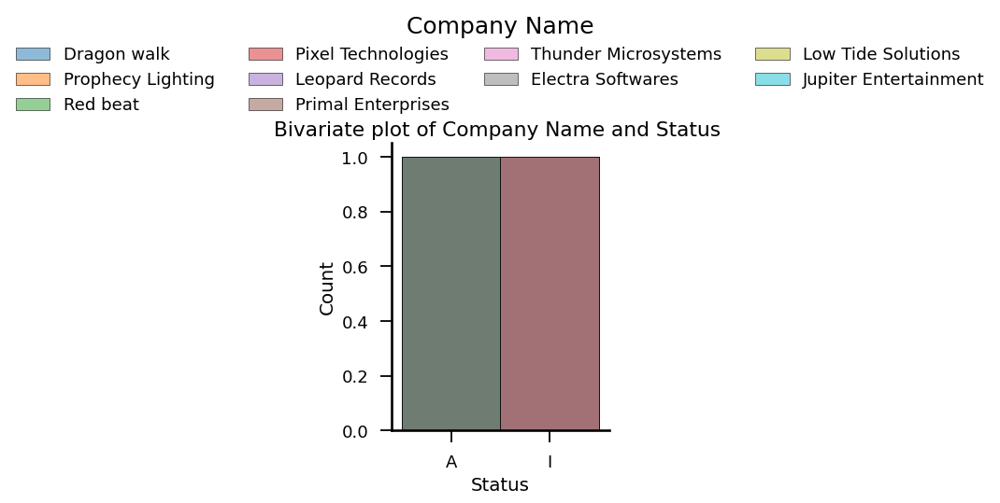

In [711]:
# Grouping by Company Name and selecting top 5 Group
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Status'].unique():
    df_new=merged_df[merged_df['Status']==i].groupby(['Status', 'Company Name']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df6=pd.concat(b_counts).reset_index(drop=True)
df6.head(10)

plt.figure(figsize=(3,4))
ax = sns.histplot(data=df6, x="Status",hue='Company Name')
sns.move_legend(ax, "lower center", bbox_to_anchor=(0.5, 1.05),ncol=4, frameon=False)

#plt.xticks(rotation=90)
sns.despine()
plt.xlabel('Status')

#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Company Name and Status ')
plt.show()

## 3. Line of Business

In [713]:
# Grouping by Company Name and selecting top 5 Line of Business
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Line of Business'].unique():
    df_new=merged_df[merged_df['Line of Business']==i].groupby(['Line of Business', 'Company Name']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df3=pd.concat(b_counts).reset_index(drop=True)
df3.head(10)

,Line of Business,Company Name,count
0,Distributors Lv2,Redustries,1376
1,Distributors Lv2,Lion shade,1202
2,Distributors Lv2,Granite poly,1151
3,Distributors Lv2,Core cast,1016
4,Distributors Lv2,Corecords,1012
5,B & Bs,Crow shine,1044
6,B & Bs,Thor Limited,977
7,B & Bs,Hummingbird Limited,782
8,B & Bs,Rabbit Limited,718
9,B & Bs,Rose stones,698


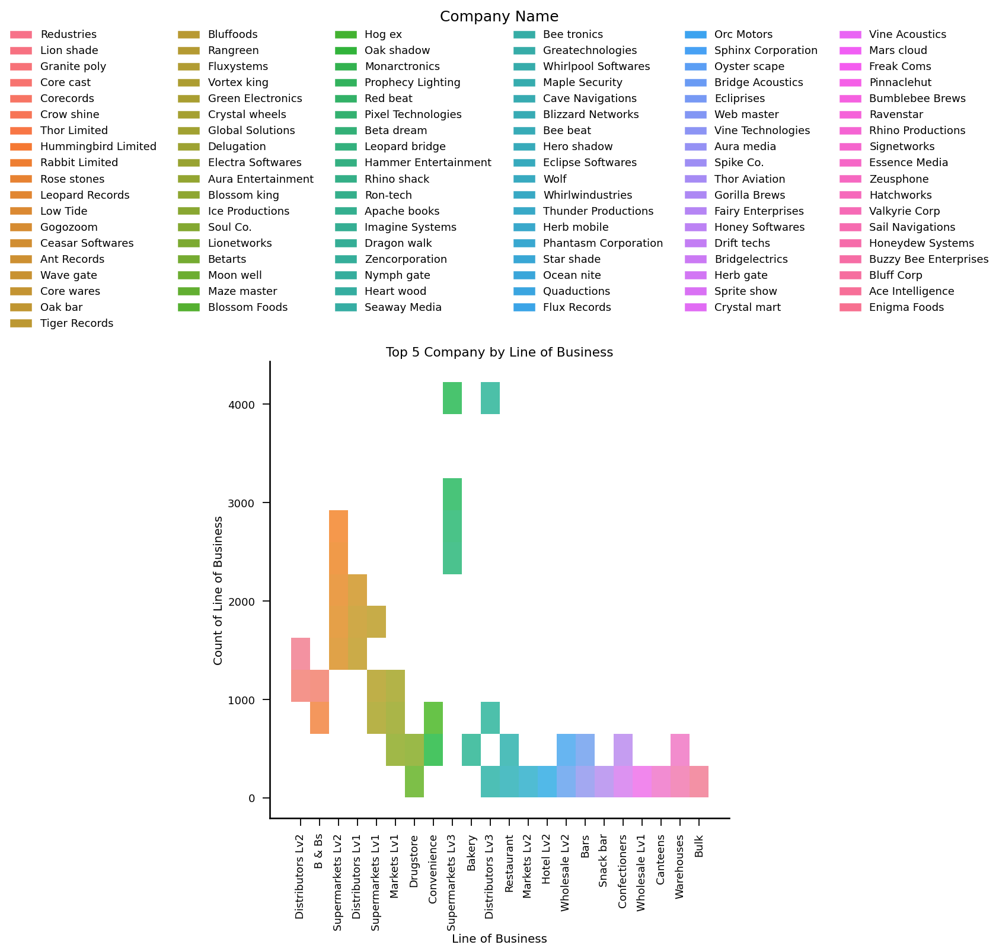

In [719]:
# Plotting the bivariate plot
plt.figure(figsize=(10,10))
plot=sns.histplot(x='Line of Business', y='count',hue='Company Name', data=df3)

sns.move_legend(plot, "lower center", bbox_to_anchor=(0.5, 1.05), frameon=False,ncols=6)

sns.despine()
plt.xlabel('Line of Business')

plt.ylabel('Count of Line of Business')
plt.title('Top 5 Company by Line of Business')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 3. City

In [749]:

# Grouping by Supervisor and selecting top 5 City
df_new=pd.DataFrame()
City_counts=[]
for i in merged_df['City'].unique():
    df_new=merged_df[merged_df['City']==i].groupby(['City', 'Company Name']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    City_counts.append(df_new[0:5])
df4=pd.concat(City_counts).reset_index(drop=True)
df4.head(10)

,City,Company Name,count
0,Roslyn,Red beat,3094
1,Roslyn,Leopard bridge,2331
2,Roslyn,Primal Enterprises,2113
3,Roslyn,Wave gate,2077
4,Roslyn,Granite poly,1151
5,Badger,Core wares,1988
6,Badger,Global Solutions,1008
7,Badger,Maze master,930
8,Badger,Green Electronics,924
9,Badger,Silver Lining Navigations,865


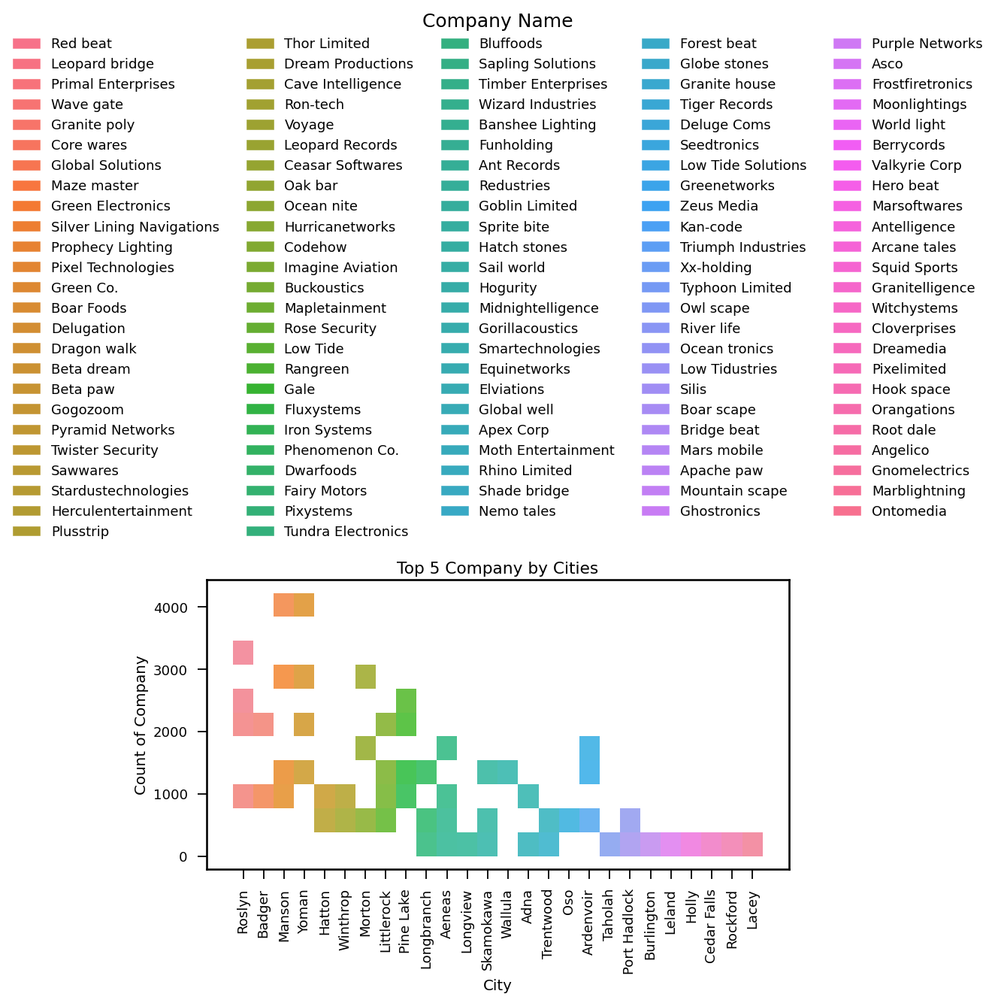

In [750]:
# Plotting the bivariate plot
plt.figure(figsize=(10, 5))
plot=sns.histplot(x='City', y='count',hue='Company Name', data=df4,multiple='stack')
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1), frameon=False,ncols=5)

plt.xlabel('City')
plt.ylabel('Count of Company')
plt.title('Top 5 Company by Cities')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 4. Product

In [438]:
merged_df.Product.nunique()

798

In [439]:
top_companies=merged_df.groupby('Company Name')['Product'].size().reset_index(name='count').sort_values(by='count',ascending=False)[0:20]
top_companies['Company Name'].unique()

array(['Dragon walk', 'Prophecy Lighting', 'Red beat',
       'Pixel Technologies', 'Leopard Records', 'Beta dream',
       'Leopard bridge', 'Low Tide', 'Beta paw', 'Primal Enterprises',
       'Wave gate', 'Gogozoom', 'Core wares', 'Codehow', 'Rangreen',
       'Ceasar Softwares', 'Oak bar', 'Tiger Records', 'Bluffoods',
       'Pyramid Networks'], dtype=object)

In [440]:
# Grouping by Company Name and selecting top 5 Product

df_new=pd.DataFrame()
b_counts=[]
for i in top_companies['Company Name'].unique():
    df_new=merged_df[merged_df['Company Name']==i].groupby(['Company Name', 'Product']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df5=pd.concat(b_counts).reset_index(drop=True)
df5.head(10)

,Company Name,Product,count
0,Dragon walk,Product 1847,34
1,Dragon walk,Product 260,33
2,Dragon walk,Product 283,32
3,Dragon walk,Product 158,31
4,Dragon walk,Product 513,31
5,Prophecy Lighting,Product 1154,40
6,Prophecy Lighting,Product 158,39
7,Prophecy Lighting,Product 168,34
8,Prophecy Lighting,Product 660,33
9,Prophecy Lighting,Product 438,32


In [441]:
df5['Company Name'].nunique()

20

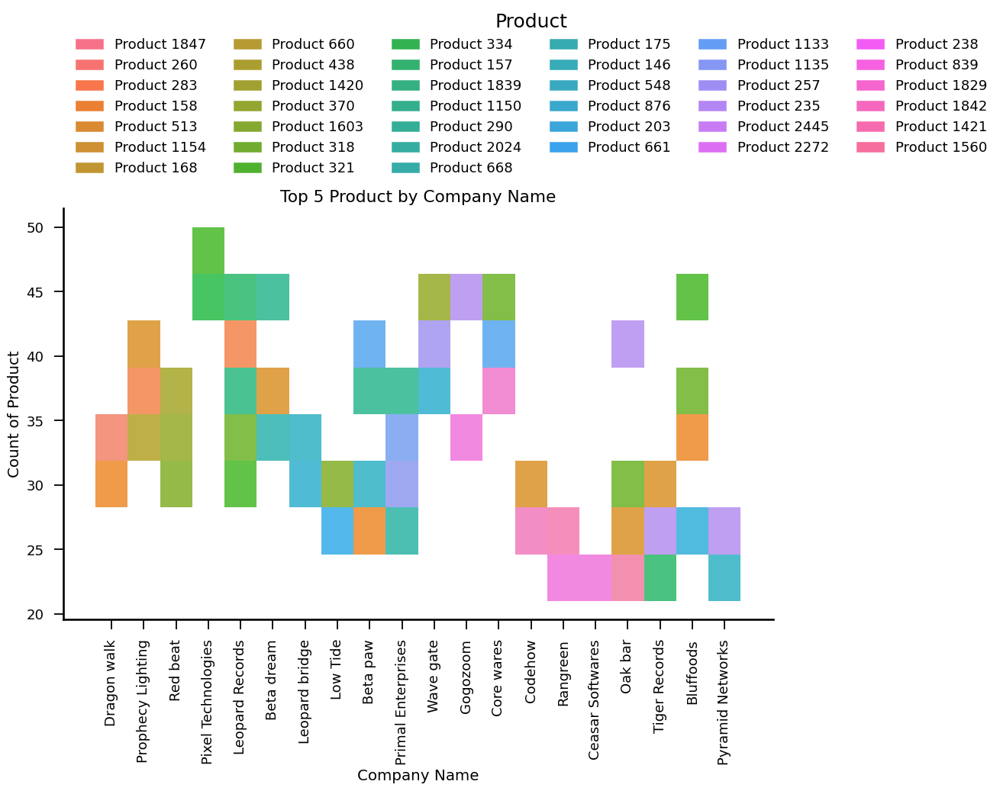

In [442]:
# Plotting the bivariate plot
plt.figure(figsize=(12, 7))
plot=sns.histplot(x='Company Name', y='count',hue='Product', data=df5)

sns.move_legend(plot, "lower left", bbox_to_anchor=(0, 1.05), frameon=False,ncols=6)

sns.despine()
plt.xlabel('Company Name')
plt.ylabel('Count of Product')
plt.title('Top 5 Product by Company Name')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 5. Group

In [720]:
# Grouping by Company Name and selecting top 5 Group
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Group'].unique():
    df_new=merged_df[merged_df['Group']==i].groupby(['Group', 'Company Name']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df6=pd.concat(b_counts).reset_index(drop=True)
df6.head(10)

,Group,Company Name,count
0,Spices,Prophecy Lighting,202
1,Spices,Dragon walk,175
2,Spices,Low Tide,142
3,Spices,Ceasar Softwares,111
4,Spices,Codehow,107
5,Coffee Pods,Prophecy Lighting,232
6,Coffee Pods,Dragon walk,209
7,Coffee Pods,Pixel Technologies,196
8,Coffee Pods,Red beat,190
9,Coffee Pods,Leopard bridge,186


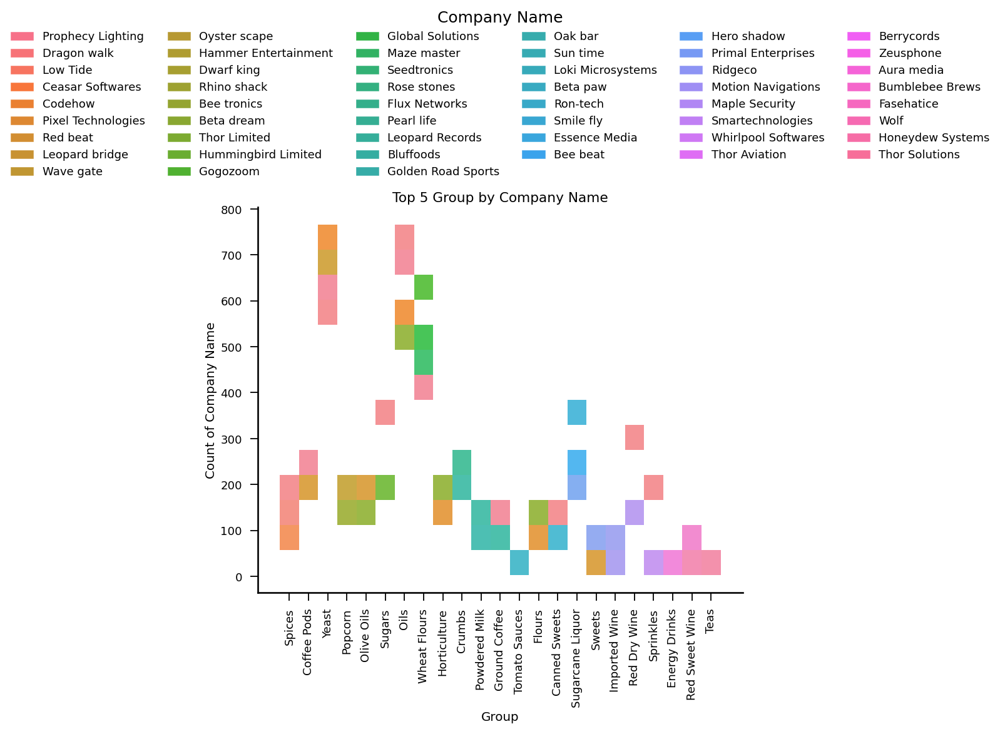

In [722]:
# Plotting the bivariate plot
plt.figure(figsize=(10, 8))
plot=sns.histplot(x='Group', y='count',hue='Company Name', data=df6)
sns.move_legend(plot, "lower center", bbox_to_anchor=(0.5, 1.05), frameon=False,ncols=6)
sns.despine()
plt.xlabel('Group')
plt.ylabel('Count of Company Name')
plt.title('Top 5 Group by Company Name')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 6. Category

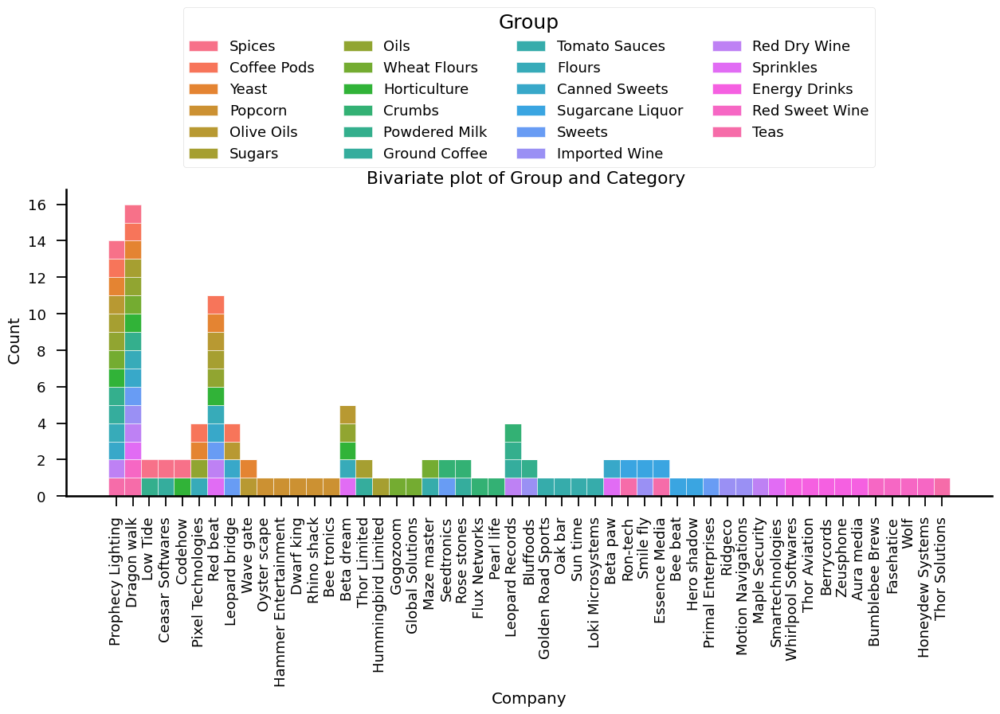

In [747]:
# Grouping by Company Name and selecting top 5 Category
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Group'].unique():
    df_new=merged_df[merged_df['Group']==i].groupby(['Group', 'Company Name']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df6=pd.concat(b_counts).reset_index(drop=True)
df6.head(10)
plt.figure(figsize=(15,5))
plot = sns.histplot(data=df6, x="Company Name",hue='Group',multiple='stack',edgecolor = "white",alpha=1)

sns.despine()
sns.move_legend(plot, "lower center", bbox_to_anchor=(0.5, 1.05),ncol=4)

plt.xticks(rotation=90)
sns.despine()
plt.xlabel('Company')
plt.ylabel(' Count')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Group and Category ')
plt.show()

# BIVARIATE ANALYSIS WRT STATUS

In [446]:
merged_df

,Issue Date,Invoice Number,Amount,Order Month,Order Year,Quantity Bins,Unit Price Bins,Net Weight Bins,SalesPerson,Supervisor,Manager,Team,Company Name,Status,Line of Business,City,Product,Group,Category
0,2017-01-12,1492762,52.98,1,2017,0-6,5-50,0-1,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,Product 1073,Spices,Food
1,2017-01-12,1492762,26.64,1,2017,0-6,3-5,3-10,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,Product 1420,Coffee Pods,Food
2,2017-01-12,1492762,9.60,1,2017,6-11,0-1.5,1.5-3,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Gnome ware,A,Distributors Lv2,Roslyn,Product 264,Yeast,Food
3,2017-01-13,1492719,17.52,1,2017,0-6,1.5-3,1-1.5,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Granite poly,A,Distributors Lv2,Roslyn,Product 1154,Popcorn,Food
4,2017-01-13,1492719,16.86,1,2017,0-6,1.5-3,1-1.5,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Granite poly,A,Distributors Lv2,Roslyn,Product 1527,Popcorn,Food
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
260091,2019-03-12,2173547,38.88,3,2019,12-23,1.5-3,1-1.5,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Rhino shack,A,Bakery,Roslyn,Product 202,Wheat Flours,Food
260092,2019-03-12,2173547,39.00,3,2019,6-11,3-5,1.5-3,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Rhino shack,A,Bakery,Roslyn,Product 1154,Popcorn,Food
260093,2019-03-12,2173547,39.12,3,2019,6-11,3-5,0-1,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Rhino shack,A,Bakery,Roslyn,Product 668,Popcorn,Food
260094,2019-03-12,2173547,37.68,3,2019,6-11,3-5,0-1,Shakil Durham,Tahmina Vinson,Duane Frame,Distributors,Rhino shack,A,Bakery,Roslyn,Product 1527,Popcorn,Food


## 1. Line of Business

In [447]:
# Grouping by Status and selecting top 5 Line of Business
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Status'].unique():
    df_new=merged_df[merged_df['Status']==i].groupby(['Status', 'Line of Business']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:10])
df3=pd.concat(b_counts).reset_index(drop=True)
df3.head(10)

,Status,Line of Business,count
0,A,Distributors Lv2,36690
1,A,Supermarkets Lv3,32114
2,A,Supermarkets Lv1,26641
3,A,Distributors Lv1,25728
4,A,Markets Lv1,22924
5,A,B & Bs,19846
6,A,Convenience,18655
7,A,Supermarkets Lv2,18271
8,A,Bakery,17573
9,A,Wholesale Lv2,7174


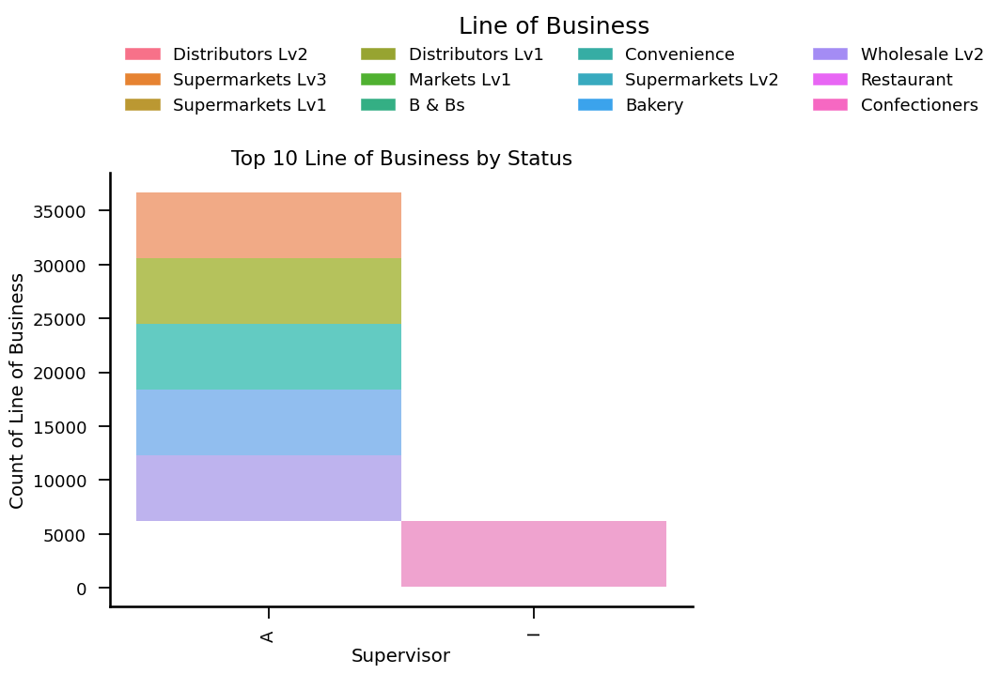

In [448]:
# Plotting the bivariate plot
plt.figure(figsize=(8, 6))
plot=sns.histplot(x='Status', y='count',hue='Line of Business', data=df3)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.move_legend(plot, "lower left", bbox_to_anchor=(0, 1.1), frameon=False,ncols=4)

sns.despine()
plt.xlabel('Supervisor')

plt.ylabel('Count of Line of Business')
plt.title('Top 10 Line of Business by Status')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 2. City

In [449]:
# Grouping by Status and selecting top 5 City
df_new=pd.DataFrame()
City_counts=[]
for i in merged_df['Status'].unique():
    df_new=merged_df[merged_df['Status']==i].groupby(['Status', 'City']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    City_counts.append(df_new[0:10])
df4=pd.concat(City_counts).reset_index(drop=True)
df4.head(10)

,Status,City,count
0,A,Yoman,41753
1,A,Roslyn,33574
2,A,Badger,30953
3,A,Winthrop,25980
4,A,Manson,15370
5,A,Morton,14692
6,A,Port Hadlock,13741
7,A,Hatton,13116
8,A,Oso,11782
9,A,Pine Lake,11270


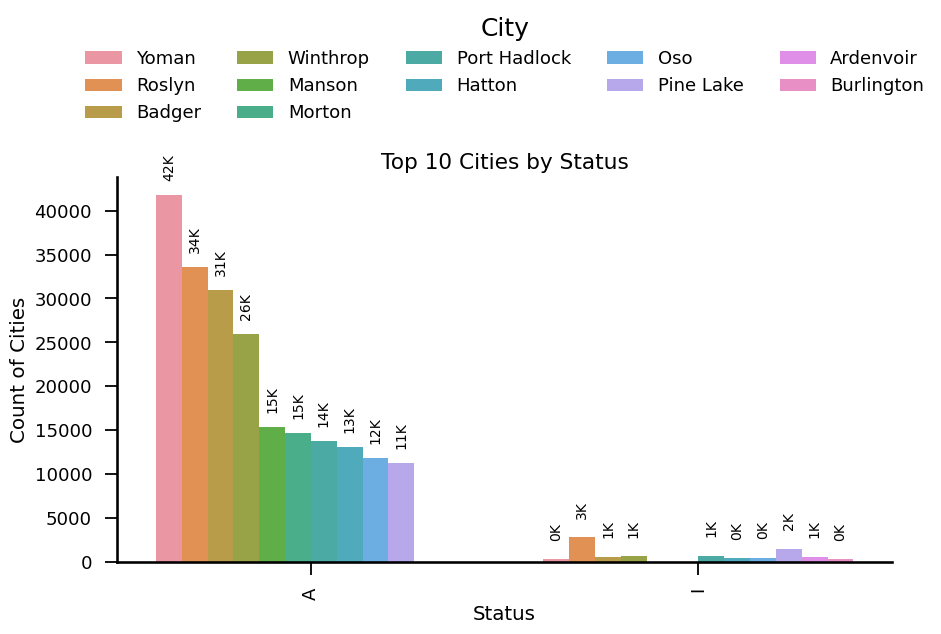

In [450]:
# Plotting the bivariate plot
plt.figure(figsize=(10, 5))
plot=sns.barplot(x='Status', y='count',hue='City', data=df4)
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1), frameon=False,ncols=5)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.0f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('Status')
plt.ylabel('Count of Cities')
plt.title('Top 10 Cities by Status')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 3. Product

In [451]:
# Grouping by Supervisor and selecting top 5 Product
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Status'].unique():
    df_new=merged_df[merged_df['Status']==i].groupby(['Status', 'Product']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:10])
df5=pd.concat(b_counts).reset_index(drop=True)
df5.head(10)

,Status,Product,count
0,A,Product 157,6743
1,A,Product 235,6502
2,A,Product 1154,5711
3,A,Product 2233,5558
4,A,Product 2445,5424
5,A,Product 839,4780
6,A,Product 668,3782
7,A,Product 838,3760
8,A,Product 1527,3756
9,A,Product 158,3616


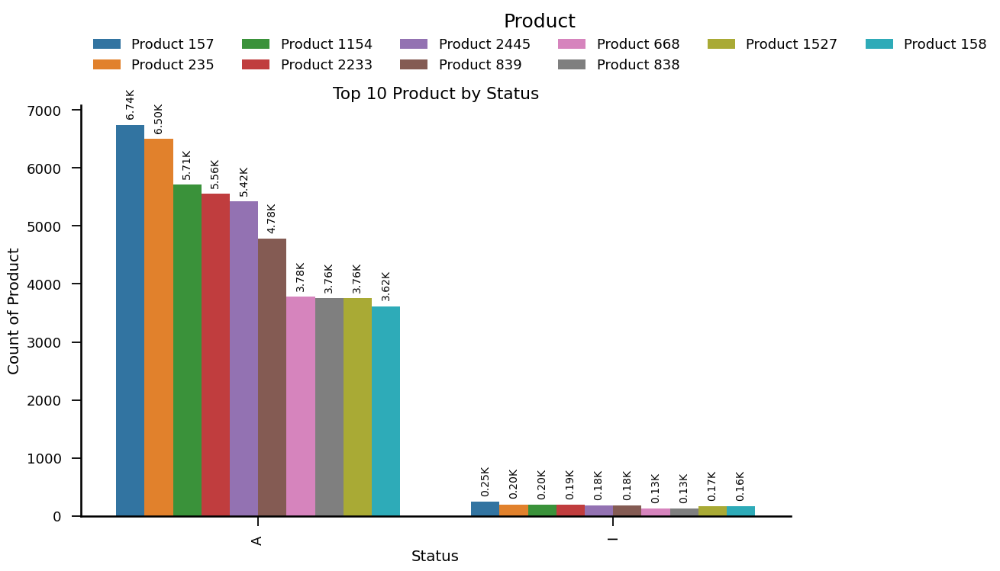

In [452]:
# Plotting the bivariate plot
plt.figure(figsize=(12, 7))
plot=sns.barplot(x='Status', y='count',hue='Product', data=df5)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
sns.move_legend(plot, "lower left", bbox_to_anchor=(0, 1.05), frameon=False,ncols=6)

sns.despine()
plt.xlabel('Status')
plt.ylabel('Count of Product')
plt.title('Top 10 Product by Status')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 4. Group

In [453]:
# Grouping by Status and selecting top 5 Group
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Status'].unique():
    df_new=merged_df[merged_df['Status']==i].groupby(['Status', 'Group']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:10])
df6=pd.concat(b_counts).reset_index(drop=True)
df6.head(10)

,Status,Group,count
0,A,Wheat Flours,52327
1,A,Oils,49487
2,A,Yeast,41581
3,A,Popcorn,15885
4,A,Powdered Milk,13269
5,A,Sugars,10771
6,A,Coffee Pods,9103
7,A,Olive Oils,8916
8,A,Crumbs,7808
9,A,Flours,7738


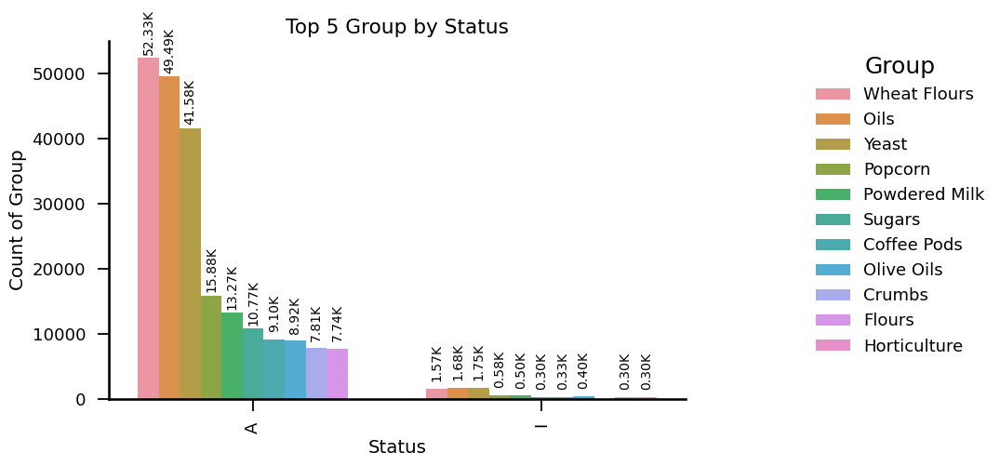

In [454]:
# Plotting the bivariate plot
plt.figure(figsize=(8, 5))
plot=sns.barplot(x='Status', y='count',hue='Group', data=df6)#,multiple='stack',edgecolor = "white",alpha=0.5)
sns.move_legend(plot, "upper left", bbox_to_anchor=(1.2, 1), frameon=False)
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
plt.xlabel('Status')
plt.ylabel('Count of Group')
plt.title('Top 5 Group by Status')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 5. Category

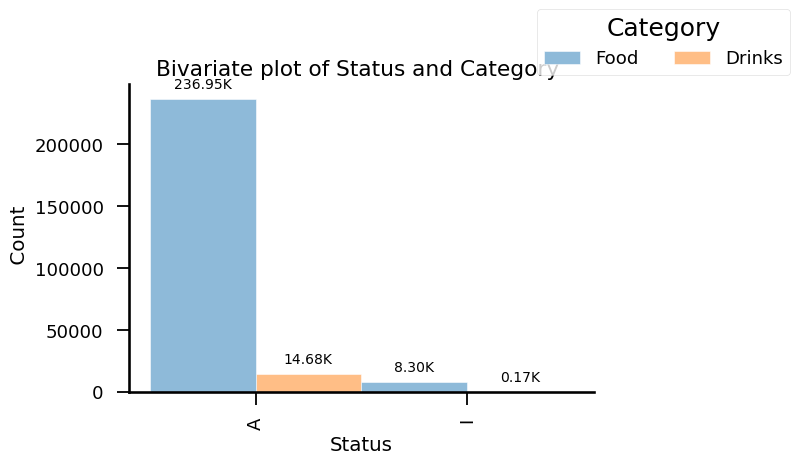

In [455]:
plt.figure(figsize=(6,4))
plot = sns.histplot(data=merged_df, x="Status",hue='Category',edgecolor = "white",alpha=0.5,multiple='dodge')
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
sns.despine()
sns.move_legend(plot, "lower center", bbox_to_anchor=(1.15, 1),ncol=2)

plt.xticks(rotation=90)
sns.despine()
plt.xlabel('Status')
plt.ylabel(' Count')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Status and Category ')
plt.show()

# BIVARIATE ANALYSIS WRT LINE OF BUSINESS

## 1. City

In [456]:
# Grouping by Line of Business and selecting top 5 City
df_new=pd.DataFrame()
City_counts=[]
for i in merged_df['Line of Business'].unique():
    df_new=merged_df[merged_df['Line of Business']==i].groupby(['Line of Business', 'City']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    City_counts.append(df_new[0:5])
df4=pd.concat(City_counts).reset_index(drop=True)
df4.head(10)

,Line of Business,City,count
0,Distributors Lv2,Yoman,7769
1,Distributors Lv2,Roslyn,7596
2,Distributors Lv2,Badger,5793
3,Distributors Lv2,Port Hadlock,2968
4,Distributors Lv2,Hatton,2287
5,B & Bs,Winthrop,4924
6,B & Bs,Yoman,3484
7,B & Bs,Manson,1628
8,B & Bs,Taholah,1564
9,B & Bs,Roslyn,1434


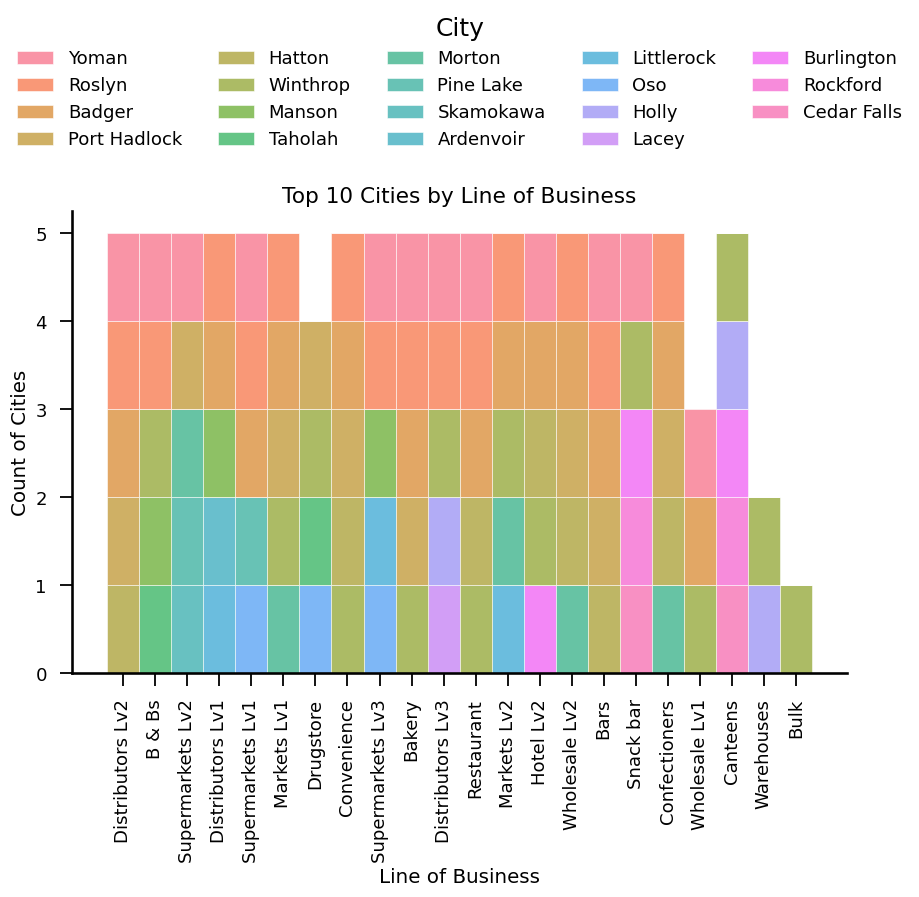

In [457]:
# Plotting the bivariate plot
plt.figure(figsize=(10, 6))
plot=sns.histplot(x='Line of Business',hue='City', data=df4,multiple='stack',edgecolor = "white")
sns.move_legend(plot, "lower center", bbox_to_anchor=(.5, 1.1), frameon=False,ncols=5)
sns.despine()
plt.xlabel('Line of Business')
plt.ylabel('Count of Cities')
plt.title('Top 10 Cities by Line of Business')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 2. Product

In [458]:
# Grouping by Line of Business and selecting top 5 Product
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Line of Business'].unique():
    df_new=merged_df[merged_df['Line of Business']==i].groupby(['Line of Business', 'Product']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df5=pd.concat(b_counts).reset_index(drop=True)
df5.head(10)

,Line of Business,Product,count
0,Distributors Lv2,Product 2233,990
1,Distributors Lv2,Product 839,965
2,Distributors Lv2,Product 157,946
3,Distributors Lv2,Product 235,887
4,Distributors Lv2,Product 1421,836
5,B & Bs,Product 1839,787
6,B & Bs,Product 235,596
7,B & Bs,Product 1842,553
8,B & Bs,Product 691,470
9,B & Bs,Product 935,400


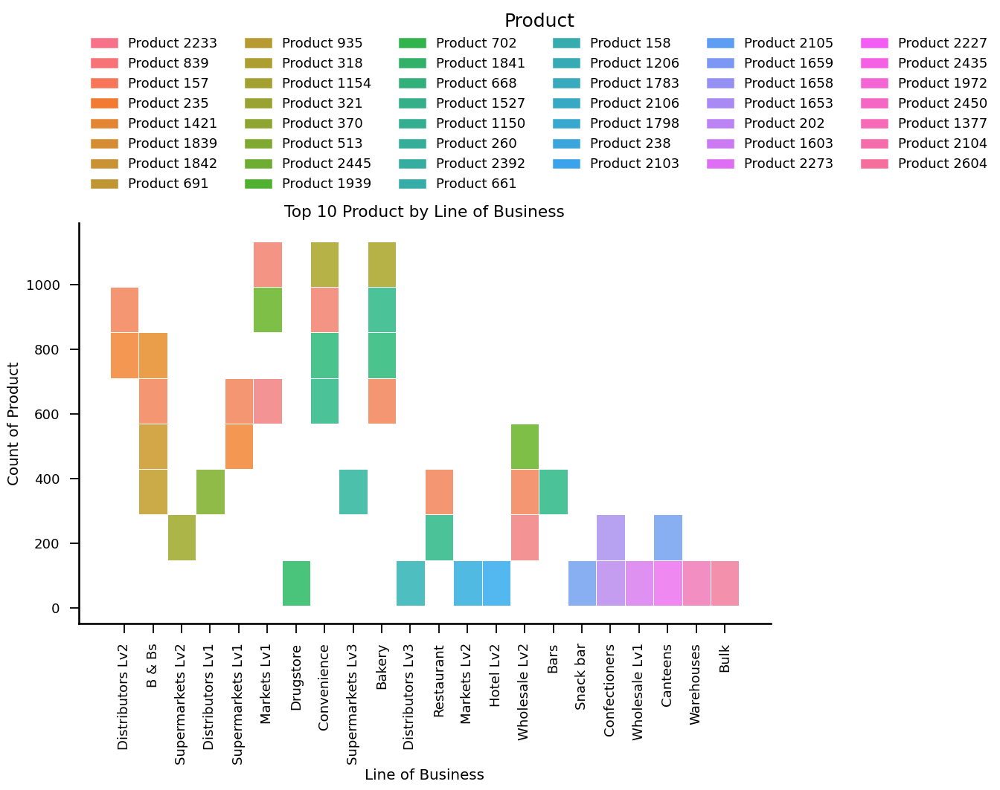

In [459]:
# Plotting the bivariate plot
plt.figure(figsize=(12, 7))
plot=sns.histplot(x='Line of Business', y='count',hue='Product', data=df5,multiple='stack',edgecolor = "white")
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
sns.move_legend(plot, "lower left", bbox_to_anchor=(0, 1.05), frameon=False,ncols=6)

sns.despine()
plt.xlabel('Line of Business')
plt.ylabel('Count of Product')
plt.title('Top 10 Product by Line of Business')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 3. Group

In [460]:
# Grouping by Line of Business and selecting top 5 Group
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Line of Business'].unique():
    df_new=merged_df[merged_df['Line of Business']==i].groupby(['Line of Business', 'Group']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:10])
df6=pd.concat(b_counts).reset_index(drop=True)
df6.head(10)

,Line of Business,Group,count
0,Distributors Lv2,Yeast,9614
1,Distributors Lv2,Oils,7375
2,Distributors Lv2,Wheat Flours,6678
3,Distributors Lv2,Coffee Pods,1901
4,Distributors Lv2,Powdered Milk,1787
5,Distributors Lv2,Olive Oils,1651
6,Distributors Lv2,Horticulture,1503
7,Distributors Lv2,Popcorn,1501
8,Distributors Lv2,Sugars,1459
9,Distributors Lv2,Flours,1425


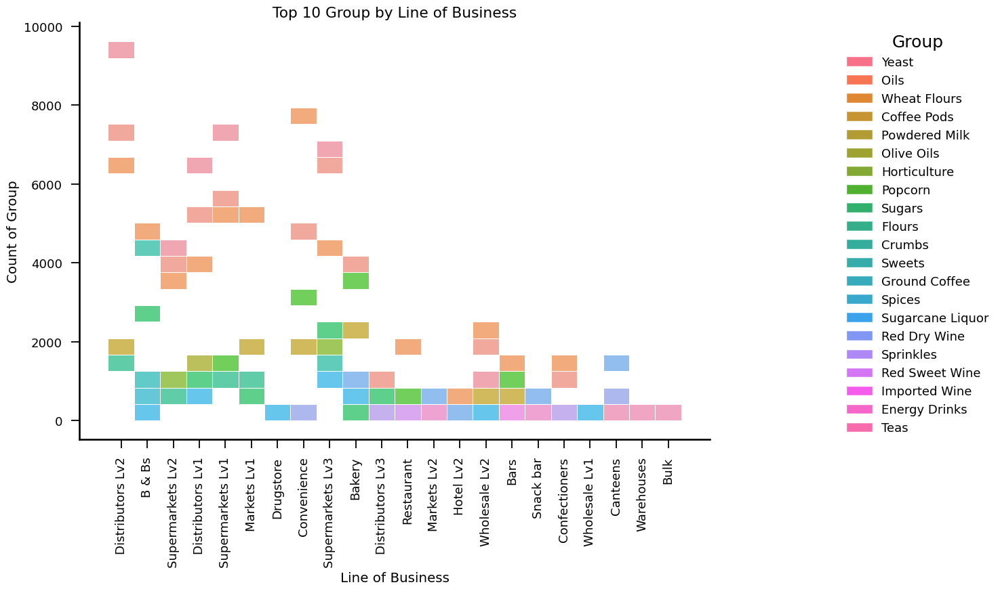

In [461]:
# Plotting the bivariate plot
plt.figure(figsize=(12, 8))
plot=sns.histplot(x='Line of Business', y='count',hue='Group', data=df6,multiple='stack',edgecolor = "white")
sns.move_legend(plot, "upper left", bbox_to_anchor=(1.2, 1), frameon=False)

sns.despine()
plt.xlabel('Line of Business')
plt.ylabel('Count of Group')
plt.title('Top 10 Group by Line of Business')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 4. Category

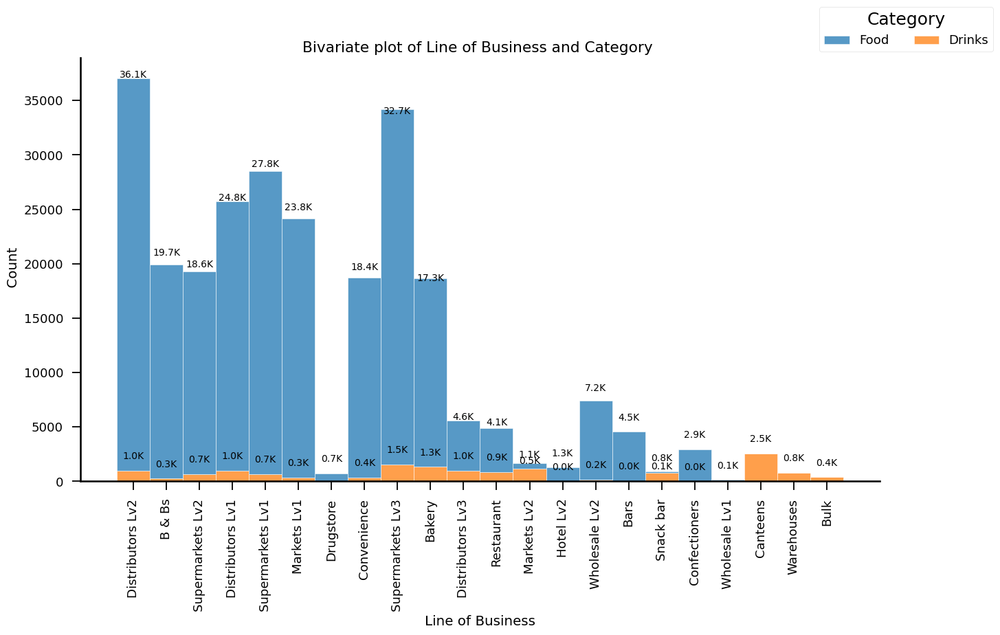

In [462]:
plt.figure(figsize=(15,8))
plot = sns.histplot(data=merged_df, x="Line of Business",hue='Category',edgecolor = "white",multiple='stack')
for p in plot.patches:
    if(p.get_height()>0):
        plot.annotate(f'{p.get_height()/1000:.1f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 15), textcoords='offset points')
sns.despine()
sns.move_legend(plot, "lower right", bbox_to_anchor=(1.15, 1),ncol=2)

plt.xticks(rotation=90)
sns.despine()
plt.xlabel('Line of Business')
plt.ylabel(' Count')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Line of Business and Category ')
plt.show()

# BIVARIATE ANALYSIS WRT CITY

## 1. Product

In [463]:
# Grouping by City and selecting top 5 Product
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['City'].unique():
    df_new=merged_df[merged_df['City']==i].groupby(['City', 'Product']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df5=pd.concat(b_counts).reset_index(drop=True)
df5.head(10)

,City,Product,count
0,Roslyn,Product 157,1215
1,Roslyn,Product 1154,1020
2,Roslyn,Product 2233,912
3,Roslyn,Product 235,808
4,Roslyn,Product 668,720
5,Badger,Product 235,1046
6,Badger,Product 157,1016
7,Badger,Product 1154,971
8,Badger,Product 2233,863
9,Badger,Product 839,848


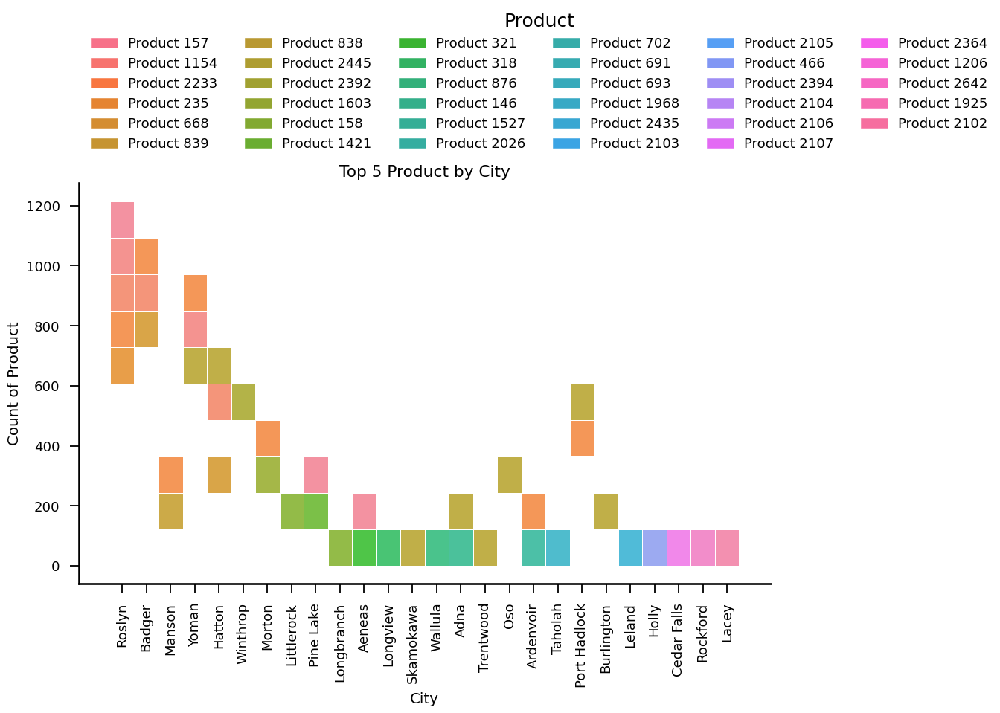

In [464]:
# Plotting the bivariate plot
plt.figure(figsize=(12, 7))
plot=sns.histplot(x='City', y='count',hue='Product', data=df5,multiple='stack',edgecolor = "white")
for p in plot.patches:
    plot.annotate(f'{p.get_height()/1000:.2f}K', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 20), textcoords='offset points',rotation=90)
sns.despine()
sns.move_legend(plot, "lower left", bbox_to_anchor=(0, 1.05), frameon=False,ncols=6)

sns.despine()
plt.xlabel('City')
plt.ylabel('Count of Product')
plt.title('Top 5 Product by City')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 2. Group

In [465]:
# Grouping by City and selecting top 5 Group
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['City'].unique():
    df_new=merged_df[merged_df['City']==i].groupby(['City', 'Group']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:10])
df6=pd.concat(b_counts).reset_index(drop=True)
df6.head(10)

,City,Group,count
0,Roslyn,Yeast,7551
1,Roslyn,Oils,6592
2,Roslyn,Wheat Flours,6142
3,Roslyn,Popcorn,2780
4,Roslyn,Powdered Milk,2233
5,Roslyn,Olive Oils,1697
6,Roslyn,Coffee Pods,1675
7,Roslyn,Sugars,1179
8,Roslyn,Flours,1127
9,Roslyn,Horticulture,1053


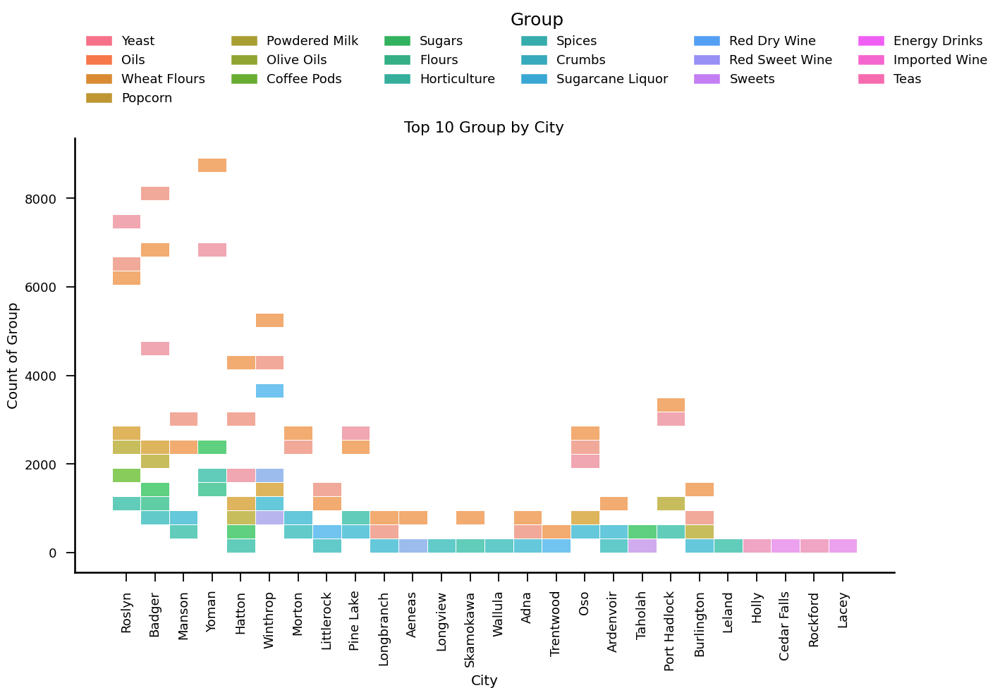

In [466]:
# Plotting the bivariate plot
plt.figure(figsize=(15, 8))
plot=sns.histplot(x='City', y='count',hue='Group', data=df6,multiple='stack',edgecolor = "white")
sns.move_legend(plot, "lower left", bbox_to_anchor=(0, 1.05), frameon=False,ncols=6)

sns.despine()
plt.xlabel('City')
plt.ylabel('Count of Group')
plt.title('Top 10 Group by City')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 3. Category

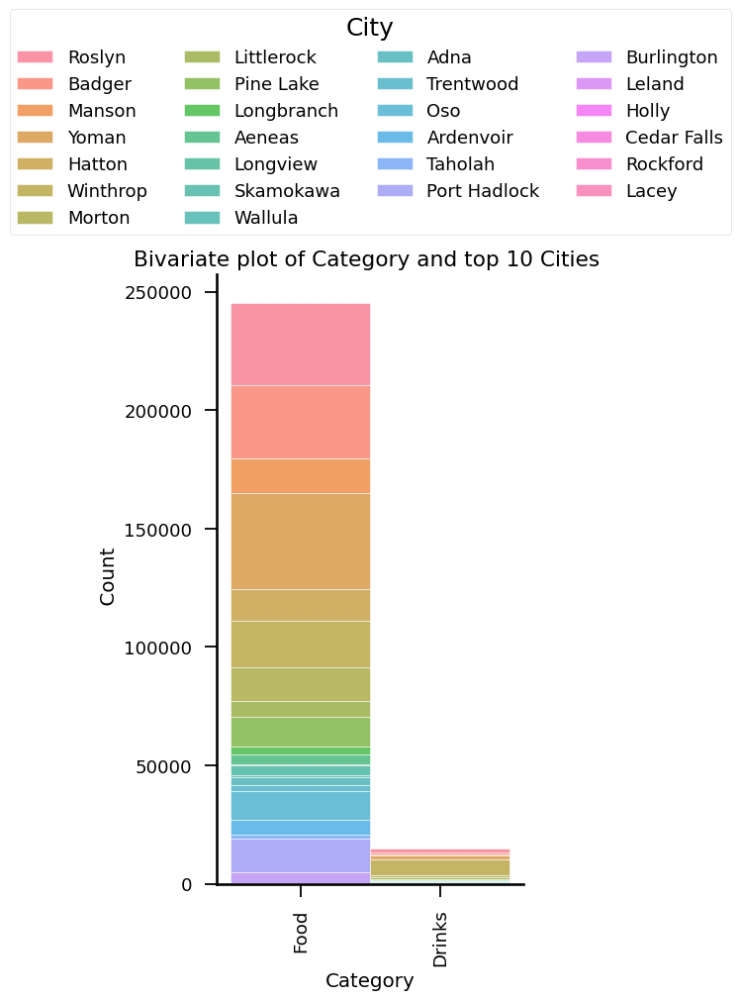

In [730]:
# Grouping by Category and selecting top 10 City
df_new=pd.DataFrame()
c_counts=[]
for i in merged_df['Category'].unique():
    df_new=merged_df[merged_df['Category']==i].groupby(['Category', 'City']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    c_counts.append(df_new[0:10])
df6=pd.concat(c_counts).reset_index(drop=True)


plt.figure(figsize=(4,8))
plot = sns.histplot(data=merged_df, x="Category",hue='City',edgecolor = "white",multiple='stack')

sns.despine()
sns.move_legend(plot, "lower center", bbox_to_anchor=(0.5, 1.05),ncol=4)

plt.xticks(rotation=90)
sns.despine()
plt.xlabel('Category')
plt.ylabel(' Count')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Category and top 10 Cities ')
plt.show()

# BIVARIATE ANALYSIS WRT PRODUCT

## 1. Group

In [732]:
# Grouping by Line of Business and selecting top 5 Group
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Group'].unique():
    df_new=merged_df[merged_df['Group']==i].groupby([ 'Group','Product']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df6=pd.concat(b_counts).reset_index(drop=True)
df6.head(10)

,Group,Product,count
0,Spices,Product 120,859
1,Spices,Product 118,858
2,Spices,Product 114,512
3,Spices,Product 1468,512
4,Spices,Product 2239,504
5,Coffee Pods,Product 1421,2879
6,Coffee Pods,Product 1420,1889
7,Coffee Pods,Product 1560,1110
8,Coffee Pods,Product 1561,1103
9,Coffee Pods,Product 1521,864


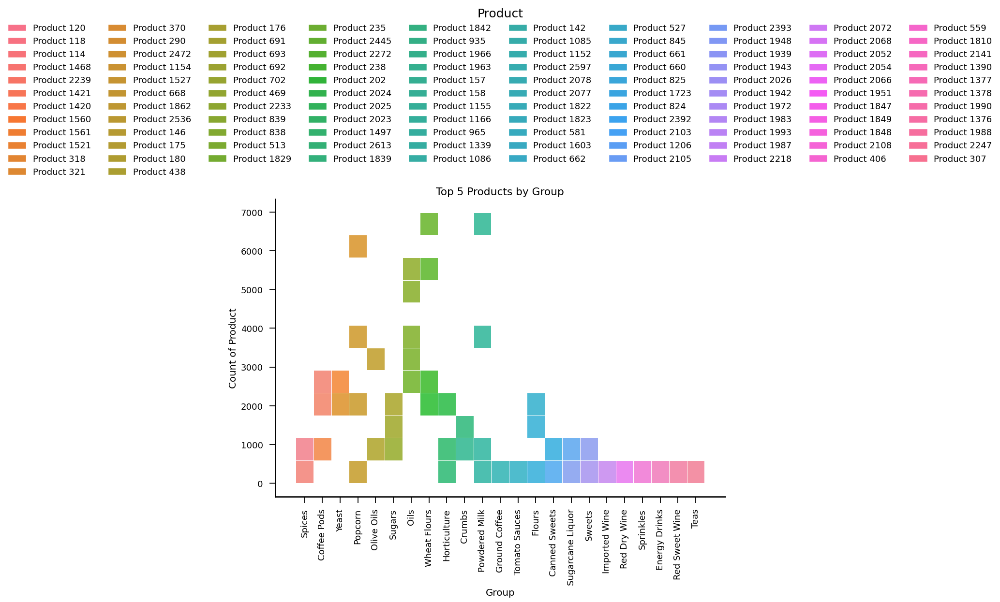

In [733]:
# Plotting the bivariate plot
plt.figure(figsize=(12, 8))
plot=sns.histplot(x='Group', y='count',hue='Product', data=df6,multiple='stack',edgecolor = "white")
sns.move_legend(plot, "lower center", bbox_to_anchor=(0.5, 1.05), frameon=False,ncol=10)

sns.despine()
plt.xlabel('Group')
plt.ylabel('Count of Product')
plt.title('Top 5 Products by Group')
plt.xticks(rotation=90)
#plt.legend(title='Company Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## 3. Category

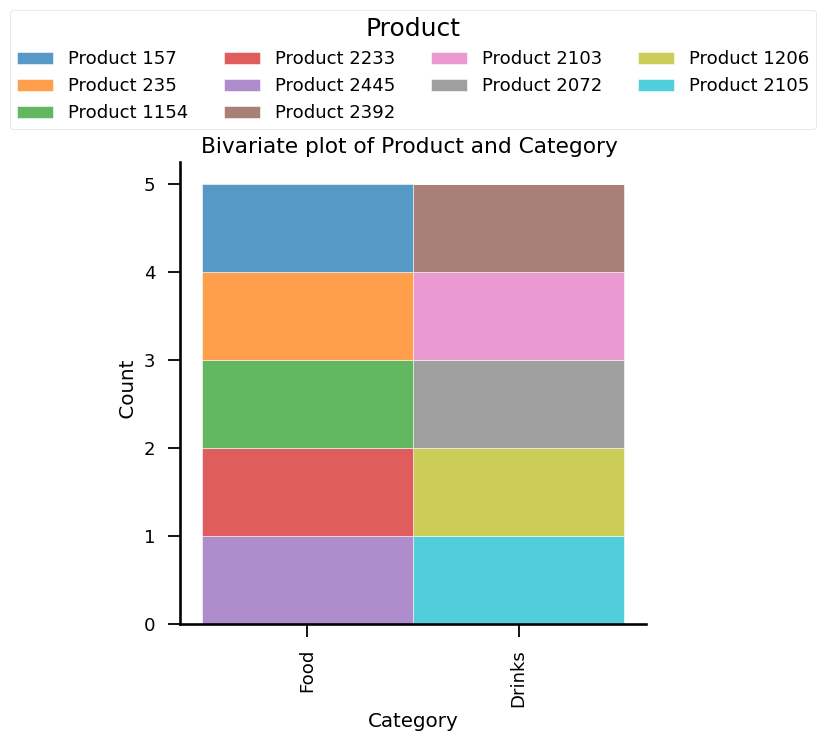

In [734]:
# Grouping by Category and selecting top 5 Product
df_new=pd.DataFrame()
b_counts=[]
for i in merged_df['Category'].unique():
    df_new=merged_df[merged_df['Category']==i].groupby([ 'Category','Product']).size().reset_index(name='count').sort_values(by='count',ascending=False)
    b_counts.append(df_new[0:5])
df7=pd.concat(b_counts).reset_index(drop=True)

plt.figure(figsize=(6,6))
plot = sns.histplot(data=df7, x="Category",hue='Product',edgecolor = "white",multiple='stack')

sns.despine()
sns.move_legend(plot, "lower center", bbox_to_anchor=(0.5, 1.05),ncol=4)

plt.xticks(rotation=90)
sns.despine()
plt.xlabel('Category')
plt.ylabel(' Count')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Product and Category ')
plt.show()

# BIVARIATE ANALYSIS WRT TO GROUP

## 1. CATEGORY

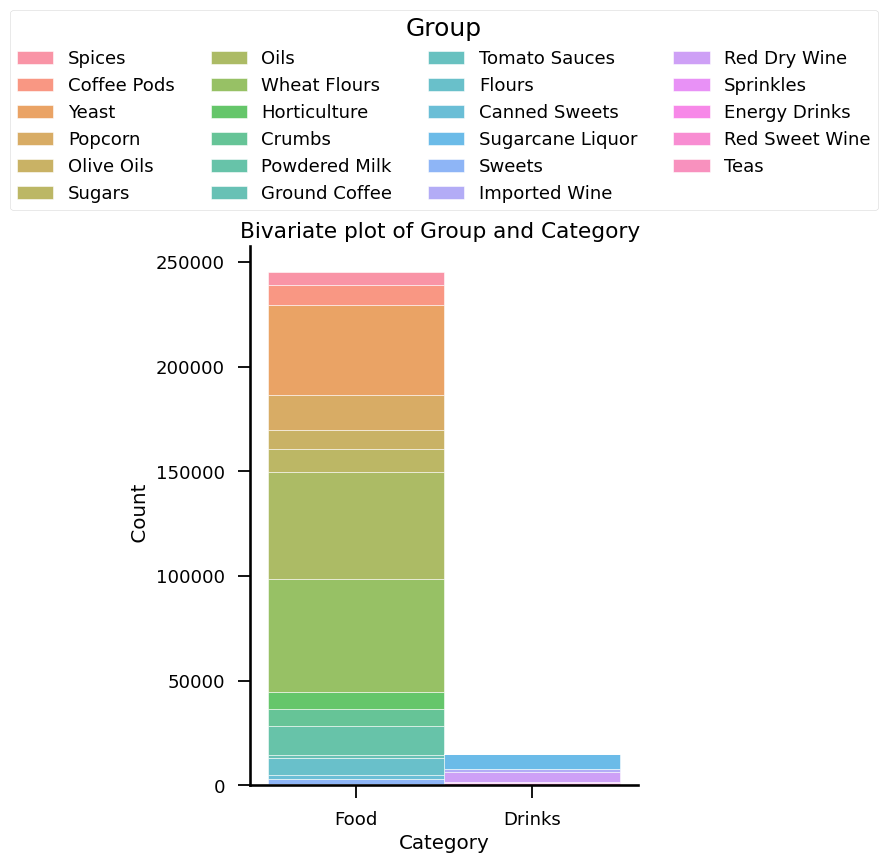

In [744]:
plt.figure(figsize=(5,7))
plot = sns.histplot(data=merged_df, x="Category",hue='Group',edgecolor = "white",multiple='stack')
sns.move_legend(plot, "lower center", bbox_to_anchor=(0.5, 1.05),ncol=4)
sns.despine()
plt.xlabel('Category')
plt.ylabel(' Count')
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('Bivariate plot of Group and Category ')
plt.show()

OVERALL INSIGHTS

Duane Frame :
- Encompasses a diverse team comprising both distributor and online sales.
Implies a broad market approach.
-Sales Team under Duane Frame:
- Shakil, Akeel, Dominykas, Tahmina, Lorenze, Kien, and McGee.
-Supervisors :
-Duane Frame's team is supervised by Tahmeena and Harvey-Lee.
-Duane Frame's managerial roster reflects a higher proportion within status A (55%)
-Duane Frame's managerial domain predominantly encompasses food-related sectors (56%), with a minor representation in the drinks category (1.9%)
sales v/s target
- Duane Frame stands out with an impressive 74% attainment of the target sales, showcasing effective management and strategy execution

Ronnie Daly :
- enters primarily on the retail sector.
- Sales Team under Ronnie Daly:
- Sahil, Seymour, Gillian, Serenity, Hywell, and Ayaana.
-Suggests a focused yet diverse sales force catering to retail-specific demands.
-Supervisors :
-Ronnie Daly's team is supervised by Sarah, Jessica, and Jonathon   
-Managerial Statuses:
-Ronnie Daly's managerial team exhibits a slightly lower percentage within status A (40%).
-Operational Emphases:
-Ronnie Daly's managerial portfolio demonstrates a significant presence in sectors like B&Bs, distributors, and supermarkets, suggesting a targeted approach towards diverse consumer needs and preferences.

sales v/s target
- Ronnie Daly achieves 60% of the target, indicating solid performance but with room for improvement.


City Analysis:​

- In the distributors Lv2 category, Yoman, Roslyn, and Badger emerge as the top cities with the highest transaction counts. This indicates significant distribution activity in these regions.​

- The dominance of specific cities suggests potential hubs for distribution centers or strong consumer demand clusters.

Team Composition:
- Distributors: Constituting 35.21% of the workforce, with notable individuals like Akeel Mcleod, Shakeel Durham, and Kien Mcgee.
- Online Team: Representing 22.85% of the workforce, led by prominent figures such as Dominykas Bird, Lorenzo Donovan, and Tatiana Adamson.
- Retailers: Comprising 41.93% of the teams, with diverse leadership from individuals like Ayaana Mackeenzie, Gillian Gonzales, Sahil Seymour, and Serenity Rich.
Statuses:
-Distributors: Notable presence within status A (33.71%), indicating a focus on operational excellence and efficiency.
-Online Team: Follows closely behind with 22.17% within status A.
-Retailers: Lead with the highest percentage within status A (40.85%), showing a commitment to excellence in retail operations.


Product Sales Analysis:
- Retailers and Distributors are key contributors to sales, especially in the food and drinks categories.
- Oils and wheat flours are top-selling items, while teas and tomato sauces rank among the least popular products, indicating shifting consumer preferences and market dynamics.


total sales

- Quantity bins ranging from 24-99 and 100-2000 are the most lucrative, indicating robust demand within these ranges.
- Unit price bins of 5-50 exhibit strong sales, while those in the range of 100-200 lag behind.
- Net weight bins like 0-1 and 1-1.5 show significant traction in sales.
- Salesperson 215 leads in sales, while 326 trails as the lowest performer.
- Supervisors Sarah Jain and Tahmina stand out for their high sales figures, contrasting with Jessica, who records the lowest.
- Duane Frame dominates managerial sales with $8.60 million, followed closely by Ronnie Daly at $7.42 million.
- The retail team emerges as the top performer with $7.42 million in sales, followed by distributors with $4.81 million and online platforms with the lowest at $2.79 million.
- Key players in the market, including Dragonwalk, Red Beat, and Prophecy Lighting, lead in sales, while others like Tortoisecurity and Berry Master lag behind.
- Supermarket Lv3 generates the highest sales at $3.5 million, with Wholesale Lv2 and Bulk registering the lowest figures.
- Geographically, Yoman ranks first with $3.3 million in sales, while Lacey ranks at the bottom.
- Staples like wheat flours ($4.47 million), yeast ($2.20 million), and oils ($2.19 million) dominate the sales charts, whereas less popular items like teas, tomato sauce, and sprinkles struggle to gain traction.
- Food products lead significantly, contributing approximately $16.37 million in sales, while drinks lag behind at $1.54 million.

sales v/s target

- Among salespersons, Salesperson 215.265 nearly meets the set target, while Salesperson 102 trails behind as the lowest achiever.
- Supervisors Tahmina and Sarah both meet their sales targets, while Supervisor Jessica lags behind with the lowest attainment compared to the set target.
-Distributors excel, achieving up to 83% of their target sales, showcasing their effectiveness in distribution channels.
-Online and Retail teams reach 60% of their respective targets, indicating opportunities for enhancement in their sales strategies and execution.
-Annual performance analysis reveals a gradual improvement in target achievement over the years.
-In 2017, sales targets were achieved up to 52%, reflecting initial challenges or market dynamics.
-However, in 2018, there was a significant enhancement, with targets being met up to 81%, showcasing adaptability, strategic adjustments, and potentially improved market conditions.
